In [2]:
from __future__ import print_function
import os, sys, time, json, random
import numpy as np
from keras.models import Sequential
from keras.layers.core import Dense, Activation
from keras.optimizers import SGD , Adam, RMSprop
from keras.layers.advanced_activations import PReLU
from keras.layers.advanced_activations import LeakyReLU
from keras.activations import relu
import matplotlib.pyplot as plt
from keras.models import model_from_json
%matplotlib inline
import gym
from gym import wrappers
from datetime import datetime

In [2]:
mouse_mark = 0.5    # The current mouse cell
cat_mark=0.0        # The current cat cell except the starting position
LEFT = 0
UP = 1
RIGHT = 2
DOWN = 3
# Actions dictionary
actions_dict = {
    LEFT: 'left',
    UP: 'up',
    RIGHT: 'right',
    DOWN: 'down'
}
num_actions = len(actions_dict)
# Exploration factor
epsilon = 0.1
win_history=[]

In [3]:
# maze is a 2d Numpy array of floats between 0.0 to 1.0
# 1.0 corresponds to a free cell, and 0.0 an occupied cell
# mouse = (row, col) initial mouse position (defaults to (0,0))

class Maze(object):
    def __init__(self, maze, mouse=(0,0)):
        self._maze = np.array(maze)
        nrows, ncols = self._maze.shape
        self.target = (nrows-1, ncols-1)   # target cell
        self.cat=self.target
        self.free_cells = [(r,c) for r in range(nrows) for c in range(ncols) if self._maze[r,c] == 1.0]
        self.free_cells.remove(self.target)
        if self._maze[self.target] == 0.0:
            raise Exception("Invalid maze: target cell cannot be blocked!")
        if not mouse in self.free_cells:
            raise Exception("Invalid mouse Location: must sit on a free cell")
        self.reset(mouse)

    def reset(self, mouse):
        self.mouse = mouse
        self.maze = np.copy(self._maze)
        nrows, ncols = self.maze.shape
        self.cat=(nrows-1, ncols-1)
        row, col = mouse
        self.maze[row, col] = mouse_mark
        self.state = (row, col, 'start')
        self.total_reward = 0
        self.visited = set()

    def update_state(self, action):
        nrows, ncols = self.maze.shape
        nrow, ncol, nmode = mouse_row, mouse_col, mode = self.state
        if self.maze[mouse_row, mouse_col] > 0.0: self.visited.add((mouse_row, mouse_col))  # mark visited cell
        valid_actions = self.valid_actions()                
        if action in valid_actions:
            nmode = 'valid'
            if action == LEFT: ncol -= 1
            elif action == UP: nrow -= 1
            elif action == RIGHT: ncol += 1
            elif action == DOWN: nrow += 1
        else: mode = 'invalid'                # invalid action, no change in mouse position
        self.state = (nrow, ncol, nmode)      # new state

    def get_reward(self,caught):
        mouse_row, mouse_col, mode = self.state
        nrows, ncols = self.maze.shape
        if mouse_row == nrows-1 and mouse_col == ncols-1: return 1.0
        if caught == "Y":
            mode="caught"
            self.state=(mouse_row, mouse_col, mode)
            return -1.0
        if (mouse_row, mouse_col) in self.visited: return -0.25                         
        if mode == 'invalid': return -0.75                      
        if mode == 'valid': return -0.05
        
    def chase(self, valid_actions):
        mouse_row, mouse_col, mode = self.state
        nrows, ncols = self.maze.shape
        if self.cat == (mouse_row, mouse_col): return -1
        best_action = -2
        best_dist = (nrows-1)**2 + (ncols-1)**2 + 1
        for action in valid_actions:
            cat_x=self.cat[0]
            cat_y=self.cat[1]
            if action == LEFT: 
                dist = (cat_x - mouse_row) ** 2 + (cat_y-1 - mouse_col) ** 2
                if best_dist>dist:
                    best_dist=dist
                    best_action=LEFT
            elif action == UP:
                dist = (cat_x-1 - mouse_row) ** 2 + (cat_y - mouse_col) ** 2
                if best_dist>dist:
                    best_dist=dist
                    best_action=UP
            elif action == RIGHT: 
                dist = (cat_x - mouse_row) ** 2 + (cat_y+1 - mouse_col) ** 2
                if best_dist>dist:
                    best_dist=dist
                    best_action=RIGHT
            elif action == DOWN: 
                dist = (cat_x+1 - mouse_row) ** 2 + (cat_y - mouse_col) ** 2
                if best_dist>dist:
                    best_dist=dist
                    best_action=DOWN
        return best_action
        
    def cat_movement(self, action):
        valid_actions = self.valid_actions(self.cat)        
        action=self.chase(valid_actions)
        nrow, ncol = self.cat
        if action in valid_actions:
            if action == LEFT: ncol -= 1
            elif action == UP: nrow -= 1
            elif action == RIGHT: ncol += 1
            elif action == DOWN: nrow += 1
            elif action == -1: return "Y" 
        self.cat = (nrow, ncol)          #new state
        mouse_row, mouse_col, mode = self.state
        #print("mouse state:", mouse_row, mouse_col, "cat state (watching mouse move):",self.cat)
        if self.cat == (mouse_row, mouse_col): return "Y"
        return "N"

    def act(self, action):
        self.update_state(action)
        caught=self.cat_movement(action)
        reward = self.get_reward(caught)
        self.total_reward += reward
        status = self.game_status()
        envstate = self.observe()
        return envstate, reward, status

    def observe(self):
        canvas = self.draw_maze()
        envstate = canvas.reshape((1, -1))
        return envstate

    def draw_maze(self):
        canvas = np.copy(self.maze)
        nrows, ncols = self.maze.shape
        # clear all visual marks
        for r in range(nrows):
            for c in range(ncols):
                if canvas[r,c] > 0.0: canvas[r,c] = 1.0
        # draw the mouse
        row, col, valid = self.state
        canvas[row, col] = mouse_mark
        row, col = self.cat
        if (row,col) != (nrows-1, ncols-1): canvas[row,col] = cat_mark
        return canvas

    def game_status(self):
        mouse_row, mouse_col, mode = self.state
        nrows, ncols = self.maze.shape
        if mode == "caught": return 'lose'
        if mouse_row == nrows-1 and mouse_col == ncols-1: return 'win'
        return 'not_over'

    def valid_actions(self, cell=None):
        if cell is None: row, col, mode = self.state
        else: row, col = cell
        actions = [0, 1, 2, 3]
        nrows, ncols = self.maze.shape
        if row == 0:actions.remove(1)
        elif row == nrows-1:actions.remove(3)
        if col == 0: actions.remove(0)
        elif col == ncols-1: actions.remove(2)
        if row>0 and self.maze[row-1,col] == 0.0: actions.remove(1)
        if row<nrows-1 and self.maze[row+1,col] == 0.0: actions.remove(3)
        if col>0 and self.maze[row,col-1] == 0.0: actions.remove(0)
        if col<ncols-1 and self.maze[row,col+1] == 0.0: actions.remove(2)
        return actions

In [4]:
class Learn(object):
    def __init__(self, model, max_memory=300, discount=0.95):
        self.model = model
        self.max_memory = max_memory
        self.discount = discount
        self.memory = list()
        self.num_actions = model.output_shape[-1]

    def record(self, move):
        # move = [envstate, action, reward, envstate_next, game_over]
        # memory[i] = move
        # envstate == flattened 1d maze cells info, including mouse cell (see method: observe)
        self.memory.append(move)
        if len(self.memory) > self.max_memory: del self.memory[0]

    def predict(self, envstate):
        return self.model.predict(envstate)[0]

    def retrieve(self, data_size=10):
        env_size = self.memory[0][0].shape[1]   # envstate 1d size (1st element of move)        
        mem_size = len(self.memory)
        data_size = min(mem_size, data_size)
        inputs = np.zeros((data_size, env_size))
        targets = np.zeros((data_size, self.num_actions))
        for i in range(data_size):
            envstate, action, reward, envstate_next, game_over = self.memory[i]
            inputs[i] = envstate        
            targets[i] = self.predict(envstate) #There should be no target values for actions not taken.            
            Q_sa = np.max(self.predict(envstate_next)) # Q_sa = derived policy = max quality env/action = max_a' Q(s', a')
            if game_over: targets[i, action] = reward
            else: targets[i, action] = reward + self.discount * Q_sa # reward + gamma * max_a' Q(s', a')
        return inputs, targets

In [5]:
def train(model, maze, **opt):
    global epsilon
    global win_history
    n_epoch = opt.get('n_epoch', 15000)
    max_memory = opt.get('max_memory', 1000)
    data_size = opt.get('data_size', 50)
    weights_file = opt.get('weights_file', "")
    name = opt.get('name', 'model')
    start_time = datetime.now()    
    if weights_file: # to continue training from a previous model, just supply the h5 file name to weights_file option
        print("loading weights from file: %s" % (weights_file,))
        model.load_weights(weights_file)
    # Construct environment/game from numpy array: maze (see above)
    qmaze = Maze(maze)
    # Initialize learn replay object
    learn = Learn(model, max_memory=max_memory)
    win_history = []   # history of win/lose game
    win_rate = 0.00
    policy_update_window=300
    n_moves_across_games = 0
    policy_iteration = 0
    for epoch in range(n_epoch):
        loss = 0.0
        mouse_cell = random.choice(qmaze.free_cells)
        qmaze.reset(mouse_cell)
        game_over = False
        envstate = qmaze.observe()  # get initial envstate (1d flattened canvas)
        moves = 0
        while not game_over:
            valid_actions = qmaze.valid_actions()
            if not valid_actions: break
            prev_envstate = envstate
            if np.random.rand() <= epsilon: action = random.choice(valid_actions)   # Get next action
            else: action = np.argmax(learn.predict(prev_envstate))
            envstate, reward, game_status = qmaze.act(action)       # Apply action, get reward and new envstate
            if game_status == 'win':
                win_history.append(1)
                game_over = True
            elif game_status == 'lose':
                win_history.append(0)
                game_over = True     
            move = [prev_envstate, action, reward, envstate, game_over] # Store move
            learn.record(move)
            moves += 1
            n_moves_across_games+=1
            if n_moves_across_games == policy_iteration*policy_update_window + policy_update_window:
                inputs, targets = learn.retrieve(data_size=data_size)       # Train neural network model
                h = model.fit(inputs, targets, epochs=8, batch_size=16, verbose=0)
                loss = model.evaluate(inputs, targets, verbose=0)
                policy_iteration+=1                
        if (epoch>=49): win_rate = sum(win_history) / (epoch+1)   
        template = "Epoch: {:03d}/{:d} | Loss: {:.4f} | Moves: {:d} | Win count: {:d} | Win rate: {:.3f} | time: {}"
        print(template.format(epoch, n_epoch-1, loss, moves, sum(win_history), win_rate, format_time((datetime.now() - start_time).total_seconds())))
        print("win_hist (most recent games)",win_history[-50:])
        if epoch >= 39999: epsilon/=10   # we have almost achieved our optimal policy
        elif epoch >= 19999: epsilon/=10    # less exploration, more exploitation of the policy.
        if win_rate > 0.90:
            print("Reached 90%% win rate at epoch: %d" % (epoch,))
            break
    # Save trained model weights and architecture, this will be used by the visualization code
    h5file = name + ".h5"
    json_file = name + ".json"
    model.save_weights(h5file, overwrite=True)
    with open(json_file, "w") as outfile: json.dump(model.to_json(), outfile)
    print('files: %s, %s' % (h5file, json_file))
    print("n_epoch: %d, max_mem: %d, data: %d, policy iterations: %d, time: %s" % (epoch, max_memory, data_size, policy_iteration, format_time((datetime.now() - start_time).total_seconds())))

# This is a small utility for printing readable time strings:
def format_time(seconds):
    if seconds < 121: return "%.1f seconds" % (float(seconds),)
    elif seconds < 3661: return "%.2f minutes" % (seconds / 60.0,)
    else:return "%.2f hours" % (seconds / 3600.0,)

In [6]:
def show(qmaze):
    plt.grid('on')
    nrows, ncols = qmaze.maze.shape
    ax = plt.gca()
    ax.set_xticks(np.arange(0.5, nrows, 1))
    ax.set_yticks(np.arange(0.5, ncols, 1))
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    canvas = np.copy(qmaze.maze)
    for row,col in qmaze.visited:
        canvas[row,col] = 0.6
    mouse_row, mouse_col, _ = qmaze.state
    cat_row, cat_col = qmaze.cat    
    canvas[mouse_row, mouse_col] = 0.3   # mouse cell
    canvas[cat_row, cat_col] = 0.8 #cat cell
    canvas[nrows-1, ncols-1] = 0.9 # cheese cell
    img = plt.imshow(canvas, interpolation='none', cmap='gray')
    return img

In [7]:
def play_game(model, qmaze, mouse_cell):
    qmaze.reset(mouse_cell)
    envstate = qmaze.observe()
    while True:
        q = model.predict(envstate)         # get next action
        action = np.argmax(q[0])
        envstate, reward, game_status = qmaze.act(action)         # apply action, get rewards and new state
        if game_status == 'win' or game_status == 'lose' : break
    return game_status

C:\Users\mailg\Anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


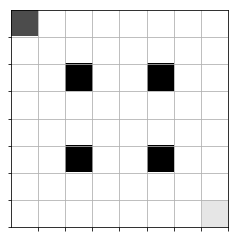

In [8]:
maze =  np.array([
    [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
    [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
    [ 1.,  1.,  0.,  1.,  1.,  0.,  1.,  1.],
    [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
    [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
    [ 1.,  1.,  0.,  1.,  1.,  0.,  1.,  1.],
    [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
    [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.]

])

qmaze = Maze(maze)
show(qmaze)

In [9]:
def build_model(maze, lr=0.001):
    model = Sequential()
    model.add(Dense(maze.size, input_shape=(maze.size,)))
    model.add(LeakyReLU())
    model.add(Dense(maze.size))
    model.add(LeakyReLU())
    model.add(Dense(maze.size))
    model.add(LeakyReLU())
    model.add(Dense(num_actions))
    model.compile(optimizer='adam', loss='mse')
    return model

In [10]:
model_v5_1 = build_model(maze)
train(model_v5_1, maze, n_epoch=5000, max_memory=8*maze.size, data_size=300, name='model_v5_1')

Epoch: 000/4999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0]
Epoch: 001/4999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0]
Epoch: 002/4999 | Loss: 0.0000 | Moves: 12 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0]
Epoch: 003/4999 | Loss: 0.0000 | Moves: 4 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0]
Epoch: 004/4999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0]
Epoch: 005/4999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0]
Epoch: 006/4999 | Loss: 0.0000 | Moves: 5 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0]
Epoch: 007/4999 | Loss: 0.0000 | Move

Epoch: 067/4999 | Loss: 0.0303 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 068/4999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 069/4999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 070/4999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 098/4999 | Loss: 0.0170 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 2.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 099/4999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 2.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 100/4999 | Loss: 0.0000 | Moves: 11 | Win count: 0 | Win rate: 0.000 | time: 2.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 101/4999 | Loss: 0.0000 | Moves: 11 | Win count: 0 | Win rate: 0.000 | time: 2.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 166/4999 | Loss: 0.0170 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 4.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 167/4999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 4.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 168/4999 | Loss: 0.0000 | Moves: 3 | Win count: 1 | Win rate: 0.006 | time: 4.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 169/4999 | Loss: 0.0000 | Moves: 5 | Win count: 1 | Win rate: 0.006 | time: 4.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 216/4999 | Loss: 0.0241 | Moves: 15 | Win count: 2 | Win rate: 0.009 | time: 4.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 217/4999 | Loss: 0.0000 | Moves: 8 | Win count: 2 | Win rate: 0.009 | time: 4.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 218/4999 | Loss: 0.0000 | Moves: 15 | Win count: 2 | Win rate: 0.009 | time: 4.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 219/4999 | Loss: 0.0000 | Moves: 15 | Win count: 2 | Win rate: 0.009 | time: 4.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 248/4999 | Loss: 0.0211 | Moves: 11 | Win count: 2 | Win rate: 0.008 | time: 5.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 249/4999 | Loss: 0.0000 | Moves: 11 | Win count: 2 | Win rate: 0.008 | time: 5.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 250/4999 | Loss: 0.0000 | Moves: 10 | Win count: 2 | Win rate: 0.008 | time: 5.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 251/4999 | Loss: 0.0000 | Moves: 11 | Win count: 2 | Win rate: 0.008 | time: 5.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 285/4999 | Loss: 0.0143 | Moves: 11 | Win count: 2 | Win rate: 0.007 | time: 5.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 286/4999 | Loss: 0.0000 | Moves: 5 | Win count: 2 | Win rate: 0.007 | time: 5.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 287/4999 | Loss: 0.0000 | Moves: 8 | Win count: 2 | Win rate: 0.007 | time: 5.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 288/4999 | Loss: 0.0000 | Moves: 6 | Win count: 2 | Win rate: 0.007 | time: 5.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 330/4999 | Loss: 0.0147 | Moves: 9 | Win count: 2 | Win rate: 0.006 | time: 6.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 331/4999 | Loss: 0.0000 | Moves: 11 | Win count: 2 | Win rate: 0.006 | time: 6.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 332/4999 | Loss: 0.0000 | Moves: 4 | Win count: 2 | Win rate: 0.006 | time: 6.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 333/4999 | Loss: 0.0000 | Moves: 13 | Win count: 2 | Win rate: 0.006 | time: 6.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 389/4999 | Loss: 0.0088 | Moves: 12 | Win count: 4 | Win rate: 0.010 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 390/4999 | Loss: 0.0000 | Moves: 3 | Win count: 4 | Win rate: 0.010 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 391/4999 | Loss: 0.0000 | Moves: 13 | Win count: 4 | Win rate: 0.010 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 392/4999 | Loss: 0.0000 | Moves: 3 | Win count: 4 | Win rate: 0.010 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 420/4999 | Loss: 0.0109 | Moves: 31 | Win count: 4 | Win rate: 0.010 | time: 8.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 421/4999 | Loss: 0.0000 | Moves: 1 | Win count: 5 | Win rate: 0.012 | time: 8.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 422/4999 | Loss: 0.0000 | Moves: 8 | Win count: 5 | Win rate: 0.012 | time: 8.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 423/4999 | Loss: 0.0000 | Moves: 2 | Win count: 5 | Win rate: 0.012 | time: 8.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 450/4999 | Loss: 0.0000 | Moves: 7 | Win count: 7 | Win rate: 0.016 | time: 9.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 451/4999 | Loss: 0.0000 | Moves: 2 | Win count: 7 | Win rate: 0.015 | time: 9.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 452/4999 | Loss: 0.0000 | Moves: 15 | Win count: 7 | Win rate: 0.015 | time: 9.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0]
Epoch: 453/4999 | Loss: 0.0000 | Moves: 2 | Win count: 7 | Win rate: 0.015 | time: 9.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 497/4999 | Loss: 0.0129 | Moves: 8 | Win count: 8 | Win rate: 0.016 | time: 10.1 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 498/4999 | Loss: 0.0000 | Moves: 8 | Win count: 8 | Win rate: 0.016 | time: 10.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 499/4999 | Loss: 0.0000 | Moves: 7 | Win count: 8 | Win rate: 0.016 | time: 10.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 500/4999 | Loss: 0.0000 | Moves: 11 | Win count: 8 | Win rate: 0.016 | time: 10.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 532/4999 | Loss: 0.0091 | Moves: 11 | Win count: 8 | Win rate: 0.015 | time: 10.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 533/4999 | Loss: 0.0000 | Moves: 22 | Win count: 8 | Win rate: 0.015 | time: 10.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 534/4999 | Loss: 0.0000 | Moves: 8 | Win count: 8 | Win rate: 0.015 | time: 10.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 535/4999 | Loss: 0.0000 | Moves: 2 | Win count: 8 | Win rate: 0.015 | time: 10.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 571/4999 | Loss: 0.0075 | Moves: 5 | Win count: 9 | Win rate: 0.016 | time: 11.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 572/4999 | Loss: 0.0000 | Moves: 9 | Win count: 9 | Win rate: 0.016 | time: 11.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 573/4999 | Loss: 0.0000 | Moves: 10 | Win count: 9 | Win rate: 0.016 | time: 11.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 574/4999 | Loss: 0.0000 | Moves: 11 | Win count: 9 | Win rate: 0.016 | time: 11.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 604/4999 | Loss: 0.0088 | Moves: 6 | Win count: 9 | Win rate: 0.015 | time: 11.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 605/4999 | Loss: 0.0000 | Moves: 7 | Win count: 9 | Win rate: 0.015 | time: 11.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 606/4999 | Loss: 0.0000 | Moves: 8 | Win count: 9 | Win rate: 0.015 | time: 11.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 607/4999 | Loss: 0.0000 | Moves: 10 | Win count: 9 | Win rate: 0.015 | time: 11.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 667/4999 | Loss: 0.0048 | Moves: 9 | Win count: 9 | Win rate: 0.013 | time: 13.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 668/4999 | Loss: 0.0000 | Moves: 8 | Win count: 9 | Win rate: 0.013 | time: 13.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 669/4999 | Loss: 0.0000 | Moves: 6 | Win count: 9 | Win rate: 0.013 | time: 13.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 670/4999 | Loss: 0.0000 | Moves: 11 | Win count: 9 | Win rate: 0.013 | time: 13.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 739/4999 | Loss: 0.0077 | Moves: 7 | Win count: 10 | Win rate: 0.014 | time: 14.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 740/4999 | Loss: 0.0000 | Moves: 7 | Win count: 11 | Win rate: 0.015 | time: 14.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 741/4999 | Loss: 0.0000 | Moves: 7 | Win count: 11 | Win rate: 0.015 | time: 14.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 742/4999 | Loss: 0.0000 | Moves: 13 | Win count: 11 | Win rate: 0.015 | time: 14.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

Epoch: 776/4999 | Loss: 0.0078 | Moves: 8 | Win count: 11 | Win rate: 0.014 | time: 15.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 777/4999 | Loss: 0.0000 | Moves: 6 | Win count: 11 | Win rate: 0.014 | time: 15.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 778/4999 | Loss: 0.0000 | Moves: 12 | Win count: 11 | Win rate: 0.014 | time: 15.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 779/4999 | Loss: 0.0000 | Moves: 11 | Win count: 11 | Win rate: 0.014 | time: 15.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0

Epoch: 824/4999 | Loss: 0.0074 | Moves: 5 | Win count: 12 | Win rate: 0.015 | time: 15.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 825/4999 | Loss: 0.0000 | Moves: 12 | Win count: 12 | Win rate: 0.015 | time: 15.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 826/4999 | Loss: 0.0000 | Moves: 2 | Win count: 12 | Win rate: 0.015 | time: 15.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 827/4999 | Loss: 0.0000 | Moves: 12 | Win count: 12 | Win rate: 0.014 | time: 15.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 865/4999 | Loss: 0.0042 | Moves: 6 | Win count: 13 | Win rate: 0.015 | time: 16.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 866/4999 | Loss: 0.0000 | Moves: 7 | Win count: 13 | Win rate: 0.015 | time: 16.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 867/4999 | Loss: 0.0000 | Moves: 13 | Win count: 13 | Win rate: 0.015 | time: 16.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 868/4999 | Loss: 0.0000 | Moves: 13 | Win count: 13 | Win rate: 0.015 | time: 16.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 928/4999 | Loss: 0.0035 | Moves: 14 | Win count: 13 | Win rate: 0.014 | time: 17.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 929/4999 | Loss: 0.0000 | Moves: 10 | Win count: 13 | Win rate: 0.014 | time: 17.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 930/4999 | Loss: 0.0000 | Moves: 11 | Win count: 13 | Win rate: 0.014 | time: 17.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 931/4999 | Loss: 0.0000 | Moves: 1 | Win count: 13 | Win rate: 0.014 | time: 17.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 962/4999 | Loss: 0.0036 | Moves: 9 | Win count: 13 | Win rate: 0.013 | time: 18.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 963/4999 | Loss: 0.0000 | Moves: 13 | Win count: 13 | Win rate: 0.013 | time: 18.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 964/4999 | Loss: 0.0000 | Moves: 13 | Win count: 13 | Win rate: 0.013 | time: 18.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 965/4999 | Loss: 0.0000 | Moves: 13 | Win count: 13 | Win rate: 0.013 | time: 18.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1029/4999 | Loss: 0.0034 | Moves: 8 | Win count: 13 | Win rate: 0.013 | time: 19.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1030/4999 | Loss: 0.0000 | Moves: 13 | Win count: 13 | Win rate: 0.013 | time: 19.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1031/4999 | Loss: 0.0000 | Moves: 6 | Win count: 13 | Win rate: 0.013 | time: 19.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1032/4999 | Loss: 0.0000 | Moves: 7 | Win count: 13 | Win rate: 0.013 | time: 19.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1075/4999 | Loss: 0.0068 | Moves: 10 | Win count: 15 | Win rate: 0.014 | time: 19.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1076/4999 | Loss: 0.0000 | Moves: 8 | Win count: 15 | Win rate: 0.014 | time: 19.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1077/4999 | Loss: 0.0000 | Moves: 10 | Win count: 15 | Win rate: 0.014 | time: 19.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1078/4999 | Loss: 0.0000 | Moves: 17 | Win count: 15 | Win rate: 0.014 | time: 19.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,

Epoch: 1113/4999 | Loss: 0.0063 | Moves: 11 | Win count: 17 | Win rate: 0.015 | time: 20.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1114/4999 | Loss: 0.0000 | Moves: 9 | Win count: 17 | Win rate: 0.015 | time: 20.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1115/4999 | Loss: 0.0000 | Moves: 6 | Win count: 17 | Win rate: 0.015 | time: 20.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1116/4999 | Loss: 0.0000 | Moves: 7 | Win count: 17 | Win rate: 0.015 | time: 20.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1146/4999 | Loss: 0.0123 | Moves: 9 | Win count: 18 | Win rate: 0.016 | time: 21.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1147/4999 | Loss: 0.0000 | Moves: 2 | Win count: 18 | Win rate: 0.016 | time: 21.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1148/4999 | Loss: 0.0000 | Moves: 2 | Win count: 18 | Win rate: 0.016 | time: 21.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1149/4999 | Loss: 0.0000 | Moves: 3 | Win count: 18 | Win rate: 0.016 | time: 21.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,

Epoch: 1188/4999 | Loss: 0.0028 | Moves: 8 | Win count: 19 | Win rate: 0.016 | time: 21.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1189/4999 | Loss: 0.0000 | Moves: 7 | Win count: 19 | Win rate: 0.016 | time: 21.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1190/4999 | Loss: 0.0000 | Moves: 19 | Win count: 19 | Win rate: 0.016 | time: 21.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1191/4999 | Loss: 0.0000 | Moves: 13 | Win count: 19 | Win rate: 0.016 | time: 21.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1221/4999 | Loss: 0.0070 | Moves: 11 | Win count: 19 | Win rate: 0.016 | time: 22.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1222/4999 | Loss: 0.0000 | Moves: 10 | Win count: 19 | Win rate: 0.016 | time: 22.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1223/4999 | Loss: 0.0000 | Moves: 7 | Win count: 19 | Win rate: 0.016 | time: 22.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1224/4999 | Loss: 0.0000 | Moves: 4 | Win count: 19 | Win rate: 0.016 | time: 22.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 1252/4999 | Loss: 0.0000 | Moves: 11 | Win count: 22 | Win rate: 0.018 | time: 22.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1253/4999 | Loss: 0.0000 | Moves: 13 | Win count: 22 | Win rate: 0.018 | time: 22.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1254/4999 | Loss: 0.0000 | Moves: 5 | Win count: 22 | Win rate: 0.018 | time: 22.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1255/4999 | Loss: 0.0000 | Moves: 9 | Win count: 22 | Win rate: 0.018 | time: 22.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1302/4999 | Loss: 0.0000 | Moves: 9 | Win count: 25 | Win rate: 0.019 | time: 23.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1303/4999 | Loss: 0.0000 | Moves: 3 | Win count: 26 | Win rate: 0.020 | time: 23.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 1304/4999 | Loss: 0.0000 | Moves: 2 | Win count: 26 | Win rate: 0.020 | time: 23.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 1305/4999 | Loss: 0.0000 | Moves: 9 | Win count: 26 | Win rate: 0.020 | time: 23.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,

Epoch: 1356/4999 | Loss: 0.0000 | Moves: 4 | Win count: 28 | Win rate: 0.021 | time: 24.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1357/4999 | Loss: 0.0000 | Moves: 3 | Win count: 28 | Win rate: 0.021 | time: 24.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1358/4999 | Loss: 0.0000 | Moves: 7 | Win count: 28 | Win rate: 0.021 | time: 24.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1359/4999 | Loss: 0.0000 | Moves: 8 | Win count: 28 | Win rate: 0.021 | time: 24.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1401/4999 | Loss: 0.0000 | Moves: 9 | Win count: 31 | Win rate: 0.022 | time: 24.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 1402/4999 | Loss: 0.0000 | Moves: 2 | Win count: 31 | Win rate: 0.022 | time: 24.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 1403/4999 | Loss: 0.0000 | Moves: 1 | Win count: 31 | Win rate: 0.022 | time: 24.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1404/4999 | Loss: 0.0000 | Moves: 13 | Win count: 31 | Win rate: 0.022 | time: 24.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1445/4999 | Loss: 0.0105 | Moves: 20 | Win count: 32 | Win rate: 0.022 | time: 25.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1446/4999 | Loss: 0.0000 | Moves: 12 | Win count: 32 | Win rate: 0.022 | time: 25.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1447/4999 | Loss: 0.0000 | Moves: 3 | Win count: 32 | Win rate: 0.022 | time: 25.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1448/4999 | Loss: 0.0000 | Moves: 8 | Win count: 32 | Win rate: 0.022 | time: 25.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1509/4999 | Loss: 0.0057 | Moves: 16 | Win count: 34 | Win rate: 0.023 | time: 27.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1510/4999 | Loss: 0.0000 | Moves: 5 | Win count: 34 | Win rate: 0.023 | time: 27.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1511/4999 | Loss: 0.0000 | Moves: 10 | Win count: 34 | Win rate: 0.022 | time: 27.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1512/4999 | Loss: 0.0000 | Moves: 5 | Win count: 34 | Win rate: 0.022 | time: 27.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 1547/4999 | Loss: 0.0067 | Moves: 9 | Win count: 35 | Win rate: 0.023 | time: 27.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1548/4999 | Loss: 0.0000 | Moves: 12 | Win count: 35 | Win rate: 0.023 | time: 27.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1549/4999 | Loss: 0.0000 | Moves: 10 | Win count: 35 | Win rate: 0.023 | time: 27.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1550/4999 | Loss: 0.0000 | Moves: 2 | Win count: 35 | Win rate: 0.023 | time: 27.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1585/4999 | Loss: 0.0000 | Moves: 10 | Win count: 35 | Win rate: 0.022 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1586/4999 | Loss: 0.0000 | Moves: 9 | Win count: 35 | Win rate: 0.022 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1587/4999 | Loss: 0.0000 | Moves: 7 | Win count: 35 | Win rate: 0.022 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1588/4999 | Loss: 0.0000 | Moves: 11 | Win count: 35 | Win rate: 0.022 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1626/4999 | Loss: 0.0000 | Moves: 3 | Win count: 36 | Win rate: 0.022 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1627/4999 | Loss: 0.0000 | Moves: 10 | Win count: 36 | Win rate: 0.022 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1628/4999 | Loss: 0.0000 | Moves: 1 | Win count: 36 | Win rate: 0.022 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1629/4999 | Loss: 0.0000 | Moves: 2 | Win count: 36 | Win rate: 0.022 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1691/4999 | Loss: 0.0000 | Moves: 10 | Win count: 39 | Win rate: 0.023 | time: 29.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1692/4999 | Loss: 0.0095 | Moves: 7 | Win count: 39 | Win rate: 0.023 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1693/4999 | Loss: 0.0000 | Moves: 3 | Win count: 39 | Win rate: 0.023 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1694/4999 | Loss: 0.0000 | Moves: 3 | Win count: 39 | Win rate: 0.023 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1741/4999 | Loss: 0.0112 | Moves: 11 | Win count: 43 | Win rate: 0.025 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1742/4999 | Loss: 0.0000 | Moves: 5 | Win count: 43 | Win rate: 0.025 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1743/4999 | Loss: 0.0000 | Moves: 3 | Win count: 43 | Win rate: 0.025 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1744/4999 | Loss: 0.0000 | Moves: 5 | Win count: 43 | Win rate: 0.025 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0

Epoch: 1795/4999 | Loss: 0.0000 | Moves: 4 | Win count: 44 | Win rate: 0.024 | time: 30.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1796/4999 | Loss: 0.0000 | Moves: 7 | Win count: 44 | Win rate: 0.024 | time: 30.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1797/4999 | Loss: 0.0000 | Moves: 8 | Win count: 44 | Win rate: 0.024 | time: 30.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1798/4999 | Loss: 0.0000 | Moves: 8 | Win count: 44 | Win rate: 0.024 | time: 30.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1854/4999 | Loss: 0.0000 | Moves: 7 | Win count: 47 | Win rate: 0.025 | time: 31.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1855/4999 | Loss: 0.0000 | Moves: 9 | Win count: 47 | Win rate: 0.025 | time: 31.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1856/4999 | Loss: 0.0000 | Moves: 5 | Win count: 47 | Win rate: 0.025 | time: 31.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1857/4999 | Loss: 0.0045 | Moves: 8 | Win count: 47 | Win rate: 0.025 | time: 31.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1919/4999 | Loss: 0.0000 | Moves: 5 | Win count: 53 | Win rate: 0.028 | time: 32.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1920/4999 | Loss: 0.0235 | Moves: 11 | Win count: 54 | Win rate: 0.028 | time: 32.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 1921/4999 | Loss: 0.0000 | Moves: 5 | Win count: 54 | Win rate: 0.028 | time: 32.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 1922/4999 | Loss: 0.0000 | Moves: 7 | Win count: 54 | Win rate: 0.028 | time: 32.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1976/4999 | Loss: 0.0143 | Moves: 4 | Win count: 59 | Win rate: 0.030 | time: 33.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 1977/4999 | Loss: 0.0000 | Moves: 1 | Win count: 59 | Win rate: 0.030 | time: 33.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0]
Epoch: 1978/4999 | Loss: 0.0000 | Moves: 6 | Win count: 59 | Win rate: 0.030 | time: 33.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0]
Epoch: 1979/4999 | Loss: 0.0000 | Moves: 6 | Win count: 59 | Win rate: 0.030 | time: 33.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,

Epoch: 2033/4999 | Loss: 0.0000 | Moves: 6 | Win count: 64 | Win rate: 0.031 | time: 33.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2034/4999 | Loss: 0.0000 | Moves: 6 | Win count: 64 | Win rate: 0.031 | time: 33.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2035/4999 | Loss: 0.0000 | Moves: 6 | Win count: 64 | Win rate: 0.031 | time: 33.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2036/4999 | Loss: 0.0000 | Moves: 6 | Win count: 64 | Win rate: 0.031 | time: 33.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2105/4999 | Loss: 0.0155 | Moves: 7 | Win count: 67 | Win rate: 0.032 | time: 34.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2106/4999 | Loss: 0.0000 | Moves: 5 | Win count: 67 | Win rate: 0.032 | time: 34.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2107/4999 | Loss: 0.0000 | Moves: 4 | Win count: 67 | Win rate: 0.032 | time: 34.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2108/4999 | Loss: 0.0000 | Moves: 6 | Win count: 67 | Win rate: 0.032 | time: 34.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2164/4999 | Loss: 0.0139 | Moves: 4 | Win count: 73 | Win rate: 0.034 | time: 35.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2165/4999 | Loss: 0.0000 | Moves: 5 | Win count: 73 | Win rate: 0.034 | time: 35.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2166/4999 | Loss: 0.0000 | Moves: 2 | Win count: 73 | Win rate: 0.034 | time: 35.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2167/4999 | Loss: 0.0000 | Moves: 1 | Win count: 73 | Win rate: 0.034 | time: 35.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2228/4999 | Loss: 0.0000 | Moves: 8 | Win count: 73 | Win rate: 0.033 | time: 35.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2229/4999 | Loss: 0.0146 | Moves: 3 | Win count: 73 | Win rate: 0.033 | time: 35.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2230/4999 | Loss: 0.0000 | Moves: 3 | Win count: 73 | Win rate: 0.033 | time: 35.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2231/4999 | Loss: 0.0000 | Moves: 1 | Win count: 74 | Win rate: 0.033 | time: 35.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2299/4999 | Loss: 0.0000 | Moves: 5 | Win count: 81 | Win rate: 0.035 | time: 35.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2300/4999 | Loss: 0.0101 | Moves: 6 | Win count: 81 | Win rate: 0.035 | time: 36.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2301/4999 | Loss: 0.0000 | Moves: 1 | Win count: 81 | Win rate: 0.035 | time: 36.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2302/4999 | Loss: 0.0000 | Moves: 5 | Win count: 81 | Win rate: 0.035 | time: 36.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,

Epoch: 2357/4999 | Loss: 0.0000 | Moves: 7 | Win count: 86 | Win rate: 0.036 | time: 36.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2358/4999 | Loss: 0.0000 | Moves: 3 | Win count: 86 | Win rate: 0.036 | time: 36.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2359/4999 | Loss: 0.0000 | Moves: 2 | Win count: 86 | Win rate: 0.036 | time: 36.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2360/4999 | Loss: 0.0147 | Moves: 7 | Win count: 86 | Win rate: 0.036 | time: 36.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,

Epoch: 2420/4999 | Loss: 0.0000 | Moves: 12 | Win count: 91 | Win rate: 0.038 | time: 37.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2421/4999 | Loss: 0.0110 | Moves: 4 | Win count: 91 | Win rate: 0.038 | time: 37.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2422/4999 | Loss: 0.0000 | Moves: 5 | Win count: 91 | Win rate: 0.038 | time: 37.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2423/4999 | Loss: 0.0000 | Moves: 6 | Win count: 91 | Win rate: 0.038 | time: 37.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2490/4999 | Loss: 0.0000 | Moves: 3 | Win count: 97 | Win rate: 0.039 | time: 37.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2491/4999 | Loss: 0.0000 | Moves: 5 | Win count: 97 | Win rate: 0.039 | time: 37.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2492/4999 | Loss: 0.0136 | Moves: 25 | Win count: 98 | Win rate: 0.039 | time: 38.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2493/4999 | Loss: 0.0000 | Moves: 3 | Win count: 98 | Win rate: 0.039 | time: 38.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0

Epoch: 2538/4999 | Loss: 0.0000 | Moves: 7 | Win count: 105 | Win rate: 0.041 | time: 38.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0]
Epoch: 2539/4999 | Loss: 0.0000 | Moves: 4 | Win count: 105 | Win rate: 0.041 | time: 38.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 2540/4999 | Loss: 0.0000 | Moves: 4 | Win count: 105 | Win rate: 0.041 | time: 38.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2541/4999 | Loss: 0.0000 | Moves: 7 | Win count: 106 | Win rate: 0.042 | time: 38.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2587/4999 | Loss: 0.0000 | Moves: 10 | Win count: 111 | Win rate: 0.043 | time: 39.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2588/4999 | Loss: 0.0000 | Moves: 1 | Win count: 111 | Win rate: 0.043 | time: 39.1 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2589/4999 | Loss: 0.0000 | Moves: 4 | Win count: 111 | Win rate: 0.043 | time: 39.1 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2590/4999 | Loss: 0.0000 | Moves: 1 | Win count: 111 | Win rate: 0.043 | time: 39.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2671/4999 | Loss: 0.0154 | Moves: 5 | Win count: 119 | Win rate: 0.045 | time: 40.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 2672/4999 | Loss: 0.0000 | Moves: 6 | Win count: 119 | Win rate: 0.045 | time: 40.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 2673/4999 | Loss: 0.0000 | Moves: 7 | Win count: 119 | Win rate: 0.045 | time: 40.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0]
Epoch: 2674/4999 | Loss: 0.0000 | Moves: 6 | Win count: 119 | Win rate: 0.044 | time: 40.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0

Epoch: 2736/4999 | Loss: 0.0161 | Moves: 8 | Win count: 124 | Win rate: 0.045 | time: 40.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2737/4999 | Loss: 0.0000 | Moves: 7 | Win count: 124 | Win rate: 0.045 | time: 40.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2738/4999 | Loss: 0.0000 | Moves: 7 | Win count: 124 | Win rate: 0.045 | time: 40.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2739/4999 | Loss: 0.0000 | Moves: 1 | Win count: 125 | Win rate: 0.046 | time: 40.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2796/4999 | Loss: 0.0000 | Moves: 10 | Win count: 128 | Win rate: 0.046 | time: 41.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2797/4999 | Loss: 0.0106 | Moves: 6 | Win count: 128 | Win rate: 0.046 | time: 41.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2798/4999 | Loss: 0.0000 | Moves: 6 | Win count: 128 | Win rate: 0.046 | time: 41.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2799/4999 | Loss: 0.0000 | Moves: 1 | Win count: 129 | Win rate: 0.046 | time: 41.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2852/4999 | Loss: 0.0061 | Moves: 6 | Win count: 138 | Win rate: 0.048 | time: 42.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2853/4999 | Loss: 0.0000 | Moves: 7 | Win count: 138 | Win rate: 0.048 | time: 42.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2854/4999 | Loss: 0.0000 | Moves: 4 | Win count: 138 | Win rate: 0.048 | time: 42.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2855/4999 | Loss: 0.0000 | Moves: 3 | Win count: 138 | Win rate: 0.048 | time: 42.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0

Epoch: 2914/4999 | Loss: 0.0185 | Moves: 6 | Win count: 142 | Win rate: 0.049 | time: 42.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2915/4999 | Loss: 0.0000 | Moves: 10 | Win count: 142 | Win rate: 0.049 | time: 42.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2916/4999 | Loss: 0.0000 | Moves: 5 | Win count: 142 | Win rate: 0.049 | time: 42.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2917/4999 | Loss: 0.0000 | Moves: 1 | Win count: 142 | Win rate: 0.049 | time: 42.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 2977/4999 | Loss: 0.0128 | Moves: 6 | Win count: 147 | Win rate: 0.049 | time: 43.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2978/4999 | Loss: 0.0000 | Moves: 2 | Win count: 147 | Win rate: 0.049 | time: 43.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2979/4999 | Loss: 0.0000 | Moves: 13 | Win count: 148 | Win rate: 0.050 | time: 43.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1]
Epoch: 2980/4999 | Loss: 0.0000 | Moves: 7 | Win count: 148 | Win rate: 0.050 | time: 43.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 3031/4999 | Loss: 0.0000 | Moves: 7 | Win count: 156 | Win rate: 0.051 | time: 43.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 3032/4999 | Loss: 0.0000 | Moves: 6 | Win count: 156 | Win rate: 0.051 | time: 43.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3033/4999 | Loss: 0.0147 | Moves: 3 | Win count: 156 | Win rate: 0.051 | time: 43.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3034/4999 | Loss: 0.0000 | Moves: 4 | Win count: 156 | Win rate: 0.051 | time: 43.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0

Epoch: 3094/4999 | Loss: 0.0203 | Moves: 6 | Win count: 166 | Win rate: 0.054 | time: 44.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3095/4999 | Loss: 0.0000 | Moves: 4 | Win count: 166 | Win rate: 0.054 | time: 44.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3096/4999 | Loss: 0.0000 | Moves: 13 | Win count: 167 | Win rate: 0.054 | time: 44.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3097/4999 | Loss: 0.0000 | Moves: 1 | Win count: 167 | Win rate: 0.054 | time: 44.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 

Epoch: 3149/4999 | Loss: 0.0215 | Moves: 6 | Win count: 174 | Win rate: 0.055 | time: 45.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 3150/4999 | Loss: 0.0000 | Moves: 6 | Win count: 174 | Win rate: 0.055 | time: 45.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 3151/4999 | Loss: 0.0000 | Moves: 1 | Win count: 174 | Win rate: 0.055 | time: 45.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 3152/4999 | Loss: 0.0000 | Moves: 5 | Win count: 174 | Win rate: 0.055 | time: 45.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1

Epoch: 3204/4999 | Loss: 0.0119 | Moves: 4 | Win count: 176 | Win rate: 0.055 | time: 45.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3205/4999 | Loss: 0.0000 | Moves: 2 | Win count: 176 | Win rate: 0.055 | time: 45.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3206/4999 | Loss: 0.0000 | Moves: 4 | Win count: 176 | Win rate: 0.055 | time: 45.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3207/4999 | Loss: 0.0000 | Moves: 3 | Win count: 176 | Win rate: 0.055 | time: 45.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3267/4999 | Loss: 0.0000 | Moves: 2 | Win count: 185 | Win rate: 0.057 | time: 45.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3268/4999 | Loss: 0.0000 | Moves: 2 | Win count: 185 | Win rate: 0.057 | time: 45.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3269/4999 | Loss: 0.0000 | Moves: 7 | Win count: 185 | Win rate: 0.057 | time: 45.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3270/4999 | Loss: 0.0129 | Moves: 4 | Win count: 185 | Win rate: 0.057 | time: 46.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0

Epoch: 3326/4999 | Loss: 0.0095 | Moves: 7 | Win count: 195 | Win rate: 0.059 | time: 46.9 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3327/4999 | Loss: 0.0000 | Moves: 4 | Win count: 195 | Win rate: 0.059 | time: 46.9 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3328/4999 | Loss: 0.0000 | Moves: 12 | Win count: 195 | Win rate: 0.059 | time: 46.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3329/4999 | Loss: 0.0000 | Moves: 4 | Win count: 195 | Win rate: 0.059 | time: 46.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 

Epoch: 3380/4999 | Loss: 0.0182 | Moves: 7 | Win count: 202 | Win rate: 0.060 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3381/4999 | Loss: 0.0000 | Moves: 5 | Win count: 203 | Win rate: 0.060 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 3382/4999 | Loss: 0.0000 | Moves: 3 | Win count: 203 | Win rate: 0.060 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 3383/4999 | Loss: 0.0000 | Moves: 3 | Win count: 204 | Win rate: 0.060 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0

Epoch: 3442/4999 | Loss: 0.0000 | Moves: 3 | Win count: 209 | Win rate: 0.061 | time: 47.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3443/4999 | Loss: 0.0132 | Moves: 9 | Win count: 209 | Win rate: 0.061 | time: 48.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3444/4999 | Loss: 0.0000 | Moves: 6 | Win count: 209 | Win rate: 0.061 | time: 48.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3445/4999 | Loss: 0.0000 | Moves: 6 | Win count: 209 | Win rate: 0.061 | time: 48.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3497/4999 | Loss: 0.0127 | Moves: 7 | Win count: 214 | Win rate: 0.061 | time: 48.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3498/4999 | Loss: 0.0000 | Moves: 2 | Win count: 214 | Win rate: 0.061 | time: 48.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3499/4999 | Loss: 0.0000 | Moves: 9 | Win count: 214 | Win rate: 0.061 | time: 48.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3500/4999 | Loss: 0.0000 | Moves: 10 | Win count: 215 | Win rate: 0.061 | time: 48.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 

Epoch: 3562/4999 | Loss: 0.0096 | Moves: 2 | Win count: 224 | Win rate: 0.063 | time: 49.3 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3563/4999 | Loss: 0.0000 | Moves: 1 | Win count: 224 | Win rate: 0.063 | time: 49.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3564/4999 | Loss: 0.0000 | Moves: 4 | Win count: 224 | Win rate: 0.063 | time: 49.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3565/4999 | Loss: 0.0000 | Moves: 13 | Win count: 225 | Win rate: 0.063 | time: 49.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3617/4999 | Loss: 0.0105 | Moves: 6 | Win count: 236 | Win rate: 0.065 | time: 49.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 3618/4999 | Loss: 0.0000 | Moves: 5 | Win count: 236 | Win rate: 0.065 | time: 49.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 3619/4999 | Loss: 0.0000 | Moves: 7 | Win count: 236 | Win rate: 0.065 | time: 49.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 3620/4999 | Loss: 0.0000 | Moves: 8 | Win count: 236 | Win rate: 0.065 | time: 49.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1

Epoch: 3675/4999 | Loss: 0.0192 | Moves: 15 | Win count: 244 | Win rate: 0.066 | time: 50.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3676/4999 | Loss: 0.0000 | Moves: 6 | Win count: 244 | Win rate: 0.066 | time: 50.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3677/4999 | Loss: 0.0000 | Moves: 5 | Win count: 244 | Win rate: 0.066 | time: 50.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3678/4999 | Loss: 0.0000 | Moves: 5 | Win count: 244 | Win rate: 0.066 | time: 50.5 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 

Epoch: 3728/4999 | Loss: 0.0146 | Moves: 2 | Win count: 251 | Win rate: 0.067 | time: 51.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 3729/4999 | Loss: 0.0000 | Moves: 7 | Win count: 252 | Win rate: 0.068 | time: 51.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 3730/4999 | Loss: 0.0000 | Moves: 7 | Win count: 252 | Win rate: 0.068 | time: 51.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0]
Epoch: 3731/4999 | Loss: 0.0000 | Moves: 7 | Win count: 253 | Win rate: 0.068 | time: 51.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0

Epoch: 3776/4999 | Loss: 0.0146 | Moves: 5 | Win count: 261 | Win rate: 0.069 | time: 51.7 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 3777/4999 | Loss: 0.0000 | Moves: 1 | Win count: 261 | Win rate: 0.069 | time: 51.7 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 3778/4999 | Loss: 0.0000 | Moves: 1 | Win count: 261 | Win rate: 0.069 | time: 51.7 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 3779/4999 | Loss: 0.0000 | Moves: 5 | Win count: 261 | Win rate: 0.069 | time: 51.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3830/4999 | Loss: 0.0110 | Moves: 11 | Win count: 271 | Win rate: 0.071 | time: 52.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0]
Epoch: 3831/4999 | Loss: 0.0000 | Moves: 9 | Win count: 271 | Win rate: 0.071 | time: 52.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0]
Epoch: 3832/4999 | Loss: 0.0000 | Moves: 4 | Win count: 271 | Win rate: 0.071 | time: 52.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0]
Epoch: 3833/4999 | Loss: 0.0000 | Moves: 4 | Win count: 271 | Win rate: 0.071 | time: 52.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 

Epoch: 3883/4999 | Loss: 0.0146 | Moves: 13 | Win count: 285 | Win rate: 0.073 | time: 53.0 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1]
Epoch: 3884/4999 | Loss: 0.0000 | Moves: 10 | Win count: 286 | Win rate: 0.074 | time: 53.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1]
Epoch: 3885/4999 | Loss: 0.0000 | Moves: 6 | Win count: 286 | Win rate: 0.074 | time: 53.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 3886/4999 | Loss: 0.0000 | Moves: 4 | Win count: 286 | Win rate: 0.074 | time: 53.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1,

Epoch: 3938/4999 | Loss: 0.0139 | Moves: 6 | Win count: 298 | Win rate: 0.076 | time: 53.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 3939/4999 | Loss: 0.0000 | Moves: 4 | Win count: 298 | Win rate: 0.076 | time: 53.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3940/4999 | Loss: 0.0000 | Moves: 6 | Win count: 298 | Win rate: 0.076 | time: 53.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3941/4999 | Loss: 0.0000 | Moves: 3 | Win count: 298 | Win rate: 0.076 | time: 53.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0

Epoch: 3993/4999 | Loss: 0.0188 | Moves: 13 | Win count: 318 | Win rate: 0.080 | time: 54.2 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1]
Epoch: 3994/4999 | Loss: 0.0000 | Moves: 3 | Win count: 318 | Win rate: 0.080 | time: 54.2 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 3995/4999 | Loss: 0.0000 | Moves: 7 | Win count: 318 | Win rate: 0.080 | time: 54.2 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 3996/4999 | Loss: 0.0000 | Moves: 7 | Win count: 318 | Win rate: 0.080 | time: 54.2 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 

Epoch: 4029/4999 | Loss: 0.0000 | Moves: 7 | Win count: 325 | Win rate: 0.081 | time: 54.4 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4030/4999 | Loss: 0.0000 | Moves: 6 | Win count: 325 | Win rate: 0.081 | time: 54.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4031/4999 | Loss: 0.0000 | Moves: 4 | Win count: 325 | Win rate: 0.081 | time: 54.4 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4032/4999 | Loss: 0.0000 | Moves: 1 | Win count: 325 | Win rate: 0.081 | time: 54.4 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0

Epoch: 4084/4999 | Loss: 0.0000 | Moves: 4 | Win count: 336 | Win rate: 0.082 | time: 55.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4085/4999 | Loss: 0.0000 | Moves: 8 | Win count: 336 | Win rate: 0.082 | time: 55.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 4086/4999 | Loss: 0.0000 | Moves: 7 | Win count: 337 | Win rate: 0.082 | time: 55.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1]
Epoch: 4087/4999 | Loss: 0.0000 | Moves: 6 | Win count: 337 | Win rate: 0.082 | time: 55.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1

Epoch: 4138/4999 | Loss: 0.0140 | Moves: 8 | Win count: 347 | Win rate: 0.084 | time: 56.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4139/4999 | Loss: 0.0000 | Moves: 1 | Win count: 348 | Win rate: 0.084 | time: 56.3 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 4140/4999 | Loss: 0.0000 | Moves: 3 | Win count: 348 | Win rate: 0.084 | time: 56.3 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0]
Epoch: 4141/4999 | Loss: 0.0000 | Moves: 1 | Win count: 348 | Win rate: 0.084 | time: 56.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0

Epoch: 4188/4999 | Loss: 0.0085 | Moves: 13 | Win count: 359 | Win rate: 0.086 | time: 56.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4189/4999 | Loss: 0.0000 | Moves: 4 | Win count: 359 | Win rate: 0.086 | time: 56.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4190/4999 | Loss: 0.0000 | Moves: 5 | Win count: 359 | Win rate: 0.086 | time: 56.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 4191/4999 | Loss: 0.0000 | Moves: 5 | Win count: 360 | Win rate: 0.086 | time: 56.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 

Epoch: 4239/4999 | Loss: 0.0000 | Moves: 3 | Win count: 373 | Win rate: 0.088 | time: 57.1 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4240/4999 | Loss: 0.0232 | Moves: 10 | Win count: 373 | Win rate: 0.088 | time: 57.5 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4241/4999 | Loss: 0.0000 | Moves: 5 | Win count: 373 | Win rate: 0.088 | time: 57.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4242/4999 | Loss: 0.0000 | Moves: 10 | Win count: 373 | Win rate: 0.088 | time: 57.5 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1,

Epoch: 4288/4999 | Loss: 0.0286 | Moves: 12 | Win count: 384 | Win rate: 0.090 | time: 58.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0]
Epoch: 4289/4999 | Loss: 0.0000 | Moves: 5 | Win count: 385 | Win rate: 0.090 | time: 58.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1]
Epoch: 4290/4999 | Loss: 0.0000 | Moves: 8 | Win count: 385 | Win rate: 0.090 | time: 58.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0]
Epoch: 4291/4999 | Loss: 0.0000 | Moves: 5 | Win count: 386 | Win rate: 0.090 | time: 58.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 

Epoch: 4340/4999 | Loss: 0.0000 | Moves: 6 | Win count: 397 | Win rate: 0.091 | time: 58.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0]
Epoch: 4341/4999 | Loss: 0.0242 | Moves: 3 | Win count: 397 | Win rate: 0.091 | time: 58.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0]
Epoch: 4342/4999 | Loss: 0.0000 | Moves: 7 | Win count: 397 | Win rate: 0.091 | time: 58.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0]
Epoch: 4343/4999 | Loss: 0.0000 | Moves: 8 | Win count: 397 | Win rate: 0.091 | time: 58.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0

Epoch: 4391/4999 | Loss: 0.0197 | Moves: 12 | Win count: 417 | Win rate: 0.095 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0]
Epoch: 4392/4999 | Loss: 0.0000 | Moves: 7 | Win count: 417 | Win rate: 0.095 | time: 59.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0]
Epoch: 4393/4999 | Loss: 0.0000 | Moves: 3 | Win count: 417 | Win rate: 0.095 | time: 59.4 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0]
Epoch: 4394/4999 | Loss: 0.0000 | Moves: 3 | Win count: 417 | Win rate: 0.095 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 

Epoch: 4440/4999 | Loss: 0.0000 | Moves: 4 | Win count: 429 | Win rate: 0.097 | time: 59.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0]
Epoch: 4441/4999 | Loss: 0.0220 | Moves: 5 | Win count: 430 | Win rate: 0.097 | time: 60.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 4442/4999 | Loss: 0.0000 | Moves: 5 | Win count: 431 | Win rate: 0.097 | time: 60.0 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 4443/4999 | Loss: 0.0000 | Moves: 1 | Win count: 431 | Win rate: 0.097 | time: 60.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0

Epoch: 4489/4999 | Loss: 0.0185 | Moves: 10 | Win count: 444 | Win rate: 0.099 | time: 60.6 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 4490/4999 | Loss: 0.0000 | Moves: 7 | Win count: 444 | Win rate: 0.099 | time: 60.6 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0]
Epoch: 4491/4999 | Loss: 0.0000 | Moves: 8 | Win count: 444 | Win rate: 0.099 | time: 60.6 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0]
Epoch: 4492/4999 | Loss: 0.0000 | Moves: 10 | Win count: 444 | Win rate: 0.099 | time: 60.6 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1,

Epoch: 4529/4999 | Loss: 0.0145 | Moves: 11 | Win count: 460 | Win rate: 0.102 | time: 61.3 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 4530/4999 | Loss: 0.0000 | Moves: 5 | Win count: 461 | Win rate: 0.102 | time: 61.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 4531/4999 | Loss: 0.0000 | Moves: 21 | Win count: 461 | Win rate: 0.102 | time: 61.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 4532/4999 | Loss: 0.0000 | Moves: 10 | Win count: 462 | Win rate: 0.102 | time: 61.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0

Epoch: 4571/4999 | Loss: 0.0155 | Moves: 7 | Win count: 475 | Win rate: 0.104 | time: 61.9 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1]
Epoch: 4572/4999 | Loss: 0.0000 | Moves: 10 | Win count: 475 | Win rate: 0.104 | time: 61.9 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0]
Epoch: 4573/4999 | Loss: 0.0000 | Moves: 10 | Win count: 475 | Win rate: 0.104 | time: 61.9 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0]
Epoch: 4574/4999 | Loss: 0.0000 | Moves: 19 | Win count: 476 | Win rate: 0.104 | time: 61.9 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1

Epoch: 4610/4999 | Loss: 0.0297 | Moves: 13 | Win count: 490 | Win rate: 0.106 | time: 62.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 4611/4999 | Loss: 0.0000 | Moves: 5 | Win count: 490 | Win rate: 0.106 | time: 62.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0]
Epoch: 4612/4999 | Loss: 0.0000 | Moves: 4 | Win count: 490 | Win rate: 0.106 | time: 62.5 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0]
Epoch: 4613/4999 | Loss: 0.0000 | Moves: 1 | Win count: 491 | Win rate: 0.106 | time: 62.5 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 

Epoch: 4657/4999 | Loss: 0.0228 | Moves: 9 | Win count: 507 | Win rate: 0.109 | time: 63.1 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 4658/4999 | Loss: 0.0000 | Moves: 6 | Win count: 507 | Win rate: 0.109 | time: 63.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 4659/4999 | Loss: 0.0000 | Moves: 8 | Win count: 507 | Win rate: 0.109 | time: 63.1 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 4660/4999 | Loss: 0.0000 | Moves: 4 | Win count: 507 | Win rate: 0.109 | time: 63.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0

Epoch: 4709/4999 | Loss: 0.0188 | Moves: 5 | Win count: 519 | Win rate: 0.110 | time: 63.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4710/4999 | Loss: 0.0000 | Moves: 13 | Win count: 520 | Win rate: 0.110 | time: 63.8 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4711/4999 | Loss: 0.0000 | Moves: 6 | Win count: 520 | Win rate: 0.110 | time: 63.8 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4712/4999 | Loss: 0.0000 | Moves: 11 | Win count: 521 | Win rate: 0.111 | time: 63.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,

Epoch: 4746/4999 | Loss: 0.0165 | Moves: 5 | Win count: 538 | Win rate: 0.113 | time: 64.4 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1]
Epoch: 4747/4999 | Loss: 0.0000 | Moves: 4 | Win count: 538 | Win rate: 0.113 | time: 64.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0]
Epoch: 4748/4999 | Loss: 0.0000 | Moves: 5 | Win count: 539 | Win rate: 0.113 | time: 64.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
Epoch: 4749/4999 | Loss: 0.0000 | Moves: 5 | Win count: 539 | Win rate: 0.113 | time: 64.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0

Epoch: 4789/4999 | Loss: 0.0339 | Moves: 11 | Win count: 559 | Win rate: 0.117 | time: 65.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1]
Epoch: 4790/4999 | Loss: 0.0000 | Moves: 9 | Win count: 560 | Win rate: 0.117 | time: 65.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1]
Epoch: 4791/4999 | Loss: 0.0000 | Moves: 6 | Win count: 560 | Win rate: 0.117 | time: 65.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0]
Epoch: 4792/4999 | Loss: 0.0000 | Moves: 8 | Win count: 560 | Win rate: 0.117 | time: 65.0 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 

Epoch: 4831/4999 | Loss: 0.0093 | Moves: 8 | Win count: 573 | Win rate: 0.119 | time: 65.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0]
Epoch: 4832/4999 | Loss: 0.0000 | Moves: 5 | Win count: 573 | Win rate: 0.119 | time: 65.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0]
Epoch: 4833/4999 | Loss: 0.0000 | Moves: 12 | Win count: 573 | Win rate: 0.119 | time: 65.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0]
Epoch: 4834/4999 | Loss: 0.0000 | Moves: 10 | Win count: 573 | Win rate: 0.119 | time: 65.6 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0,

Epoch: 4868/4999 | Loss: 0.0078 | Moves: 13 | Win count: 580 | Win rate: 0.119 | time: 66.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 4869/4999 | Loss: 0.0000 | Moves: 7 | Win count: 581 | Win rate: 0.119 | time: 66.3 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1]
Epoch: 4870/4999 | Loss: 0.0000 | Moves: 13 | Win count: 581 | Win rate: 0.119 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4871/4999 | Loss: 0.0000 | Moves: 9 | Win count: 581 | Win rate: 0.119 | time: 66.3 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0,

Epoch: 4909/4999 | Loss: 0.0123 | Moves: 5 | Win count: 592 | Win rate: 0.121 | time: 66.8 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 4910/4999 | Loss: 0.0000 | Moves: 11 | Win count: 593 | Win rate: 0.121 | time: 66.8 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1]
Epoch: 4911/4999 | Loss: 0.0000 | Moves: 4 | Win count: 593 | Win rate: 0.121 | time: 66.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 4912/4999 | Loss: 0.0000 | Moves: 7 | Win count: 593 | Win rate: 0.121 | time: 66.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 4947/4999 | Loss: 0.0239 | Moves: 4 | Win count: 609 | Win rate: 0.123 | time: 67.5 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 4948/4999 | Loss: 0.0000 | Moves: 10 | Win count: 610 | Win rate: 0.123 | time: 67.5 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1]
Epoch: 4949/4999 | Loss: 0.0000 | Moves: 7 | Win count: 610 | Win rate: 0.123 | time: 67.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0]
Epoch: 4950/4999 | Loss: 0.0000 | Moves: 13 | Win count: 611 | Win rate: 0.123 | time: 67.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0,

Epoch: 4980/4999 | Loss: 0.0148 | Moves: 14 | Win count: 619 | Win rate: 0.124 | time: 68.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4981/4999 | Loss: 0.0000 | Moves: 14 | Win count: 619 | Win rate: 0.124 | time: 68.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4982/4999 | Loss: 0.0000 | Moves: 5 | Win count: 620 | Win rate: 0.124 | time: 68.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4983/4999 | Loss: 0.0000 | Moves: 8 | Win count: 620 | Win rate: 0.124 | time: 68.1 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1,

### Agent took about 68 secs to train over 5K games with 106 policy iterations.
### Win rate: 12.5%
### Performance over random 10 games is given below -
#### In the code snippet, argument (x,y) denotes starting coordinates for the mouse. 
#### Black represents blocked cells
#### Gray cells traces the path which mouse traversed, in pursuit of cheese, from starting cell.
#### Light gray cell indicates the position where the cat catches the mouse.

win


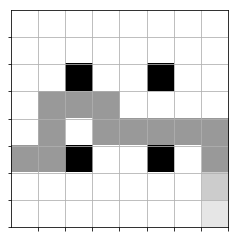

In [11]:
print(play_game(model_v5_1, qmaze, (5,0)))
show(qmaze)

lose


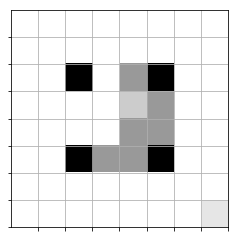

In [12]:
print(play_game(model_v5_1, qmaze, (5,3)))
show(qmaze)

lose


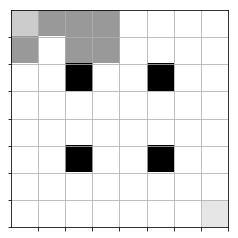

In [13]:
print(play_game(model_v5_1, qmaze, (0,0)))
show(qmaze)

lose


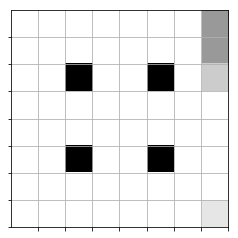

In [14]:
print(play_game(model_v5_1, qmaze, (0,7)))
show(qmaze)

lose


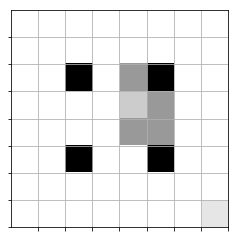

In [15]:
print(play_game(model_v5_1, qmaze, (4,4)))
show(qmaze)

lose


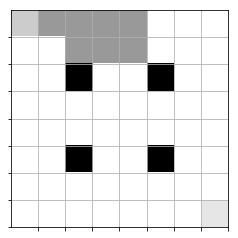

In [16]:
print(play_game(model_v5_1, qmaze, (1,2)))
show(qmaze)

win


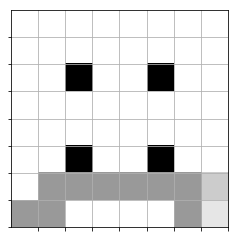

In [17]:
print(play_game(model_v5_1, qmaze, (7,0)))
show(qmaze)

win


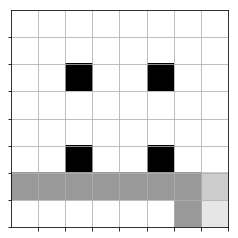

In [18]:
print(play_game(model_v5_1, qmaze, (6,0)))
show(qmaze)

lose


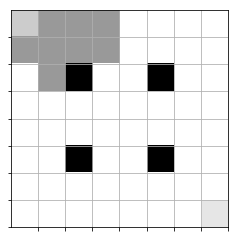

In [19]:
print(play_game(model_v5_1, qmaze, (2,1)))
show(qmaze)

win


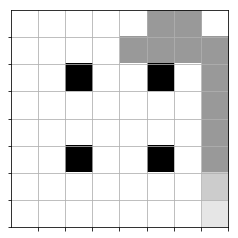

In [20]:
print(play_game(model_v5_1, qmaze, (1,4)))
show(qmaze)

### Result : On playing 10 random games, could win only 4 games.
### Next, will train over 10K games to improve win rate.

In [21]:
model_v5_2 = build_model(maze)
train(model_v5_2, maze, n_epoch=10000, max_memory=8*maze.size, data_size=300, name='model_v5_2')

Epoch: 000/9999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0]
Epoch: 001/9999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0]
Epoch: 002/9999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0, 0]
Epoch: 003/9999 | Loss: 0.0000 | Moves: 11 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0, 0, 0]
Epoch: 004/9999 | Loss: 0.0000 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0]
Epoch: 005/9999 | Loss: 0.0000 | Moves: 12 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0]
Epoch: 006/9999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0]
Epoch: 007/9999 | Loss: 0.0000 | Mo

Epoch: 056/9999 | Loss: 0.0253 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 057/9999 | Loss: 0.0000 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 058/9999 | Loss: 0.0000 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 059/9999 | Loss: 0.0000 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 2.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 102/9999 | Loss: 0.0122 | Moves: 11 | Win count: 0 | Win rate: 0.000 | time: 3.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 103/9999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 3.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 104/9999 | Loss: 0.0000 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 3.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 105/9999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 3.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 133/9999 | Loss: 0.0154 | Moves: 12 | Win count: 0 | Win rate: 0.000 | time: 4.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 134/9999 | Loss: 0.0000 | Moves: 19 | Win count: 0 | Win rate: 0.000 | time: 4.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 135/9999 | Loss: 0.0000 | Moves: 11 | Win count: 0 | Win rate: 0.000 | time: 4.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 136/9999 | Loss: 0.0000 | Moves: 19 | Win count: 0 | Win rate: 0.000 | time: 4.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 193/9999 | Loss: 0.0192 | Moves: 7 | Win count: 1 | Win rate: 0.005 | time: 5.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 194/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1 | Win rate: 0.005 | time: 5.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 195/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1 | Win rate: 0.005 | time: 5.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 196/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1 | Win rate: 0.005 | time: 5.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 231/9999 | Loss: 0.0196 | Moves: 10 | Win count: 2 | Win rate: 0.009 | time: 5.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 232/9999 | Loss: 0.0000 | Moves: 6 | Win count: 2 | Win rate: 0.009 | time: 5.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 233/9999 | Loss: 0.0000 | Moves: 16 | Win count: 2 | Win rate: 0.009 | time: 5.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 234/9999 | Loss: 0.0000 | Moves: 6 | Win count: 2 | Win rate: 0.009 | time: 5.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 265/9999 | Loss: 0.0169 | Moves: 10 | Win count: 2 | Win rate: 0.008 | time: 6.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 266/9999 | Loss: 0.0000 | Moves: 12 | Win count: 2 | Win rate: 0.007 | time: 6.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 267/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2 | Win rate: 0.007 | time: 6.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 268/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2 | Win rate: 0.007 | time: 6.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 297/9999 | Loss: 0.0155 | Moves: 12 | Win count: 2 | Win rate: 0.007 | time: 7.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 298/9999 | Loss: 0.0000 | Moves: 12 | Win count: 2 | Win rate: 0.007 | time: 7.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 299/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2 | Win rate: 0.007 | time: 7.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 300/9999 | Loss: 0.0000 | Moves: 10 | Win count: 2 | Win rate: 0.007 | time: 7.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 327/9999 | Loss: 0.0117 | Moves: 13 | Win count: 3 | Win rate: 0.009 | time: 7.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 328/9999 | Loss: 0.0000 | Moves: 12 | Win count: 3 | Win rate: 0.009 | time: 7.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 329/9999 | Loss: 0.0000 | Moves: 2 | Win count: 3 | Win rate: 0.009 | time: 7.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 330/9999 | Loss: 0.0000 | Moves: 11 | Win count: 3 | Win rate: 0.009 | time: 7.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 365/9999 | Loss: 0.0129 | Moves: 2 | Win count: 3 | Win rate: 0.008 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 366/9999 | Loss: 0.0000 | Moves: 10 | Win count: 3 | Win rate: 0.008 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 367/9999 | Loss: 0.0000 | Moves: 14 | Win count: 3 | Win rate: 0.008 | time: 8.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 368/9999 | Loss: 0.0000 | Moves: 14 | Win count: 3 | Win rate: 0.008 | time: 8.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 420/9999 | Loss: 0.0087 | Moves: 8 | Win count: 3 | Win rate: 0.007 | time: 9.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 421/9999 | Loss: 0.0000 | Moves: 9 | Win count: 3 | Win rate: 0.007 | time: 9.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 422/9999 | Loss: 0.0000 | Moves: 4 | Win count: 3 | Win rate: 0.007 | time: 9.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 423/9999 | Loss: 0.0000 | Moves: 13 | Win count: 3 | Win rate: 0.007 | time: 9.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 453/9999 | Loss: 0.0100 | Moves: 14 | Win count: 3 | Win rate: 0.007 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 454/9999 | Loss: 0.0000 | Moves: 14 | Win count: 3 | Win rate: 0.007 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 455/9999 | Loss: 0.0000 | Moves: 14 | Win count: 3 | Win rate: 0.007 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 456/9999 | Loss: 0.0000 | Moves: 8 | Win count: 3 | Win rate: 0.007 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 506/9999 | Loss: 0.0087 | Moves: 13 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 507/9999 | Loss: 0.0000 | Moves: 9 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 508/9999 | Loss: 0.0000 | Moves: 12 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 509/9999 | Loss: 0.0000 | Moves: 14 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0

Epoch: 564/9999 | Loss: 0.0058 | Moves: 9 | Win count: 4 | Win rate: 0.007 | time: 12.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 565/9999 | Loss: 0.0000 | Moves: 6 | Win count: 4 | Win rate: 0.007 | time: 12.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 566/9999 | Loss: 0.0000 | Moves: 6 | Win count: 4 | Win rate: 0.007 | time: 12.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 567/9999 | Loss: 0.0000 | Moves: 10 | Win count: 4 | Win rate: 0.007 | time: 12.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 601/9999 | Loss: 0.0070 | Moves: 8 | Win count: 4 | Win rate: 0.007 | time: 13.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 602/9999 | Loss: 0.0000 | Moves: 5 | Win count: 4 | Win rate: 0.007 | time: 13.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 603/9999 | Loss: 0.0000 | Moves: 7 | Win count: 4 | Win rate: 0.007 | time: 13.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 604/9999 | Loss: 0.0000 | Moves: 2 | Win count: 4 | Win rate: 0.007 | time: 13.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 647/9999 | Loss: 0.0087 | Moves: 6 | Win count: 5 | Win rate: 0.008 | time: 13.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 648/9999 | Loss: 0.0000 | Moves: 6 | Win count: 5 | Win rate: 0.008 | time: 13.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 649/9999 | Loss: 0.0000 | Moves: 6 | Win count: 5 | Win rate: 0.008 | time: 13.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 650/9999 | Loss: 0.0000 | Moves: 5 | Win count: 5 | Win rate: 0.008 | time: 13.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 682/9999 | Loss: 0.0088 | Moves: 17 | Win count: 5 | Win rate: 0.007 | time: 14.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 683/9999 | Loss: 0.0000 | Moves: 2 | Win count: 5 | Win rate: 0.007 | time: 14.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 684/9999 | Loss: 0.0000 | Moves: 7 | Win count: 5 | Win rate: 0.007 | time: 14.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 685/9999 | Loss: 0.0000 | Moves: 11 | Win count: 5 | Win rate: 0.007 | time: 14.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 722/9999 | Loss: 0.0088 | Moves: 12 | Win count: 6 | Win rate: 0.008 | time: 14.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 723/9999 | Loss: 0.0000 | Moves: 12 | Win count: 6 | Win rate: 0.008 | time: 14.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 724/9999 | Loss: 0.0000 | Moves: 8 | Win count: 6 | Win rate: 0.008 | time: 14.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 725/9999 | Loss: 0.0000 | Moves: 10 | Win count: 6 | Win rate: 0.008 | time: 14.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 752/9999 | Loss: 0.0060 | Moves: 9 | Win count: 6 | Win rate: 0.008 | time: 15.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 753/9999 | Loss: 0.0000 | Moves: 5 | Win count: 6 | Win rate: 0.008 | time: 15.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 754/9999 | Loss: 0.0000 | Moves: 9 | Win count: 6 | Win rate: 0.008 | time: 15.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 755/9999 | Loss: 0.0000 | Moves: 6 | Win count: 6 | Win rate: 0.008 | time: 15.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 785/9999 | Loss: 0.0051 | Moves: 9 | Win count: 6 | Win rate: 0.008 | time: 16.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 786/9999 | Loss: 0.0000 | Moves: 12 | Win count: 6 | Win rate: 0.008 | time: 16.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 787/9999 | Loss: 0.0000 | Moves: 9 | Win count: 6 | Win rate: 0.008 | time: 16.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 788/9999 | Loss: 0.0000 | Moves: 5 | Win count: 6 | Win rate: 0.008 | time: 16.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 822/9999 | Loss: 0.0041 | Moves: 9 | Win count: 6 | Win rate: 0.007 | time: 16.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 823/9999 | Loss: 0.0000 | Moves: 8 | Win count: 6 | Win rate: 0.007 | time: 16.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 824/9999 | Loss: 0.0000 | Moves: 1 | Win count: 6 | Win rate: 0.007 | time: 16.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 825/9999 | Loss: 0.0000 | Moves: 11 | Win count: 6 | Win rate: 0.007 | time: 16.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 854/9999 | Loss: 0.0000 | Moves: 12 | Win count: 6 | Win rate: 0.007 | time: 16.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 855/9999 | Loss: 0.0000 | Moves: 7 | Win count: 6 | Win rate: 0.007 | time: 17.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 856/9999 | Loss: 0.0000 | Moves: 1 | Win count: 6 | Win rate: 0.007 | time: 17.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 857/9999 | Loss: 0.0000 | Moves: 6 | Win count: 6 | Win rate: 0.007 | time: 17.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 908/9999 | Loss: 0.0067 | Moves: 27 | Win count: 8 | Win rate: 0.009 | time: 18.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 909/9999 | Loss: 0.0000 | Moves: 6 | Win count: 8 | Win rate: 0.009 | time: 18.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 910/9999 | Loss: 0.0000 | Moves: 5 | Win count: 8 | Win rate: 0.009 | time: 18.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 911/9999 | Loss: 0.0000 | Moves: 6 | Win count: 8 | Win rate: 0.009 | time: 18.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 

Epoch: 951/9999 | Loss: 0.0000 | Moves: 16 | Win count: 13 | Win rate: 0.014 | time: 18.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1]
Epoch: 952/9999 | Loss: 0.0000 | Moves: 4 | Win count: 13 | Win rate: 0.014 | time: 18.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0]
Epoch: 953/9999 | Loss: 0.0000 | Moves: 5 | Win count: 13 | Win rate: 0.014 | time: 18.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 954/9999 | Loss: 0.0081 | Moves: 9 | Win count: 13 | Win rate: 0.014 | time: 18.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,

Epoch: 999/9999 | Loss: 0.0141 | Moves: 8 | Win count: 13 | Win rate: 0.013 | time: 19.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1000/9999 | Loss: 0.0000 | Moves: 7 | Win count: 13 | Win rate: 0.013 | time: 19.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1001/9999 | Loss: 0.0000 | Moves: 2 | Win count: 13 | Win rate: 0.013 | time: 19.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1002/9999 | Loss: 0.0000 | Moves: 9 | Win count: 13 | Win rate: 0.013 | time: 19.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1062/9999 | Loss: 0.0039 | Moves: 8 | Win count: 15 | Win rate: 0.014 | time: 20.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1063/9999 | Loss: 0.0000 | Moves: 4 | Win count: 15 | Win rate: 0.014 | time: 20.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1064/9999 | Loss: 0.0000 | Moves: 8 | Win count: 15 | Win rate: 0.014 | time: 20.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1065/9999 | Loss: 0.0000 | Moves: 8 | Win count: 15 | Win rate: 0.014 | time: 20.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1113/9999 | Loss: 0.0089 | Moves: 8 | Win count: 15 | Win rate: 0.013 | time: 20.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1114/9999 | Loss: 0.0000 | Moves: 3 | Win count: 15 | Win rate: 0.013 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1115/9999 | Loss: 0.0000 | Moves: 5 | Win count: 15 | Win rate: 0.013 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1116/9999 | Loss: 0.0000 | Moves: 13 | Win count: 15 | Win rate: 0.013 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1155/9999 | Loss: 0.0035 | Moves: 8 | Win count: 15 | Win rate: 0.013 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1156/9999 | Loss: 0.0000 | Moves: 6 | Win count: 15 | Win rate: 0.013 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1157/9999 | Loss: 0.0000 | Moves: 3 | Win count: 15 | Win rate: 0.013 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1158/9999 | Loss: 0.0000 | Moves: 6 | Win count: 15 | Win rate: 0.013 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1192/9999 | Loss: 0.0024 | Moves: 12 | Win count: 15 | Win rate: 0.013 | time: 21.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1193/9999 | Loss: 0.0000 | Moves: 6 | Win count: 15 | Win rate: 0.013 | time: 21.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1194/9999 | Loss: 0.0000 | Moves: 6 | Win count: 15 | Win rate: 0.013 | time: 21.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1195/9999 | Loss: 0.0000 | Moves: 4 | Win count: 15 | Win rate: 0.013 | time: 21.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1253/9999 | Loss: 0.0029 | Moves: 32 | Win count: 17 | Win rate: 0.014 | time: 23.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 1254/9999 | Loss: 0.0000 | Moves: 6 | Win count: 17 | Win rate: 0.014 | time: 23.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 1255/9999 | Loss: 0.0000 | Moves: 56 | Win count: 17 | Win rate: 0.014 | time: 23.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 1256/9999 | Loss: 0.0000 | Moves: 3 | Win count: 17 | Win rate: 0.014 | time: 23.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1335/9999 | Loss: 0.0054 | Moves: 9 | Win count: 22 | Win rate: 0.016 | time: 24.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 1336/9999 | Loss: 0.0000 | Moves: 8 | Win count: 22 | Win rate: 0.016 | time: 24.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 1337/9999 | Loss: 0.0000 | Moves: 8 | Win count: 22 | Win rate: 0.016 | time: 24.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 1338/9999 | Loss: 0.0000 | Moves: 5 | Win count: 22 | Win rate: 0.016 | time: 24.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,

Epoch: 1385/9999 | Loss: 0.0192 | Moves: 11 | Win count: 25 | Win rate: 0.018 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1386/9999 | Loss: 0.0000 | Moves: 11 | Win count: 25 | Win rate: 0.018 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1387/9999 | Loss: 0.0000 | Moves: 13 | Win count: 25 | Win rate: 0.018 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1388/9999 | Loss: 0.0000 | Moves: 9 | Win count: 25 | Win rate: 0.018 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1421/9999 | Loss: 0.0086 | Moves: 10 | Win count: 26 | Win rate: 0.018 | time: 25.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1422/9999 | Loss: 0.0000 | Moves: 3 | Win count: 26 | Win rate: 0.018 | time: 25.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1423/9999 | Loss: 0.0000 | Moves: 7 | Win count: 26 | Win rate: 0.018 | time: 25.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1424/9999 | Loss: 0.0000 | Moves: 7 | Win count: 26 | Win rate: 0.018 | time: 25.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1459/9999 | Loss: 0.0060 | Moves: 14 | Win count: 26 | Win rate: 0.018 | time: 26.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1460/9999 | Loss: 0.0000 | Moves: 8 | Win count: 26 | Win rate: 0.018 | time: 26.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1461/9999 | Loss: 0.0000 | Moves: 12 | Win count: 26 | Win rate: 0.018 | time: 26.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1462/9999 | Loss: 0.0000 | Moves: 7 | Win count: 26 | Win rate: 0.018 | time: 26.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1508/9999 | Loss: 0.0027 | Moves: 6 | Win count: 29 | Win rate: 0.019 | time: 26.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1509/9999 | Loss: 0.0000 | Moves: 11 | Win count: 29 | Win rate: 0.019 | time: 26.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1510/9999 | Loss: 0.0000 | Moves: 3 | Win count: 29 | Win rate: 0.019 | time: 26.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1511/9999 | Loss: 0.0000 | Moves: 2 | Win count: 29 | Win rate: 0.019 | time: 26.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1543/9999 | Loss: 0.0128 | Moves: 17 | Win count: 31 | Win rate: 0.020 | time: 27.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1544/9999 | Loss: 0.0000 | Moves: 10 | Win count: 31 | Win rate: 0.020 | time: 27.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1545/9999 | Loss: 0.0000 | Moves: 8 | Win count: 31 | Win rate: 0.020 | time: 27.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1546/9999 | Loss: 0.0000 | Moves: 3 | Win count: 31 | Win rate: 0.020 | time: 27.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1584/9999 | Loss: 0.0104 | Moves: 3 | Win count: 32 | Win rate: 0.020 | time: 28.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1585/9999 | Loss: 0.0000 | Moves: 5 | Win count: 32 | Win rate: 0.020 | time: 28.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1586/9999 | Loss: 0.0000 | Moves: 5 | Win count: 32 | Win rate: 0.020 | time: 28.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1587/9999 | Loss: 0.0000 | Moves: 5 | Win count: 32 | Win rate: 0.020 | time: 28.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1639/9999 | Loss: 0.0069 | Moves: 2 | Win count: 35 | Win rate: 0.021 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1640/9999 | Loss: 0.0000 | Moves: 5 | Win count: 35 | Win rate: 0.021 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1641/9999 | Loss: 0.0000 | Moves: 7 | Win count: 35 | Win rate: 0.021 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1642/9999 | Loss: 0.0000 | Moves: 1 | Win count: 36 | Win rate: 0.022 | time: 28.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0,

Epoch: 1701/9999 | Loss: 0.0176 | Moves: 7 | Win count: 38 | Win rate: 0.022 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1702/9999 | Loss: 0.0000 | Moves: 11 | Win count: 39 | Win rate: 0.023 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 1703/9999 | Loss: 0.0000 | Moves: 8 | Win count: 39 | Win rate: 0.023 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 1704/9999 | Loss: 0.0000 | Moves: 7 | Win count: 39 | Win rate: 0.023 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1759/9999 | Loss: 0.0085 | Moves: 4 | Win count: 42 | Win rate: 0.024 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1760/9999 | Loss: 0.0000 | Moves: 5 | Win count: 42 | Win rate: 0.024 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1761/9999 | Loss: 0.0000 | Moves: 9 | Win count: 42 | Win rate: 0.024 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1762/9999 | Loss: 0.0000 | Moves: 4 | Win count: 42 | Win rate: 0.024 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1816/9999 | Loss: 0.0125 | Moves: 5 | Win count: 51 | Win rate: 0.028 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 1817/9999 | Loss: 0.0000 | Moves: 6 | Win count: 51 | Win rate: 0.028 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 1818/9999 | Loss: 0.0000 | Moves: 7 | Win count: 51 | Win rate: 0.028 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 1819/9999 | Loss: 0.0000 | Moves: 8 | Win count: 51 | Win rate: 0.028 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,

Epoch: 1866/9999 | Loss: 0.0089 | Moves: 7 | Win count: 51 | Win rate: 0.027 | time: 31.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1867/9999 | Loss: 0.0000 | Moves: 4 | Win count: 51 | Win rate: 0.027 | time: 31.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1868/9999 | Loss: 0.0000 | Moves: 4 | Win count: 51 | Win rate: 0.027 | time: 31.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1869/9999 | Loss: 0.0000 | Moves: 4 | Win count: 51 | Win rate: 0.027 | time: 31.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1912/9999 | Loss: 0.0069 | Moves: 4 | Win count: 58 | Win rate: 0.030 | time: 31.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1913/9999 | Loss: 0.0000 | Moves: 5 | Win count: 58 | Win rate: 0.030 | time: 31.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1914/9999 | Loss: 0.0000 | Moves: 7 | Win count: 58 | Win rate: 0.030 | time: 31.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1915/9999 | Loss: 0.0000 | Moves: 6 | Win count: 58 | Win rate: 0.030 | time: 31.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

Epoch: 1972/9999 | Loss: 0.0242 | Moves: 3 | Win count: 66 | Win rate: 0.033 | time: 32.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 1973/9999 | Loss: 0.0000 | Moves: 10 | Win count: 66 | Win rate: 0.033 | time: 32.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1974/9999 | Loss: 0.0000 | Moves: 11 | Win count: 66 | Win rate: 0.033 | time: 32.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1975/9999 | Loss: 0.0000 | Moves: 8 | Win count: 66 | Win rate: 0.033 | time: 32.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2024/9999 | Loss: 0.0231 | Moves: 4 | Win count: 67 | Win rate: 0.033 | time: 33.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2025/9999 | Loss: 0.0000 | Moves: 2 | Win count: 67 | Win rate: 0.033 | time: 33.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2026/9999 | Loss: 0.0000 | Moves: 7 | Win count: 67 | Win rate: 0.033 | time: 33.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2027/9999 | Loss: 0.0000 | Moves: 7 | Win count: 67 | Win rate: 0.033 | time: 33.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2066/9999 | Loss: 0.0000 | Moves: 10 | Win count: 68 | Win rate: 0.033 | time: 33.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2067/9999 | Loss: 0.0000 | Moves: 4 | Win count: 68 | Win rate: 0.033 | time: 33.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2068/9999 | Loss: 0.0000 | Moves: 1 | Win count: 68 | Win rate: 0.033 | time: 33.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2069/9999 | Loss: 0.0000 | Moves: 3 | Win count: 68 | Win rate: 0.033 | time: 33.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0

Epoch: 2151/9999 | Loss: 0.0036 | Moves: 6 | Win count: 73 | Win rate: 0.034 | time: 34.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2152/9999 | Loss: 0.0000 | Moves: 3 | Win count: 74 | Win rate: 0.034 | time: 34.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 2153/9999 | Loss: 0.0000 | Moves: 4 | Win count: 74 | Win rate: 0.034 | time: 34.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0]
Epoch: 2154/9999 | Loss: 0.0000 | Moves: 6 | Win count: 74 | Win rate: 0.034 | time: 34.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2216/9999 | Loss: 0.0064 | Moves: 6 | Win count: 82 | Win rate: 0.037 | time: 35.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2217/9999 | Loss: 0.0000 | Moves: 4 | Win count: 82 | Win rate: 0.037 | time: 35.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2218/9999 | Loss: 0.0000 | Moves: 1 | Win count: 82 | Win rate: 0.037 | time: 35.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2219/9999 | Loss: 0.0000 | Moves: 8 | Win count: 82 | Win rate: 0.037 | time: 35.0 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0,

Epoch: 2271/9999 | Loss: 0.0159 | Moves: 7 | Win count: 84 | Win rate: 0.037 | time: 35.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2272/9999 | Loss: 0.0000 | Moves: 5 | Win count: 84 | Win rate: 0.037 | time: 35.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2273/9999 | Loss: 0.0000 | Moves: 10 | Win count: 84 | Win rate: 0.037 | time: 35.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2274/9999 | Loss: 0.0000 | Moves: 3 | Win count: 84 | Win rate: 0.037 | time: 35.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1

Epoch: 2321/9999 | Loss: 0.0091 | Moves: 4 | Win count: 86 | Win rate: 0.037 | time: 36.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2322/9999 | Loss: 0.0000 | Moves: 8 | Win count: 86 | Win rate: 0.037 | time: 36.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2323/9999 | Loss: 0.0000 | Moves: 5 | Win count: 87 | Win rate: 0.037 | time: 36.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2324/9999 | Loss: 0.0000 | Moves: 3 | Win count: 88 | Win rate: 0.038 | time: 36.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2372/9999 | Loss: 0.0056 | Moves: 9 | Win count: 92 | Win rate: 0.039 | time: 36.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2373/9999 | Loss: 0.0000 | Moves: 4 | Win count: 92 | Win rate: 0.039 | time: 36.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2374/9999 | Loss: 0.0000 | Moves: 1 | Win count: 92 | Win rate: 0.039 | time: 36.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2375/9999 | Loss: 0.0000 | Moves: 3 | Win count: 92 | Win rate: 0.039 | time: 36.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,

Epoch: 2420/9999 | Loss: 0.0084 | Moves: 11 | Win count: 94 | Win rate: 0.039 | time: 37.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2421/9999 | Loss: 0.0000 | Moves: 11 | Win count: 94 | Win rate: 0.039 | time: 37.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2422/9999 | Loss: 0.0000 | Moves: 13 | Win count: 94 | Win rate: 0.039 | time: 37.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2423/9999 | Loss: 0.0000 | Moves: 3 | Win count: 95 | Win rate: 0.039 | time: 37.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2452/9999 | Loss: 0.0055 | Moves: 10 | Win count: 97 | Win rate: 0.040 | time: 38.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2453/9999 | Loss: 0.0000 | Moves: 15 | Win count: 97 | Win rate: 0.040 | time: 38.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2454/9999 | Loss: 0.0000 | Moves: 9 | Win count: 97 | Win rate: 0.040 | time: 38.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2455/9999 | Loss: 0.0000 | Moves: 9 | Win count: 97 | Win rate: 0.039 | time: 38.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2518/9999 | Loss: 0.0038 | Moves: 8 | Win count: 99 | Win rate: 0.039 | time: 39.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2519/9999 | Loss: 0.0000 | Moves: 6 | Win count: 99 | Win rate: 0.039 | time: 39.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2520/9999 | Loss: 0.0000 | Moves: 5 | Win count: 99 | Win rate: 0.039 | time: 39.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2521/9999 | Loss: 0.0000 | Moves: 13 | Win count: 99 | Win rate: 0.039 | time: 39.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2560/9999 | Loss: 0.0052 | Moves: 13 | Win count: 102 | Win rate: 0.040 | time: 39.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2561/9999 | Loss: 0.0000 | Moves: 3 | Win count: 102 | Win rate: 0.040 | time: 39.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2562/9999 | Loss: 0.0000 | Moves: 11 | Win count: 102 | Win rate: 0.040 | time: 39.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2563/9999 | Loss: 0.0000 | Moves: 9 | Win count: 102 | Win rate: 0.040 | time: 39.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2606/9999 | Loss: 0.0081 | Moves: 8 | Win count: 107 | Win rate: 0.041 | time: 40.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2607/9999 | Loss: 0.0000 | Moves: 11 | Win count: 107 | Win rate: 0.041 | time: 40.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2608/9999 | Loss: 0.0000 | Moves: 1 | Win count: 108 | Win rate: 0.041 | time: 40.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 2609/9999 | Loss: 0.0000 | Moves: 5 | Win count: 108 | Win rate: 0.041 | time: 40.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2651/9999 | Loss: 0.0099 | Moves: 19 | Win count: 112 | Win rate: 0.042 | time: 41.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2652/9999 | Loss: 0.0000 | Moves: 14 | Win count: 112 | Win rate: 0.042 | time: 41.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2653/9999 | Loss: 0.0000 | Moves: 2 | Win count: 112 | Win rate: 0.042 | time: 41.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2654/9999 | Loss: 0.0000 | Moves: 16 | Win count: 112 | Win rate: 0.042 | time: 41.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0

Epoch: 2681/9999 | Loss: 0.0055 | Moves: 15 | Win count: 114 | Win rate: 0.043 | time: 41.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2682/9999 | Loss: 0.0000 | Moves: 14 | Win count: 114 | Win rate: 0.042 | time: 41.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2683/9999 | Loss: 0.0000 | Moves: 7 | Win count: 115 | Win rate: 0.043 | time: 41.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2684/9999 | Loss: 0.0000 | Moves: 5 | Win count: 115 | Win rate: 0.043 | time: 41.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2728/9999 | Loss: 0.0069 | Moves: 7 | Win count: 120 | Win rate: 0.044 | time: 42.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2729/9999 | Loss: 0.0000 | Moves: 10 | Win count: 120 | Win rate: 0.044 | time: 42.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2730/9999 | Loss: 0.0000 | Moves: 8 | Win count: 120 | Win rate: 0.044 | time: 42.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2731/9999 | Loss: 0.0000 | Moves: 8 | Win count: 120 | Win rate: 0.044 | time: 42.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 

Epoch: 2768/9999 | Loss: 0.0141 | Moves: 10 | Win count: 123 | Win rate: 0.044 | time: 42.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2769/9999 | Loss: 0.0000 | Moves: 11 | Win count: 123 | Win rate: 0.044 | time: 42.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2770/9999 | Loss: 0.0000 | Moves: 9 | Win count: 123 | Win rate: 0.044 | time: 42.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2771/9999 | Loss: 0.0000 | Moves: 8 | Win count: 123 | Win rate: 0.044 | time: 42.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,

Epoch: 2809/9999 | Loss: 0.0059 | Moves: 9 | Win count: 125 | Win rate: 0.044 | time: 43.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2810/9999 | Loss: 0.0000 | Moves: 10 | Win count: 125 | Win rate: 0.044 | time: 43.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2811/9999 | Loss: 0.0000 | Moves: 8 | Win count: 125 | Win rate: 0.044 | time: 43.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2812/9999 | Loss: 0.0000 | Moves: 3 | Win count: 125 | Win rate: 0.044 | time: 43.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2844/9999 | Loss: 0.0044 | Moves: 9 | Win count: 127 | Win rate: 0.045 | time: 44.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2845/9999 | Loss: 0.0000 | Moves: 14 | Win count: 127 | Win rate: 0.045 | time: 44.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2846/9999 | Loss: 0.0000 | Moves: 5 | Win count: 128 | Win rate: 0.045 | time: 44.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2847/9999 | Loss: 0.0000 | Moves: 9 | Win count: 128 | Win rate: 0.045 | time: 44.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 

Epoch: 2882/9999 | Loss: 0.0062 | Moves: 3 | Win count: 131 | Win rate: 0.045 | time: 44.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2883/9999 | Loss: 0.0000 | Moves: 10 | Win count: 131 | Win rate: 0.045 | time: 44.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2884/9999 | Loss: 0.0000 | Moves: 8 | Win count: 131 | Win rate: 0.045 | time: 44.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2885/9999 | Loss: 0.0000 | Moves: 2 | Win count: 131 | Win rate: 0.045 | time: 44.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 

Epoch: 2934/9999 | Loss: 0.0073 | Moves: 11 | Win count: 135 | Win rate: 0.046 | time: 45.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2935/9999 | Loss: 0.0000 | Moves: 6 | Win count: 135 | Win rate: 0.046 | time: 45.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2936/9999 | Loss: 0.0000 | Moves: 8 | Win count: 135 | Win rate: 0.046 | time: 45.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2937/9999 | Loss: 0.0000 | Moves: 8 | Win count: 135 | Win rate: 0.046 | time: 45.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 2974/9999 | Loss: 0.0105 | Moves: 10 | Win count: 138 | Win rate: 0.046 | time: 45.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2975/9999 | Loss: 0.0000 | Moves: 6 | Win count: 138 | Win rate: 0.046 | time: 45.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2976/9999 | Loss: 0.0000 | Moves: 9 | Win count: 138 | Win rate: 0.046 | time: 45.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2977/9999 | Loss: 0.0000 | Moves: 3 | Win count: 138 | Win rate: 0.046 | time: 45.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3024/9999 | Loss: 0.0078 | Moves: 6 | Win count: 142 | Win rate: 0.047 | time: 46.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3025/9999 | Loss: 0.0000 | Moves: 5 | Win count: 142 | Win rate: 0.047 | time: 46.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3026/9999 | Loss: 0.0000 | Moves: 9 | Win count: 143 | Win rate: 0.047 | time: 46.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3027/9999 | Loss: 0.0000 | Moves: 5 | Win count: 143 | Win rate: 0.047 | time: 46.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3080/9999 | Loss: 0.0000 | Moves: 6 | Win count: 151 | Win rate: 0.049 | time: 46.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3081/9999 | Loss: 0.0329 | Moves: 4 | Win count: 151 | Win rate: 0.049 | time: 47.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3082/9999 | Loss: 0.0000 | Moves: 6 | Win count: 151 | Win rate: 0.049 | time: 47.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3083/9999 | Loss: 0.0000 | Moves: 6 | Win count: 151 | Win rate: 0.049 | time: 47.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1

Epoch: 3134/9999 | Loss: 0.0000 | Moves: 6 | Win count: 156 | Win rate: 0.050 | time: 47.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 3135/9999 | Loss: 0.0145 | Moves: 11 | Win count: 156 | Win rate: 0.050 | time: 47.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 3136/9999 | Loss: 0.0000 | Moves: 12 | Win count: 156 | Win rate: 0.050 | time: 47.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 3137/9999 | Loss: 0.0000 | Moves: 12 | Win count: 156 | Win rate: 0.050 | time: 47.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0

Epoch: 3165/9999 | Loss: 0.0144 | Moves: 14 | Win count: 157 | Win rate: 0.050 | time: 48.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3166/9999 | Loss: 0.0000 | Moves: 5 | Win count: 157 | Win rate: 0.050 | time: 48.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3167/9999 | Loss: 0.0000 | Moves: 14 | Win count: 157 | Win rate: 0.050 | time: 48.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3168/9999 | Loss: 0.0000 | Moves: 14 | Win count: 157 | Win rate: 0.050 | time: 48.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3218/9999 | Loss: 0.0000 | Moves: 13 | Win count: 162 | Win rate: 0.050 | time: 49.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3219/9999 | Loss: 0.0000 | Moves: 12 | Win count: 162 | Win rate: 0.050 | time: 49.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3220/9999 | Loss: 0.0000 | Moves: 2 | Win count: 162 | Win rate: 0.050 | time: 49.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3221/9999 | Loss: 0.0000 | Moves: 11 | Win count: 162 | Win rate: 0.050 | time: 49.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3260/9999 | Loss: 0.0064 | Moves: 14 | Win count: 164 | Win rate: 0.050 | time: 50.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3261/9999 | Loss: 0.0000 | Moves: 8 | Win count: 164 | Win rate: 0.050 | time: 50.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3262/9999 | Loss: 0.0000 | Moves: 7 | Win count: 164 | Win rate: 0.050 | time: 50.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3263/9999 | Loss: 0.0000 | Moves: 1 | Win count: 165 | Win rate: 0.051 | time: 50.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 

Epoch: 3310/9999 | Loss: 0.0090 | Moves: 9 | Win count: 167 | Win rate: 0.050 | time: 50.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3311/9999 | Loss: 0.0000 | Moves: 5 | Win count: 167 | Win rate: 0.050 | time: 50.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3312/9999 | Loss: 0.0000 | Moves: 4 | Win count: 167 | Win rate: 0.050 | time: 50.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3313/9999 | Loss: 0.0000 | Moves: 5 | Win count: 167 | Win rate: 0.050 | time: 50.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3361/9999 | Loss: 0.0026 | Moves: 5 | Win count: 169 | Win rate: 0.050 | time: 51.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3362/9999 | Loss: 0.0000 | Moves: 5 | Win count: 169 | Win rate: 0.050 | time: 51.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3363/9999 | Loss: 0.0000 | Moves: 4 | Win count: 169 | Win rate: 0.050 | time: 51.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3364/9999 | Loss: 0.0000 | Moves: 5 | Win count: 170 | Win rate: 0.051 | time: 51.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3413/9999 | Loss: 0.0000 | Moves: 6 | Win count: 176 | Win rate: 0.052 | time: 51.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 3414/9999 | Loss: 0.0094 | Moves: 8 | Win count: 176 | Win rate: 0.052 | time: 52.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 3415/9999 | Loss: 0.0000 | Moves: 5 | Win count: 176 | Win rate: 0.052 | time: 52.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 3416/9999 | Loss: 0.0000 | Moves: 5 | Win count: 176 | Win rate: 0.052 | time: 52.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1

Epoch: 3471/9999 | Loss: 0.0244 | Moves: 11 | Win count: 182 | Win rate: 0.052 | time: 52.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3472/9999 | Loss: 0.0000 | Moves: 6 | Win count: 182 | Win rate: 0.052 | time: 52.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 3473/9999 | Loss: 0.0000 | Moves: 8 | Win count: 182 | Win rate: 0.052 | time: 52.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 3474/9999 | Loss: 0.0000 | Moves: 1 | Win count: 182 | Win rate: 0.052 | time: 52.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3527/9999 | Loss: 0.0075 | Moves: 8 | Win count: 185 | Win rate: 0.052 | time: 53.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 3528/9999 | Loss: 0.0000 | Moves: 5 | Win count: 185 | Win rate: 0.052 | time: 53.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3529/9999 | Loss: 0.0000 | Moves: 7 | Win count: 185 | Win rate: 0.052 | time: 53.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3530/9999 | Loss: 0.0000 | Moves: 2 | Win count: 185 | Win rate: 0.052 | time: 53.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0

Epoch: 3589/9999 | Loss: 0.0149 | Moves: 7 | Win count: 193 | Win rate: 0.054 | time: 53.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1]
Epoch: 3590/9999 | Loss: 0.0000 | Moves: 2 | Win count: 193 | Win rate: 0.054 | time: 53.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0]
Epoch: 3591/9999 | Loss: 0.0000 | Moves: 2 | Win count: 193 | Win rate: 0.054 | time: 53.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0]
Epoch: 3592/9999 | Loss: 0.0000 | Moves: 6 | Win count: 193 | Win rate: 0.054 | time: 53.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3646/9999 | Loss: 0.0150 | Moves: 7 | Win count: 205 | Win rate: 0.056 | time: 54.5 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3647/9999 | Loss: 0.0000 | Moves: 5 | Win count: 205 | Win rate: 0.056 | time: 54.5 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3648/9999 | Loss: 0.0000 | Moves: 5 | Win count: 205 | Win rate: 0.056 | time: 54.5 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3649/9999 | Loss: 0.0000 | Moves: 5 | Win count: 205 | Win rate: 0.056 | time: 54.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1

Epoch: 3704/9999 | Loss: 0.0116 | Moves: 7 | Win count: 214 | Win rate: 0.058 | time: 55.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1]
Epoch: 3705/9999 | Loss: 0.0000 | Moves: 10 | Win count: 214 | Win rate: 0.058 | time: 55.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0]
Epoch: 3706/9999 | Loss: 0.0000 | Moves: 5 | Win count: 214 | Win rate: 0.058 | time: 55.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0]
Epoch: 3707/9999 | Loss: 0.0000 | Moves: 11 | Win count: 215 | Win rate: 0.058 | time: 55.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

Epoch: 3757/9999 | Loss: 0.0238 | Moves: 11 | Win count: 223 | Win rate: 0.059 | time: 55.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1]
Epoch: 3758/9999 | Loss: 0.0000 | Moves: 4 | Win count: 223 | Win rate: 0.059 | time: 55.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0]
Epoch: 3759/9999 | Loss: 0.0000 | Moves: 5 | Win count: 223 | Win rate: 0.059 | time: 55.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0]
Epoch: 3760/9999 | Loss: 0.0000 | Moves: 6 | Win count: 223 | Win rate: 0.059 | time: 55.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 3812/9999 | Loss: 0.0101 | Moves: 11 | Win count: 227 | Win rate: 0.060 | time: 56.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3813/9999 | Loss: 0.0000 | Moves: 8 | Win count: 227 | Win rate: 0.060 | time: 56.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3814/9999 | Loss: 0.0000 | Moves: 9 | Win count: 227 | Win rate: 0.060 | time: 56.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3815/9999 | Loss: 0.0000 | Moves: 4 | Win count: 227 | Win rate: 0.059 | time: 56.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3864/9999 | Loss: 0.0143 | Moves: 5 | Win count: 232 | Win rate: 0.060 | time: 56.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3865/9999 | Loss: 0.0000 | Moves: 1 | Win count: 232 | Win rate: 0.060 | time: 56.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3866/9999 | Loss: 0.0000 | Moves: 7 | Win count: 233 | Win rate: 0.060 | time: 56.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3867/9999 | Loss: 0.0000 | Moves: 1 | Win count: 233 | Win rate: 0.060 | time: 56.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0

Epoch: 3919/9999 | Loss: 0.0000 | Moves: 7 | Win count: 240 | Win rate: 0.061 | time: 57.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 3920/9999 | Loss: 0.0000 | Moves: 6 | Win count: 240 | Win rate: 0.061 | time: 57.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 3921/9999 | Loss: 0.0075 | Moves: 3 | Win count: 240 | Win rate: 0.061 | time: 57.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 3922/9999 | Loss: 0.0000 | Moves: 7 | Win count: 240 | Win rate: 0.061 | time: 57.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3973/9999 | Loss: 0.0140 | Moves: 5 | Win count: 246 | Win rate: 0.062 | time: 58.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 3974/9999 | Loss: 0.0000 | Moves: 4 | Win count: 246 | Win rate: 0.062 | time: 58.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3975/9999 | Loss: 0.0000 | Moves: 6 | Win count: 246 | Win rate: 0.062 | time: 58.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3976/9999 | Loss: 0.0000 | Moves: 4 | Win count: 246 | Win rate: 0.062 | time: 58.2 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0

Epoch: 4036/9999 | Loss: 0.0000 | Moves: 5 | Win count: 252 | Win rate: 0.062 | time: 58.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4037/9999 | Loss: 0.0000 | Moves: 3 | Win count: 252 | Win rate: 0.062 | time: 58.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4038/9999 | Loss: 0.0000 | Moves: 4 | Win count: 252 | Win rate: 0.062 | time: 58.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4039/9999 | Loss: 0.0000 | Moves: 5 | Win count: 252 | Win rate: 0.062 | time: 58.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 4096/9999 | Loss: 0.0080 | Moves: 5 | Win count: 260 | Win rate: 0.063 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4097/9999 | Loss: 0.0000 | Moves: 4 | Win count: 260 | Win rate: 0.063 | time: 59.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4098/9999 | Loss: 0.0000 | Moves: 11 | Win count: 260 | Win rate: 0.063 | time: 59.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4099/9999 | Loss: 0.0000 | Moves: 1 | Win count: 261 | Win rate: 0.064 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 4145/9999 | Loss: 0.0141 | Moves: 7 | Win count: 271 | Win rate: 0.065 | time: 59.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 4146/9999 | Loss: 0.0000 | Moves: 4 | Win count: 271 | Win rate: 0.065 | time: 59.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 4147/9999 | Loss: 0.0000 | Moves: 6 | Win count: 271 | Win rate: 0.065 | time: 59.9 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4148/9999 | Loss: 0.0000 | Moves: 7 | Win count: 271 | Win rate: 0.065 | time: 59.9 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0

Epoch: 4204/9999 | Loss: 0.0128 | Moves: 5 | Win count: 277 | Win rate: 0.066 | time: 60.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4205/9999 | Loss: 0.0000 | Moves: 5 | Win count: 277 | Win rate: 0.066 | time: 60.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 4206/9999 | Loss: 0.0000 | Moves: 3 | Win count: 277 | Win rate: 0.066 | time: 60.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4207/9999 | Loss: 0.0000 | Moves: 8 | Win count: 277 | Win rate: 0.066 | time: 60.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 4258/9999 | Loss: 0.0053 | Moves: 4 | Win count: 281 | Win rate: 0.066 | time: 61.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4259/9999 | Loss: 0.0000 | Moves: 3 | Win count: 281 | Win rate: 0.066 | time: 61.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4260/9999 | Loss: 0.0000 | Moves: 5 | Win count: 281 | Win rate: 0.066 | time: 61.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4261/9999 | Loss: 0.0000 | Moves: 6 | Win count: 281 | Win rate: 0.066 | time: 61.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0

Epoch: 4313/9999 | Loss: 0.0053 | Moves: 15 | Win count: 286 | Win rate: 0.066 | time: 61.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4314/9999 | Loss: 0.0000 | Moves: 7 | Win count: 286 | Win rate: 0.066 | time: 61.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4315/9999 | Loss: 0.0000 | Moves: 2 | Win count: 286 | Win rate: 0.066 | time: 61.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4316/9999 | Loss: 0.0000 | Moves: 5 | Win count: 287 | Win rate: 0.066 | time: 61.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 4343/9999 | Loss: 0.0141 | Moves: 8 | Win count: 288 | Win rate: 0.066 | time: 62.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4344/9999 | Loss: 0.0000 | Moves: 10 | Win count: 288 | Win rate: 0.066 | time: 62.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4345/9999 | Loss: 0.0000 | Moves: 3 | Win count: 288 | Win rate: 0.066 | time: 62.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4346/9999 | Loss: 0.0000 | Moves: 11 | Win count: 289 | Win rate: 0.066 | time: 62.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,

Epoch: 4391/9999 | Loss: 0.0145 | Moves: 11 | Win count: 299 | Win rate: 0.068 | time: 63.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 4392/9999 | Loss: 0.0000 | Moves: 5 | Win count: 299 | Win rate: 0.068 | time: 63.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 4393/9999 | Loss: 0.0000 | Moves: 1 | Win count: 299 | Win rate: 0.068 | time: 63.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 4394/9999 | Loss: 0.0000 | Moves: 5 | Win count: 299 | Win rate: 0.068 | time: 63.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 

Epoch: 4440/9999 | Loss: 0.0198 | Moves: 7 | Win count: 309 | Win rate: 0.070 | time: 63.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 4441/9999 | Loss: 0.0000 | Moves: 9 | Win count: 309 | Win rate: 0.070 | time: 63.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4442/9999 | Loss: 0.0000 | Moves: 3 | Win count: 309 | Win rate: 0.070 | time: 63.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 4443/9999 | Loss: 0.0000 | Moves: 5 | Win count: 310 | Win rate: 0.070 | time: 63.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0

Epoch: 4493/9999 | Loss: 0.0177 | Moves: 9 | Win count: 316 | Win rate: 0.070 | time: 64.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4494/9999 | Loss: 0.0000 | Moves: 7 | Win count: 317 | Win rate: 0.071 | time: 64.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4495/9999 | Loss: 0.0000 | Moves: 5 | Win count: 317 | Win rate: 0.071 | time: 64.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4496/9999 | Loss: 0.0000 | Moves: 12 | Win count: 317 | Win rate: 0.070 | time: 64.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 4546/9999 | Loss: 0.0000 | Moves: 6 | Win count: 330 | Win rate: 0.073 | time: 64.4 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4547/9999 | Loss: 0.0000 | Moves: 6 | Win count: 330 | Win rate: 0.073 | time: 64.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4548/9999 | Loss: 0.0102 | Moves: 17 | Win count: 331 | Win rate: 0.073 | time: 64.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4549/9999 | Loss: 0.0000 | Moves: 5 | Win count: 331 | Win rate: 0.073 | time: 64.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 4588/9999 | Loss: 0.0000 | Moves: 10 | Win count: 338 | Win rate: 0.074 | time: 65.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4589/9999 | Loss: 0.0000 | Moves: 9 | Win count: 339 | Win rate: 0.074 | time: 65.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4590/9999 | Loss: 0.0000 | Moves: 6 | Win count: 339 | Win rate: 0.074 | time: 65.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4591/9999 | Loss: 0.0000 | Moves: 17 | Win count: 340 | Win rate: 0.074 | time: 65.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0,

Epoch: 4650/9999 | Loss: 0.0145 | Moves: 3 | Win count: 353 | Win rate: 0.076 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 4651/9999 | Loss: 0.0000 | Moves: 9 | Win count: 354 | Win rate: 0.076 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1]
Epoch: 4652/9999 | Loss: 0.0000 | Moves: 7 | Win count: 355 | Win rate: 0.076 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1]
Epoch: 4653/9999 | Loss: 0.0000 | Moves: 2 | Win count: 355 | Win rate: 0.076 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0

Epoch: 4704/9999 | Loss: 0.0271 | Moves: 7 | Win count: 368 | Win rate: 0.078 | time: 66.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4705/9999 | Loss: 0.0000 | Moves: 5 | Win count: 368 | Win rate: 0.078 | time: 66.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 4706/9999 | Loss: 0.0000 | Moves: 1 | Win count: 368 | Win rate: 0.078 | time: 66.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4707/9999 | Loss: 0.0000 | Moves: 6 | Win count: 368 | Win rate: 0.078 | time: 66.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1

Epoch: 4754/9999 | Loss: 0.0114 | Moves: 20 | Win count: 378 | Win rate: 0.079 | time: 67.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4755/9999 | Loss: 0.0000 | Moves: 8 | Win count: 378 | Win rate: 0.079 | time: 67.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4756/9999 | Loss: 0.0000 | Moves: 7 | Win count: 378 | Win rate: 0.079 | time: 67.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4757/9999 | Loss: 0.0000 | Moves: 5 | Win count: 378 | Win rate: 0.079 | time: 67.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 

Epoch: 4798/9999 | Loss: 0.0158 | Moves: 8 | Win count: 393 | Win rate: 0.082 | time: 68.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 4799/9999 | Loss: 0.0000 | Moves: 5 | Win count: 393 | Win rate: 0.082 | time: 68.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 4800/9999 | Loss: 0.0000 | Moves: 1 | Win count: 394 | Win rate: 0.082 | time: 68.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 4801/9999 | Loss: 0.0000 | Moves: 12 | Win count: 394 | Win rate: 0.082 | time: 68.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 4853/9999 | Loss: 0.0303 | Moves: 15 | Win count: 405 | Win rate: 0.083 | time: 68.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 4854/9999 | Loss: 0.0000 | Moves: 7 | Win count: 405 | Win rate: 0.083 | time: 68.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0]
Epoch: 4855/9999 | Loss: 0.0000 | Moves: 5 | Win count: 405 | Win rate: 0.083 | time: 68.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0]
Epoch: 4856/9999 | Loss: 0.0000 | Moves: 7 | Win count: 405 | Win rate: 0.083 | time: 68.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 

Epoch: 4899/9999 | Loss: 0.0141 | Moves: 5 | Win count: 417 | Win rate: 0.085 | time: 69.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4900/9999 | Loss: 0.0000 | Moves: 6 | Win count: 417 | Win rate: 0.085 | time: 69.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4901/9999 | Loss: 0.0000 | Moves: 5 | Win count: 417 | Win rate: 0.085 | time: 69.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 4902/9999 | Loss: 0.0000 | Moves: 7 | Win count: 417 | Win rate: 0.085 | time: 69.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0

Epoch: 4947/9999 | Loss: 0.0145 | Moves: 4 | Win count: 425 | Win rate: 0.086 | time: 70.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4948/9999 | Loss: 0.0000 | Moves: 7 | Win count: 425 | Win rate: 0.086 | time: 70.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4949/9999 | Loss: 0.0000 | Moves: 13 | Win count: 425 | Win rate: 0.086 | time: 70.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4950/9999 | Loss: 0.0000 | Moves: 5 | Win count: 425 | Win rate: 0.086 | time: 70.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 

Epoch: 4992/9999 | Loss: 0.0245 | Moves: 6 | Win count: 431 | Win rate: 0.086 | time: 70.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4993/9999 | Loss: 0.0000 | Moves: 7 | Win count: 432 | Win rate: 0.087 | time: 70.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4994/9999 | Loss: 0.0000 | Moves: 8 | Win count: 432 | Win rate: 0.086 | time: 70.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4995/9999 | Loss: 0.0000 | Moves: 7 | Win count: 432 | Win rate: 0.086 | time: 70.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0

Epoch: 5043/9999 | Loss: 0.0058 | Moves: 11 | Win count: 440 | Win rate: 0.087 | time: 71.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5044/9999 | Loss: 0.0000 | Moves: 3 | Win count: 440 | Win rate: 0.087 | time: 71.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 5045/9999 | Loss: 0.0000 | Moves: 7 | Win count: 440 | Win rate: 0.087 | time: 71.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5046/9999 | Loss: 0.0000 | Moves: 3 | Win count: 441 | Win rate: 0.087 | time: 71.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 5086/9999 | Loss: 0.0196 | Moves: 12 | Win count: 449 | Win rate: 0.088 | time: 71.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 5087/9999 | Loss: 0.0000 | Moves: 11 | Win count: 450 | Win rate: 0.088 | time: 71.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 5088/9999 | Loss: 0.0000 | Moves: 9 | Win count: 451 | Win rate: 0.089 | time: 71.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1]
Epoch: 5089/9999 | Loss: 0.0000 | Moves: 5 | Win count: 451 | Win rate: 0.089 | time: 71.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1,

Epoch: 5136/9999 | Loss: 0.0183 | Moves: 6 | Win count: 466 | Win rate: 0.091 | time: 72.5 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 5137/9999 | Loss: 0.0000 | Moves: 5 | Win count: 466 | Win rate: 0.091 | time: 72.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5138/9999 | Loss: 0.0000 | Moves: 2 | Win count: 466 | Win rate: 0.091 | time: 72.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5139/9999 | Loss: 0.0000 | Moves: 6 | Win count: 466 | Win rate: 0.091 | time: 72.5 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1

Epoch: 5188/9999 | Loss: 0.0186 | Moves: 5 | Win count: 476 | Win rate: 0.092 | time: 73.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1]
Epoch: 5189/9999 | Loss: 0.0000 | Moves: 5 | Win count: 476 | Win rate: 0.092 | time: 73.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0]
Epoch: 5190/9999 | Loss: 0.0000 | Moves: 13 | Win count: 477 | Win rate: 0.092 | time: 73.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1]
Epoch: 5191/9999 | Loss: 0.0000 | Moves: 7 | Win count: 477 | Win rate: 0.092 | time: 73.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 

Epoch: 5235/9999 | Loss: 0.0109 | Moves: 7 | Win count: 488 | Win rate: 0.093 | time: 73.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1]
Epoch: 5236/9999 | Loss: 0.0000 | Moves: 9 | Win count: 489 | Win rate: 0.093 | time: 73.7 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1]
Epoch: 5237/9999 | Loss: 0.0000 | Moves: 4 | Win count: 489 | Win rate: 0.093 | time: 73.7 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0]
Epoch: 5238/9999 | Loss: 0.0000 | Moves: 6 | Win count: 489 | Win rate: 0.093 | time: 73.7 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 5273/9999 | Loss: 0.0168 | Moves: 8 | Win count: 493 | Win rate: 0.093 | time: 74.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5274/9999 | Loss: 0.0000 | Moves: 8 | Win count: 493 | Win rate: 0.093 | time: 74.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5275/9999 | Loss: 0.0000 | Moves: 3 | Win count: 494 | Win rate: 0.094 | time: 74.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5276/9999 | Loss: 0.0000 | Moves: 3 | Win count: 495 | Win rate: 0.094 | time: 74.3 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0

Epoch: 5319/9999 | Loss: 0.0148 | Moves: 10 | Win count: 502 | Win rate: 0.094 | time: 74.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0]
Epoch: 5320/9999 | Loss: 0.0000 | Moves: 7 | Win count: 503 | Win rate: 0.095 | time: 74.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1]
Epoch: 5321/9999 | Loss: 0.0000 | Moves: 6 | Win count: 503 | Win rate: 0.095 | time: 74.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 5322/9999 | Loss: 0.0000 | Moves: 6 | Win count: 503 | Win rate: 0.094 | time: 74.9 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 

Epoch: 5361/9999 | Loss: 0.0250 | Moves: 13 | Win count: 512 | Win rate: 0.095 | time: 75.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5362/9999 | Loss: 0.0000 | Moves: 3 | Win count: 512 | Win rate: 0.095 | time: 75.5 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 5363/9999 | Loss: 0.0000 | Moves: 6 | Win count: 512 | Win rate: 0.095 | time: 75.5 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5364/9999 | Loss: 0.0000 | Moves: 9 | Win count: 512 | Win rate: 0.095 | time: 75.5 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 5407/9999 | Loss: 0.0135 | Moves: 5 | Win count: 525 | Win rate: 0.097 | time: 76.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5408/9999 | Loss: 0.0000 | Moves: 5 | Win count: 526 | Win rate: 0.097 | time: 76.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5409/9999 | Loss: 0.0000 | Moves: 9 | Win count: 526 | Win rate: 0.097 | time: 76.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 5410/9999 | Loss: 0.0000 | Moves: 9 | Win count: 526 | Win rate: 0.097 | time: 76.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0

Epoch: 5444/9999 | Loss: 0.0181 | Moves: 5 | Win count: 533 | Win rate: 0.098 | time: 76.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1]
Epoch: 5445/9999 | Loss: 0.0000 | Moves: 8 | Win count: 533 | Win rate: 0.098 | time: 76.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0]
Epoch: 5446/9999 | Loss: 0.0000 | Moves: 9 | Win count: 533 | Win rate: 0.098 | time: 76.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0]
Epoch: 5447/9999 | Loss: 0.0000 | Moves: 7 | Win count: 533 | Win rate: 0.098 | time: 76.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0

Epoch: 5491/9999 | Loss: 0.0114 | Moves: 8 | Win count: 544 | Win rate: 0.099 | time: 77.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 5492/9999 | Loss: 0.0000 | Moves: 10 | Win count: 544 | Win rate: 0.099 | time: 77.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5493/9999 | Loss: 0.0000 | Moves: 9 | Win count: 544 | Win rate: 0.099 | time: 77.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5494/9999 | Loss: 0.0000 | Moves: 5 | Win count: 544 | Win rate: 0.099 | time: 77.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 

Epoch: 5533/9999 | Loss: 0.0164 | Moves: 10 | Win count: 555 | Win rate: 0.100 | time: 78.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5534/9999 | Loss: 0.0000 | Moves: 5 | Win count: 555 | Win rate: 0.100 | time: 78.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 5535/9999 | Loss: 0.0000 | Moves: 3 | Win count: 555 | Win rate: 0.100 | time: 78.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5536/9999 | Loss: 0.0000 | Moves: 13 | Win count: 555 | Win rate: 0.100 | time: 78.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,

Epoch: 5571/9999 | Loss: 0.0071 | Moves: 11 | Win count: 566 | Win rate: 0.102 | time: 78.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0]
Epoch: 5572/9999 | Loss: 0.0000 | Moves: 9 | Win count: 566 | Win rate: 0.102 | time: 78.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 5573/9999 | Loss: 0.0000 | Moves: 8 | Win count: 566 | Win rate: 0.102 | time: 78.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5574/9999 | Loss: 0.0000 | Moves: 5 | Win count: 566 | Win rate: 0.102 | time: 78.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 5612/9999 | Loss: 0.0094 | Moves: 12 | Win count: 582 | Win rate: 0.104 | time: 79.2 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0]
Epoch: 5613/9999 | Loss: 0.0000 | Moves: 9 | Win count: 583 | Win rate: 0.104 | time: 79.2 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1]
Epoch: 5614/9999 | Loss: 0.0000 | Moves: 1 | Win count: 583 | Win rate: 0.104 | time: 79.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0]
Epoch: 5615/9999 | Loss: 0.0000 | Moves: 3 | Win count: 584 | Win rate: 0.104 | time: 79.2 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 

Epoch: 5656/9999 | Loss: 0.0137 | Moves: 9 | Win count: 593 | Win rate: 0.105 | time: 79.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 5657/9999 | Loss: 0.0000 | Moves: 9 | Win count: 594 | Win rate: 0.105 | time: 79.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1]
Epoch: 5658/9999 | Loss: 0.0000 | Moves: 11 | Win count: 595 | Win rate: 0.105 | time: 79.8 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1]
Epoch: 5659/9999 | Loss: 0.0000 | Moves: 8 | Win count: 595 | Win rate: 0.105 | time: 79.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 

Epoch: 5692/9999 | Loss: 0.0278 | Moves: 5 | Win count: 603 | Win rate: 0.106 | time: 80.4 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 5693/9999 | Loss: 0.0000 | Moves: 9 | Win count: 604 | Win rate: 0.106 | time: 80.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1]
Epoch: 5694/9999 | Loss: 0.0000 | Moves: 4 | Win count: 604 | Win rate: 0.106 | time: 80.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 5695/9999 | Loss: 0.0000 | Moves: 8 | Win count: 604 | Win rate: 0.106 | time: 80.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1

Epoch: 5734/9999 | Loss: 0.0151 | Moves: 7 | Win count: 614 | Win rate: 0.107 | time: 81.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5735/9999 | Loss: 0.0000 | Moves: 9 | Win count: 615 | Win rate: 0.107 | time: 81.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1]
Epoch: 5736/9999 | Loss: 0.0000 | Moves: 7 | Win count: 616 | Win rate: 0.107 | time: 81.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1]
Epoch: 5737/9999 | Loss: 0.0000 | Moves: 1 | Win count: 617 | Win rate: 0.108 | time: 81.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0

Epoch: 5773/9999 | Loss: 0.0220 | Moves: 3 | Win count: 627 | Win rate: 0.109 | time: 81.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0]
Epoch: 5774/9999 | Loss: 0.0000 | Moves: 1 | Win count: 627 | Win rate: 0.109 | time: 81.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0]
Epoch: 5775/9999 | Loss: 0.0000 | Moves: 7 | Win count: 627 | Win rate: 0.109 | time: 81.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0]
Epoch: 5776/9999 | Loss: 0.0000 | Moves: 5 | Win count: 627 | Win rate: 0.109 | time: 81.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1

Epoch: 5809/9999 | Loss: 0.0108 | Moves: 11 | Win count: 636 | Win rate: 0.109 | time: 82.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 5810/9999 | Loss: 0.0000 | Moves: 3 | Win count: 637 | Win rate: 0.110 | time: 82.4 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1]
Epoch: 5811/9999 | Loss: 0.0000 | Moves: 1 | Win count: 638 | Win rate: 0.110 | time: 82.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1]
Epoch: 5812/9999 | Loss: 0.0000 | Moves: 5 | Win count: 639 | Win rate: 0.110 | time: 82.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 

Epoch: 5855/9999 | Loss: 0.0134 | Moves: 11 | Win count: 649 | Win rate: 0.111 | time: 83.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 5856/9999 | Loss: 0.0000 | Moves: 6 | Win count: 649 | Win rate: 0.111 | time: 83.0 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0]
Epoch: 5857/9999 | Loss: 0.0000 | Moves: 11 | Win count: 649 | Win rate: 0.111 | time: 83.0 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5858/9999 | Loss: 0.0000 | Moves: 9 | Win count: 650 | Win rate: 0.111 | time: 83.0 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1,

Epoch: 5900/9999 | Loss: 0.0088 | Moves: 7 | Win count: 658 | Win rate: 0.112 | time: 83.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5901/9999 | Loss: 0.0000 | Moves: 13 | Win count: 659 | Win rate: 0.112 | time: 83.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 5902/9999 | Loss: 0.0000 | Moves: 13 | Win count: 659 | Win rate: 0.112 | time: 83.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 5903/9999 | Loss: 0.0000 | Moves: 56 | Win count: 659 | Win rate: 0.112 | time: 83.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1

Epoch: 5935/9999 | Loss: 0.0138 | Moves: 8 | Win count: 674 | Win rate: 0.114 | time: 84.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5936/9999 | Loss: 0.0000 | Moves: 8 | Win count: 674 | Win rate: 0.114 | time: 84.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5937/9999 | Loss: 0.0000 | Moves: 9 | Win count: 675 | Win rate: 0.114 | time: 84.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5938/9999 | Loss: 0.0000 | Moves: 7 | Win count: 675 | Win rate: 0.114 | time: 84.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1

Epoch: 5976/9999 | Loss: 0.0189 | Moves: 5 | Win count: 681 | Win rate: 0.114 | time: 84.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5977/9999 | Loss: 0.0000 | Moves: 7 | Win count: 682 | Win rate: 0.114 | time: 84.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5978/9999 | Loss: 0.0000 | Moves: 8 | Win count: 682 | Win rate: 0.114 | time: 84.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 5979/9999 | Loss: 0.0000 | Moves: 13 | Win count: 682 | Win rate: 0.114 | time: 84.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 

Epoch: 6017/9999 | Loss: 0.0157 | Moves: 8 | Win count: 696 | Win rate: 0.116 | time: 85.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6018/9999 | Loss: 0.0000 | Moves: 6 | Win count: 696 | Win rate: 0.116 | time: 85.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6019/9999 | Loss: 0.0000 | Moves: 5 | Win count: 697 | Win rate: 0.116 | time: 85.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 6020/9999 | Loss: 0.0000 | Moves: 8 | Win count: 697 | Win rate: 0.116 | time: 85.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0

Epoch: 6059/9999 | Loss: 0.0236 | Moves: 11 | Win count: 707 | Win rate: 0.117 | time: 86.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6060/9999 | Loss: 0.0000 | Moves: 13 | Win count: 707 | Win rate: 0.117 | time: 86.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6061/9999 | Loss: 0.0000 | Moves: 7 | Win count: 707 | Win rate: 0.117 | time: 86.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6062/9999 | Loss: 0.0000 | Moves: 1 | Win count: 707 | Win rate: 0.117 | time: 86.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1,

Epoch: 6098/9999 | Loss: 0.0103 | Moves: 7 | Win count: 714 | Win rate: 0.117 | time: 86.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 6099/9999 | Loss: 0.0000 | Moves: 6 | Win count: 714 | Win rate: 0.117 | time: 86.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 6100/9999 | Loss: 0.0000 | Moves: 7 | Win count: 715 | Win rate: 0.117 | time: 86.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 6101/9999 | Loss: 0.0000 | Moves: 8 | Win count: 715 | Win rate: 0.117 | time: 86.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 6142/9999 | Loss: 0.0191 | Moves: 9 | Win count: 734 | Win rate: 0.119 | time: 87.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 6143/9999 | Loss: 0.0000 | Moves: 3 | Win count: 735 | Win rate: 0.120 | time: 87.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 6144/9999 | Loss: 0.0000 | Moves: 11 | Win count: 735 | Win rate: 0.120 | time: 87.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 6145/9999 | Loss: 0.0000 | Moves: 4 | Win count: 735 | Win rate: 0.120 | time: 87.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 

Epoch: 6183/9999 | Loss: 0.0236 | Moves: 13 | Win count: 748 | Win rate: 0.121 | time: 87.9 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0]
Epoch: 6184/9999 | Loss: 0.0000 | Moves: 5 | Win count: 749 | Win rate: 0.121 | time: 87.9 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1]
Epoch: 6185/9999 | Loss: 0.0000 | Moves: 5 | Win count: 750 | Win rate: 0.121 | time: 87.9 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1]
Epoch: 6186/9999 | Loss: 0.0000 | Moves: 5 | Win count: 750 | Win rate: 0.121 | time: 87.9 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 

Epoch: 6226/9999 | Loss: 0.0162 | Moves: 4 | Win count: 766 | Win rate: 0.123 | time: 88.5 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0]
Epoch: 6227/9999 | Loss: 0.0000 | Moves: 1 | Win count: 767 | Win rate: 0.123 | time: 88.5 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1]
Epoch: 6228/9999 | Loss: 0.0000 | Moves: 9 | Win count: 768 | Win rate: 0.123 | time: 88.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1]
Epoch: 6229/9999 | Loss: 0.0000 | Moves: 7 | Win count: 768 | Win rate: 0.123 | time: 88.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0

Epoch: 6268/9999 | Loss: 0.0212 | Moves: 6 | Win count: 784 | Win rate: 0.125 | time: 89.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 6269/9999 | Loss: 0.0000 | Moves: 6 | Win count: 784 | Win rate: 0.125 | time: 89.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0]
Epoch: 6270/9999 | Loss: 0.0000 | Moves: 7 | Win count: 785 | Win rate: 0.125 | time: 89.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1]
Epoch: 6271/9999 | Loss: 0.0000 | Moves: 11 | Win count: 785 | Win rate: 0.125 | time: 89.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 

Epoch: 6315/9999 | Loss: 0.0310 | Moves: 9 | Win count: 797 | Win rate: 0.126 | time: 89.7 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 6316/9999 | Loss: 0.0000 | Moves: 8 | Win count: 797 | Win rate: 0.126 | time: 89.7 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 6317/9999 | Loss: 0.0000 | Moves: 11 | Win count: 797 | Win rate: 0.126 | time: 89.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 6318/9999 | Loss: 0.0000 | Moves: 1 | Win count: 797 | Win rate: 0.126 | time: 89.7 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 6364/9999 | Loss: 0.0289 | Moves: 9 | Win count: 812 | Win rate: 0.128 | time: 90.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1]
Epoch: 6365/9999 | Loss: 0.0000 | Moves: 3 | Win count: 812 | Win rate: 0.128 | time: 90.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0]
Epoch: 6366/9999 | Loss: 0.0000 | Moves: 9 | Win count: 813 | Win rate: 0.128 | time: 90.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1]
Epoch: 6367/9999 | Loss: 0.0000 | Moves: 5 | Win count: 813 | Win rate: 0.128 | time: 90.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0

Epoch: 6410/9999 | Loss: 0.0134 | Moves: 6 | Win count: 827 | Win rate: 0.129 | time: 91.0 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0]
Epoch: 6411/9999 | Loss: 0.0000 | Moves: 7 | Win count: 827 | Win rate: 0.129 | time: 91.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 6412/9999 | Loss: 0.0000 | Moves: 9 | Win count: 828 | Win rate: 0.129 | time: 91.0 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1]
Epoch: 6413/9999 | Loss: 0.0000 | Moves: 6 | Win count: 828 | Win rate: 0.129 | time: 91.0 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0

Epoch: 6458/9999 | Loss: 0.0000 | Moves: 4 | Win count: 843 | Win rate: 0.131 | time: 91.1 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0]
Epoch: 6459/9999 | Loss: 0.0000 | Moves: 7 | Win count: 843 | Win rate: 0.130 | time: 91.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0]
Epoch: 6460/9999 | Loss: 0.0199 | Moves: 8 | Win count: 843 | Win rate: 0.130 | time: 91.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 6461/9999 | Loss: 0.0000 | Moves: 9 | Win count: 844 | Win rate: 0.131 | time: 91.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1

Epoch: 6500/9999 | Loss: 0.0198 | Moves: 3 | Win count: 863 | Win rate: 0.133 | time: 92.2 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1]
Epoch: 6501/9999 | Loss: 0.0000 | Moves: 2 | Win count: 863 | Win rate: 0.133 | time: 92.2 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0]
Epoch: 6502/9999 | Loss: 0.0000 | Moves: 13 | Win count: 864 | Win rate: 0.133 | time: 92.2 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1]
Epoch: 6503/9999 | Loss: 0.0000 | Moves: 6 | Win count: 864 | Win rate: 0.133 | time: 92.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 

Epoch: 6548/9999 | Loss: 0.0172 | Moves: 5 | Win count: 878 | Win rate: 0.134 | time: 92.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6549/9999 | Loss: 0.0000 | Moves: 11 | Win count: 879 | Win rate: 0.134 | time: 92.8 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 6550/9999 | Loss: 0.0000 | Moves: 1 | Win count: 880 | Win rate: 0.134 | time: 92.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 6551/9999 | Loss: 0.0000 | Moves: 13 | Win count: 881 | Win rate: 0.134 | time: 92.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0,

Epoch: 6593/9999 | Loss: 0.0124 | Moves: 5 | Win count: 894 | Win rate: 0.136 | time: 93.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0]
Epoch: 6594/9999 | Loss: 0.0000 | Moves: 5 | Win count: 895 | Win rate: 0.136 | time: 93.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1]
Epoch: 6595/9999 | Loss: 0.0000 | Moves: 7 | Win count: 895 | Win rate: 0.136 | time: 93.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 6596/9999 | Loss: 0.0000 | Moves: 3 | Win count: 896 | Win rate: 0.136 | time: 93.4 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0

Epoch: 6634/9999 | Loss: 0.0247 | Moves: 7 | Win count: 917 | Win rate: 0.138 | time: 94.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0]
Epoch: 6635/9999 | Loss: 0.0000 | Moves: 23 | Win count: 918 | Win rate: 0.138 | time: 94.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1]
Epoch: 6636/9999 | Loss: 0.0000 | Moves: 5 | Win count: 918 | Win rate: 0.138 | time: 94.0 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 6637/9999 | Loss: 0.0000 | Moves: 9 | Win count: 918 | Win rate: 0.138 | time: 94.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 

Epoch: 6673/9999 | Loss: 0.0000 | Moves: 5 | Win count: 929 | Win rate: 0.139 | time: 94.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 6674/9999 | Loss: 0.0139 | Moves: 8 | Win count: 929 | Win rate: 0.139 | time: 94.7 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 6675/9999 | Loss: 0.0000 | Moves: 7 | Win count: 929 | Win rate: 0.139 | time: 94.7 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6676/9999 | Loss: 0.0000 | Moves: 8 | Win count: 929 | Win rate: 0.139 | time: 94.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1

Epoch: 6712/9999 | Loss: 0.0000 | Moves: 7 | Win count: 949 | Win rate: 0.141 | time: 94.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0]
Epoch: 6713/9999 | Loss: 0.0000 | Moves: 6 | Win count: 949 | Win rate: 0.141 | time: 94.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0]
Epoch: 6714/9999 | Loss: 0.0000 | Moves: 9 | Win count: 949 | Win rate: 0.141 | time: 94.9 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0]
Epoch: 6715/9999 | Loss: 0.0162 | Moves: 9 | Win count: 949 | Win rate: 0.141 | time: 95.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 6745/9999 | Loss: 0.0000 | Moves: 11 | Win count: 963 | Win rate: 0.143 | time: 95.6 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 6746/9999 | Loss: 0.0000 | Moves: 13 | Win count: 964 | Win rate: 0.143 | time: 95.6 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 6747/9999 | Loss: 0.0000 | Moves: 3 | Win count: 965 | Win rate: 0.143 | time: 95.6 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1]
Epoch: 6748/9999 | Loss: 0.0000 | Moves: 5 | Win count: 965 | Win rate: 0.143 | time: 95.6 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1,

Epoch: 6794/9999 | Loss: 0.0000 | Moves: 6 | Win count: 983 | Win rate: 0.145 | time: 96.3 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 6795/9999 | Loss: 0.0000 | Moves: 10 | Win count: 983 | Win rate: 0.145 | time: 96.3 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 6796/9999 | Loss: 0.0000 | Moves: 5 | Win count: 984 | Win rate: 0.145 | time: 96.3 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1]
Epoch: 6797/9999 | Loss: 0.0000 | Moves: 11 | Win count: 985 | Win rate: 0.145 | time: 96.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0,

Epoch: 6824/9999 | Loss: 0.0000 | Moves: 8 | Win count: 996 | Win rate: 0.146 | time: 97.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 6825/9999 | Loss: 0.0000 | Moves: 5 | Win count: 997 | Win rate: 0.146 | time: 97.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1]
Epoch: 6826/9999 | Loss: 0.0000 | Moves: 19 | Win count: 998 | Win rate: 0.146 | time: 97.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1]
Epoch: 6827/9999 | Loss: 0.0000 | Moves: 10 | Win count: 998 | Win rate: 0.146 | time: 97.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0,

Epoch: 6882/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1027 | Win rate: 0.149 | time: 97.9 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 6883/9999 | Loss: 0.0123 | Moves: 4 | Win count: 1027 | Win rate: 0.149 | time: 98.3 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 6884/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1028 | Win rate: 0.149 | time: 98.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 6885/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1029 | Win rate: 0.149 | time: 98.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 

Epoch: 6925/9999 | Loss: 0.0202 | Moves: 7 | Win count: 1049 | Win rate: 0.151 | time: 99.0 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 6926/9999 | Loss: 0.0000 | Moves: 13 | Win count: 1050 | Win rate: 0.152 | time: 99.0 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 6927/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1050 | Win rate: 0.152 | time: 99.0 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 6928/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1051 | Win rate: 0.152 | time: 99.0 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 0, 

Epoch: 6969/9999 | Loss: 0.0208 | Moves: 7 | Win count: 1069 | Win rate: 0.153 | time: 99.6 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0]
Epoch: 6970/9999 | Loss: 0.0000 | Moves: 12 | Win count: 1069 | Win rate: 0.153 | time: 99.6 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0]
Epoch: 6971/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1069 | Win rate: 0.153 | time: 99.6 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 6972/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1069 | Win rate: 0.153 | time: 99.6 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 0, 0, 1,

Epoch: 7007/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1086 | Win rate: 0.155 | time: 99.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 7008/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1086 | Win rate: 0.155 | time: 99.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 7009/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1086 | Win rate: 0.155 | time: 99.8 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 7010/9999 | Loss: 0.0082 | Moves: 9 | Win count: 1087 | Win rate: 0.155 | time: 100.3 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 0, 0, 0

Epoch: 7047/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1103 | Win rate: 0.156 | time: 100.5 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0]
Epoch: 7048/9999 | Loss: 0.0000 | Moves: 3 | Win count: 1104 | Win rate: 0.157 | time: 100.5 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1]
Epoch: 7049/9999 | Loss: 0.0124 | Moves: 13 | Win count: 1105 | Win rate: 0.157 | time: 101.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1]
Epoch: 7050/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1105 | Win rate: 0.157 | time: 101.0 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 7090/9999 | Loss: 0.0134 | Moves: 11 | Win count: 1124 | Win rate: 0.159 | time: 101.6 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1]
Epoch: 7091/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1125 | Win rate: 0.159 | time: 101.6 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1]
Epoch: 7092/9999 | Loss: 0.0000 | Moves: 17 | Win count: 1126 | Win rate: 0.159 | time: 101.6 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1]
Epoch: 7093/9999 | Loss: 0.0000 | Moves: 1 | Win count: 1127 | Win rate: 0.159 | time: 101.6 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 1, 

Epoch: 7125/9999 | Loss: 0.0118 | Moves: 4 | Win count: 1140 | Win rate: 0.160 | time: 102.2 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0]
Epoch: 7126/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1141 | Win rate: 0.160 | time: 102.2 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1]
Epoch: 7127/9999 | Loss: 0.0000 | Moves: 2 | Win count: 1141 | Win rate: 0.160 | time: 102.2 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0]
Epoch: 7128/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1142 | Win rate: 0.160 | time: 102.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 0,

Epoch: 7164/9999 | Loss: 0.0234 | Moves: 6 | Win count: 1154 | Win rate: 0.161 | time: 102.8 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0]
Epoch: 7165/9999 | Loss: 0.0000 | Moves: 4 | Win count: 1154 | Win rate: 0.161 | time: 102.8 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0]
Epoch: 7166/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1154 | Win rate: 0.161 | time: 102.8 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 7167/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1155 | Win rate: 0.161 | time: 102.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 0, 1,

Epoch: 7210/9999 | Loss: 0.0151 | Moves: 4 | Win count: 1171 | Win rate: 0.162 | time: 103.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 7211/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1172 | Win rate: 0.163 | time: 103.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 7212/9999 | Loss: 0.0000 | Moves: 4 | Win count: 1172 | Win rate: 0.162 | time: 103.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 7213/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1173 | Win rate: 0.163 | time: 103.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 0,

Epoch: 7249/9999 | Loss: 0.0237 | Moves: 9 | Win count: 1193 | Win rate: 0.165 | time: 104.0 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 7250/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1194 | Win rate: 0.165 | time: 104.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 7251/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1194 | Win rate: 0.165 | time: 104.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0]
Epoch: 7252/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1195 | Win rate: 0.165 | time: 104.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 1

Epoch: 7286/9999 | Loss: 0.0161 | Moves: 12 | Win count: 1209 | Win rate: 0.166 | time: 104.6 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0]
Epoch: 7287/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1209 | Win rate: 0.166 | time: 104.6 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0]
Epoch: 7288/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1210 | Win rate: 0.166 | time: 104.6 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1]
Epoch: 7289/9999 | Loss: 0.0000 | Moves: 4 | Win count: 1210 | Win rate: 0.166 | time: 104.7 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 0

Epoch: 7325/9999 | Loss: 0.0181 | Moves: 11 | Win count: 1229 | Win rate: 0.168 | time: 105.3 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 7326/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1229 | Win rate: 0.168 | time: 105.3 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 7327/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1229 | Win rate: 0.168 | time: 105.3 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0]
Epoch: 7328/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1229 | Win rate: 0.168 | time: 105.3 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 0

Epoch: 7360/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1243 | Win rate: 0.169 | time: 105.5 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1]
Epoch: 7361/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1243 | Win rate: 0.169 | time: 105.5 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0]
Epoch: 7362/9999 | Loss: 0.0125 | Moves: 13 | Win count: 1244 | Win rate: 0.169 | time: 105.9 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1]
Epoch: 7363/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1244 | Win rate: 0.169 | time: 105.9 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 1, 1

Epoch: 7400/9999 | Loss: 0.0110 | Moves: 9 | Win count: 1265 | Win rate: 0.171 | time: 106.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0]
Epoch: 7401/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1265 | Win rate: 0.171 | time: 106.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0]
Epoch: 7402/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1265 | Win rate: 0.171 | time: 106.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0]
Epoch: 7403/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1265 | Win rate: 0.171 | time: 106.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 1,

Epoch: 7441/9999 | Loss: 0.0068 | Moves: 6 | Win count: 1284 | Win rate: 0.173 | time: 107.2 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 7442/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1284 | Win rate: 0.173 | time: 107.2 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 7443/9999 | Loss: 0.0000 | Moves: 13 | Win count: 1284 | Win rate: 0.172 | time: 107.2 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 7444/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1284 | Win rate: 0.172 | time: 107.2 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 

Epoch: 7476/9999 | Loss: 0.0000 | Moves: 3 | Win count: 1298 | Win rate: 0.174 | time: 107.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 7477/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1298 | Win rate: 0.174 | time: 107.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0]
Epoch: 7478/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1298 | Win rate: 0.174 | time: 107.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0]
Epoch: 7479/9999 | Loss: 0.0099 | Moves: 8 | Win count: 1298 | Win rate: 0.174 | time: 107.9 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0

Epoch: 7519/9999 | Loss: 0.0066 | Moves: 13 | Win count: 1314 | Win rate: 0.175 | time: 108.6 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 7520/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1314 | Win rate: 0.175 | time: 108.6 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0]
Epoch: 7521/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1314 | Win rate: 0.175 | time: 108.6 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 7522/9999 | Loss: 0.0000 | Moves: 17 | Win count: 1315 | Win rate: 0.175 | time: 108.6 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 

Epoch: 7557/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1331 | Win rate: 0.176 | time: 108.7 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0]
Epoch: 7558/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1332 | Win rate: 0.176 | time: 108.7 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1]
Epoch: 7559/9999 | Loss: 0.0142 | Moves: 7 | Win count: 1332 | Win rate: 0.176 | time: 109.2 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 7560/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1333 | Win rate: 0.176 | time: 109.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 1, 0

Epoch: 7596/9999 | Loss: 0.0127 | Moves: 14 | Win count: 1346 | Win rate: 0.177 | time: 109.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 7597/9999 | Loss: 0.0000 | Moves: 1 | Win count: 1347 | Win rate: 0.177 | time: 109.8 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 7598/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1348 | Win rate: 0.177 | time: 109.8 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 7599/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1349 | Win rate: 0.177 | time: 109.8 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 0, 1

Epoch: 7634/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1368 | Win rate: 0.179 | time: 110.0 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 7635/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1368 | Win rate: 0.179 | time: 110.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 7636/9999 | Loss: 0.0099 | Moves: 9 | Win count: 1368 | Win rate: 0.179 | time: 110.5 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0]
Epoch: 7637/9999 | Loss: 0.0000 | Moves: 19 | Win count: 1369 | Win rate: 0.179 | time: 110.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 7671/9999 | Loss: 0.0000 | Moves: 13 | Win count: 1383 | Win rate: 0.180 | time: 110.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0]
Epoch: 7672/9999 | Loss: 0.0083 | Moves: 8 | Win count: 1383 | Win rate: 0.180 | time: 111.1 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0]
Epoch: 7673/9999 | Loss: 0.0000 | Moves: 1 | Win count: 1384 | Win rate: 0.180 | time: 111.1 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1]
Epoch: 7674/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1385 | Win rate: 0.180 | time: 111.1 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 

Epoch: 7710/9999 | Loss: 0.0133 | Moves: 11 | Win count: 1399 | Win rate: 0.181 | time: 111.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1]
Epoch: 7711/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1399 | Win rate: 0.181 | time: 111.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0]
Epoch: 7712/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1400 | Win rate: 0.182 | time: 111.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1]
Epoch: 7713/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1400 | Win rate: 0.181 | time: 111.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 0, 0

Epoch: 7748/9999 | Loss: 0.0101 | Moves: 9 | Win count: 1422 | Win rate: 0.184 | time: 112.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1]
Epoch: 7749/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1423 | Win rate: 0.184 | time: 112.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 7750/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1423 | Win rate: 0.184 | time: 112.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 7751/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1424 | Win rate: 0.184 | time: 112.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 

Epoch: 7786/9999 | Loss: 0.0095 | Moves: 4 | Win count: 1438 | Win rate: 0.185 | time: 113.1 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 7787/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1439 | Win rate: 0.185 | time: 113.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1]
Epoch: 7788/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1439 | Win rate: 0.185 | time: 113.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0]
Epoch: 7789/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1440 | Win rate: 0.185 | time: 113.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 1, 1

Epoch: 7822/9999 | Loss: 0.0116 | Moves: 15 | Win count: 1453 | Win rate: 0.186 | time: 113.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0]
Epoch: 7823/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1454 | Win rate: 0.186 | time: 113.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1]
Epoch: 7824/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1455 | Win rate: 0.186 | time: 113.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1]
Epoch: 7825/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1456 | Win rate: 0.186 | time: 113.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0

Epoch: 7861/9999 | Loss: 0.0100 | Moves: 5 | Win count: 1475 | Win rate: 0.188 | time: 114.5 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1]
Epoch: 7862/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1475 | Win rate: 0.188 | time: 114.5 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0]
Epoch: 7863/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1475 | Win rate: 0.188 | time: 114.5 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0]
Epoch: 7864/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1476 | Win rate: 0.188 | time: 114.5 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 0, 1

Epoch: 7892/9999 | Loss: 0.0092 | Moves: 11 | Win count: 1491 | Win rate: 0.189 | time: 115.2 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0]
Epoch: 7893/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1492 | Win rate: 0.189 | time: 115.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1]
Epoch: 7894/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1492 | Win rate: 0.189 | time: 115.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0]
Epoch: 7895/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1492 | Win rate: 0.189 | time: 115.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 

Epoch: 7927/9999 | Loss: 0.0134 | Moves: 9 | Win count: 1512 | Win rate: 0.191 | time: 115.8 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 7928/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1512 | Win rate: 0.191 | time: 115.8 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 7929/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1512 | Win rate: 0.191 | time: 115.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 7930/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1513 | Win rate: 0.191 | time: 115.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 1, 1,

Epoch: 7968/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1530 | Win rate: 0.192 | time: 116.0 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1]
Epoch: 7969/9999 | Loss: 0.0114 | Moves: 5 | Win count: 1531 | Win rate: 0.192 | time: 116.4 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1]
Epoch: 7970/9999 | Loss: 0.0000 | Moves: 17 | Win count: 1532 | Win rate: 0.192 | time: 116.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1]
Epoch: 7971/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1532 | Win rate: 0.192 | time: 116.5 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 

Epoch: 8003/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1549 | Win rate: 0.194 | time: 116.6 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 8004/9999 | Loss: 0.0170 | Moves: 7 | Win count: 1550 | Win rate: 0.194 | time: 117.1 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1]
Epoch: 8005/9999 | Loss: 0.0000 | Moves: 17 | Win count: 1551 | Win rate: 0.194 | time: 117.1 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1]
Epoch: 8006/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1551 | Win rate: 0.194 | time: 117.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1,

Epoch: 8041/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1575 | Win rate: 0.196 | time: 117.3 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8042/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1576 | Win rate: 0.196 | time: 117.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8043/9999 | Loss: 0.0160 | Moves: 11 | Win count: 1577 | Win rate: 0.196 | time: 117.7 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8044/9999 | Loss: 0.0000 | Moves: 17 | Win count: 1578 | Win rate: 0.196 | time: 117.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1, 

Epoch: 8080/9999 | Loss: 0.0145 | Moves: 15 | Win count: 1599 | Win rate: 0.198 | time: 118.3 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1]
Epoch: 8081/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1600 | Win rate: 0.198 | time: 118.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1]
Epoch: 8082/9999 | Loss: 0.0000 | Moves: 12 | Win count: 1600 | Win rate: 0.198 | time: 118.3 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0]
Epoch: 8083/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1600 | Win rate: 0.198 | time: 118.4 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 

Epoch: 8120/9999 | Loss: 0.0137 | Moves: 11 | Win count: 1622 | Win rate: 0.200 | time: 118.9 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 8121/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1623 | Win rate: 0.200 | time: 118.9 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 8122/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1623 | Win rate: 0.200 | time: 118.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0]
Epoch: 8123/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1623 | Win rate: 0.200 | time: 118.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 0

Epoch: 8157/9999 | Loss: 0.0111 | Moves: 3 | Win count: 1646 | Win rate: 0.202 | time: 119.5 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 8158/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1647 | Win rate: 0.202 | time: 119.5 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8159/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1648 | Win rate: 0.202 | time: 119.5 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8160/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1648 | Win rate: 0.202 | time: 119.5 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 0

Epoch: 8189/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1664 | Win rate: 0.203 | time: 119.7 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 8190/9999 | Loss: 0.0096 | Moves: 11 | Win count: 1665 | Win rate: 0.203 | time: 120.2 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 8191/9999 | Loss: 0.0000 | Moves: 1 | Win count: 1666 | Win rate: 0.203 | time: 120.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 8192/9999 | Loss: 0.0000 | Moves: 14 | Win count: 1666 | Win rate: 0.203 | time: 120.2 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 1,

Epoch: 8227/9999 | Loss: 0.0093 | Moves: 11 | Win count: 1689 | Win rate: 0.205 | time: 120.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0]
Epoch: 8228/9999 | Loss: 0.0000 | Moves: 2 | Win count: 1689 | Win rate: 0.205 | time: 120.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 8229/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1690 | Win rate: 0.205 | time: 120.8 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1]
Epoch: 8230/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1690 | Win rate: 0.205 | time: 120.8 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 

Epoch: 8263/9999 | Loss: 0.0102 | Moves: 19 | Win count: 1706 | Win rate: 0.206 | time: 2.02 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0]
Epoch: 8264/9999 | Loss: 0.0000 | Moves: 3 | Win count: 1707 | Win rate: 0.207 | time: 2.02 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1]
Epoch: 8265/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1708 | Win rate: 0.207 | time: 2.02 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1]
Epoch: 8266/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1709 | Win rate: 0.207 | time: 2.02 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 0, 1, 0,

Epoch: 8307/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1730 | Win rate: 0.208 | time: 2.03 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0]
Epoch: 8308/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1731 | Win rate: 0.208 | time: 2.03 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 8309/9999 | Loss: 0.0140 | Moves: 11 | Win count: 1732 | Win rate: 0.208 | time: 2.03 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 8310/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1733 | Win rate: 0.209 | time: 2.03 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0, 1

Epoch: 8345/9999 | Loss: 0.0083 | Moves: 9 | Win count: 1757 | Win rate: 0.211 | time: 2.05 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 8346/9999 | Loss: 0.0000 | Moves: 12 | Win count: 1757 | Win rate: 0.210 | time: 2.05 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 8347/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1758 | Win rate: 0.211 | time: 2.05 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 8348/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1758 | Win rate: 0.211 | time: 2.05 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 1, 0, 1,

Epoch: 8380/9999 | Loss: 0.0094 | Moves: 13 | Win count: 1779 | Win rate: 0.212 | time: 2.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 8381/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1779 | Win rate: 0.212 | time: 2.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 8382/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1779 | Win rate: 0.212 | time: 2.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 8383/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1779 | Win rate: 0.212 | time: 2.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1

Epoch: 8414/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1802 | Win rate: 0.214 | time: 2.06 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 8415/9999 | Loss: 0.0091 | Moves: 15 | Win count: 1803 | Win rate: 0.214 | time: 2.07 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 8416/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1804 | Win rate: 0.214 | time: 2.07 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 8417/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1805 | Win rate: 0.214 | time: 2.07 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 1, 1, 1

Epoch: 8449/9999 | Loss: 0.0079 | Moves: 13 | Win count: 1831 | Win rate: 0.217 | time: 2.08 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 8450/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1832 | Win rate: 0.217 | time: 2.08 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 8451/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1832 | Win rate: 0.217 | time: 2.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0]
Epoch: 8452/9999 | Loss: 0.0000 | Moves: 5 | Win count: 1832 | Win rate: 0.217 | time: 2.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1,

Epoch: 8487/9999 | Loss: 0.0094 | Moves: 11 | Win count: 1851 | Win rate: 0.218 | time: 2.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1]
Epoch: 8488/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1851 | Win rate: 0.218 | time: 2.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0]
Epoch: 8489/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1851 | Win rate: 0.218 | time: 2.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0]
Epoch: 8490/9999 | Loss: 0.0000 | Moves: 3 | Win count: 1852 | Win rate: 0.218 | time: 2.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1,

Epoch: 8522/9999 | Loss: 0.0117 | Moves: 11 | Win count: 1867 | Win rate: 0.219 | time: 2.10 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1]
Epoch: 8523/9999 | Loss: 0.0000 | Moves: 13 | Win count: 1868 | Win rate: 0.219 | time: 2.10 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1]
Epoch: 8524/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1869 | Win rate: 0.219 | time: 2.10 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1]
Epoch: 8525/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1869 | Win rate: 0.219 | time: 2.10 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0

Epoch: 8558/9999 | Loss: 0.0087 | Moves: 9 | Win count: 1892 | Win rate: 0.221 | time: 2.11 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 8559/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1893 | Win rate: 0.221 | time: 2.11 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 8560/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1894 | Win rate: 0.221 | time: 2.11 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8561/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1894 | Win rate: 0.221 | time: 2.11 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 1, 0, 1

Epoch: 8592/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1910 | Win rate: 0.222 | time: 2.11 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0]
Epoch: 8593/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1910 | Win rate: 0.222 | time: 2.11 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0]
Epoch: 8594/9999 | Loss: 0.0079 | Moves: 7 | Win count: 1911 | Win rate: 0.222 | time: 2.12 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 8595/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1911 | Win rate: 0.222 | time: 2.12 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 

Epoch: 8633/9999 | Loss: 0.0067 | Moves: 9 | Win count: 1934 | Win rate: 0.224 | time: 2.13 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 8634/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1934 | Win rate: 0.224 | time: 2.13 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 8635/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1934 | Win rate: 0.224 | time: 2.13 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0]
Epoch: 8636/9999 | Loss: 0.0000 | Moves: 9 | Win count: 1934 | Win rate: 0.224 | time: 2.13 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 

Epoch: 8668/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1952 | Win rate: 0.225 | time: 2.13 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1]
Epoch: 8669/9999 | Loss: 0.0105 | Moves: 9 | Win count: 1953 | Win rate: 0.225 | time: 2.14 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1]
Epoch: 8670/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1953 | Win rate: 0.225 | time: 2.14 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0]
Epoch: 8671/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1953 | Win rate: 0.225 | time: 2.14 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 1, 1,

Epoch: 8699/9999 | Loss: 0.0000 | Moves: 6 | Win count: 1967 | Win rate: 0.226 | time: 2.15 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0]
Epoch: 8700/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1968 | Win rate: 0.226 | time: 2.15 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1]
Epoch: 8701/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1968 | Win rate: 0.226 | time: 2.15 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0]
Epoch: 8702/9999 | Loss: 0.0000 | Moves: 8 | Win count: 1968 | Win rate: 0.226 | time: 2.15 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 1, 1,

Epoch: 8735/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1982 | Win rate: 0.227 | time: 2.16 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1]
Epoch: 8736/9999 | Loss: 0.0000 | Moves: 10 | Win count: 1982 | Win rate: 0.227 | time: 2.16 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0]
Epoch: 8737/9999 | Loss: 0.0000 | Moves: 7 | Win count: 1983 | Win rate: 0.227 | time: 2.16 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1]
Epoch: 8738/9999 | Loss: 0.0000 | Moves: 11 | Win count: 1984 | Win rate: 0.227 | time: 2.16 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 1, 0, 0

Epoch: 8779/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2011 | Win rate: 0.229 | time: 2.17 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 8780/9999 | Loss: 0.0000 | Moves: 10 | Win count: 2011 | Win rate: 0.229 | time: 2.17 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 8781/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2012 | Win rate: 0.229 | time: 2.17 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 8782/9999 | Loss: 0.0058 | Moves: 10 | Win count: 2012 | Win rate: 0.229 | time: 2.18 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 0, 0

Epoch: 8820/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2031 | Win rate: 0.230 | time: 2.18 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1]
Epoch: 8821/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2031 | Win rate: 0.230 | time: 2.18 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 8822/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2031 | Win rate: 0.230 | time: 2.18 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 8823/9999 | Loss: 0.0091 | Moves: 9 | Win count: 2032 | Win rate: 0.230 | time: 2.19 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0,

Epoch: 8858/9999 | Loss: 0.0120 | Moves: 11 | Win count: 2059 | Win rate: 0.232 | time: 2.20 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8859/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2060 | Win rate: 0.233 | time: 2.20 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8860/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2061 | Win rate: 0.233 | time: 2.20 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8861/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2062 | Win rate: 0.233 | time: 2.20 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 1, 1, 0,

Epoch: 8893/9999 | Loss: 0.0071 | Moves: 11 | Win count: 2081 | Win rate: 0.234 | time: 2.21 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 8894/9999 | Loss: 0.0000 | Moves: 1 | Win count: 2081 | Win rate: 0.234 | time: 2.21 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 8895/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2081 | Win rate: 0.234 | time: 2.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0]
Epoch: 8896/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2081 | Win rate: 0.234 | time: 2.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

Epoch: 8934/9999 | Loss: 0.0062 | Moves: 17 | Win count: 2103 | Win rate: 0.235 | time: 2.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1]
Epoch: 8935/9999 | Loss: 0.0000 | Moves: 6 | Win count: 2103 | Win rate: 0.235 | time: 2.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0]
Epoch: 8936/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2104 | Win rate: 0.235 | time: 2.22 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1]
Epoch: 8937/9999 | Loss: 0.0000 | Moves: 17 | Win count: 2105 | Win rate: 0.236 | time: 2.22 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 0, 1

Epoch: 8968/9999 | Loss: 0.0206 | Moves: 11 | Win count: 2125 | Win rate: 0.237 | time: 2.23 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 8969/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2125 | Win rate: 0.237 | time: 2.23 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 8970/9999 | Loss: 0.0000 | Moves: 2 | Win count: 2125 | Win rate: 0.237 | time: 2.23 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0]
Epoch: 8971/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2125 | Win rate: 0.237 | time: 2.23 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 0, 0, 1,

Epoch: 9009/9999 | Loss: 0.0147 | Moves: 7 | Win count: 2144 | Win rate: 0.238 | time: 2.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0]
Epoch: 9010/9999 | Loss: 0.0000 | Moves: 13 | Win count: 2144 | Win rate: 0.238 | time: 2.24 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0]
Epoch: 9011/9999 | Loss: 0.0000 | Moves: 14 | Win count: 2144 | Win rate: 0.238 | time: 2.24 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 9012/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2145 | Win rate: 0.238 | time: 2.24 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 0, 0, 1

Epoch: 9053/9999 | Loss: 0.0149 | Moves: 6 | Win count: 2161 | Win rate: 0.239 | time: 2.25 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 9054/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2161 | Win rate: 0.239 | time: 2.25 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 9055/9999 | Loss: 0.0000 | Moves: 13 | Win count: 2162 | Win rate: 0.239 | time: 2.25 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1]
Epoch: 9056/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2162 | Win rate: 0.239 | time: 2.25 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 0, 0,

Epoch: 9091/9999 | Loss: 0.0110 | Moves: 11 | Win count: 2184 | Win rate: 0.240 | time: 2.26 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 9092/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2184 | Win rate: 0.240 | time: 2.26 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0]
Epoch: 9093/9999 | Loss: 0.0000 | Moves: 3 | Win count: 2185 | Win rate: 0.240 | time: 2.26 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1]
Epoch: 9094/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2185 | Win rate: 0.240 | time: 2.26 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 1, 0, 0,

Epoch: 9129/9999 | Loss: 0.0105 | Moves: 8 | Win count: 2204 | Win rate: 0.241 | time: 2.27 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0]
Epoch: 9130/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2205 | Win rate: 0.241 | time: 2.27 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 9131/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2206 | Win rate: 0.242 | time: 2.27 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 9132/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2206 | Win rate: 0.242 | time: 2.27 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 1, 1, 0,

Epoch: 9174/9999 | Loss: 0.0124 | Moves: 7 | Win count: 2230 | Win rate: 0.243 | time: 2.28 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 9175/9999 | Loss: 0.0000 | Moves: 1 | Win count: 2230 | Win rate: 0.243 | time: 2.28 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 9176/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2231 | Win rate: 0.243 | time: 2.28 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 9177/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2232 | Win rate: 0.243 | time: 2.28 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 0, 0, 1,

Epoch: 9212/9999 | Loss: 0.0117 | Moves: 15 | Win count: 2253 | Win rate: 0.245 | time: 2.30 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 9213/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2254 | Win rate: 0.245 | time: 2.30 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 9214/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2255 | Win rate: 0.245 | time: 2.30 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9215/9999 | Loss: 0.0000 | Moves: 3 | Win count: 2255 | Win rate: 0.245 | time: 2.30 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 0

Epoch: 9247/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2278 | Win rate: 0.246 | time: 2.30 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 9248/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2279 | Win rate: 0.246 | time: 2.30 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 9249/9999 | Loss: 0.0127 | Moves: 13 | Win count: 2279 | Win rate: 0.246 | time: 2.31 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 9250/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2280 | Win rate: 0.246 | time: 2.31 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 1,

Epoch: 9281/9999 | Loss: 0.0085 | Moves: 7 | Win count: 2301 | Win rate: 0.248 | time: 2.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 9282/9999 | Loss: 0.0000 | Moves: 6 | Win count: 2301 | Win rate: 0.248 | time: 2.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0]
Epoch: 9283/9999 | Loss: 0.0000 | Moves: 15 | Win count: 2302 | Win rate: 0.248 | time: 2.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1]
Epoch: 9284/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2302 | Win rate: 0.248 | time: 2.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1,

Epoch: 9319/9999 | Loss: 0.0103 | Moves: 13 | Win count: 2325 | Win rate: 0.249 | time: 2.33 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9320/9999 | Loss: 0.0000 | Moves: 17 | Win count: 2325 | Win rate: 0.249 | time: 2.33 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 9321/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2325 | Win rate: 0.249 | time: 2.33 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 9322/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2326 | Win rate: 0.249 | time: 2.33 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 0, 0

Epoch: 9358/9999 | Loss: 0.0134 | Moves: 8 | Win count: 2344 | Win rate: 0.250 | time: 2.34 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0]
Epoch: 9359/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2344 | Win rate: 0.250 | time: 2.34 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0]
Epoch: 9360/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2345 | Win rate: 0.251 | time: 2.34 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1]
Epoch: 9361/9999 | Loss: 0.0000 | Moves: 6 | Win count: 2345 | Win rate: 0.250 | time: 2.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 

Epoch: 9396/9999 | Loss: 0.0132 | Moves: 8 | Win count: 2367 | Win rate: 0.252 | time: 2.35 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0]
Epoch: 9397/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2368 | Win rate: 0.252 | time: 2.35 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1]
Epoch: 9398/9999 | Loss: 0.0000 | Moves: 10 | Win count: 2368 | Win rate: 0.252 | time: 2.35 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0]
Epoch: 9399/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2369 | Win rate: 0.252 | time: 2.35 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 0, 0, 0

Epoch: 9434/9999 | Loss: 0.0099 | Moves: 11 | Win count: 2390 | Win rate: 0.253 | time: 2.36 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1]
Epoch: 9435/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2391 | Win rate: 0.253 | time: 2.36 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1]
Epoch: 9436/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2391 | Win rate: 0.253 | time: 2.36 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9437/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2391 | Win rate: 0.253 | time: 2.36 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 1, 0, 1

Epoch: 9476/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2418 | Win rate: 0.255 | time: 2.36 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 9477/9999 | Loss: 0.0059 | Moves: 13 | Win count: 2418 | Win rate: 0.255 | time: 2.37 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0]
Epoch: 9478/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2419 | Win rate: 0.255 | time: 2.37 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 9479/9999 | Loss: 0.0000 | Moves: 3 | Win count: 2420 | Win rate: 0.255 | time: 2.37 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 1, 0,

Epoch: 9513/9999 | Loss: 0.0075 | Moves: 9 | Win count: 2444 | Win rate: 0.257 | time: 2.38 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 9514/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2444 | Win rate: 0.257 | time: 2.38 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9515/9999 | Loss: 0.0000 | Moves: 12 | Win count: 2444 | Win rate: 0.257 | time: 2.38 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0]
Epoch: 9516/9999 | Loss: 0.0000 | Moves: 6 | Win count: 2444 | Win rate: 0.257 | time: 2.38 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 1, 1,

Epoch: 9550/9999 | Loss: 0.0104 | Moves: 13 | Win count: 2467 | Win rate: 0.258 | time: 2.39 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1]
Epoch: 9551/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2468 | Win rate: 0.258 | time: 2.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1]
Epoch: 9552/9999 | Loss: 0.0000 | Moves: 12 | Win count: 2468 | Win rate: 0.258 | time: 2.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0]
Epoch: 9553/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2469 | Win rate: 0.258 | time: 2.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1,

Epoch: 9584/9999 | Loss: 0.0052 | Moves: 7 | Win count: 2488 | Win rate: 0.260 | time: 2.40 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0]
Epoch: 9585/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2488 | Win rate: 0.260 | time: 2.40 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0]
Epoch: 9586/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2489 | Win rate: 0.260 | time: 2.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1]
Epoch: 9587/9999 | Loss: 0.0000 | Moves: 17 | Win count: 2490 | Win rate: 0.260 | time: 2.40 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1,

Epoch: 9619/9999 | Loss: 0.0057 | Moves: 9 | Win count: 2510 | Win rate: 0.261 | time: 2.41 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1]
Epoch: 9620/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2511 | Win rate: 0.261 | time: 2.41 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1]
Epoch: 9621/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2512 | Win rate: 0.261 | time: 2.41 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 9622/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2512 | Win rate: 0.261 | time: 2.41 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 

Epoch: 9657/9999 | Loss: 0.0082 | Moves: 5 | Win count: 2534 | Win rate: 0.262 | time: 2.43 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 9658/9999 | Loss: 0.0000 | Moves: 1 | Win count: 2534 | Win rate: 0.262 | time: 2.43 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0]
Epoch: 9659/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2535 | Win rate: 0.262 | time: 2.43 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 9660/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2536 | Win rate: 0.262 | time: 2.43 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 1, 1

Epoch: 9697/9999 | Loss: 0.0079 | Moves: 7 | Win count: 2560 | Win rate: 0.264 | time: 2.44 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
Epoch: 9698/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2561 | Win rate: 0.264 | time: 2.44 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1]
Epoch: 9699/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2562 | Win rate: 0.264 | time: 2.44 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1]
Epoch: 9700/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2563 | Win rate: 0.264 | time: 2.44 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 1, 1

Epoch: 9733/9999 | Loss: 0.0094 | Moves: 21 | Win count: 2587 | Win rate: 0.266 | time: 2.45 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1]
Epoch: 9734/9999 | Loss: 0.0000 | Moves: 13 | Win count: 2588 | Win rate: 0.266 | time: 2.45 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 9735/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2589 | Win rate: 0.266 | time: 2.45 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1]
Epoch: 9736/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2589 | Win rate: 0.266 | time: 2.45 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 0, 1, 

Epoch: 9767/9999 | Loss: 0.0081 | Moves: 19 | Win count: 2607 | Win rate: 0.267 | time: 2.46 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 9768/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2607 | Win rate: 0.267 | time: 2.46 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 9769/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2608 | Win rate: 0.267 | time: 2.46 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 9770/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2608 | Win rate: 0.267 | time: 2.46 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 0, 0, 1,

Epoch: 9801/9999 | Loss: 0.0137 | Moves: 9 | Win count: 2627 | Win rate: 0.268 | time: 2.47 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 9802/9999 | Loss: 0.0000 | Moves: 9 | Win count: 2628 | Win rate: 0.268 | time: 2.47 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 9803/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2628 | Win rate: 0.268 | time: 2.47 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9804/9999 | Loss: 0.0000 | Moves: 8 | Win count: 2628 | Win rate: 0.268 | time: 2.47 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 

Epoch: 9836/9999 | Loss: 0.0075 | Moves: 9 | Win count: 2642 | Win rate: 0.269 | time: 2.48 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1]
Epoch: 9837/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2643 | Win rate: 0.269 | time: 2.48 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1]
Epoch: 9838/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2644 | Win rate: 0.269 | time: 2.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1]
Epoch: 9839/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2645 | Win rate: 0.269 | time: 2.48 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 

Epoch: 9869/9999 | Loss: 0.0070 | Moves: 9 | Win count: 2665 | Win rate: 0.270 | time: 2.49 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1]
Epoch: 9870/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2666 | Win rate: 0.270 | time: 2.49 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1]
Epoch: 9871/9999 | Loss: 0.0000 | Moves: 7 | Win count: 2666 | Win rate: 0.270 | time: 2.49 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9872/9999 | Loss: 0.0000 | Moves: 13 | Win count: 2667 | Win rate: 0.270 | time: 2.49 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1, 0, 0,

Epoch: 9910/9999 | Loss: 0.0096 | Moves: 5 | Win count: 2691 | Win rate: 0.272 | time: 2.50 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 9911/9999 | Loss: 0.0000 | Moves: 4 | Win count: 2691 | Win rate: 0.271 | time: 2.50 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0]
Epoch: 9912/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2692 | Win rate: 0.272 | time: 2.50 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1]
Epoch: 9913/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2693 | Win rate: 0.272 | time: 2.50 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 0, 1, 0

Epoch: 9944/9999 | Loss: 0.0083 | Moves: 11 | Win count: 2718 | Win rate: 0.273 | time: 2.51 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 9945/9999 | Loss: 0.0000 | Moves: 13 | Win count: 2718 | Win rate: 0.273 | time: 2.51 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 9946/9999 | Loss: 0.0000 | Moves: 3 | Win count: 2719 | Win rate: 0.273 | time: 2.51 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 9947/9999 | Loss: 0.0000 | Moves: 5 | Win count: 2720 | Win rate: 0.273 | time: 2.51 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 1, 1

Epoch: 9979/9999 | Loss: 0.0060 | Moves: 13 | Win count: 2737 | Win rate: 0.274 | time: 2.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 9980/9999 | Loss: 0.0000 | Moves: 11 | Win count: 2738 | Win rate: 0.274 | time: 2.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 9981/9999 | Loss: 0.0000 | Moves: 10 | Win count: 2738 | Win rate: 0.274 | time: 2.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9982/9999 | Loss: 0.0000 | Moves: 13 | Win count: 2738 | Win rate: 0.274 | time: 2.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1,

### Agent took about 2.52 minutes to train over 10K games with 239 policy iterations.
### Performance over same set of 10 games is given below

win


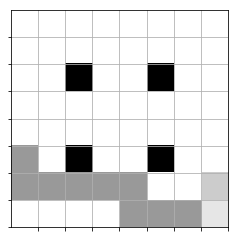

In [22]:
print(play_game(model_v5_2, qmaze, (5,0)))
show(qmaze)

win


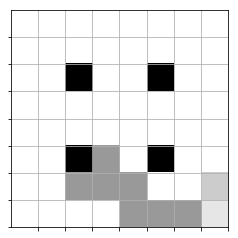

In [23]:
print(play_game(model_v5_2, qmaze, (5,3)))
show(qmaze)

lose


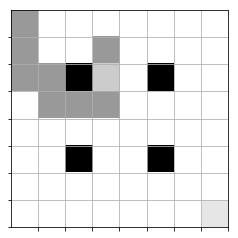

In [24]:
print(play_game(model_v5_2, qmaze, (0,0)))
show(qmaze)

lose


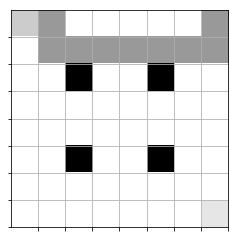

In [25]:
print(play_game(model_v5_2, qmaze, (0,7)))
show(qmaze)

win


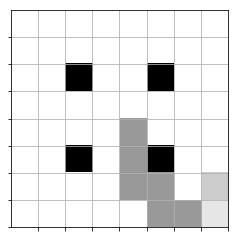

In [26]:
print(play_game(model_v5_2, qmaze, (4,4)))
show(qmaze)

lose


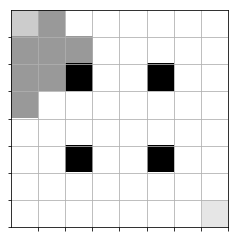

In [27]:
print(play_game(model_v5_2, qmaze, (1,2)))
show(qmaze)

win


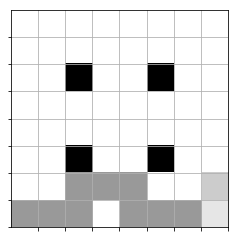

In [28]:
print(play_game(model_v5_2, qmaze, (7,0)))
show(qmaze)

win


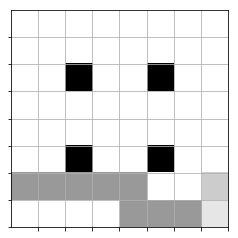

In [29]:
print(play_game(model_v5_2, qmaze, (6,0)))
show(qmaze)

win


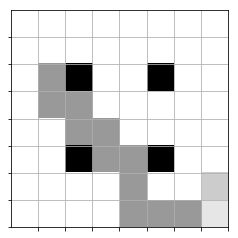

In [30]:
print(play_game(model_v5_2, qmaze, (2,1)))
show(qmaze)

win


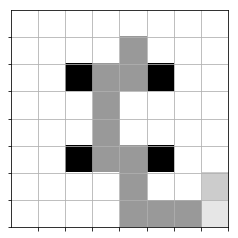

In [31]:
print(play_game(model_v5_2, qmaze, (1,4)))
show(qmaze)

### Result: Agent game performance has improved but has still not mastered the game and lost 3 out of 10 games. 
### Next will train over 60K games, to master it.

In [32]:
model_v5_3 = build_model(maze)
train(model_v5_3, maze, n_epoch=60000, max_memory=8*maze.size, data_size=300, name='model_v5_3')

Epoch: 000/59999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0]
Epoch: 001/59999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0]
Epoch: 002/59999 | Loss: 0.0000 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0, 0]
Epoch: 003/59999 | Loss: 0.0000 | Moves: 3 | Win count: 0 | Win rate: 0.000 | time: 0.0 seconds
win_hist (most recent games) [0, 0, 0, 0]
Epoch: 004/59999 | Loss: 0.0000 | Moves: 3 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0]
Epoch: 005/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0]
Epoch: 006/59999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 0.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0]
Epoch: 007/59999 | Loss: 0.0000

Epoch: 054/59999 | Loss: 0.0211 | Moves: 15 | Win count: 0 | Win rate: 0.000 | time: 2.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 055/59999 | Loss: 0.0000 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 2.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 056/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 2.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 057/59999 | Loss: 0.0000 | Moves: 5 | Win count: 0 | Win rate: 0.000 | time: 2.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 084/59999 | Loss: 0.0163 | Moves: 12 | Win count: 0 | Win rate: 0.000 | time: 2.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 085/59999 | Loss: 0.0000 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 2.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 086/59999 | Loss: 0.0000 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 2.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 087/59999 | Loss: 0.0000 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 2.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 136/59999 | Loss: 0.0088 | Moves: 14 | Win count: 0 | Win rate: 0.000 | time: 3.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 137/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 3.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 138/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 3.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 139/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 3.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 185/59999 | Loss: 0.0083 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 5.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 186/59999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 5.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 187/59999 | Loss: 0.0000 | Moves: 12 | Win count: 0 | Win rate: 0.000 | time: 5.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 188/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 5.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 235/59999 | Loss: 0.0051 | Moves: 12 | Win count: 0 | Win rate: 0.000 | time: 6.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 236/59999 | Loss: 0.0000 | Moves: 15 | Win count: 0 | Win rate: 0.000 | time: 6.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 237/59999 | Loss: 0.0000 | Moves: 17 | Win count: 0 | Win rate: 0.000 | time: 6.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 238/59999 | Loss: 0.0000 | Moves: 17 | Win count: 0 | Win rate: 0.000 | time: 6.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 281/59999 | Loss: 0.0079 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 7.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 282/59999 | Loss: 0.0000 | Moves: 7 | Win count: 0 | Win rate: 0.000 | time: 7.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 283/59999 | Loss: 0.0000 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 7.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 284/59999 | Loss: 0.0000 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 7.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 312/59999 | Loss: 0.0045 | Moves: 10 | Win count: 0 | Win rate: 0.000 | time: 7.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 313/59999 | Loss: 0.0000 | Moves: 5 | Win count: 0 | Win rate: 0.000 | time: 7.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 314/59999 | Loss: 0.0000 | Moves: 7 | Win count: 0 | Win rate: 0.000 | time: 7.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 315/59999 | Loss: 0.0000 | Moves: 5 | Win count: 0 | Win rate: 0.000 | time: 7.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 347/59999 | Loss: 0.0069 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 8.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 348/59999 | Loss: 0.0000 | Moves: 16 | Win count: 0 | Win rate: 0.000 | time: 8.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 349/59999 | Loss: 0.0000 | Moves: 16 | Win count: 0 | Win rate: 0.000 | time: 8.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 350/59999 | Loss: 0.0000 | Moves: 13 | Win count: 0 | Win rate: 0.000 | time: 8.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 420/59999 | Loss: 0.0060 | Moves: 8 | Win count: 0 | Win rate: 0.000 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 421/59999 | Loss: 0.0000 | Moves: 5 | Win count: 0 | Win rate: 0.000 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 422/59999 | Loss: 0.0000 | Moves: 9 | Win count: 0 | Win rate: 0.000 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 423/59999 | Loss: 0.0000 | Moves: 3 | Win count: 0 | Win rate: 0.000 | time: 10.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 482/59999 | Loss: 0.0114 | Moves: 5 | Win count: 2 | Win rate: 0.004 | time: 10.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 483/59999 | Loss: 0.0000 | Moves: 4 | Win count: 2 | Win rate: 0.004 | time: 10.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 484/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3 | Win rate: 0.006 | time: 10.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 485/59999 | Loss: 0.0000 | Moves: 8 | Win count: 3 | Win rate: 0.006 | time: 10.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 529/59999 | Loss: 0.0147 | Moves: 6 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 530/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 531/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 532/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4 | Win rate: 0.008 | time: 11.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

Epoch: 587/59999 | Loss: 0.0039 | Moves: 10 | Win count: 4 | Win rate: 0.007 | time: 12.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 588/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4 | Win rate: 0.007 | time: 12.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 589/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4 | Win rate: 0.007 | time: 12.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 590/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4 | Win rate: 0.007 | time: 12.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 623/59999 | Loss: 0.0034 | Moves: 10 | Win count: 4 | Win rate: 0.006 | time: 12.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 624/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4 | Win rate: 0.006 | time: 12.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 625/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4 | Win rate: 0.006 | time: 12.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 626/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4 | Win rate: 0.006 | time: 12.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 699/59999 | Loss: 0.0107 | Moves: 6 | Win count: 10 | Win rate: 0.014 | time: 14.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 700/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10 | Win rate: 0.014 | time: 14.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 701/59999 | Loss: 0.0000 | Moves: 2 | Win count: 10 | Win rate: 0.014 | time: 14.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 702/59999 | Loss: 0.0000 | Moves: 12 | Win count: 10 | Win rate: 0.014 | time: 14.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 748/59999 | Loss: 0.0089 | Moves: 14 | Win count: 11 | Win rate: 0.015 | time: 14.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 749/59999 | Loss: 0.0000 | Moves: 6 | Win count: 11 | Win rate: 0.015 | time: 14.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 750/59999 | Loss: 0.0000 | Moves: 2 | Win count: 11 | Win rate: 0.015 | time: 14.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 751/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11 | Win rate: 0.015 | time: 14.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 796/59999 | Loss: 0.0086 | Moves: 8 | Win count: 13 | Win rate: 0.016 | time: 15.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 797/59999 | Loss: 0.0000 | Moves: 1 | Win count: 13 | Win rate: 0.016 | time: 15.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 798/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13 | Win rate: 0.016 | time: 15.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 799/59999 | Loss: 0.0000 | Moves: 1 | Win count: 13 | Win rate: 0.016 | time: 15.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,

Epoch: 837/59999 | Loss: 0.0062 | Moves: 9 | Win count: 15 | Win rate: 0.018 | time: 15.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 838/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15 | Win rate: 0.018 | time: 15.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 839/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15 | Win rate: 0.018 | time: 15.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 840/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15 | Win rate: 0.018 | time: 15.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 877/59999 | Loss: 0.0090 | Moves: 11 | Win count: 15 | Win rate: 0.017 | time: 16.5 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 878/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15 | Win rate: 0.017 | time: 16.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 879/59999 | Loss: 0.0000 | Moves: 12 | Win count: 15 | Win rate: 0.017 | time: 16.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 880/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15 | Win rate: 0.017 | time: 16.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 912/59999 | Loss: 0.0040 | Moves: 13 | Win count: 15 | Win rate: 0.016 | time: 17.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 913/59999 | Loss: 0.0000 | Moves: 10 | Win count: 15 | Win rate: 0.016 | time: 17.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 914/59999 | Loss: 0.0000 | Moves: 6 | Win count: 15 | Win rate: 0.016 | time: 17.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 915/59999 | Loss: 0.0000 | Moves: 10 | Win count: 15 | Win rate: 0.016 | time: 17.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 977/59999 | Loss: 0.0034 | Moves: 14 | Win count: 15 | Win rate: 0.015 | time: 18.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 978/59999 | Loss: 0.0000 | Moves: 14 | Win count: 15 | Win rate: 0.015 | time: 18.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 979/59999 | Loss: 0.0000 | Moves: 12 | Win count: 15 | Win rate: 0.015 | time: 18.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 980/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15 | Win rate: 0.015 | time: 18.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1046/59999 | Loss: 0.0030 | Moves: 11 | Win count: 18 | Win rate: 0.017 | time: 19.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 1047/59999 | Loss: 0.0000 | Moves: 8 | Win count: 18 | Win rate: 0.017 | time: 19.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1048/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18 | Win rate: 0.017 | time: 19.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1049/59999 | Loss: 0.0000 | Moves: 6 | Win count: 18 | Win rate: 0.017 | time: 19.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1081/59999 | Loss: 0.0115 | Moves: 6 | Win count: 18 | Win rate: 0.017 | time: 20.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1082/59999 | Loss: 0.0000 | Moves: 6 | Win count: 18 | Win rate: 0.017 | time: 20.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1083/59999 | Loss: 0.0000 | Moves: 8 | Win count: 18 | Win rate: 0.017 | time: 20.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1084/59999 | Loss: 0.0000 | Moves: 8 | Win count: 18 | Win rate: 0.017 | time: 20.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0

Epoch: 1129/59999 | Loss: 0.0053 | Moves: 10 | Win count: 20 | Win rate: 0.018 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1130/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20 | Win rate: 0.018 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1131/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20 | Win rate: 0.018 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1132/59999 | Loss: 0.0000 | Moves: 6 | Win count: 20 | Win rate: 0.018 | time: 20.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 1174/59999 | Loss: 0.0054 | Moves: 7 | Win count: 20 | Win rate: 0.017 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1175/59999 | Loss: 0.0000 | Moves: 8 | Win count: 20 | Win rate: 0.017 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1176/59999 | Loss: 0.0000 | Moves: 8 | Win count: 20 | Win rate: 0.017 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1177/59999 | Loss: 0.0000 | Moves: 6 | Win count: 20 | Win rate: 0.017 | time: 21.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1223/59999 | Loss: 0.0000 | Moves: 8 | Win count: 22 | Win rate: 0.018 | time: 21.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1224/59999 | Loss: 0.0000 | Moves: 8 | Win count: 22 | Win rate: 0.018 | time: 21.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1225/59999 | Loss: 0.0000 | Moves: 8 | Win count: 22 | Win rate: 0.018 | time: 21.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1226/59999 | Loss: 0.0028 | Moves: 8 | Win count: 22 | Win rate: 0.018 | time: 22.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1270/59999 | Loss: 0.0082 | Moves: 13 | Win count: 24 | Win rate: 0.019 | time: 22.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 1271/59999 | Loss: 0.0000 | Moves: 2 | Win count: 24 | Win rate: 0.019 | time: 22.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 1272/59999 | Loss: 0.0000 | Moves: 6 | Win count: 24 | Win rate: 0.019 | time: 22.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 1273/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24 | Win rate: 0.019 | time: 22.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1324/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27 | Win rate: 0.020 | time: 22.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1325/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27 | Win rate: 0.020 | time: 22.8 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1326/59999 | Loss: 0.0000 | Moves: 4 | Win count: 27 | Win rate: 0.020 | time: 22.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1327/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27 | Win rate: 0.020 | time: 22.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0

Epoch: 1387/59999 | Loss: 0.0019 | Moves: 7 | Win count: 28 | Win rate: 0.020 | time: 24.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1388/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28 | Win rate: 0.020 | time: 24.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1389/59999 | Loss: 0.0000 | Moves: 1 | Win count: 29 | Win rate: 0.021 | time: 24.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 1390/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29 | Win rate: 0.021 | time: 24.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1420/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30 | Win rate: 0.021 | time: 24.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1421/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30 | Win rate: 0.021 | time: 24.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1422/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30 | Win rate: 0.021 | time: 24.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1423/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30 | Win rate: 0.021 | time: 24.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1475/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30 | Win rate: 0.020 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1476/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30 | Win rate: 0.020 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1477/59999 | Loss: 0.0000 | Moves: 8 | Win count: 30 | Win rate: 0.020 | time: 25.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1478/59999 | Loss: 0.0047 | Moves: 7 | Win count: 30 | Win rate: 0.020 | time: 25.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1510/59999 | Loss: 0.0020 | Moves: 8 | Win count: 31 | Win rate: 0.021 | time: 26.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 1511/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31 | Win rate: 0.021 | time: 26.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1512/59999 | Loss: 0.0000 | Moves: 3 | Win count: 31 | Win rate: 0.020 | time: 26.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1513/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31 | Win rate: 0.020 | time: 26.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1542/59999 | Loss: 0.0052 | Moves: 11 | Win count: 31 | Win rate: 0.020 | time: 26.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1543/59999 | Loss: 0.0000 | Moves: 1 | Win count: 31 | Win rate: 0.020 | time: 26.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1544/59999 | Loss: 0.0000 | Moves: 14 | Win count: 31 | Win rate: 0.020 | time: 26.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1545/59999 | Loss: 0.0000 | Moves: 17 | Win count: 31 | Win rate: 0.020 | time: 26.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0

Epoch: 1582/59999 | Loss: 0.0028 | Moves: 11 | Win count: 33 | Win rate: 0.021 | time: 27.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1583/59999 | Loss: 0.0000 | Moves: 3 | Win count: 33 | Win rate: 0.021 | time: 27.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1584/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33 | Win rate: 0.021 | time: 27.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1585/59999 | Loss: 0.0000 | Moves: 12 | Win count: 33 | Win rate: 0.021 | time: 27.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1618/59999 | Loss: 0.0087 | Moves: 11 | Win count: 33 | Win rate: 0.020 | time: 27.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1619/59999 | Loss: 0.0000 | Moves: 6 | Win count: 33 | Win rate: 0.020 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1620/59999 | Loss: 0.0000 | Moves: 13 | Win count: 33 | Win rate: 0.020 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1621/59999 | Loss: 0.0000 | Moves: 8 | Win count: 33 | Win rate: 0.020 | time: 27.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1657/59999 | Loss: 0.0036 | Moves: 17 | Win count: 34 | Win rate: 0.021 | time: 28.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1658/59999 | Loss: 0.0000 | Moves: 1 | Win count: 35 | Win rate: 0.021 | time: 28.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 1659/59999 | Loss: 0.0000 | Moves: 6 | Win count: 35 | Win rate: 0.021 | time: 28.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 1660/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35 | Win rate: 0.021 | time: 28.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1701/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35 | Win rate: 0.021 | time: 28.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1702/59999 | Loss: 0.0093 | Moves: 6 | Win count: 35 | Win rate: 0.021 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1703/59999 | Loss: 0.0000 | Moves: 15 | Win count: 35 | Win rate: 0.021 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1704/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35 | Win rate: 0.021 | time: 29.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1735/59999 | Loss: 0.0021 | Moves: 11 | Win count: 37 | Win rate: 0.021 | time: 29.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1736/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37 | Win rate: 0.021 | time: 29.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1737/59999 | Loss: 0.0000 | Moves: 8 | Win count: 37 | Win rate: 0.021 | time: 29.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1738/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37 | Win rate: 0.021 | time: 29.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 1774/59999 | Loss: 0.0103 | Moves: 5 | Win count: 38 | Win rate: 0.021 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1775/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38 | Win rate: 0.021 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1776/59999 | Loss: 0.0000 | Moves: 6 | Win count: 38 | Win rate: 0.021 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1777/59999 | Loss: 0.0000 | Moves: 1 | Win count: 38 | Win rate: 0.021 | time: 30.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 1829/59999 | Loss: 0.0081 | Moves: 5 | Win count: 45 | Win rate: 0.025 | time: 31.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0]
Epoch: 1830/59999 | Loss: 0.0000 | Moves: 2 | Win count: 45 | Win rate: 0.025 | time: 31.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 1831/59999 | Loss: 0.0000 | Moves: 8 | Win count: 45 | Win rate: 0.025 | time: 31.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1832/59999 | Loss: 0.0000 | Moves: 1 | Win count: 45 | Win rate: 0.025 | time: 31.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0

Epoch: 1888/59999 | Loss: 0.0190 | Moves: 10 | Win count: 46 | Win rate: 0.024 | time: 31.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1889/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46 | Win rate: 0.024 | time: 31.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1890/59999 | Loss: 0.0000 | Moves: 4 | Win count: 46 | Win rate: 0.024 | time: 31.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1891/59999 | Loss: 0.0000 | Moves: 6 | Win count: 46 | Win rate: 0.024 | time: 31.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 1944/59999 | Loss: 0.0080 | Moves: 10 | Win count: 48 | Win rate: 0.025 | time: 32.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 1945/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48 | Win rate: 0.025 | time: 32.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 1946/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48 | Win rate: 0.025 | time: 32.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 1947/59999 | Loss: 0.0000 | Moves: 6 | Win count: 48 | Win rate: 0.025 | time: 32.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 

Epoch: 1992/59999 | Loss: 0.0096 | Moves: 8 | Win count: 51 | Win rate: 0.026 | time: 32.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1993/59999 | Loss: 0.0000 | Moves: 10 | Win count: 51 | Win rate: 0.026 | time: 32.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1994/59999 | Loss: 0.0000 | Moves: 6 | Win count: 51 | Win rate: 0.026 | time: 32.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 1995/59999 | Loss: 0.0000 | Moves: 2 | Win count: 51 | Win rate: 0.026 | time: 32.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2032/59999 | Loss: 0.0000 | Moves: 9 | Win count: 52 | Win rate: 0.026 | time: 33.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2033/59999 | Loss: 0.0000 | Moves: 1 | Win count: 52 | Win rate: 0.026 | time: 33.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2034/59999 | Loss: 0.0000 | Moves: 13 | Win count: 52 | Win rate: 0.026 | time: 33.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2035/59999 | Loss: 0.0000 | Moves: 7 | Win count: 52 | Win rate: 0.026 | time: 33.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2094/59999 | Loss: 0.0000 | Moves: 11 | Win count: 54 | Win rate: 0.026 | time: 33.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2095/59999 | Loss: 0.0000 | Moves: 3 | Win count: 54 | Win rate: 0.026 | time: 33.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2096/59999 | Loss: 0.0000 | Moves: 4 | Win count: 54 | Win rate: 0.026 | time: 33.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2097/59999 | Loss: 0.0000 | Moves: 8 | Win count: 54 | Win rate: 0.026 | time: 33.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 

Epoch: 2159/59999 | Loss: 0.0205 | Moves: 4 | Win count: 65 | Win rate: 0.030 | time: 34.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2160/59999 | Loss: 0.0000 | Moves: 3 | Win count: 65 | Win rate: 0.030 | time: 34.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2161/59999 | Loss: 0.0000 | Moves: 4 | Win count: 65 | Win rate: 0.030 | time: 34.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2162/59999 | Loss: 0.0000 | Moves: 4 | Win count: 65 | Win rate: 0.030 | time: 34.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0

Epoch: 2219/59999 | Loss: 0.0164 | Moves: 13 | Win count: 80 | Win rate: 0.036 | time: 35.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1]
Epoch: 2220/59999 | Loss: 0.0000 | Moves: 4 | Win count: 80 | Win rate: 0.036 | time: 35.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0]
Epoch: 2221/59999 | Loss: 0.0000 | Moves: 3 | Win count: 80 | Win rate: 0.036 | time: 35.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0]
Epoch: 2222/59999 | Loss: 0.0000 | Moves: 3 | Win count: 80 | Win rate: 0.036 | time: 35.5 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 

Epoch: 2282/59999 | Loss: 0.0149 | Moves: 6 | Win count: 81 | Win rate: 0.035 | time: 36.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2283/59999 | Loss: 0.0000 | Moves: 2 | Win count: 81 | Win rate: 0.035 | time: 36.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2284/59999 | Loss: 0.0000 | Moves: 5 | Win count: 81 | Win rate: 0.035 | time: 36.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2285/59999 | Loss: 0.0000 | Moves: 6 | Win count: 81 | Win rate: 0.035 | time: 36.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0

Epoch: 2349/59999 | Loss: 0.0133 | Moves: 6 | Win count: 93 | Win rate: 0.040 | time: 36.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2350/59999 | Loss: 0.0000 | Moves: 2 | Win count: 93 | Win rate: 0.040 | time: 36.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2351/59999 | Loss: 0.0000 | Moves: 5 | Win count: 93 | Win rate: 0.040 | time: 36.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2352/59999 | Loss: 0.0000 | Moves: 4 | Win count: 93 | Win rate: 0.040 | time: 36.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2420/59999 | Loss: 0.0000 | Moves: 4 | Win count: 98 | Win rate: 0.040 | time: 36.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2421/59999 | Loss: 0.0207 | Moves: 5 | Win count: 98 | Win rate: 0.040 | time: 37.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2422/59999 | Loss: 0.0000 | Moves: 6 | Win count: 98 | Win rate: 0.040 | time: 37.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2423/59999 | Loss: 0.0000 | Moves: 5 | Win count: 99 | Win rate: 0.041 | time: 37.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0

Epoch: 2475/59999 | Loss: 0.0159 | Moves: 9 | Win count: 104 | Win rate: 0.042 | time: 37.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2476/59999 | Loss: 0.0000 | Moves: 10 | Win count: 104 | Win rate: 0.042 | time: 37.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2477/59999 | Loss: 0.0000 | Moves: 7 | Win count: 104 | Win rate: 0.042 | time: 37.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2478/59999 | Loss: 0.0000 | Moves: 9 | Win count: 104 | Win rate: 0.042 | time: 37.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0,

Epoch: 2520/59999 | Loss: 0.0067 | Moves: 13 | Win count: 105 | Win rate: 0.042 | time: 38.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2521/59999 | Loss: 0.0000 | Moves: 2 | Win count: 105 | Win rate: 0.042 | time: 38.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2522/59999 | Loss: 0.0000 | Moves: 12 | Win count: 105 | Win rate: 0.042 | time: 38.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2523/59999 | Loss: 0.0000 | Moves: 4 | Win count: 105 | Win rate: 0.042 | time: 38.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2555/59999 | Loss: 0.0026 | Moves: 25 | Win count: 105 | Win rate: 0.041 | time: 39.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2556/59999 | Loss: 0.0000 | Moves: 11 | Win count: 105 | Win rate: 0.041 | time: 39.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2557/59999 | Loss: 0.0000 | Moves: 7 | Win count: 105 | Win rate: 0.041 | time: 39.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2558/59999 | Loss: 0.0000 | Moves: 9 | Win count: 105 | Win rate: 0.041 | time: 39.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0

Epoch: 2594/59999 | Loss: 0.0026 | Moves: 7 | Win count: 106 | Win rate: 0.041 | time: 39.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2595/59999 | Loss: 0.0000 | Moves: 8 | Win count: 106 | Win rate: 0.041 | time: 39.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2596/59999 | Loss: 0.0000 | Moves: 6 | Win count: 106 | Win rate: 0.041 | time: 39.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2597/59999 | Loss: 0.0000 | Moves: 9 | Win count: 106 | Win rate: 0.041 | time: 39.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2636/59999 | Loss: 0.0070 | Moves: 13 | Win count: 107 | Win rate: 0.041 | time: 40.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2637/59999 | Loss: 0.0000 | Moves: 11 | Win count: 107 | Win rate: 0.041 | time: 40.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2638/59999 | Loss: 0.0000 | Moves: 11 | Win count: 107 | Win rate: 0.041 | time: 40.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2639/59999 | Loss: 0.0000 | Moves: 11 | Win count: 107 | Win rate: 0.041 | time: 40.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2671/59999 | Loss: 0.0055 | Moves: 8 | Win count: 108 | Win rate: 0.040 | time: 41.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2672/59999 | Loss: 0.0000 | Moves: 3 | Win count: 109 | Win rate: 0.041 | time: 41.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2673/59999 | Loss: 0.0000 | Moves: 10 | Win count: 109 | Win rate: 0.041 | time: 41.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2674/59999 | Loss: 0.0000 | Moves: 8 | Win count: 109 | Win rate: 0.041 | time: 41.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2712/59999 | Loss: 0.0048 | Moves: 4 | Win count: 112 | Win rate: 0.041 | time: 41.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 2713/59999 | Loss: 0.0000 | Moves: 12 | Win count: 112 | Win rate: 0.041 | time: 41.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 2714/59999 | Loss: 0.0000 | Moves: 6 | Win count: 112 | Win rate: 0.041 | time: 41.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2715/59999 | Loss: 0.0000 | Moves: 3 | Win count: 112 | Win rate: 0.041 | time: 41.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

Epoch: 2764/59999 | Loss: 0.0182 | Moves: 9 | Win count: 113 | Win rate: 0.041 | time: 42.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 2765/59999 | Loss: 0.0000 | Moves: 9 | Win count: 113 | Win rate: 0.041 | time: 42.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 2766/59999 | Loss: 0.0000 | Moves: 13 | Win count: 113 | Win rate: 0.041 | time: 42.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 2767/59999 | Loss: 0.0000 | Moves: 10 | Win count: 113 | Win rate: 0.041 | time: 42.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 2794/59999 | Loss: 0.0073 | Moves: 14 | Win count: 115 | Win rate: 0.041 | time: 43.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2795/59999 | Loss: 0.0000 | Moves: 14 | Win count: 115 | Win rate: 0.041 | time: 43.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2796/59999 | Loss: 0.0000 | Moves: 14 | Win count: 115 | Win rate: 0.041 | time: 43.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2797/59999 | Loss: 0.0000 | Moves: 14 | Win count: 115 | Win rate: 0.041 | time: 43.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2825/59999 | Loss: 0.0058 | Moves: 11 | Win count: 117 | Win rate: 0.041 | time: 43.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2826/59999 | Loss: 0.0000 | Moves: 8 | Win count: 117 | Win rate: 0.041 | time: 43.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2827/59999 | Loss: 0.0000 | Moves: 12 | Win count: 117 | Win rate: 0.041 | time: 43.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2828/59999 | Loss: 0.0000 | Moves: 8 | Win count: 117 | Win rate: 0.041 | time: 43.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0

Epoch: 2858/59999 | Loss: 0.0105 | Moves: 5 | Win count: 118 | Win rate: 0.041 | time: 44.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2859/59999 | Loss: 0.0000 | Moves: 11 | Win count: 119 | Win rate: 0.042 | time: 44.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 2860/59999 | Loss: 0.0000 | Moves: 6 | Win count: 119 | Win rate: 0.042 | time: 44.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 2861/59999 | Loss: 0.0000 | Moves: 8 | Win count: 119 | Win rate: 0.042 | time: 44.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 2901/59999 | Loss: 0.0072 | Moves: 9 | Win count: 125 | Win rate: 0.043 | time: 44.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2902/59999 | Loss: 0.0000 | Moves: 9 | Win count: 125 | Win rate: 0.043 | time: 44.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2903/59999 | Loss: 0.0000 | Moves: 11 | Win count: 125 | Win rate: 0.043 | time: 44.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2904/59999 | Loss: 0.0000 | Moves: 11 | Win count: 125 | Win rate: 0.043 | time: 44.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0

Epoch: 2934/59999 | Loss: 0.0099 | Moves: 7 | Win count: 126 | Win rate: 0.043 | time: 45.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2935/59999 | Loss: 0.0000 | Moves: 1 | Win count: 126 | Win rate: 0.043 | time: 45.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2936/59999 | Loss: 0.0000 | Moves: 8 | Win count: 126 | Win rate: 0.043 | time: 45.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2937/59999 | Loss: 0.0000 | Moves: 6 | Win count: 126 | Win rate: 0.043 | time: 45.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 2981/59999 | Loss: 0.0057 | Moves: 6 | Win count: 131 | Win rate: 0.044 | time: 46.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2982/59999 | Loss: 0.0000 | Moves: 9 | Win count: 131 | Win rate: 0.044 | time: 46.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2983/59999 | Loss: 0.0000 | Moves: 9 | Win count: 131 | Win rate: 0.044 | time: 46.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 2984/59999 | Loss: 0.0000 | Moves: 2 | Win count: 131 | Win rate: 0.044 | time: 46.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 

Epoch: 3020/59999 | Loss: 0.0000 | Moves: 6 | Win count: 137 | Win rate: 0.045 | time: 46.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 3021/59999 | Loss: 0.0000 | Moves: 3 | Win count: 138 | Win rate: 0.046 | time: 46.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1]
Epoch: 3022/59999 | Loss: 0.0190 | Moves: 5 | Win count: 138 | Win rate: 0.046 | time: 46.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 3023/59999 | Loss: 0.0000 | Moves: 6 | Win count: 138 | Win rate: 0.046 | time: 46.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3081/59999 | Loss: 0.0000 | Moves: 6 | Win count: 142 | Win rate: 0.046 | time: 46.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 3082/59999 | Loss: 0.0189 | Moves: 11 | Win count: 142 | Win rate: 0.046 | time: 47.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 3083/59999 | Loss: 0.0000 | Moves: 4 | Win count: 142 | Win rate: 0.046 | time: 47.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 3084/59999 | Loss: 0.0000 | Moves: 5 | Win count: 142 | Win rate: 0.046 | time: 47.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 3134/59999 | Loss: 0.0000 | Moves: 5 | Win count: 148 | Win rate: 0.047 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 3135/59999 | Loss: 0.0000 | Moves: 2 | Win count: 148 | Win rate: 0.047 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 3136/59999 | Loss: 0.0000 | Moves: 6 | Win count: 148 | Win rate: 0.047 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 3137/59999 | Loss: 0.0000 | Moves: 9 | Win count: 148 | Win rate: 0.047 | time: 47.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

Epoch: 3197/59999 | Loss: 0.0213 | Moves: 6 | Win count: 153 | Win rate: 0.048 | time: 48.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3198/59999 | Loss: 0.0000 | Moves: 5 | Win count: 154 | Win rate: 0.048 | time: 48.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3199/59999 | Loss: 0.0000 | Moves: 6 | Win count: 154 | Win rate: 0.048 | time: 48.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 3200/59999 | Loss: 0.0000 | Moves: 7 | Win count: 154 | Win rate: 0.048 | time: 48.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3244/59999 | Loss: 0.0000 | Moves: 5 | Win count: 156 | Win rate: 0.048 | time: 48.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3245/59999 | Loss: 0.0000 | Moves: 7 | Win count: 156 | Win rate: 0.048 | time: 48.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3246/59999 | Loss: 0.0000 | Moves: 9 | Win count: 156 | Win rate: 0.048 | time: 48.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3247/59999 | Loss: 0.0000 | Moves: 5 | Win count: 156 | Win rate: 0.048 | time: 48.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3292/59999 | Loss: 0.0000 | Moves: 6 | Win count: 165 | Win rate: 0.050 | time: 49.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0]
Epoch: 3293/59999 | Loss: 0.0000 | Moves: 5 | Win count: 165 | Win rate: 0.050 | time: 49.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 3294/59999 | Loss: 0.0000 | Moves: 8 | Win count: 165 | Win rate: 0.050 | time: 49.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 3295/59999 | Loss: 0.0000 | Moves: 4 | Win count: 165 | Win rate: 0.050 | time: 49.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 

Epoch: 3350/59999 | Loss: 0.0231 | Moves: 12 | Win count: 169 | Win rate: 0.050 | time: 50.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 3351/59999 | Loss: 0.0000 | Moves: 8 | Win count: 169 | Win rate: 0.050 | time: 50.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0]
Epoch: 3352/59999 | Loss: 0.0000 | Moves: 4 | Win count: 169 | Win rate: 0.050 | time: 50.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]
Epoch: 3353/59999 | Loss: 0.0000 | Moves: 5 | Win count: 169 | Win rate: 0.050 | time: 50.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 3399/59999 | Loss: 0.0137 | Moves: 11 | Win count: 174 | Win rate: 0.051 | time: 51.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3400/59999 | Loss: 0.0000 | Moves: 4 | Win count: 174 | Win rate: 0.051 | time: 51.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3401/59999 | Loss: 0.0000 | Moves: 4 | Win count: 174 | Win rate: 0.051 | time: 51.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3402/59999 | Loss: 0.0000 | Moves: 5 | Win count: 174 | Win rate: 0.051 | time: 51.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 1, 0,

Epoch: 3450/59999 | Loss: 0.0097 | Moves: 5 | Win count: 180 | Win rate: 0.052 | time: 51.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 3451/59999 | Loss: 0.0000 | Moves: 2 | Win count: 180 | Win rate: 0.052 | time: 51.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 3452/59999 | Loss: 0.0000 | Moves: 8 | Win count: 180 | Win rate: 0.052 | time: 51.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 3453/59999 | Loss: 0.0000 | Moves: 8 | Win count: 180 | Win rate: 0.052 | time: 51.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3503/59999 | Loss: 0.0216 | Moves: 6 | Win count: 187 | Win rate: 0.053 | time: 52.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3504/59999 | Loss: 0.0000 | Moves: 4 | Win count: 187 | Win rate: 0.053 | time: 52.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3505/59999 | Loss: 0.0000 | Moves: 8 | Win count: 187 | Win rate: 0.053 | time: 52.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3506/59999 | Loss: 0.0000 | Moves: 9 | Win count: 187 | Win rate: 0.053 | time: 52.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 

Epoch: 3551/59999 | Loss: 0.0138 | Moves: 13 | Win count: 192 | Win rate: 0.054 | time: 53.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1]
Epoch: 3552/59999 | Loss: 0.0000 | Moves: 1 | Win count: 192 | Win rate: 0.054 | time: 53.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 3553/59999 | Loss: 0.0000 | Moves: 5 | Win count: 192 | Win rate: 0.054 | time: 53.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 3554/59999 | Loss: 0.0000 | Moves: 2 | Win count: 192 | Win rate: 0.054 | time: 53.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0,

Epoch: 3603/59999 | Loss: 0.0104 | Moves: 12 | Win count: 197 | Win rate: 0.055 | time: 53.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3604/59999 | Loss: 0.0000 | Moves: 5 | Win count: 197 | Win rate: 0.055 | time: 53.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3605/59999 | Loss: 0.0000 | Moves: 4 | Win count: 197 | Win rate: 0.055 | time: 53.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3606/59999 | Loss: 0.0000 | Moves: 12 | Win count: 197 | Win rate: 0.055 | time: 53.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 3649/59999 | Loss: 0.0178 | Moves: 12 | Win count: 206 | Win rate: 0.056 | time: 54.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3650/59999 | Loss: 0.0000 | Moves: 6 | Win count: 206 | Win rate: 0.056 | time: 54.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3651/59999 | Loss: 0.0000 | Moves: 3 | Win count: 206 | Win rate: 0.056 | time: 54.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3652/59999 | Loss: 0.0000 | Moves: 13 | Win count: 207 | Win rate: 0.057 | time: 54.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 1, 0, 1

Epoch: 3705/59999 | Loss: 0.0148 | Moves: 6 | Win count: 223 | Win rate: 0.060 | time: 54.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3706/59999 | Loss: 0.0000 | Moves: 7 | Win count: 223 | Win rate: 0.060 | time: 54.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3707/59999 | Loss: 0.0000 | Moves: 5 | Win count: 223 | Win rate: 0.060 | time: 54.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3708/59999 | Loss: 0.0000 | Moves: 6 | Win count: 223 | Win rate: 0.060 | time: 54.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 

Epoch: 3760/59999 | Loss: 0.0000 | Moves: 4 | Win count: 235 | Win rate: 0.062 | time: 55.0 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3761/59999 | Loss: 0.0000 | Moves: 7 | Win count: 235 | Win rate: 0.062 | time: 55.0 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3762/59999 | Loss: 0.0000 | Moves: 10 | Win count: 236 | Win rate: 0.063 | time: 55.0 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 3763/59999 | Loss: 0.0387 | Moves: 7 | Win count: 236 | Win rate: 0.063 | time: 55.5 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 1,

Epoch: 3831/59999 | Loss: 0.0305 | Moves: 4 | Win count: 248 | Win rate: 0.065 | time: 56.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3832/59999 | Loss: 0.0000 | Moves: 6 | Win count: 248 | Win rate: 0.065 | time: 56.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3833/59999 | Loss: 0.0000 | Moves: 8 | Win count: 248 | Win rate: 0.065 | time: 56.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 3834/59999 | Loss: 0.0000 | Moves: 8 | Win count: 248 | Win rate: 0.065 | time: 56.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 

Epoch: 3865/59999 | Loss: 0.0000 | Moves: 9 | Win count: 253 | Win rate: 0.065 | time: 56.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1]
Epoch: 3866/59999 | Loss: 0.0000 | Moves: 8 | Win count: 253 | Win rate: 0.065 | time: 56.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0]
Epoch: 3867/59999 | Loss: 0.0000 | Moves: 8 | Win count: 253 | Win rate: 0.065 | time: 56.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0]
Epoch: 3868/59999 | Loss: 0.0000 | Moves: 9 | Win count: 254 | Win rate: 0.066 | time: 56.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 

Epoch: 3936/59999 | Loss: 0.0236 | Moves: 4 | Win count: 264 | Win rate: 0.067 | time: 57.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0]
Epoch: 3937/59999 | Loss: 0.0000 | Moves: 7 | Win count: 265 | Win rate: 0.067 | time: 57.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1]
Epoch: 3938/59999 | Loss: 0.0000 | Moves: 7 | Win count: 265 | Win rate: 0.067 | time: 57.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 3939/59999 | Loss: 0.0000 | Moves: 6 | Win count: 265 | Win rate: 0.067 | time: 57.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 3986/59999 | Loss: 0.0000 | Moves: 3 | Win count: 276 | Win rate: 0.069 | time: 57.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1]
Epoch: 3987/59999 | Loss: 0.0168 | Moves: 5 | Win count: 276 | Win rate: 0.069 | time: 58.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0]
Epoch: 3988/59999 | Loss: 0.0000 | Moves: 6 | Win count: 276 | Win rate: 0.069 | time: 58.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0]
Epoch: 3989/59999 | Loss: 0.0000 | Moves: 6 | Win count: 276 | Win rate: 0.069 | time: 58.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 4045/59999 | Loss: 0.0201 | Moves: 8 | Win count: 286 | Win rate: 0.071 | time: 58.8 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4046/59999 | Loss: 0.0000 | Moves: 3 | Win count: 286 | Win rate: 0.071 | time: 58.8 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4047/59999 | Loss: 0.0000 | Moves: 5 | Win count: 286 | Win rate: 0.071 | time: 58.8 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4048/59999 | Loss: 0.0000 | Moves: 7 | Win count: 286 | Win rate: 0.071 | time: 58.8 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 

Epoch: 4093/59999 | Loss: 0.0075 | Moves: 5 | Win count: 295 | Win rate: 0.072 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 4094/59999 | Loss: 0.0000 | Moves: 1 | Win count: 295 | Win rate: 0.072 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 4095/59999 | Loss: 0.0000 | Moves: 8 | Win count: 295 | Win rate: 0.072 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 4096/59999 | Loss: 0.0000 | Moves: 10 | Win count: 295 | Win rate: 0.072 | time: 59.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 4150/59999 | Loss: 0.0000 | Moves: 6 | Win count: 305 | Win rate: 0.073 | time: 59.6 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4151/59999 | Loss: 0.0263 | Moves: 5 | Win count: 305 | Win rate: 0.073 | time: 60.0 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 4152/59999 | Loss: 0.0000 | Moves: 7 | Win count: 305 | Win rate: 0.073 | time: 60.0 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4153/59999 | Loss: 0.0000 | Moves: 8 | Win count: 305 | Win rate: 0.073 | time: 60.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 

Epoch: 4204/59999 | Loss: 0.0190 | Moves: 11 | Win count: 314 | Win rate: 0.075 | time: 60.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 4205/59999 | Loss: 0.0000 | Moves: 1 | Win count: 314 | Win rate: 0.075 | time: 60.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0]
Epoch: 4206/59999 | Loss: 0.0000 | Moves: 5 | Win count: 314 | Win rate: 0.075 | time: 60.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0]
Epoch: 4207/59999 | Loss: 0.0000 | Moves: 6 | Win count: 314 | Win rate: 0.075 | time: 60.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

Epoch: 4246/59999 | Loss: 0.0139 | Moves: 8 | Win count: 327 | Win rate: 0.077 | time: 61.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4247/59999 | Loss: 0.0000 | Moves: 19 | Win count: 328 | Win rate: 0.077 | time: 61.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 4248/59999 | Loss: 0.0000 | Moves: 7 | Win count: 329 | Win rate: 0.077 | time: 61.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1]
Epoch: 4249/59999 | Loss: 0.0000 | Moves: 6 | Win count: 329 | Win rate: 0.077 | time: 61.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0,

Epoch: 4293/59999 | Loss: 0.0210 | Moves: 5 | Win count: 341 | Win rate: 0.079 | time: 61.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 4294/59999 | Loss: 0.0000 | Moves: 6 | Win count: 341 | Win rate: 0.079 | time: 61.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0]
Epoch: 4295/59999 | Loss: 0.0000 | Moves: 8 | Win count: 341 | Win rate: 0.079 | time: 61.8 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 4296/59999 | Loss: 0.0000 | Moves: 6 | Win count: 341 | Win rate: 0.079 | time: 61.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 

Epoch: 4342/59999 | Loss: 0.0000 | Moves: 5 | Win count: 354 | Win rate: 0.082 | time: 62.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 4343/59999 | Loss: 0.0000 | Moves: 3 | Win count: 354 | Win rate: 0.081 | time: 62.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 4344/59999 | Loss: 0.0262 | Moves: 6 | Win count: 354 | Win rate: 0.081 | time: 62.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4345/59999 | Loss: 0.0000 | Moves: 2 | Win count: 354 | Win rate: 0.081 | time: 62.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 

Epoch: 4375/59999 | Loss: 0.0304 | Moves: 9 | Win count: 370 | Win rate: 0.085 | time: 63.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 4376/59999 | Loss: 0.0000 | Moves: 3 | Win count: 370 | Win rate: 0.085 | time: 63.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0]
Epoch: 4377/59999 | Loss: 0.0000 | Moves: 11 | Win count: 371 | Win rate: 0.085 | time: 63.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 4378/59999 | Loss: 0.0000 | Moves: 1 | Win count: 371 | Win rate: 0.085 | time: 63.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 0, 1,

Epoch: 4428/59999 | Loss: 0.0198 | Moves: 5 | Win count: 379 | Win rate: 0.086 | time: 63.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4429/59999 | Loss: 0.0000 | Moves: 3 | Win count: 379 | Win rate: 0.086 | time: 63.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4430/59999 | Loss: 0.0000 | Moves: 1 | Win count: 379 | Win rate: 0.086 | time: 63.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4431/59999 | Loss: 0.0000 | Moves: 2 | Win count: 379 | Win rate: 0.086 | time: 63.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 4488/59999 | Loss: 0.0245 | Moves: 12 | Win count: 389 | Win rate: 0.087 | time: 64.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4489/59999 | Loss: 0.0000 | Moves: 5 | Win count: 389 | Win rate: 0.087 | time: 64.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4490/59999 | Loss: 0.0000 | Moves: 5 | Win count: 389 | Win rate: 0.087 | time: 64.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4491/59999 | Loss: 0.0000 | Moves: 4 | Win count: 389 | Win rate: 0.087 | time: 64.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0,

Epoch: 4541/59999 | Loss: 0.0226 | Moves: 12 | Win count: 400 | Win rate: 0.088 | time: 65.0 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]
Epoch: 4542/59999 | Loss: 0.0000 | Moves: 8 | Win count: 400 | Win rate: 0.088 | time: 65.0 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0]
Epoch: 4543/59999 | Loss: 0.0000 | Moves: 8 | Win count: 400 | Win rate: 0.088 | time: 65.0 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 4544/59999 | Loss: 0.0000 | Moves: 8 | Win count: 400 | Win rate: 0.088 | time: 65.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 0, 0, 0,

Epoch: 4579/59999 | Loss: 0.0000 | Moves: 10 | Win count: 411 | Win rate: 0.090 | time: 65.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 4580/59999 | Loss: 0.0000 | Moves: 8 | Win count: 411 | Win rate: 0.090 | time: 65.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 4581/59999 | Loss: 0.0000 | Moves: 8 | Win count: 411 | Win rate: 0.090 | time: 65.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4582/59999 | Loss: 0.0000 | Moves: 8 | Win count: 411 | Win rate: 0.090 | time: 65.2 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 0, 0, 0,

Epoch: 4636/59999 | Loss: 0.0096 | Moves: 9 | Win count: 426 | Win rate: 0.092 | time: 66.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1]
Epoch: 4637/59999 | Loss: 0.0000 | Moves: 4 | Win count: 426 | Win rate: 0.092 | time: 66.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0]
Epoch: 4638/59999 | Loss: 0.0000 | Moves: 3 | Win count: 426 | Win rate: 0.092 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0]
Epoch: 4639/59999 | Loss: 0.0000 | Moves: 3 | Win count: 427 | Win rate: 0.092 | time: 66.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 

Epoch: 4688/59999 | Loss: 0.0000 | Moves: 8 | Win count: 433 | Win rate: 0.092 | time: 66.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4689/59999 | Loss: 0.0209 | Moves: 4 | Win count: 433 | Win rate: 0.092 | time: 66.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4690/59999 | Loss: 0.0000 | Moves: 4 | Win count: 433 | Win rate: 0.092 | time: 66.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 4691/59999 | Loss: 0.0000 | Moves: 11 | Win count: 434 | Win rate: 0.092 | time: 66.9 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 0, 0,

Epoch: 4736/59999 | Loss: 0.0000 | Moves: 7 | Win count: 449 | Win rate: 0.095 | time: 67.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0]
Epoch: 4737/59999 | Loss: 0.0000 | Moves: 6 | Win count: 449 | Win rate: 0.095 | time: 67.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 4738/59999 | Loss: 0.0101 | Moves: 5 | Win count: 450 | Win rate: 0.095 | time: 67.6 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1]
Epoch: 4739/59999 | Loss: 0.0000 | Moves: 6 | Win count: 450 | Win rate: 0.095 | time: 67.6 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 

Epoch: 4789/59999 | Loss: 0.0176 | Moves: 11 | Win count: 458 | Win rate: 0.096 | time: 68.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1]
Epoch: 4790/59999 | Loss: 0.0000 | Moves: 5 | Win count: 459 | Win rate: 0.096 | time: 68.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 4791/59999 | Loss: 0.0000 | Moves: 4 | Win count: 459 | Win rate: 0.096 | time: 68.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 4792/59999 | Loss: 0.0000 | Moves: 13 | Win count: 459 | Win rate: 0.096 | time: 68.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 4835/59999 | Loss: 0.0112 | Moves: 13 | Win count: 472 | Win rate: 0.098 | time: 68.8 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1]
Epoch: 4836/59999 | Loss: 0.0000 | Moves: 1 | Win count: 472 | Win rate: 0.098 | time: 68.8 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0]
Epoch: 4837/59999 | Loss: 0.0000 | Moves: 5 | Win count: 472 | Win rate: 0.098 | time: 68.8 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0]
Epoch: 4838/59999 | Loss: 0.0000 | Moves: 19 | Win count: 473 | Win rate: 0.098 | time: 68.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 0, 0, 0

Epoch: 4878/59999 | Loss: 0.0343 | Moves: 16 | Win count: 485 | Win rate: 0.099 | time: 69.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0]
Epoch: 4879/59999 | Loss: 0.0000 | Moves: 5 | Win count: 486 | Win rate: 0.100 | time: 69.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1]
Epoch: 4880/59999 | Loss: 0.0000 | Moves: 4 | Win count: 486 | Win rate: 0.100 | time: 69.4 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4881/59999 | Loss: 0.0000 | Moves: 4 | Win count: 486 | Win rate: 0.100 | time: 69.4 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 0, 1, 0,

Epoch: 4939/59999 | Loss: 0.0208 | Moves: 7 | Win count: 499 | Win rate: 0.101 | time: 70.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0]
Epoch: 4940/59999 | Loss: 0.0000 | Moves: 4 | Win count: 499 | Win rate: 0.101 | time: 70.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0]
Epoch: 4941/59999 | Loss: 0.0000 | Moves: 13 | Win count: 500 | Win rate: 0.101 | time: 70.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1]
Epoch: 4942/59999 | Loss: 0.0000 | Moves: 1 | Win count: 501 | Win rate: 0.101 | time: 70.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0,

Epoch: 4985/59999 | Loss: 0.0168 | Moves: 5 | Win count: 518 | Win rate: 0.104 | time: 70.7 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1]
Epoch: 4986/59999 | Loss: 0.0000 | Moves: 1 | Win count: 518 | Win rate: 0.104 | time: 70.7 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 4987/59999 | Loss: 0.0000 | Moves: 16 | Win count: 518 | Win rate: 0.104 | time: 70.7 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 4988/59999 | Loss: 0.0000 | Moves: 3 | Win count: 518 | Win rate: 0.104 | time: 70.7 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 1, 1,

Epoch: 5030/59999 | Loss: 0.0192 | Moves: 8 | Win count: 529 | Win rate: 0.105 | time: 71.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5031/59999 | Loss: 0.0000 | Moves: 7 | Win count: 529 | Win rate: 0.105 | time: 71.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 5032/59999 | Loss: 0.0000 | Moves: 6 | Win count: 529 | Win rate: 0.105 | time: 71.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5033/59999 | Loss: 0.0000 | Moves: 5 | Win count: 529 | Win rate: 0.105 | time: 71.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 

Epoch: 5075/59999 | Loss: 0.0150 | Moves: 15 | Win count: 538 | Win rate: 0.106 | time: 71.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0]
Epoch: 5076/59999 | Loss: 0.0000 | Moves: 3 | Win count: 538 | Win rate: 0.106 | time: 71.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 5077/59999 | Loss: 0.0000 | Moves: 3 | Win count: 538 | Win rate: 0.106 | time: 71.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0]
Epoch: 5078/59999 | Loss: 0.0000 | Moves: 3 | Win count: 539 | Win rate: 0.106 | time: 71.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

Epoch: 5107/59999 | Loss: 0.0000 | Moves: 7 | Win count: 543 | Win rate: 0.106 | time: 72.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 5108/59999 | Loss: 0.0000 | Moves: 6 | Win count: 543 | Win rate: 0.106 | time: 72.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5109/59999 | Loss: 0.0000 | Moves: 5 | Win count: 543 | Win rate: 0.106 | time: 72.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5110/59999 | Loss: 0.0000 | Moves: 7 | Win count: 543 | Win rate: 0.106 | time: 72.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 

Epoch: 5164/59999 | Loss: 0.0000 | Moves: 8 | Win count: 555 | Win rate: 0.107 | time: 73.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0]
Epoch: 5165/59999 | Loss: 0.0000 | Moves: 6 | Win count: 555 | Win rate: 0.107 | time: 73.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 5166/59999 | Loss: 0.0000 | Moves: 3 | Win count: 555 | Win rate: 0.107 | time: 73.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5167/59999 | Loss: 0.0000 | Moves: 6 | Win count: 555 | Win rate: 0.107 | time: 73.0 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 

Epoch: 5221/59999 | Loss: 0.0253 | Moves: 9 | Win count: 572 | Win rate: 0.110 | time: 74.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5222/59999 | Loss: 0.0000 | Moves: 8 | Win count: 572 | Win rate: 0.110 | time: 74.0 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 5223/59999 | Loss: 0.0000 | Moves: 6 | Win count: 572 | Win rate: 0.109 | time: 74.0 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5224/59999 | Loss: 0.0000 | Moves: 12 | Win count: 572 | Win rate: 0.109 | time: 74.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 0,

Epoch: 5262/59999 | Loss: 0.0151 | Moves: 13 | Win count: 578 | Win rate: 0.110 | time: 74.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5263/59999 | Loss: 0.0000 | Moves: 3 | Win count: 578 | Win rate: 0.110 | time: 74.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5264/59999 | Loss: 0.0000 | Moves: 15 | Win count: 579 | Win rate: 0.110 | time: 74.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 5265/59999 | Loss: 0.0000 | Moves: 5 | Win count: 579 | Win rate: 0.110 | time: 74.6 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0

Epoch: 5297/59999 | Loss: 0.0128 | Moves: 13 | Win count: 589 | Win rate: 0.111 | time: 75.2 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0]
Epoch: 5298/59999 | Loss: 0.0000 | Moves: 3 | Win count: 589 | Win rate: 0.111 | time: 75.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0]
Epoch: 5299/59999 | Loss: 0.0000 | Moves: 1 | Win count: 589 | Win rate: 0.111 | time: 75.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0]
Epoch: 5300/59999 | Loss: 0.0000 | Moves: 5 | Win count: 589 | Win rate: 0.111 | time: 75.2 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 0, 0,

Epoch: 5343/59999 | Loss: 0.0161 | Moves: 10 | Win count: 598 | Win rate: 0.112 | time: 75.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0]
Epoch: 5344/59999 | Loss: 0.0000 | Moves: 7 | Win count: 598 | Win rate: 0.112 | time: 75.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]
Epoch: 5345/59999 | Loss: 0.0000 | Moves: 7 | Win count: 599 | Win rate: 0.112 | time: 75.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1]
Epoch: 5346/59999 | Loss: 0.0000 | Moves: 3 | Win count: 599 | Win rate: 0.112 | time: 75.8 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 1,

Epoch: 5385/59999 | Loss: 0.0112 | Moves: 8 | Win count: 609 | Win rate: 0.113 | time: 76.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5386/59999 | Loss: 0.0000 | Moves: 5 | Win count: 610 | Win rate: 0.113 | time: 76.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1]
Epoch: 5387/59999 | Loss: 0.0000 | Moves: 6 | Win count: 610 | Win rate: 0.113 | time: 76.4 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 5388/59999 | Loss: 0.0000 | Moves: 9 | Win count: 611 | Win rate: 0.113 | time: 76.4 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 

Epoch: 5428/59999 | Loss: 0.0255 | Moves: 8 | Win count: 623 | Win rate: 0.115 | time: 77.0 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0]
Epoch: 5429/59999 | Loss: 0.0000 | Moves: 6 | Win count: 623 | Win rate: 0.115 | time: 77.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 5430/59999 | Loss: 0.0000 | Moves: 9 | Win count: 623 | Win rate: 0.115 | time: 77.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0]
Epoch: 5431/59999 | Loss: 0.0000 | Moves: 4 | Win count: 623 | Win rate: 0.115 | time: 77.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 

Epoch: 5468/59999 | Loss: 0.0102 | Moves: 6 | Win count: 631 | Win rate: 0.115 | time: 77.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5469/59999 | Loss: 0.0000 | Moves: 9 | Win count: 631 | Win rate: 0.115 | time: 77.7 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 5470/59999 | Loss: 0.0000 | Moves: 7 | Win count: 632 | Win rate: 0.116 | time: 77.7 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 5471/59999 | Loss: 0.0000 | Moves: 5 | Win count: 632 | Win rate: 0.115 | time: 77.7 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 

Epoch: 5506/59999 | Loss: 0.0141 | Moves: 5 | Win count: 643 | Win rate: 0.117 | time: 78.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5507/59999 | Loss: 0.0000 | Moves: 6 | Win count: 643 | Win rate: 0.117 | time: 78.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5508/59999 | Loss: 0.0000 | Moves: 11 | Win count: 643 | Win rate: 0.117 | time: 78.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 5509/59999 | Loss: 0.0000 | Moves: 9 | Win count: 644 | Win rate: 0.117 | time: 78.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

Epoch: 5551/59999 | Loss: 0.0000 | Moves: 11 | Win count: 658 | Win rate: 0.119 | time: 78.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 5552/59999 | Loss: 0.0000 | Moves: 5 | Win count: 658 | Win rate: 0.118 | time: 78.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0]
Epoch: 5553/59999 | Loss: 0.0090 | Moves: 1 | Win count: 658 | Win rate: 0.118 | time: 78.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0]
Epoch: 5554/59999 | Loss: 0.0000 | Moves: 7 | Win count: 658 | Win rate: 0.118 | time: 78.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 1,

Epoch: 5591/59999 | Loss: 0.0114 | Moves: 11 | Win count: 671 | Win rate: 0.120 | time: 79.5 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1]
Epoch: 5592/59999 | Loss: 0.0000 | Moves: 5 | Win count: 672 | Win rate: 0.120 | time: 79.5 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 5593/59999 | Loss: 0.0000 | Moves: 5 | Win count: 673 | Win rate: 0.120 | time: 79.6 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 5594/59999 | Loss: 0.0000 | Moves: 13 | Win count: 673 | Win rate: 0.120 | time: 79.6 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 0, 0

Epoch: 5631/59999 | Loss: 0.0198 | Moves: 11 | Win count: 684 | Win rate: 0.121 | time: 80.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5632/59999 | Loss: 0.0000 | Moves: 12 | Win count: 684 | Win rate: 0.121 | time: 80.1 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 5633/59999 | Loss: 0.0000 | Moves: 9 | Win count: 684 | Win rate: 0.121 | time: 80.2 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 5634/59999 | Loss: 0.0000 | Moves: 7 | Win count: 684 | Win rate: 0.121 | time: 80.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 0

Epoch: 5672/59999 | Loss: 0.0193 | Moves: 5 | Win count: 694 | Win rate: 0.122 | time: 80.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 5673/59999 | Loss: 0.0000 | Moves: 9 | Win count: 695 | Win rate: 0.122 | time: 80.7 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1]
Epoch: 5674/59999 | Loss: 0.0000 | Moves: 6 | Win count: 695 | Win rate: 0.122 | time: 80.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 5675/59999 | Loss: 0.0000 | Moves: 1 | Win count: 695 | Win rate: 0.122 | time: 80.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 5711/59999 | Loss: 0.0237 | Moves: 5 | Win count: 707 | Win rate: 0.124 | time: 81.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1]
Epoch: 5712/59999 | Loss: 0.0000 | Moves: 7 | Win count: 708 | Win rate: 0.124 | time: 81.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1]
Epoch: 5713/59999 | Loss: 0.0000 | Moves: 5 | Win count: 709 | Win rate: 0.124 | time: 81.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1]
Epoch: 5714/59999 | Loss: 0.0000 | Moves: 11 | Win count: 710 | Win rate: 0.124 | time: 81.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 1, 0,

Epoch: 5754/59999 | Loss: 0.0098 | Moves: 11 | Win count: 722 | Win rate: 0.125 | time: 82.0 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1]
Epoch: 5755/59999 | Loss: 0.0000 | Moves: 1 | Win count: 722 | Win rate: 0.125 | time: 82.0 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0]
Epoch: 5756/59999 | Loss: 0.0000 | Moves: 10 | Win count: 722 | Win rate: 0.125 | time: 82.0 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 5757/59999 | Loss: 0.0000 | Moves: 1 | Win count: 723 | Win rate: 0.126 | time: 82.0 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 1, 0

Epoch: 5794/59999 | Loss: 0.0173 | Moves: 10 | Win count: 742 | Win rate: 0.128 | time: 82.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 5795/59999 | Loss: 0.0000 | Moves: 5 | Win count: 743 | Win rate: 0.128 | time: 82.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1]
Epoch: 5796/59999 | Loss: 0.0000 | Moves: 4 | Win count: 743 | Win rate: 0.128 | time: 82.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0]
Epoch: 5797/59999 | Loss: 0.0000 | Moves: 3 | Win count: 743 | Win rate: 0.128 | time: 82.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 0, 1,

Epoch: 5840/59999 | Loss: 0.0000 | Moves: 7 | Win count: 767 | Win rate: 0.131 | time: 82.7 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1]
Epoch: 5841/59999 | Loss: 0.0000 | Moves: 5 | Win count: 768 | Win rate: 0.131 | time: 82.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1]
Epoch: 5842/59999 | Loss: 0.0127 | Moves: 5 | Win count: 769 | Win rate: 0.132 | time: 83.2 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1]
Epoch: 5843/59999 | Loss: 0.0000 | Moves: 6 | Win count: 769 | Win rate: 0.132 | time: 83.2 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 

Epoch: 5890/59999 | Loss: 0.0237 | Moves: 7 | Win count: 788 | Win rate: 0.134 | time: 83.8 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0]
Epoch: 5891/59999 | Loss: 0.0000 | Moves: 1 | Win count: 789 | Win rate: 0.134 | time: 83.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1]
Epoch: 5892/59999 | Loss: 0.0000 | Moves: 8 | Win count: 789 | Win rate: 0.134 | time: 83.8 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 5893/59999 | Loss: 0.0000 | Moves: 7 | Win count: 790 | Win rate: 0.134 | time: 83.8 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 

Epoch: 5933/59999 | Loss: 0.0183 | Moves: 8 | Win count: 804 | Win rate: 0.135 | time: 84.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 5934/59999 | Loss: 0.0000 | Moves: 3 | Win count: 804 | Win rate: 0.135 | time: 84.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5935/59999 | Loss: 0.0000 | Moves: 7 | Win count: 805 | Win rate: 0.136 | time: 84.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 5936/59999 | Loss: 0.0000 | Moves: 5 | Win count: 806 | Win rate: 0.136 | time: 84.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 

Epoch: 5980/59999 | Loss: 0.0150 | Moves: 17 | Win count: 819 | Win rate: 0.137 | time: 85.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 5981/59999 | Loss: 0.0000 | Moves: 4 | Win count: 819 | Win rate: 0.137 | time: 85.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 5982/59999 | Loss: 0.0000 | Moves: 8 | Win count: 819 | Win rate: 0.137 | time: 85.1 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0]
Epoch: 5983/59999 | Loss: 0.0000 | Moves: 9 | Win count: 819 | Win rate: 0.137 | time: 85.1 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 0, 1,

Epoch: 6029/59999 | Loss: 0.0186 | Moves: 8 | Win count: 832 | Win rate: 0.138 | time: 85.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0]
Epoch: 6030/59999 | Loss: 0.0000 | Moves: 9 | Win count: 833 | Win rate: 0.138 | time: 85.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1]
Epoch: 6031/59999 | Loss: 0.0000 | Moves: 15 | Win count: 834 | Win rate: 0.138 | time: 85.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1]
Epoch: 6032/59999 | Loss: 0.0000 | Moves: 11 | Win count: 834 | Win rate: 0.138 | time: 85.7 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 0, 0

Epoch: 6070/59999 | Loss: 0.0149 | Moves: 9 | Win count: 847 | Win rate: 0.140 | time: 86.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0]
Epoch: 6071/59999 | Loss: 0.0000 | Moves: 19 | Win count: 848 | Win rate: 0.140 | time: 86.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1]
Epoch: 6072/59999 | Loss: 0.0000 | Moves: 9 | Win count: 848 | Win rate: 0.140 | time: 86.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0]
Epoch: 6073/59999 | Loss: 0.0000 | Moves: 7 | Win count: 849 | Win rate: 0.140 | time: 86.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 0, 0,

Epoch: 6108/59999 | Loss: 0.0197 | Moves: 8 | Win count: 865 | Win rate: 0.142 | time: 86.9 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0]
Epoch: 6109/59999 | Loss: 0.0000 | Moves: 9 | Win count: 865 | Win rate: 0.142 | time: 86.9 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0]
Epoch: 6110/59999 | Loss: 0.0000 | Moves: 9 | Win count: 866 | Win rate: 0.142 | time: 86.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1]
Epoch: 6111/59999 | Loss: 0.0000 | Moves: 1 | Win count: 866 | Win rate: 0.142 | time: 86.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 

Epoch: 6157/59999 | Loss: 0.0000 | Moves: 7 | Win count: 882 | Win rate: 0.143 | time: 87.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0]
Epoch: 6158/59999 | Loss: 0.0219 | Moves: 6 | Win count: 882 | Win rate: 0.143 | time: 87.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 6159/59999 | Loss: 0.0000 | Moves: 6 | Win count: 882 | Win rate: 0.143 | time: 87.5 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0]
Epoch: 6160/59999 | Loss: 0.0000 | Moves: 7 | Win count: 883 | Win rate: 0.143 | time: 87.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 

Epoch: 6200/59999 | Loss: 0.0000 | Moves: 5 | Win count: 903 | Win rate: 0.146 | time: 87.7 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
Epoch: 6201/59999 | Loss: 0.0205 | Moves: 5 | Win count: 903 | Win rate: 0.146 | time: 88.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0]
Epoch: 6202/59999 | Loss: 0.0000 | Moves: 7 | Win count: 903 | Win rate: 0.146 | time: 88.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6203/59999 | Loss: 0.0000 | Moves: 3 | Win count: 903 | Win rate: 0.146 | time: 88.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 

Epoch: 6231/59999 | Loss: 0.0000 | Moves: 7 | Win count: 911 | Win rate: 0.146 | time: 88.4 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 6232/59999 | Loss: 0.0000 | Moves: 1 | Win count: 912 | Win rate: 0.146 | time: 88.4 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 6233/59999 | Loss: 0.0000 | Moves: 6 | Win count: 912 | Win rate: 0.146 | time: 88.4 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0]
Epoch: 6234/59999 | Loss: 0.0000 | Moves: 10 | Win count: 912 | Win rate: 0.146 | time: 88.5 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1,

Epoch: 6289/59999 | Loss: 0.0182 | Moves: 7 | Win count: 939 | Win rate: 0.149 | time: 89.6 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1]
Epoch: 6290/59999 | Loss: 0.0000 | Moves: 5 | Win count: 939 | Win rate: 0.149 | time: 89.6 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0]
Epoch: 6291/59999 | Loss: 0.0000 | Moves: 1 | Win count: 940 | Win rate: 0.149 | time: 89.6 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 6292/59999 | Loss: 0.0000 | Moves: 11 | Win count: 941 | Win rate: 0.150 | time: 89.6 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1, 0, 0,

Epoch: 6338/59999 | Loss: 0.0145 | Moves: 11 | Win count: 961 | Win rate: 0.152 | time: 90.2 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1]
Epoch: 6339/59999 | Loss: 0.0000 | Moves: 5 | Win count: 961 | Win rate: 0.152 | time: 90.2 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 6340/59999 | Loss: 0.0000 | Moves: 9 | Win count: 962 | Win rate: 0.152 | time: 90.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1]
Epoch: 6341/59999 | Loss: 0.0000 | Moves: 5 | Win count: 963 | Win rate: 0.152 | time: 90.2 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 1, 0,

Epoch: 6383/59999 | Loss: 0.0252 | Moves: 6 | Win count: 978 | Win rate: 0.153 | time: 90.8 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0]
Epoch: 6384/59999 | Loss: 0.0000 | Moves: 3 | Win count: 978 | Win rate: 0.153 | time: 90.8 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0]
Epoch: 6385/59999 | Loss: 0.0000 | Moves: 10 | Win count: 978 | Win rate: 0.153 | time: 90.8 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
Epoch: 6386/59999 | Loss: 0.0000 | Moves: 9 | Win count: 979 | Win rate: 0.153 | time: 90.8 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 0, 1, 1,

Epoch: 6431/59999 | Loss: 0.0206 | Moves: 11 | Win count: 1002 | Win rate: 0.156 | time: 91.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1]
Epoch: 6432/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1002 | Win rate: 0.156 | time: 91.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0]
Epoch: 6433/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1003 | Win rate: 0.156 | time: 91.5 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 6434/59999 | Loss: 0.0000 | Moves: 8 | Win count: 1003 | Win rate: 0.156 | time: 91.5 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1

Epoch: 6475/59999 | Loss: 0.0256 | Moves: 9 | Win count: 1018 | Win rate: 0.157 | time: 92.0 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0]
Epoch: 6476/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1019 | Win rate: 0.157 | time: 92.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1]
Epoch: 6477/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1019 | Win rate: 0.157 | time: 92.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0]
Epoch: 6478/59999 | Loss: 0.0000 | Moves: 4 | Win count: 1019 | Win rate: 0.157 | time: 92.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 0,

Epoch: 6527/59999 | Loss: 0.0182 | Moves: 13 | Win count: 1039 | Win rate: 0.159 | time: 92.7 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 6528/59999 | Loss: 0.0000 | Moves: 3 | Win count: 1040 | Win rate: 0.159 | time: 92.7 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 6529/59999 | Loss: 0.0000 | Moves: 4 | Win count: 1040 | Win rate: 0.159 | time: 92.7 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0]
Epoch: 6530/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1041 | Win rate: 0.159 | time: 92.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1, 1, 1

Epoch: 6573/59999 | Loss: 0.0275 | Moves: 7 | Win count: 1058 | Win rate: 0.161 | time: 93.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 6574/59999 | Loss: 0.0000 | Moves: 10 | Win count: 1058 | Win rate: 0.161 | time: 93.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0]
Epoch: 6575/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1058 | Win rate: 0.161 | time: 93.3 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 6576/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1058 | Win rate: 0.161 | time: 93.3 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 0, 0

Epoch: 6616/59999 | Loss: 0.0164 | Moves: 7 | Win count: 1070 | Win rate: 0.162 | time: 93.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 6617/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1071 | Win rate: 0.162 | time: 93.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1]
Epoch: 6618/59999 | Loss: 0.0000 | Moves: 8 | Win count: 1071 | Win rate: 0.162 | time: 93.9 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 6619/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1072 | Win rate: 0.162 | time: 93.9 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 0,

Epoch: 6665/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1089 | Win rate: 0.163 | time: 94.1 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1]
Epoch: 6666/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1090 | Win rate: 0.163 | time: 94.1 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1]
Epoch: 6667/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1090 | Win rate: 0.163 | time: 94.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0]
Epoch: 6668/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1091 | Win rate: 0.164 | time: 94.1 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 0, 0,

Epoch: 6711/59999 | Loss: 0.0143 | Moves: 5 | Win count: 1111 | Win rate: 0.166 | time: 95.2 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1]
Epoch: 6712/59999 | Loss: 0.0000 | Moves: 3 | Win count: 1111 | Win rate: 0.165 | time: 95.2 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0]
Epoch: 6713/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1111 | Win rate: 0.165 | time: 95.2 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0]
Epoch: 6714/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1111 | Win rate: 0.165 | time: 95.2 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 0, 1,

Epoch: 6747/59999 | Loss: 0.0000 | Moves: 10 | Win count: 1127 | Win rate: 0.167 | time: 95.3 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0]
Epoch: 6748/59999 | Loss: 0.0000 | Moves: 3 | Win count: 1127 | Win rate: 0.167 | time: 95.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 6749/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1128 | Win rate: 0.167 | time: 95.4 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1]
Epoch: 6750/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1129 | Win rate: 0.167 | time: 95.4 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 0

Epoch: 6795/59999 | Loss: 0.0161 | Moves: 9 | Win count: 1155 | Win rate: 0.170 | time: 96.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 6796/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1156 | Win rate: 0.170 | time: 96.4 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 6797/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1157 | Win rate: 0.170 | time: 96.4 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 6798/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1158 | Win rate: 0.170 | time: 96.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 1, 1,

Epoch: 6841/59999 | Loss: 0.0107 | Moves: 9 | Win count: 1181 | Win rate: 0.173 | time: 97.0 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 6842/59999 | Loss: 0.0000 | Moves: 8 | Win count: 1181 | Win rate: 0.173 | time: 97.0 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0]
Epoch: 6843/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1181 | Win rate: 0.173 | time: 97.0 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
Epoch: 6844/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1182 | Win rate: 0.173 | time: 97.1 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 0, 0,

Epoch: 6885/59999 | Loss: 0.0188 | Moves: 6 | Win count: 1200 | Win rate: 0.174 | time: 97.7 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0]
Epoch: 6886/59999 | Loss: 0.0000 | Moves: 13 | Win count: 1201 | Win rate: 0.174 | time: 97.7 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
Epoch: 6887/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1202 | Win rate: 0.175 | time: 97.7 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1]
Epoch: 6888/59999 | Loss: 0.0000 | Moves: 15 | Win count: 1203 | Win rate: 0.175 | time: 97.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 

Epoch: 6922/59999 | Loss: 0.0148 | Moves: 9 | Win count: 1218 | Win rate: 0.176 | time: 98.2 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 6923/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1219 | Win rate: 0.176 | time: 98.2 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1]
Epoch: 6924/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1220 | Win rate: 0.176 | time: 98.2 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 6925/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1221 | Win rate: 0.176 | time: 98.3 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 1,

Epoch: 6972/59999 | Loss: 0.0252 | Moves: 11 | Win count: 1239 | Win rate: 0.178 | time: 98.8 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1]
Epoch: 6973/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1239 | Win rate: 0.178 | time: 98.8 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 6974/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1239 | Win rate: 0.178 | time: 98.8 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0]
Epoch: 6975/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1239 | Win rate: 0.178 | time: 98.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1

Epoch: 7010/59999 | Loss: 0.0174 | Moves: 13 | Win count: 1260 | Win rate: 0.180 | time: 99.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 7011/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1260 | Win rate: 0.180 | time: 99.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 7012/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1261 | Win rate: 0.180 | time: 99.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 7013/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1261 | Win rate: 0.180 | time: 99.4 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 1

Epoch: 7049/59999 | Loss: 0.0185 | Moves: 9 | Win count: 1284 | Win rate: 0.182 | time: 100.0 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1]
Epoch: 7050/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1285 | Win rate: 0.182 | time: 100.0 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 7051/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1286 | Win rate: 0.182 | time: 100.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 7052/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1286 | Win rate: 0.182 | time: 100.0 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1

Epoch: 7089/59999 | Loss: 0.0188 | Moves: 6 | Win count: 1305 | Win rate: 0.184 | time: 100.6 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0]
Epoch: 7090/59999 | Loss: 0.0000 | Moves: 3 | Win count: 1305 | Win rate: 0.184 | time: 100.6 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0]
Epoch: 7091/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1306 | Win rate: 0.184 | time: 100.6 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1]
Epoch: 7092/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1307 | Win rate: 0.184 | time: 100.6 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1

Epoch: 7141/59999 | Loss: 0.0196 | Moves: 11 | Win count: 1328 | Win rate: 0.186 | time: 101.2 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1]
Epoch: 7142/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1329 | Win rate: 0.186 | time: 101.2 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1]
Epoch: 7143/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1329 | Win rate: 0.186 | time: 101.2 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0]
Epoch: 7144/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1330 | Win rate: 0.186 | time: 101.2 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 

Epoch: 7185/59999 | Loss: 0.0162 | Moves: 5 | Win count: 1346 | Win rate: 0.187 | time: 101.8 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0]
Epoch: 7186/59999 | Loss: 0.0000 | Moves: 15 | Win count: 1347 | Win rate: 0.187 | time: 101.8 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1]
Epoch: 7187/59999 | Loss: 0.0000 | Moves: 10 | Win count: 1347 | Win rate: 0.187 | time: 101.8 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0]
Epoch: 7188/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1347 | Win rate: 0.187 | time: 101.8 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0,

Epoch: 7232/59999 | Loss: 0.0188 | Moves: 8 | Win count: 1365 | Win rate: 0.189 | time: 102.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0]
Epoch: 7233/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1366 | Win rate: 0.189 | time: 102.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1]
Epoch: 7234/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1367 | Win rate: 0.189 | time: 102.4 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 7235/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1368 | Win rate: 0.189 | time: 102.4 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 1, 1

Epoch: 7273/59999 | Loss: 0.0191 | Moves: 17 | Win count: 1393 | Win rate: 0.192 | time: 103.0 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 7274/59999 | Loss: 0.0000 | Moves: 15 | Win count: 1394 | Win rate: 0.192 | time: 103.0 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 7275/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1394 | Win rate: 0.192 | time: 103.0 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0]
Epoch: 7276/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1395 | Win rate: 0.192 | time: 103.0 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1,

Epoch: 7313/59999 | Loss: 0.0106 | Moves: 5 | Win count: 1411 | Win rate: 0.193 | time: 103.6 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1]
Epoch: 7314/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1412 | Win rate: 0.193 | time: 103.6 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1]
Epoch: 7315/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1413 | Win rate: 0.193 | time: 103.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1]
Epoch: 7316/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1413 | Win rate: 0.193 | time: 103.6 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 

Epoch: 7356/59999 | Loss: 0.0106 | Moves: 9 | Win count: 1432 | Win rate: 0.195 | time: 104.3 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 7357/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1432 | Win rate: 0.195 | time: 104.3 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0]
Epoch: 7358/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1432 | Win rate: 0.195 | time: 104.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0]
Epoch: 7359/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1432 | Win rate: 0.195 | time: 104.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 1

Epoch: 7398/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1451 | Win rate: 0.196 | time: 104.7 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1]
Epoch: 7399/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1452 | Win rate: 0.196 | time: 104.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 7400/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1453 | Win rate: 0.196 | time: 104.7 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 7401/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1453 | Win rate: 0.196 | time: 104.7 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 0, 0

Epoch: 7436/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1471 | Win rate: 0.198 | time: 105.4 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 7437/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1472 | Win rate: 0.198 | time: 105.4 seconds
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 7438/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1473 | Win rate: 0.198 | time: 105.4 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 7439/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1473 | Win rate: 0.198 | time: 105.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 0

Epoch: 7482/59999 | Loss: 0.0000 | Moves: 10 | Win count: 1490 | Win rate: 0.199 | time: 106.1 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0]
Epoch: 7483/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1491 | Win rate: 0.199 | time: 106.1 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 7484/59999 | Loss: 0.0173 | Moves: 5 | Win count: 1492 | Win rate: 0.199 | time: 106.6 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1]
Epoch: 7485/59999 | Loss: 0.0000 | Moves: 12 | Win count: 1492 | Win rate: 0.199 | time: 106.6 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1,

Epoch: 7519/59999 | Loss: 0.0137 | Moves: 12 | Win count: 1506 | Win rate: 0.200 | time: 107.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0]
Epoch: 7520/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1506 | Win rate: 0.200 | time: 107.2 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0]
Epoch: 7521/59999 | Loss: 0.0000 | Moves: 17 | Win count: 1507 | Win rate: 0.200 | time: 107.2 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1]
Epoch: 7522/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1508 | Win rate: 0.200 | time: 107.2 seconds
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1,

Epoch: 7552/59999 | Loss: 0.0134 | Moves: 9 | Win count: 1524 | Win rate: 0.202 | time: 107.7 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1]
Epoch: 7553/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1525 | Win rate: 0.202 | time: 107.8 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1]
Epoch: 7554/59999 | Loss: 0.0000 | Moves: 13 | Win count: 1526 | Win rate: 0.202 | time: 107.8 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1]
Epoch: 7555/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1526 | Win rate: 0.202 | time: 107.8 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 

Epoch: 7597/59999 | Loss: 0.0156 | Moves: 13 | Win count: 1542 | Win rate: 0.203 | time: 108.3 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1]
Epoch: 7598/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1543 | Win rate: 0.203 | time: 108.3 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1]
Epoch: 7599/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1544 | Win rate: 0.203 | time: 108.4 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1]
Epoch: 7600/59999 | Loss: 0.0000 | Moves: 4 | Win count: 1544 | Win rate: 0.203 | time: 108.4 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 

Epoch: 7636/59999 | Loss: 0.0117 | Moves: 9 | Win count: 1563 | Win rate: 0.205 | time: 108.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 7637/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1563 | Win rate: 0.205 | time: 108.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 7638/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1564 | Win rate: 0.205 | time: 108.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 7639/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1565 | Win rate: 0.205 | time: 108.9 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 1

Epoch: 7680/59999 | Loss: 0.0133 | Moves: 5 | Win count: 1585 | Win rate: 0.206 | time: 109.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1]
Epoch: 7681/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1585 | Win rate: 0.206 | time: 109.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0]
Epoch: 7682/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1586 | Win rate: 0.206 | time: 109.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 7683/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1587 | Win rate: 0.207 | time: 109.5 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0

Epoch: 7721/59999 | Loss: 0.0366 | Moves: 9 | Win count: 1608 | Win rate: 0.208 | time: 110.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0]
Epoch: 7722/59999 | Loss: 0.0000 | Moves: 13 | Win count: 1609 | Win rate: 0.208 | time: 110.1 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1]
Epoch: 7723/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1609 | Win rate: 0.208 | time: 110.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0]
Epoch: 7724/59999 | Loss: 0.0000 | Moves: 3 | Win count: 1609 | Win rate: 0.208 | time: 110.1 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 0, 

Epoch: 7762/59999 | Loss: 0.0197 | Moves: 13 | Win count: 1628 | Win rate: 0.210 | time: 110.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 7763/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1629 | Win rate: 0.210 | time: 110.7 seconds
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 7764/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1629 | Win rate: 0.210 | time: 110.7 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 7765/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1629 | Win rate: 0.210 | time: 110.7 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1,

Epoch: 7806/59999 | Loss: 0.0164 | Moves: 9 | Win count: 1653 | Win rate: 0.212 | time: 111.3 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0]
Epoch: 7807/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1654 | Win rate: 0.212 | time: 111.3 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1]
Epoch: 7808/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1654 | Win rate: 0.212 | time: 111.3 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 7809/59999 | Loss: 0.0000 | Moves: 4 | Win count: 1654 | Win rate: 0.212 | time: 111.3 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 0

Epoch: 7849/59999 | Loss: 0.0224 | Moves: 4 | Win count: 1675 | Win rate: 0.213 | time: 111.9 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 7850/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1675 | Win rate: 0.213 | time: 111.9 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0]
Epoch: 7851/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1676 | Win rate: 0.213 | time: 111.9 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1]
Epoch: 7852/59999 | Loss: 0.0000 | Moves: 13 | Win count: 1677 | Win rate: 0.214 | time: 111.9 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 

Epoch: 7894/59999 | Loss: 0.0098 | Moves: 9 | Win count: 1699 | Win rate: 0.215 | time: 112.5 seconds
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 7895/59999 | Loss: 0.0000 | Moves: 13 | Win count: 1700 | Win rate: 0.215 | time: 112.5 seconds
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 7896/59999 | Loss: 0.0000 | Moves: 13 | Win count: 1701 | Win rate: 0.215 | time: 112.5 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 7897/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1702 | Win rate: 0.215 | time: 112.5 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1,

Epoch: 7938/59999 | Loss: 0.0187 | Moves: 9 | Win count: 1724 | Win rate: 0.217 | time: 113.1 seconds
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 7939/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1725 | Win rate: 0.217 | time: 113.1 seconds
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 7940/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1725 | Win rate: 0.217 | time: 113.1 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0]
Epoch: 7941/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1726 | Win rate: 0.217 | time: 113.1 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 

Epoch: 7985/59999 | Loss: 0.0194 | Moves: 2 | Win count: 1743 | Win rate: 0.218 | time: 113.7 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
Epoch: 7986/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1744 | Win rate: 0.218 | time: 113.7 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1]
Epoch: 7987/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1745 | Win rate: 0.218 | time: 113.7 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1]
Epoch: 7988/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1745 | Win rate: 0.218 | time: 113.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0

Epoch: 8030/59999 | Loss: 0.0191 | Moves: 11 | Win count: 1769 | Win rate: 0.220 | time: 114.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 8031/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1769 | Win rate: 0.220 | time: 114.3 seconds
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0]
Epoch: 8032/59999 | Loss: 0.0000 | Moves: 1 | Win count: 1769 | Win rate: 0.220 | time: 114.3 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0]
Epoch: 8033/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1770 | Win rate: 0.220 | time: 114.3 seconds
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 

Epoch: 8070/59999 | Loss: 0.0150 | Moves: 15 | Win count: 1795 | Win rate: 0.222 | time: 114.9 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 8071/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1796 | Win rate: 0.222 | time: 114.9 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 8072/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1797 | Win rate: 0.223 | time: 114.9 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 8073/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1797 | Win rate: 0.223 | time: 114.9 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1

Epoch: 8107/59999 | Loss: 0.0138 | Moves: 7 | Win count: 1815 | Win rate: 0.224 | time: 115.5 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0]
Epoch: 8108/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1816 | Win rate: 0.224 | time: 115.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1]
Epoch: 8109/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1817 | Win rate: 0.224 | time: 115.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1]
Epoch: 8110/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1818 | Win rate: 0.224 | time: 115.5 seconds
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0

Epoch: 8147/59999 | Loss: 0.0076 | Moves: 10 | Win count: 1838 | Win rate: 0.226 | time: 116.1 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0]
Epoch: 8148/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1839 | Win rate: 0.226 | time: 116.1 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1]
Epoch: 8149/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1840 | Win rate: 0.226 | time: 116.1 seconds
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1]
Epoch: 8150/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1840 | Win rate: 0.226 | time: 116.1 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 0,

Epoch: 8192/59999 | Loss: 0.0178 | Moves: 9 | Win count: 1866 | Win rate: 0.228 | time: 116.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 8193/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1867 | Win rate: 0.228 | time: 116.7 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 8194/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1868 | Win rate: 0.228 | time: 116.7 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 8195/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1868 | Win rate: 0.228 | time: 116.7 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1

Epoch: 8228/59999 | Loss: 0.0101 | Moves: 7 | Win count: 1885 | Win rate: 0.229 | time: 117.3 seconds
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 8229/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1886 | Win rate: 0.229 | time: 117.3 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 8230/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1887 | Win rate: 0.229 | time: 117.3 seconds
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 8231/59999 | Loss: 0.0000 | Moves: 6 | Win count: 1887 | Win rate: 0.229 | time: 117.3 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1

Epoch: 8271/59999 | Loss: 0.0102 | Moves: 9 | Win count: 1910 | Win rate: 0.231 | time: 117.9 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1]
Epoch: 8272/59999 | Loss: 0.0000 | Moves: 9 | Win count: 1910 | Win rate: 0.231 | time: 117.9 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0]
Epoch: 8273/59999 | Loss: 0.0000 | Moves: 4 | Win count: 1910 | Win rate: 0.231 | time: 117.9 seconds
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0]
Epoch: 8274/59999 | Loss: 0.0000 | Moves: 11 | Win count: 1911 | Win rate: 0.231 | time: 117.9 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 

Epoch: 8311/59999 | Loss: 0.0198 | Moves: 2 | Win count: 1928 | Win rate: 0.232 | time: 118.5 seconds
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0]
Epoch: 8312/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1928 | Win rate: 0.232 | time: 118.5 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0]
Epoch: 8313/59999 | Loss: 0.0000 | Moves: 3 | Win count: 1929 | Win rate: 0.232 | time: 118.5 seconds
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1]
Epoch: 8314/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1930 | Win rate: 0.232 | time: 118.5 seconds
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 0

Epoch: 8359/59999 | Loss: 0.0174 | Moves: 9 | Win count: 1950 | Win rate: 0.233 | time: 119.1 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 8360/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1950 | Win rate: 0.233 | time: 119.1 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0]
Epoch: 8361/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1951 | Win rate: 0.233 | time: 119.1 seconds
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1]
Epoch: 8362/59999 | Loss: 0.0000 | Moves: 12 | Win count: 1951 | Win rate: 0.233 | time: 119.1 seconds
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 

Epoch: 8396/59999 | Loss: 0.0141 | Moves: 11 | Win count: 1973 | Win rate: 0.235 | time: 119.7 seconds
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 8397/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1974 | Win rate: 0.235 | time: 119.7 seconds
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 8398/59999 | Loss: 0.0000 | Moves: 5 | Win count: 1975 | Win rate: 0.235 | time: 119.7 seconds
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 8399/59999 | Loss: 0.0000 | Moves: 7 | Win count: 1976 | Win rate: 0.235 | time: 119.7 seconds
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 

Epoch: 8439/59999 | Loss: 0.0139 | Moves: 11 | Win count: 2000 | Win rate: 0.237 | time: 120.4 seconds
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1]
Epoch: 8440/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2001 | Win rate: 0.237 | time: 120.4 seconds
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1]
Epoch: 8441/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2002 | Win rate: 0.237 | time: 120.4 seconds
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1]
Epoch: 8442/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2002 | Win rate: 0.237 | time: 120.4 seconds
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1

Epoch: 8469/59999 | Loss: 0.0000 | Moves: 8 | Win count: 2018 | Win rate: 0.238 | time: 120.6 seconds
win_hist (most recent games) [0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
Epoch: 8470/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2018 | Win rate: 0.238 | time: 120.6 seconds
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0]
Epoch: 8471/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2019 | Win rate: 0.238 | time: 120.6 seconds
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1]
Epoch: 8472/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2020 | Win rate: 0.238 | time: 120.6 seconds
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 1

Epoch: 8517/59999 | Loss: 0.0103 | Moves: 15 | Win count: 2045 | Win rate: 0.240 | time: 2.03 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 8518/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2046 | Win rate: 0.240 | time: 2.03 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 8519/59999 | Loss: 0.0000 | Moves: 1 | Win count: 2047 | Win rate: 0.240 | time: 2.03 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 8520/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2048 | Win rate: 0.240 | time: 2.03 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 0, 0

Epoch: 8560/59999 | Loss: 0.0097 | Moves: 7 | Win count: 2074 | Win rate: 0.242 | time: 2.04 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 8561/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2075 | Win rate: 0.242 | time: 2.04 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 8562/59999 | Loss: 0.0000 | Moves: 10 | Win count: 2075 | Win rate: 0.242 | time: 2.04 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 8563/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2075 | Win rate: 0.242 | time: 2.04 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1

Epoch: 8603/59999 | Loss: 0.0169 | Moves: 9 | Win count: 2095 | Win rate: 0.243 | time: 2.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 8604/59999 | Loss: 0.0000 | Moves: 1 | Win count: 2095 | Win rate: 0.243 | time: 2.05 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0]
Epoch: 8605/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2096 | Win rate: 0.244 | time: 2.05 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1]
Epoch: 8606/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2097 | Win rate: 0.244 | time: 2.05 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 0, 0

Epoch: 8648/59999 | Loss: 0.0129 | Moves: 9 | Win count: 2113 | Win rate: 0.244 | time: 2.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 8649/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2114 | Win rate: 0.244 | time: 2.06 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 8650/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2115 | Win rate: 0.244 | time: 2.06 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 8651/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2116 | Win rate: 0.245 | time: 2.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 

Epoch: 8687/59999 | Loss: 0.0167 | Moves: 5 | Win count: 2134 | Win rate: 0.246 | time: 2.07 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1]
Epoch: 8688/59999 | Loss: 0.0000 | Moves: 21 | Win count: 2135 | Win rate: 0.246 | time: 2.07 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1]
Epoch: 8689/59999 | Loss: 0.0000 | Moves: 17 | Win count: 2136 | Win rate: 0.246 | time: 2.07 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1]
Epoch: 8690/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2137 | Win rate: 0.246 | time: 2.07 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 

Epoch: 8721/59999 | Loss: 0.0067 | Moves: 13 | Win count: 2156 | Win rate: 0.247 | time: 2.08 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1]
Epoch: 8722/59999 | Loss: 0.0000 | Moves: 3 | Win count: 2157 | Win rate: 0.247 | time: 2.08 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 8723/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2158 | Win rate: 0.247 | time: 2.08 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1]
Epoch: 8724/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2159 | Win rate: 0.247 | time: 2.08 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 1, 1, 1

Epoch: 8756/59999 | Loss: 0.0116 | Moves: 9 | Win count: 2178 | Win rate: 0.249 | time: 2.09 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0]
Epoch: 8757/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2179 | Win rate: 0.249 | time: 2.09 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1]
Epoch: 8758/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2180 | Win rate: 0.249 | time: 2.09 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1]
Epoch: 8759/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2181 | Win rate: 0.249 | time: 2.09 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 1

Epoch: 8797/59999 | Loss: 0.0111 | Moves: 7 | Win count: 2203 | Win rate: 0.250 | time: 2.10 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1]
Epoch: 8798/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2204 | Win rate: 0.250 | time: 2.10 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1]
Epoch: 8799/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2204 | Win rate: 0.250 | time: 2.10 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0]
Epoch: 8800/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2205 | Win rate: 0.251 | time: 2.10 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 1, 1,

Epoch: 8833/59999 | Loss: 0.0088 | Moves: 13 | Win count: 2226 | Win rate: 0.252 | time: 2.11 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1]
Epoch: 8834/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2227 | Win rate: 0.252 | time: 2.11 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 8835/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2228 | Win rate: 0.252 | time: 2.11 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 8836/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2228 | Win rate: 0.252 | time: 2.11 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 0,

Epoch: 8871/59999 | Loss: 0.0074 | Moves: 13 | Win count: 2250 | Win rate: 0.254 | time: 2.12 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 8872/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2250 | Win rate: 0.254 | time: 2.12 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0]
Epoch: 8873/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2251 | Win rate: 0.254 | time: 2.12 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1]
Epoch: 8874/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2252 | Win rate: 0.254 | time: 2.12 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 1, 

Epoch: 8909/59999 | Loss: 0.0118 | Moves: 11 | Win count: 2278 | Win rate: 0.256 | time: 2.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 8910/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2278 | Win rate: 0.256 | time: 2.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 8911/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2279 | Win rate: 0.256 | time: 2.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 8912/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2280 | Win rate: 0.256 | time: 2.13 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1

Epoch: 8947/59999 | Loss: 0.0111 | Moves: 13 | Win count: 2302 | Win rate: 0.257 | time: 2.14 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1]
Epoch: 8948/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2303 | Win rate: 0.257 | time: 2.14 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 8949/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2304 | Win rate: 0.257 | time: 2.14 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 8950/59999 | Loss: 0.0000 | Moves: 8 | Win count: 2304 | Win rate: 0.257 | time: 2.14 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1,

Epoch: 8983/59999 | Loss: 0.0089 | Moves: 19 | Win count: 2326 | Win rate: 0.259 | time: 2.15 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8984/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2327 | Win rate: 0.259 | time: 2.15 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8985/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2328 | Win rate: 0.259 | time: 2.15 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 8986/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2328 | Win rate: 0.259 | time: 2.15 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1, 

Epoch: 9016/59999 | Loss: 0.0054 | Moves: 5 | Win count: 2346 | Win rate: 0.260 | time: 2.16 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1]
Epoch: 9017/59999 | Loss: 0.0000 | Moves: 12 | Win count: 2346 | Win rate: 0.260 | time: 2.16 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0]
Epoch: 9018/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2347 | Win rate: 0.260 | time: 2.16 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1]
Epoch: 9019/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2347 | Win rate: 0.260 | time: 2.16 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1

Epoch: 9047/59999 | Loss: 0.0094 | Moves: 13 | Win count: 2369 | Win rate: 0.262 | time: 2.17 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9048/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2370 | Win rate: 0.262 | time: 2.17 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9049/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2371 | Win rate: 0.262 | time: 2.17 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9050/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2372 | Win rate: 0.262 | time: 2.17 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1

Epoch: 9082/59999 | Loss: 0.0098 | Moves: 11 | Win count: 2395 | Win rate: 0.264 | time: 2.18 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 9083/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2396 | Win rate: 0.264 | time: 2.18 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 9084/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2397 | Win rate: 0.264 | time: 2.18 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9085/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2398 | Win rate: 0.264 | time: 2.18 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 9116/59999 | Loss: 0.0074 | Moves: 9 | Win count: 2417 | Win rate: 0.265 | time: 2.19 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 9117/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2418 | Win rate: 0.265 | time: 2.19 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9118/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2418 | Win rate: 0.265 | time: 2.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 9119/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2419 | Win rate: 0.265 | time: 2.19 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 1

Epoch: 9151/59999 | Loss: 0.0135 | Moves: 11 | Win count: 2439 | Win rate: 0.266 | time: 2.20 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9152/59999 | Loss: 0.0000 | Moves: 4 | Win count: 2439 | Win rate: 0.266 | time: 2.20 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 9153/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2440 | Win rate: 0.267 | time: 2.20 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 9154/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2440 | Win rate: 0.267 | time: 2.20 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 0, 1, 1, 1

Epoch: 9197/59999 | Loss: 0.0090 | Moves: 9 | Win count: 2470 | Win rate: 0.269 | time: 2.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 9198/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2470 | Win rate: 0.269 | time: 2.21 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9199/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2471 | Win rate: 0.269 | time: 2.21 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1]
Epoch: 9200/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2472 | Win rate: 0.269 | time: 2.21 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 1, 0,

Epoch: 9240/59999 | Loss: 0.0078 | Moves: 11 | Win count: 2500 | Win rate: 0.271 | time: 2.22 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1]
Epoch: 9241/59999 | Loss: 0.0000 | Moves: 8 | Win count: 2500 | Win rate: 0.271 | time: 2.22 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0]
Epoch: 9242/59999 | Loss: 0.0000 | Moves: 3 | Win count: 2501 | Win rate: 0.271 | time: 2.22 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 9243/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2501 | Win rate: 0.271 | time: 2.22 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 

Epoch: 9280/59999 | Loss: 0.0072 | Moves: 10 | Win count: 2528 | Win rate: 0.272 | time: 2.23 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0]
Epoch: 9281/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2529 | Win rate: 0.272 | time: 2.23 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1]
Epoch: 9282/59999 | Loss: 0.0000 | Moves: 13 | Win count: 2530 | Win rate: 0.273 | time: 2.23 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 9283/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2531 | Win rate: 0.273 | time: 2.23 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 0, 

Epoch: 9315/59999 | Loss: 0.0076 | Moves: 11 | Win count: 2553 | Win rate: 0.274 | time: 2.24 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1]
Epoch: 9316/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2554 | Win rate: 0.274 | time: 2.24 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1]
Epoch: 9317/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2555 | Win rate: 0.274 | time: 2.24 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1]
Epoch: 9318/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2556 | Win rate: 0.274 | time: 2.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0

Epoch: 9351/59999 | Loss: 0.0189 | Moves: 7 | Win count: 2579 | Win rate: 0.276 | time: 2.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1]
Epoch: 9352/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2580 | Win rate: 0.276 | time: 2.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1]
Epoch: 9353/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2580 | Win rate: 0.276 | time: 2.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0]
Epoch: 9354/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2581 | Win rate: 0.276 | time: 2.25 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 

Epoch: 9383/59999 | Loss: 0.0073 | Moves: 8 | Win count: 2599 | Win rate: 0.277 | time: 2.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0]
Epoch: 9384/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2600 | Win rate: 0.277 | time: 2.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 9385/59999 | Loss: 0.0000 | Moves: 12 | Win count: 2600 | Win rate: 0.277 | time: 2.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0]
Epoch: 9386/59999 | Loss: 0.0000 | Moves: 1 | Win count: 2601 | Win rate: 0.277 | time: 2.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1

Epoch: 9416/59999 | Loss: 0.0086 | Moves: 8 | Win count: 2620 | Win rate: 0.278 | time: 2.27 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0]
Epoch: 9417/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2621 | Win rate: 0.278 | time: 2.27 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1]
Epoch: 9418/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2622 | Win rate: 0.278 | time: 2.27 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1]
Epoch: 9419/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2623 | Win rate: 0.278 | time: 2.27 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 0,

Epoch: 9446/59999 | Loss: 0.0000 | Moves: 21 | Win count: 2640 | Win rate: 0.279 | time: 2.27 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 9447/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2640 | Win rate: 0.279 | time: 2.27 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0]
Epoch: 9448/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2641 | Win rate: 0.280 | time: 2.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1]
Epoch: 9449/59999 | Loss: 0.0000 | Moves: 6 | Win count: 2641 | Win rate: 0.279 | time: 2.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1

Epoch: 9490/59999 | Loss: 0.0092 | Moves: 5 | Win count: 2672 | Win rate: 0.282 | time: 2.29 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 9491/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2672 | Win rate: 0.282 | time: 2.29 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 9492/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2672 | Win rate: 0.281 | time: 2.29 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 9493/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2672 | Win rate: 0.281 | time: 2.29 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 1,

Epoch: 9526/59999 | Loss: 0.0070 | Moves: 7 | Win count: 2693 | Win rate: 0.283 | time: 2.30 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 9527/59999 | Loss: 0.0000 | Moves: 8 | Win count: 2693 | Win rate: 0.283 | time: 2.30 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0]
Epoch: 9528/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2694 | Win rate: 0.283 | time: 2.30 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1]
Epoch: 9529/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2695 | Win rate: 0.283 | time: 2.30 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 1, 0,

Epoch: 9565/59999 | Loss: 0.0055 | Moves: 15 | Win count: 2718 | Win rate: 0.284 | time: 2.31 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1]
Epoch: 9566/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2719 | Win rate: 0.284 | time: 2.31 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1]
Epoch: 9567/59999 | Loss: 0.0000 | Moves: 19 | Win count: 2720 | Win rate: 0.284 | time: 2.31 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1]
Epoch: 9568/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2721 | Win rate: 0.284 | time: 2.31 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1,

Epoch: 9598/59999 | Loss: 0.0074 | Moves: 5 | Win count: 2743 | Win rate: 0.286 | time: 2.32 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 9599/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2744 | Win rate: 0.286 | time: 2.32 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9600/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2745 | Win rate: 0.286 | time: 2.32 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 9601/59999 | Loss: 0.0000 | Moves: 15 | Win count: 2746 | Win rate: 0.286 | time: 2.32 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1

Epoch: 9633/59999 | Loss: 0.0051 | Moves: 21 | Win count: 2765 | Win rate: 0.287 | time: 2.33 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1]
Epoch: 9634/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2766 | Win rate: 0.287 | time: 2.33 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1]
Epoch: 9635/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2767 | Win rate: 0.287 | time: 2.33 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 9636/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2767 | Win rate: 0.287 | time: 2.33 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 

Epoch: 9670/59999 | Loss: 0.0079 | Moves: 2 | Win count: 2787 | Win rate: 0.288 | time: 2.34 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0]
Epoch: 9671/59999 | Loss: 0.0000 | Moves: 4 | Win count: 2787 | Win rate: 0.288 | time: 2.34 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0]
Epoch: 9672/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2788 | Win rate: 0.288 | time: 2.34 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1]
Epoch: 9673/59999 | Loss: 0.0000 | Moves: 8 | Win count: 2788 | Win rate: 0.288 | time: 2.34 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 0, 1, 1,

Epoch: 9705/59999 | Loss: 0.0055 | Moves: 14 | Win count: 2802 | Win rate: 0.289 | time: 2.35 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 9706/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2802 | Win rate: 0.289 | time: 2.35 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0]
Epoch: 9707/59999 | Loss: 0.0000 | Moves: 14 | Win count: 2802 | Win rate: 0.289 | time: 2.35 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0]
Epoch: 9708/59999 | Loss: 0.0000 | Moves: 3 | Win count: 2803 | Win rate: 0.289 | time: 2.35 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 

Epoch: 9740/59999 | Loss: 0.0071 | Moves: 15 | Win count: 2824 | Win rate: 0.290 | time: 2.36 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1]
Epoch: 9741/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2824 | Win rate: 0.290 | time: 2.36 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0]
Epoch: 9742/59999 | Loss: 0.0000 | Moves: 3 | Win count: 2825 | Win rate: 0.290 | time: 2.36 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1]
Epoch: 9743/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2826 | Win rate: 0.290 | time: 2.36 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 0, 1

Epoch: 9778/59999 | Loss: 0.0071 | Moves: 7 | Win count: 2845 | Win rate: 0.291 | time: 2.37 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1]
Epoch: 9779/59999 | Loss: 0.0000 | Moves: 15 | Win count: 2846 | Win rate: 0.291 | time: 2.37 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1]
Epoch: 9780/59999 | Loss: 0.0000 | Moves: 12 | Win count: 2846 | Win rate: 0.291 | time: 2.37 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0]
Epoch: 9781/59999 | Loss: 0.0000 | Moves: 12 | Win count: 2846 | Win rate: 0.291 | time: 2.37 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 0,

Epoch: 9842/59999 | Loss: 0.0067 | Moves: 7 | Win count: 2883 | Win rate: 0.293 | time: 2.39 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 9843/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2884 | Win rate: 0.293 | time: 2.39 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 9844/59999 | Loss: 0.0000 | Moves: 16 | Win count: 2884 | Win rate: 0.293 | time: 2.39 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 9845/59999 | Loss: 0.0000 | Moves: 15 | Win count: 2885 | Win rate: 0.293 | time: 2.39 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 

Epoch: 9873/59999 | Loss: 0.0045 | Moves: 5 | Win count: 2897 | Win rate: 0.293 | time: 2.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 9874/59999 | Loss: 0.0000 | Moves: 15 | Win count: 2898 | Win rate: 0.293 | time: 2.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 9875/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2899 | Win rate: 0.294 | time: 2.40 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1]
Epoch: 9876/59999 | Loss: 0.0000 | Moves: 3 | Win count: 2900 | Win rate: 0.294 | time: 2.40 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 1, 0

Epoch: 9907/59999 | Loss: 0.0065 | Moves: 14 | Win count: 2921 | Win rate: 0.295 | time: 2.41 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 9908/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2922 | Win rate: 0.295 | time: 2.41 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 9909/59999 | Loss: 0.0000 | Moves: 14 | Win count: 2922 | Win rate: 0.295 | time: 2.41 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0]
Epoch: 9910/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2923 | Win rate: 0.295 | time: 2.41 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 

Epoch: 9939/59999 | Loss: 0.0136 | Moves: 14 | Win count: 2940 | Win rate: 0.296 | time: 2.42 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0]
Epoch: 9940/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2941 | Win rate: 0.296 | time: 2.42 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1]
Epoch: 9941/59999 | Loss: 0.0000 | Moves: 5 | Win count: 2941 | Win rate: 0.296 | time: 2.42 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0]
Epoch: 9942/59999 | Loss: 0.0000 | Moves: 6 | Win count: 2941 | Win rate: 0.296 | time: 2.42 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1

Epoch: 9976/59999 | Loss: 0.0055 | Moves: 13 | Win count: 2963 | Win rate: 0.297 | time: 2.43 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0]
Epoch: 9977/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2964 | Win rate: 0.297 | time: 2.43 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1]
Epoch: 9978/59999 | Loss: 0.0000 | Moves: 9 | Win count: 2965 | Win rate: 0.297 | time: 2.43 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1]
Epoch: 9979/59999 | Loss: 0.0000 | Moves: 7 | Win count: 2966 | Win rate: 0.297 | time: 2.43 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 1, 

Epoch: 10013/59999 | Loss: 0.0093 | Moves: 13 | Win count: 2986 | Win rate: 0.298 | time: 2.44 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 10014/59999 | Loss: 0.0000 | Moves: 8 | Win count: 2986 | Win rate: 0.298 | time: 2.44 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 10015/59999 | Loss: 0.0000 | Moves: 11 | Win count: 2987 | Win rate: 0.298 | time: 2.44 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 10016/59999 | Loss: 0.0000 | Moves: 6 | Win count: 2987 | Win rate: 0.298 | time: 2.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 10048/59999 | Loss: 0.0086 | Moves: 9 | Win count: 3006 | Win rate: 0.299 | time: 2.45 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 10049/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3007 | Win rate: 0.299 | time: 2.45 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1]
Epoch: 10050/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3008 | Win rate: 0.299 | time: 2.45 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1]
Epoch: 10051/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3009 | Win rate: 0.299 | time: 2.45 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1,

Epoch: 10082/59999 | Loss: 0.0084 | Moves: 7 | Win count: 3030 | Win rate: 0.301 | time: 2.46 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1]
Epoch: 10083/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3031 | Win rate: 0.301 | time: 2.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1]
Epoch: 10084/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3031 | Win rate: 0.301 | time: 2.46 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0]
Epoch: 10085/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3031 | Win rate: 0.301 | time: 2.46 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 

Epoch: 10120/59999 | Loss: 0.0100 | Moves: 9 | Win count: 3058 | Win rate: 0.302 | time: 2.47 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 10121/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3059 | Win rate: 0.302 | time: 2.47 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 10122/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3060 | Win rate: 0.302 | time: 2.47 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 10123/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3061 | Win rate: 0.302 | time: 2.47 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1

Epoch: 10165/59999 | Loss: 0.0082 | Moves: 9 | Win count: 3093 | Win rate: 0.304 | time: 2.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 10166/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3094 | Win rate: 0.304 | time: 2.48 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 10167/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3095 | Win rate: 0.304 | time: 2.48 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 10168/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3096 | Win rate: 0.304 | time: 2.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 

Epoch: 10203/59999 | Loss: 0.0123 | Moves: 8 | Win count: 3119 | Win rate: 0.306 | time: 2.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0]
Epoch: 10204/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3120 | Win rate: 0.306 | time: 2.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1]
Epoch: 10205/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3121 | Win rate: 0.306 | time: 2.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 10206/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3122 | Win rate: 0.306 | time: 2.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1

Epoch: 10241/59999 | Loss: 0.0074 | Moves: 15 | Win count: 3145 | Win rate: 0.307 | time: 2.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 10242/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3146 | Win rate: 0.307 | time: 2.50 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 10243/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3146 | Win rate: 0.307 | time: 2.50 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 10244/59999 | Loss: 0.0000 | Moves: 6 | Win count: 3146 | Win rate: 0.307 | time: 2.50 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 

Epoch: 10276/59999 | Loss: 0.0075 | Moves: 7 | Win count: 3164 | Win rate: 0.308 | time: 2.51 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 10277/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3165 | Win rate: 0.308 | time: 2.51 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 10278/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3166 | Win rate: 0.308 | time: 2.51 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 10279/59999 | Loss: 0.0000 | Moves: 8 | Win count: 3166 | Win rate: 0.308 | time: 2.51 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 0, 1

Epoch: 10313/59999 | Loss: 0.0053 | Moves: 14 | Win count: 3187 | Win rate: 0.309 | time: 2.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0]
Epoch: 10314/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3188 | Win rate: 0.309 | time: 2.52 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1]
Epoch: 10315/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3189 | Win rate: 0.309 | time: 2.52 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1]
Epoch: 10316/59999 | Loss: 0.0000 | Moves: 8 | Win count: 3189 | Win rate: 0.309 | time: 2.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 

Epoch: 10350/59999 | Loss: 0.0179 | Moves: 6 | Win count: 3213 | Win rate: 0.310 | time: 2.53 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0]
Epoch: 10351/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3214 | Win rate: 0.310 | time: 2.53 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1]
Epoch: 10352/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3214 | Win rate: 0.310 | time: 2.53 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0]
Epoch: 10353/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3215 | Win rate: 0.311 | time: 2.53 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 

Epoch: 10388/59999 | Loss: 0.0058 | Moves: 9 | Win count: 3238 | Win rate: 0.312 | time: 2.54 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1]
Epoch: 10389/59999 | Loss: 0.0000 | Moves: 17 | Win count: 3239 | Win rate: 0.312 | time: 2.54 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1]
Epoch: 10390/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3240 | Win rate: 0.312 | time: 2.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1]
Epoch: 10391/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3240 | Win rate: 0.312 | time: 2.54 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0,

Epoch: 10428/59999 | Loss: 0.0048 | Moves: 15 | Win count: 3262 | Win rate: 0.313 | time: 2.55 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
Epoch: 10429/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3263 | Win rate: 0.313 | time: 2.55 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1]
Epoch: 10430/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3264 | Win rate: 0.313 | time: 2.55 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1]
Epoch: 10431/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3265 | Win rate: 0.313 | time: 2.55 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 

Epoch: 10467/59999 | Loss: 0.0059 | Moves: 13 | Win count: 3290 | Win rate: 0.314 | time: 2.56 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 10468/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3291 | Win rate: 0.314 | time: 2.56 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 10469/59999 | Loss: 0.0000 | Moves: 6 | Win count: 3291 | Win rate: 0.314 | time: 2.56 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 10470/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3292 | Win rate: 0.314 | time: 2.56 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0,

Epoch: 10503/59999 | Loss: 0.0075 | Moves: 9 | Win count: 3315 | Win rate: 0.316 | time: 2.57 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 10504/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3316 | Win rate: 0.316 | time: 2.57 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1]
Epoch: 10505/59999 | Loss: 0.0000 | Moves: 10 | Win count: 3316 | Win rate: 0.316 | time: 2.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0]
Epoch: 10506/59999 | Loss: 0.0000 | Moves: 10 | Win count: 3316 | Win rate: 0.316 | time: 2.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 10542/59999 | Loss: 0.0061 | Moves: 7 | Win count: 3344 | Win rate: 0.317 | time: 2.58 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 10543/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3345 | Win rate: 0.317 | time: 2.58 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 10544/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3346 | Win rate: 0.317 | time: 2.58 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 10545/59999 | Loss: 0.0000 | Moves: 10 | Win count: 3346 | Win rate: 0.317 | time: 2.58 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0,

Epoch: 10579/59999 | Loss: 0.0093 | Moves: 9 | Win count: 3372 | Win rate: 0.319 | time: 2.59 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0]
Epoch: 10580/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3373 | Win rate: 0.319 | time: 2.59 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 10581/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3374 | Win rate: 0.319 | time: 2.59 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1]
Epoch: 10582/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3375 | Win rate: 0.319 | time: 2.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1

Epoch: 10612/59999 | Loss: 0.0098 | Moves: 6 | Win count: 3396 | Win rate: 0.320 | time: 2.60 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0]
Epoch: 10613/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3396 | Win rate: 0.320 | time: 2.60 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0]
Epoch: 10614/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3397 | Win rate: 0.320 | time: 2.60 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1]
Epoch: 10615/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3398 | Win rate: 0.320 | time: 2.60 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1,

Epoch: 10650/59999 | Loss: 0.0088 | Moves: 7 | Win count: 3420 | Win rate: 0.321 | time: 2.61 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1]
Epoch: 10651/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3420 | Win rate: 0.321 | time: 2.61 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0]
Epoch: 10652/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3421 | Win rate: 0.321 | time: 2.61 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 10653/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3422 | Win rate: 0.321 | time: 2.61 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 

Epoch: 10688/59999 | Loss: 0.0071 | Moves: 8 | Win count: 3446 | Win rate: 0.322 | time: 2.62 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 10689/59999 | Loss: 0.0000 | Moves: 10 | Win count: 3446 | Win rate: 0.322 | time: 2.62 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 10690/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3447 | Win rate: 0.322 | time: 2.62 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1]
Epoch: 10691/59999 | Loss: 0.0000 | Moves: 8 | Win count: 3447 | Win rate: 0.322 | time: 2.62 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 

Epoch: 10727/59999 | Loss: 0.0073 | Moves: 6 | Win count: 3466 | Win rate: 0.323 | time: 2.63 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 10728/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3467 | Win rate: 0.323 | time: 2.63 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 10729/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3467 | Win rate: 0.323 | time: 2.63 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 10730/59999 | Loss: 0.0000 | Moves: 19 | Win count: 3468 | Win rate: 0.323 | time: 2.63 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1,

Epoch: 10763/59999 | Loss: 0.0077 | Moves: 9 | Win count: 3489 | Win rate: 0.324 | time: 2.64 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 10764/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3490 | Win rate: 0.324 | time: 2.64 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 10765/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3491 | Win rate: 0.324 | time: 2.64 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 10766/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3492 | Win rate: 0.324 | time: 2.64 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 

Epoch: 10792/59999 | Loss: 0.0084 | Moves: 13 | Win count: 3508 | Win rate: 0.325 | time: 2.65 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 10793/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3509 | Win rate: 0.325 | time: 2.65 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 10794/59999 | Loss: 0.0000 | Moves: 16 | Win count: 3509 | Win rate: 0.325 | time: 2.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 10795/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3510 | Win rate: 0.325 | time: 2.65 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1,

Epoch: 10823/59999 | Loss: 0.0046 | Moves: 7 | Win count: 3530 | Win rate: 0.326 | time: 2.66 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0]
Epoch: 10824/59999 | Loss: 0.0000 | Moves: 17 | Win count: 3531 | Win rate: 0.326 | time: 2.66 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1]
Epoch: 10825/59999 | Loss: 0.0000 | Moves: 6 | Win count: 3531 | Win rate: 0.326 | time: 2.66 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0]
Epoch: 10826/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3532 | Win rate: 0.326 | time: 2.66 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 

Epoch: 10858/59999 | Loss: 0.0046 | Moves: 11 | Win count: 3553 | Win rate: 0.327 | time: 2.67 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0]
Epoch: 10859/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3554 | Win rate: 0.327 | time: 2.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1]
Epoch: 10860/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3555 | Win rate: 0.327 | time: 2.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 10861/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3555 | Win rate: 0.327 | time: 2.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 

Epoch: 10895/59999 | Loss: 0.0076 | Moves: 11 | Win count: 3578 | Win rate: 0.328 | time: 2.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 10896/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3579 | Win rate: 0.328 | time: 2.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 10897/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3580 | Win rate: 0.329 | time: 2.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 10898/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3581 | Win rate: 0.329 | time: 2.68 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0,

Epoch: 10935/59999 | Loss: 0.0102 | Moves: 11 | Win count: 3610 | Win rate: 0.330 | time: 2.69 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1]
Epoch: 10936/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3611 | Win rate: 0.330 | time: 2.69 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 10937/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3612 | Win rate: 0.330 | time: 2.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 10938/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3613 | Win rate: 0.330 | time: 2.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1,

Epoch: 10970/59999 | Loss: 0.0055 | Moves: 13 | Win count: 3633 | Win rate: 0.331 | time: 2.70 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 10971/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3634 | Win rate: 0.331 | time: 2.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 10972/59999 | Loss: 0.0000 | Moves: 8 | Win count: 3634 | Win rate: 0.331 | time: 2.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 10973/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3635 | Win rate: 0.331 | time: 2.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 

Epoch: 11005/59999 | Loss: 0.0123 | Moves: 13 | Win count: 3650 | Win rate: 0.332 | time: 2.71 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1]
Epoch: 11006/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3650 | Win rate: 0.332 | time: 2.71 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0]
Epoch: 11007/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3651 | Win rate: 0.332 | time: 2.71 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1]
Epoch: 11008/59999 | Loss: 0.0000 | Moves: 6 | Win count: 3651 | Win rate: 0.332 | time: 2.71 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0,

Epoch: 11045/59999 | Loss: 0.0092 | Moves: 5 | Win count: 3678 | Win rate: 0.333 | time: 2.72 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1]
Epoch: 11046/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3679 | Win rate: 0.333 | time: 2.72 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1]
Epoch: 11047/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3679 | Win rate: 0.333 | time: 2.72 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0]
Epoch: 11048/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3680 | Win rate: 0.333 | time: 2.72 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 

Epoch: 11083/59999 | Loss: 0.0087 | Moves: 17 | Win count: 3704 | Win rate: 0.334 | time: 2.73 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 11084/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3704 | Win rate: 0.334 | time: 2.73 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 11085/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3705 | Win rate: 0.334 | time: 2.73 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 11086/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3706 | Win rate: 0.334 | time: 2.73 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0,

Epoch: 11117/59999 | Loss: 0.0045 | Moves: 6 | Win count: 3728 | Win rate: 0.335 | time: 2.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 11118/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3729 | Win rate: 0.335 | time: 2.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 11119/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3730 | Win rate: 0.335 | time: 2.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 11120/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3731 | Win rate: 0.335 | time: 2.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 

Epoch: 11152/59999 | Loss: 0.0057 | Moves: 15 | Win count: 3752 | Win rate: 0.336 | time: 2.75 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 11153/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3753 | Win rate: 0.336 | time: 2.75 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 11154/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3754 | Win rate: 0.337 | time: 2.75 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 11155/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3755 | Win rate: 0.337 | time: 2.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0

Epoch: 11183/59999 | Loss: 0.0053 | Moves: 5 | Win count: 3779 | Win rate: 0.338 | time: 2.76 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 11184/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3780 | Win rate: 0.338 | time: 2.76 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 11185/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3780 | Win rate: 0.338 | time: 2.76 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 11186/59999 | Loss: 0.0000 | Moves: 19 | Win count: 3781 | Win rate: 0.338 | time: 2.76 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1,

Epoch: 11218/59999 | Loss: 0.0048 | Moves: 10 | Win count: 3800 | Win rate: 0.339 | time: 2.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0]
Epoch: 11219/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3801 | Win rate: 0.339 | time: 2.77 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1]
Epoch: 11220/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3802 | Win rate: 0.339 | time: 2.77 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 11221/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3803 | Win rate: 0.339 | time: 2.77 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1,

Epoch: 11258/59999 | Loss: 0.0092 | Moves: 13 | Win count: 3826 | Win rate: 0.340 | time: 2.78 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 11259/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3826 | Win rate: 0.340 | time: 2.78 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 11260/59999 | Loss: 0.0000 | Moves: 14 | Win count: 3826 | Win rate: 0.340 | time: 2.78 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 11261/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3827 | Win rate: 0.340 | time: 2.78 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0

Epoch: 11294/59999 | Loss: 0.0045 | Moves: 13 | Win count: 3853 | Win rate: 0.341 | time: 2.79 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11295/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3854 | Win rate: 0.341 | time: 2.79 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11296/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3855 | Win rate: 0.341 | time: 2.79 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11297/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3855 | Win rate: 0.341 | time: 2.79 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1,

Epoch: 11326/59999 | Loss: 0.0084 | Moves: 13 | Win count: 3874 | Win rate: 0.342 | time: 2.80 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1]
Epoch: 11327/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3875 | Win rate: 0.342 | time: 2.80 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 11328/59999 | Loss: 0.0000 | Moves: 6 | Win count: 3875 | Win rate: 0.342 | time: 2.80 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 11329/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3876 | Win rate: 0.342 | time: 2.80 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1

Epoch: 11358/59999 | Loss: 0.0099 | Moves: 17 | Win count: 3899 | Win rate: 0.343 | time: 2.81 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 11359/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3900 | Win rate: 0.343 | time: 2.81 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 11360/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3901 | Win rate: 0.343 | time: 2.81 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 11361/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3901 | Win rate: 0.343 | time: 2.81 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 

Epoch: 11389/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3922 | Win rate: 0.344 | time: 2.81 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 11390/59999 | Loss: 0.0000 | Moves: 12 | Win count: 3922 | Win rate: 0.344 | time: 2.81 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0]
Epoch: 11391/59999 | Loss: 0.0000 | Moves: 1 | Win count: 3922 | Win rate: 0.344 | time: 2.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0]
Epoch: 11392/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3923 | Win rate: 0.344 | time: 2.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 11430/59999 | Loss: 0.0065 | Moves: 11 | Win count: 3948 | Win rate: 0.345 | time: 2.83 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0]
Epoch: 11431/59999 | Loss: 0.0000 | Moves: 19 | Win count: 3949 | Win rate: 0.345 | time: 2.83 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 11432/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3950 | Win rate: 0.345 | time: 2.83 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 11433/59999 | Loss: 0.0000 | Moves: 5 | Win count: 3951 | Win rate: 0.346 | time: 2.83 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0,

Epoch: 11461/59999 | Loss: 0.0044 | Moves: 8 | Win count: 3969 | Win rate: 0.346 | time: 2.84 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0]
Epoch: 11462/59999 | Loss: 0.0000 | Moves: 15 | Win count: 3970 | Win rate: 0.346 | time: 2.84 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1]
Epoch: 11463/59999 | Loss: 0.0000 | Moves: 11 | Win count: 3970 | Win rate: 0.346 | time: 2.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0]
Epoch: 11464/59999 | Loss: 0.0000 | Moves: 13 | Win count: 3971 | Win rate: 0.346 | time: 2.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1

Epoch: 11497/59999 | Loss: 0.0058 | Moves: 8 | Win count: 3996 | Win rate: 0.348 | time: 2.85 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 11498/59999 | Loss: 0.0000 | Moves: 17 | Win count: 3997 | Win rate: 0.348 | time: 2.85 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 11499/59999 | Loss: 0.0000 | Moves: 7 | Win count: 3997 | Win rate: 0.348 | time: 2.85 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 11500/59999 | Loss: 0.0000 | Moves: 9 | Win count: 3998 | Win rate: 0.348 | time: 2.85 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 

Epoch: 11535/59999 | Loss: 0.0062 | Moves: 9 | Win count: 4020 | Win rate: 0.348 | time: 2.86 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 11536/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4021 | Win rate: 0.349 | time: 2.86 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 11537/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4021 | Win rate: 0.349 | time: 2.86 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 11538/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4022 | Win rate: 0.349 | time: 2.86 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1

Epoch: 11568/59999 | Loss: 0.0090 | Moves: 9 | Win count: 4039 | Win rate: 0.349 | time: 2.87 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1]
Epoch: 11569/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4039 | Win rate: 0.349 | time: 2.87 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0]
Epoch: 11570/59999 | Loss: 0.0000 | Moves: 6 | Win count: 4039 | Win rate: 0.349 | time: 2.87 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0]
Epoch: 11571/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4040 | Win rate: 0.349 | time: 2.87 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 

Epoch: 11608/59999 | Loss: 0.0096 | Moves: 7 | Win count: 4065 | Win rate: 0.350 | time: 2.88 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1]
Epoch: 11609/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4066 | Win rate: 0.350 | time: 2.88 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 11610/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4066 | Win rate: 0.350 | time: 2.88 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 11611/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4067 | Win rate: 0.350 | time: 2.88 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 

Epoch: 11646/59999 | Loss: 0.0042 | Moves: 9 | Win count: 4092 | Win rate: 0.351 | time: 2.89 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 11647/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4092 | Win rate: 0.351 | time: 2.89 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 11648/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4093 | Win rate: 0.351 | time: 2.89 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 11649/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4094 | Win rate: 0.351 | time: 2.89 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 

Epoch: 11683/59999 | Loss: 0.0067 | Moves: 11 | Win count: 4116 | Win rate: 0.352 | time: 2.90 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0]
Epoch: 11684/59999 | Loss: 0.0000 | Moves: 6 | Win count: 4116 | Win rate: 0.352 | time: 2.90 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0]
Epoch: 11685/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4116 | Win rate: 0.352 | time: 2.90 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
Epoch: 11686/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4116 | Win rate: 0.352 | time: 2.90 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 

Epoch: 11724/59999 | Loss: 0.0068 | Moves: 15 | Win count: 4149 | Win rate: 0.354 | time: 2.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11725/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4150 | Win rate: 0.354 | time: 2.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11726/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4151 | Win rate: 0.354 | time: 2.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11727/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4152 | Win rate: 0.354 | time: 2.91 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 0, 

Epoch: 11759/59999 | Loss: 0.0043 | Moves: 13 | Win count: 4171 | Win rate: 0.355 | time: 2.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 11760/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4172 | Win rate: 0.355 | time: 2.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 11761/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4173 | Win rate: 0.355 | time: 2.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 11762/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4174 | Win rate: 0.355 | time: 2.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 11796/59999 | Loss: 0.0106 | Moves: 12 | Win count: 4197 | Win rate: 0.356 | time: 2.93 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 11797/59999 | Loss: 0.0000 | Moves: 3 | Win count: 4198 | Win rate: 0.356 | time: 2.93 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 11798/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4199 | Win rate: 0.356 | time: 2.93 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 11799/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4200 | Win rate: 0.356 | time: 2.93 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1

Epoch: 11830/59999 | Loss: 0.0044 | Moves: 19 | Win count: 4218 | Win rate: 0.357 | time: 2.94 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1]
Epoch: 11831/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4218 | Win rate: 0.356 | time: 2.94 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0]
Epoch: 11832/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4218 | Win rate: 0.356 | time: 2.94 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0]
Epoch: 11833/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4218 | Win rate: 0.356 | time: 2.94 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1,

Epoch: 11865/59999 | Loss: 0.0148 | Moves: 9 | Win count: 4241 | Win rate: 0.357 | time: 2.95 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11866/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4242 | Win rate: 0.357 | time: 2.95 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11867/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4243 | Win rate: 0.358 | time: 2.95 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 11868/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4244 | Win rate: 0.358 | time: 2.95 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 0, 1, 

Epoch: 11901/59999 | Loss: 0.0035 | Moves: 13 | Win count: 4267 | Win rate: 0.359 | time: 2.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 11902/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4268 | Win rate: 0.359 | time: 2.96 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 11903/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4268 | Win rate: 0.359 | time: 2.96 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 11904/59999 | Loss: 0.0000 | Moves: 4 | Win count: 4268 | Win rate: 0.359 | time: 2.96 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1,

Epoch: 11937/59999 | Loss: 0.0077 | Moves: 9 | Win count: 4290 | Win rate: 0.359 | time: 2.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 11938/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4291 | Win rate: 0.359 | time: 2.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 11939/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4291 | Win rate: 0.359 | time: 2.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 11940/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4292 | Win rate: 0.359 | time: 2.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 

Epoch: 11971/59999 | Loss: 0.0045 | Moves: 7 | Win count: 4314 | Win rate: 0.360 | time: 2.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 11972/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4315 | Win rate: 0.360 | time: 2.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 11973/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4316 | Win rate: 0.360 | time: 2.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 11974/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4316 | Win rate: 0.360 | time: 2.98 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1

Epoch: 12008/59999 | Loss: 0.0069 | Moves: 10 | Win count: 4342 | Win rate: 0.362 | time: 2.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 12009/59999 | Loss: 0.0000 | Moves: 1 | Win count: 4343 | Win rate: 0.362 | time: 2.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 12010/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4344 | Win rate: 0.362 | time: 2.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12011/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4344 | Win rate: 0.362 | time: 2.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 12043/59999 | Loss: 0.0053 | Moves: 5 | Win count: 4371 | Win rate: 0.363 | time: 3.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12044/59999 | Loss: 0.0000 | Moves: 17 | Win count: 4372 | Win rate: 0.363 | time: 3.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 12045/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4372 | Win rate: 0.363 | time: 3.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 12046/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4373 | Win rate: 0.363 | time: 3.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 12079/59999 | Loss: 0.0072 | Moves: 13 | Win count: 4394 | Win rate: 0.364 | time: 3.01 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0]
Epoch: 12080/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4395 | Win rate: 0.364 | time: 3.01 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1]
Epoch: 12081/59999 | Loss: 0.0000 | Moves: 2 | Win count: 4395 | Win rate: 0.364 | time: 3.01 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0]
Epoch: 12082/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4396 | Win rate: 0.364 | time: 3.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 12113/59999 | Loss: 0.0130 | Moves: 11 | Win count: 4421 | Win rate: 0.365 | time: 3.02 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 12114/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4422 | Win rate: 0.365 | time: 3.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 12115/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4423 | Win rate: 0.365 | time: 3.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 12116/59999 | Loss: 0.0000 | Moves: 14 | Win count: 4423 | Win rate: 0.365 | time: 3.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 12143/59999 | Loss: 0.0049 | Moves: 16 | Win count: 4443 | Win rate: 0.366 | time: 3.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 12144/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4444 | Win rate: 0.366 | time: 3.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 12145/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4445 | Win rate: 0.366 | time: 3.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12146/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4445 | Win rate: 0.366 | time: 3.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 12180/59999 | Loss: 0.0048 | Moves: 5 | Win count: 4469 | Win rate: 0.367 | time: 3.04 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12181/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4470 | Win rate: 0.367 | time: 3.04 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 12182/59999 | Loss: 0.0000 | Moves: 10 | Win count: 4470 | Win rate: 0.367 | time: 3.04 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 12183/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4471 | Win rate: 0.367 | time: 3.04 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 

Epoch: 12244/59999 | Loss: 0.0033 | Moves: 9 | Win count: 4517 | Win rate: 0.369 | time: 3.06 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 12245/59999 | Loss: 0.0000 | Moves: 1 | Win count: 4518 | Win rate: 0.369 | time: 3.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12246/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4519 | Win rate: 0.369 | time: 3.06 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 12247/59999 | Loss: 0.0000 | Moves: 11 | Win count: 4520 | Win rate: 0.369 | time: 3.06 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 

Epoch: 12280/59999 | Loss: 0.0052 | Moves: 9 | Win count: 4543 | Win rate: 0.370 | time: 3.07 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 12281/59999 | Loss: 0.0000 | Moves: 11 | Win count: 4543 | Win rate: 0.370 | time: 3.07 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 12282/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4543 | Win rate: 0.370 | time: 3.07 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 12283/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4544 | Win rate: 0.370 | time: 3.07 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 

Epoch: 12315/59999 | Loss: 0.0080 | Moves: 9 | Win count: 4570 | Win rate: 0.371 | time: 3.08 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 12316/59999 | Loss: 0.0000 | Moves: 6 | Win count: 4570 | Win rate: 0.371 | time: 3.08 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 12317/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4571 | Win rate: 0.371 | time: 3.08 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 12318/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4572 | Win rate: 0.371 | time: 3.08 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1

Epoch: 12349/59999 | Loss: 0.0044 | Moves: 5 | Win count: 4596 | Win rate: 0.372 | time: 3.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 12350/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4596 | Win rate: 0.372 | time: 3.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 12351/59999 | Loss: 0.0000 | Moves: 17 | Win count: 4597 | Win rate: 0.372 | time: 3.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 12352/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4598 | Win rate: 0.372 | time: 3.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 12380/59999 | Loss: 0.0025 | Moves: 5 | Win count: 4620 | Win rate: 0.373 | time: 3.10 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 12381/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4620 | Win rate: 0.373 | time: 3.10 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0]
Epoch: 12382/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4620 | Win rate: 0.373 | time: 3.10 minutes
win_hist (most recent games) [0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0]
Epoch: 12383/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4621 | Win rate: 0.373 | time: 3.10 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 1

Epoch: 12415/59999 | Loss: 0.0040 | Moves: 8 | Win count: 4644 | Win rate: 0.374 | time: 3.11 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 12416/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4645 | Win rate: 0.374 | time: 3.11 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 12417/59999 | Loss: 0.0000 | Moves: 6 | Win count: 4645 | Win rate: 0.374 | time: 3.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 12418/59999 | Loss: 0.0000 | Moves: 3 | Win count: 4646 | Win rate: 0.374 | time: 3.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0

Epoch: 12452/59999 | Loss: 0.0058 | Moves: 5 | Win count: 4670 | Win rate: 0.375 | time: 3.12 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 12453/59999 | Loss: 0.0000 | Moves: 1 | Win count: 4671 | Win rate: 0.375 | time: 3.12 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 12454/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4672 | Win rate: 0.375 | time: 3.12 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 12455/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4673 | Win rate: 0.375 | time: 3.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 12489/59999 | Loss: 0.0053 | Moves: 5 | Win count: 4696 | Win rate: 0.376 | time: 3.13 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12490/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4696 | Win rate: 0.376 | time: 3.13 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 12491/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4696 | Win rate: 0.376 | time: 3.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0]
Epoch: 12492/59999 | Loss: 0.0000 | Moves: 3 | Win count: 4696 | Win rate: 0.376 | time: 3.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 

Epoch: 12524/59999 | Loss: 0.0109 | Moves: 11 | Win count: 4713 | Win rate: 0.376 | time: 3.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 12525/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4713 | Win rate: 0.376 | time: 3.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 12526/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4714 | Win rate: 0.376 | time: 3.14 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 12527/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4715 | Win rate: 0.376 | time: 3.14 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1,

Epoch: 12561/59999 | Loss: 0.0075 | Moves: 13 | Win count: 4737 | Win rate: 0.377 | time: 3.15 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 12562/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4737 | Win rate: 0.377 | time: 3.15 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0]
Epoch: 12563/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4738 | Win rate: 0.377 | time: 3.15 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1]
Epoch: 12564/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4739 | Win rate: 0.377 | time: 3.15 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 

Epoch: 12601/59999 | Loss: 0.0234 | Moves: 15 | Win count: 4765 | Win rate: 0.378 | time: 3.16 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 12602/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4766 | Win rate: 0.378 | time: 3.16 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 12603/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4767 | Win rate: 0.378 | time: 3.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 12604/59999 | Loss: 0.0000 | Moves: 6 | Win count: 4767 | Win rate: 0.378 | time: 3.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 

Epoch: 12637/59999 | Loss: 0.0089 | Moves: 17 | Win count: 4792 | Win rate: 0.379 | time: 3.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1]
Epoch: 12638/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4793 | Win rate: 0.379 | time: 3.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1]
Epoch: 12639/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4794 | Win rate: 0.379 | time: 3.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1]
Epoch: 12640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4795 | Win rate: 0.379 | time: 3.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 12666/59999 | Loss: 0.0058 | Moves: 7 | Win count: 4813 | Win rate: 0.380 | time: 3.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1]
Epoch: 12667/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4813 | Win rate: 0.380 | time: 3.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0]
Epoch: 12668/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4814 | Win rate: 0.380 | time: 3.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1]
Epoch: 12669/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4815 | Win rate: 0.380 | time: 3.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 

Epoch: 12732/59999 | Loss: 0.0044 | Moves: 10 | Win count: 4861 | Win rate: 0.382 | time: 3.20 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0]
Epoch: 12733/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4862 | Win rate: 0.382 | time: 3.20 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
Epoch: 12734/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4863 | Win rate: 0.382 | time: 3.20 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1]
Epoch: 12735/59999 | Loss: 0.0000 | Moves: 11 | Win count: 4864 | Win rate: 0.382 | time: 3.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 12769/59999 | Loss: 0.0085 | Moves: 6 | Win count: 4883 | Win rate: 0.382 | time: 3.21 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0]
Epoch: 12770/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4884 | Win rate: 0.382 | time: 3.21 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1]
Epoch: 12771/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4885 | Win rate: 0.382 | time: 3.21 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1]
Epoch: 12772/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4886 | Win rate: 0.383 | time: 3.21 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 0, 1

Epoch: 12806/59999 | Loss: 0.0044 | Moves: 8 | Win count: 4912 | Win rate: 0.384 | time: 3.22 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 12807/59999 | Loss: 0.0000 | Moves: 15 | Win count: 4912 | Win rate: 0.384 | time: 3.22 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 12808/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4913 | Win rate: 0.384 | time: 3.22 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 12809/59999 | Loss: 0.0000 | Moves: 8 | Win count: 4913 | Win rate: 0.384 | time: 3.22 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 0, 

Epoch: 12838/59999 | Loss: 0.0068 | Moves: 11 | Win count: 4936 | Win rate: 0.384 | time: 3.23 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 12839/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4937 | Win rate: 0.385 | time: 3.23 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 12840/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4938 | Win rate: 0.385 | time: 3.23 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 12841/59999 | Loss: 0.0000 | Moves: 1 | Win count: 4939 | Win rate: 0.385 | time: 3.23 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 

Epoch: 12871/59999 | Loss: 0.0046 | Moves: 9 | Win count: 4961 | Win rate: 0.385 | time: 3.24 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 12872/59999 | Loss: 0.0000 | Moves: 13 | Win count: 4962 | Win rate: 0.385 | time: 3.24 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 12873/59999 | Loss: 0.0000 | Moves: 9 | Win count: 4963 | Win rate: 0.386 | time: 3.24 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 12874/59999 | Loss: 0.0000 | Moves: 11 | Win count: 4964 | Win rate: 0.386 | time: 3.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 12905/59999 | Loss: 0.0042 | Moves: 10 | Win count: 4986 | Win rate: 0.386 | time: 3.25 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 12906/59999 | Loss: 0.0000 | Moves: 3 | Win count: 4987 | Win rate: 0.386 | time: 3.25 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 12907/59999 | Loss: 0.0000 | Moves: 7 | Win count: 4988 | Win rate: 0.386 | time: 3.25 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12908/59999 | Loss: 0.0000 | Moves: 5 | Win count: 4989 | Win rate: 0.386 | time: 3.25 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 

Epoch: 12942/59999 | Loss: 0.0078 | Moves: 11 | Win count: 5012 | Win rate: 0.387 | time: 3.26 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 12943/59999 | Loss: 0.0000 | Moves: 1 | Win count: 5013 | Win rate: 0.387 | time: 3.26 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 12944/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5014 | Win rate: 0.387 | time: 3.26 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 12945/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5015 | Win rate: 0.387 | time: 3.26 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 

Epoch: 12981/59999 | Loss: 0.0063 | Moves: 15 | Win count: 5044 | Win rate: 0.389 | time: 3.27 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 12982/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5045 | Win rate: 0.389 | time: 3.27 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 12983/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5046 | Win rate: 0.389 | time: 3.27 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 12984/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5046 | Win rate: 0.389 | time: 3.27 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1,

Epoch: 13018/59999 | Loss: 0.0036 | Moves: 19 | Win count: 5073 | Win rate: 0.390 | time: 3.28 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 13019/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5073 | Win rate: 0.390 | time: 3.28 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0]
Epoch: 13020/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5074 | Win rate: 0.390 | time: 3.28 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 13021/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5075 | Win rate: 0.390 | time: 3.28 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 

Epoch: 13055/59999 | Loss: 0.0073 | Moves: 9 | Win count: 5097 | Win rate: 0.390 | time: 3.29 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 13056/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5097 | Win rate: 0.390 | time: 3.29 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 13057/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5097 | Win rate: 0.390 | time: 3.29 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 13058/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5098 | Win rate: 0.390 | time: 3.29 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 

Epoch: 13092/59999 | Loss: 0.0051 | Moves: 11 | Win count: 5127 | Win rate: 0.392 | time: 3.30 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 13093/59999 | Loss: 0.0000 | Moves: 10 | Win count: 5127 | Win rate: 0.392 | time: 3.30 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 13094/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5128 | Win rate: 0.392 | time: 3.30 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1]
Epoch: 13095/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5129 | Win rate: 0.392 | time: 3.30 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1,

Epoch: 13127/59999 | Loss: 0.0042 | Moves: 13 | Win count: 5155 | Win rate: 0.393 | time: 3.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13128/59999 | Loss: 0.0000 | Moves: 1 | Win count: 5156 | Win rate: 0.393 | time: 3.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13129/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5157 | Win rate: 0.393 | time: 3.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13130/59999 | Loss: 0.0000 | Moves: 1 | Win count: 5158 | Win rate: 0.393 | time: 3.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 13162/59999 | Loss: 0.0041 | Moves: 13 | Win count: 5180 | Win rate: 0.394 | time: 3.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 13163/59999 | Loss: 0.0000 | Moves: 17 | Win count: 5181 | Win rate: 0.394 | time: 3.32 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 13164/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5182 | Win rate: 0.394 | time: 3.32 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1]
Epoch: 13165/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5183 | Win rate: 0.394 | time: 3.32 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1

Epoch: 13193/59999 | Loss: 0.0058 | Moves: 11 | Win count: 5208 | Win rate: 0.395 | time: 3.33 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 13194/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5209 | Win rate: 0.395 | time: 3.33 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 13195/59999 | Loss: 0.0000 | Moves: 19 | Win count: 5210 | Win rate: 0.395 | time: 3.33 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13196/59999 | Loss: 0.0000 | Moves: 3 | Win count: 5211 | Win rate: 0.395 | time: 3.33 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1,

Epoch: 13226/59999 | Loss: 0.0045 | Moves: 11 | Win count: 5230 | Win rate: 0.395 | time: 3.34 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13227/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5231 | Win rate: 0.395 | time: 3.34 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 13228/59999 | Loss: 0.0000 | Moves: 6 | Win count: 5231 | Win rate: 0.395 | time: 3.34 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 13229/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5232 | Win rate: 0.395 | time: 3.34 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 

Epoch: 13262/59999 | Loss: 0.0056 | Moves: 9 | Win count: 5256 | Win rate: 0.396 | time: 3.35 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 13263/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5257 | Win rate: 0.396 | time: 3.35 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 13264/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5258 | Win rate: 0.396 | time: 3.35 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 13265/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5259 | Win rate: 0.396 | time: 3.35 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1

Epoch: 13296/59999 | Loss: 0.0063 | Moves: 9 | Win count: 5282 | Win rate: 0.397 | time: 3.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 13297/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5283 | Win rate: 0.397 | time: 3.36 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 13298/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5284 | Win rate: 0.397 | time: 3.36 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1]
Epoch: 13299/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5285 | Win rate: 0.397 | time: 3.36 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1

Epoch: 13335/59999 | Loss: 0.0073 | Moves: 15 | Win count: 5313 | Win rate: 0.398 | time: 3.37 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13336/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5313 | Win rate: 0.398 | time: 3.37 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 13337/59999 | Loss: 0.0000 | Moves: 1 | Win count: 5314 | Win rate: 0.398 | time: 3.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 13338/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5315 | Win rate: 0.398 | time: 3.37 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 

Epoch: 13369/59999 | Loss: 0.0046 | Moves: 19 | Win count: 5338 | Win rate: 0.399 | time: 3.38 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1]
Epoch: 13370/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5339 | Win rate: 0.399 | time: 3.38 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1]
Epoch: 13371/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5339 | Win rate: 0.399 | time: 3.38 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0]
Epoch: 13372/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5340 | Win rate: 0.399 | time: 3.38 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1,

Epoch: 13401/59999 | Loss: 0.0045 | Moves: 11 | Win count: 5362 | Win rate: 0.400 | time: 3.39 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 13402/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5363 | Win rate: 0.400 | time: 3.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 13403/59999 | Loss: 0.0000 | Moves: 8 | Win count: 5363 | Win rate: 0.400 | time: 3.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0]
Epoch: 13404/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5364 | Win rate: 0.400 | time: 3.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 13433/59999 | Loss: 0.0049 | Moves: 9 | Win count: 5385 | Win rate: 0.401 | time: 3.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 13434/59999 | Loss: 0.0000 | Moves: 19 | Win count: 5386 | Win rate: 0.401 | time: 3.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 13435/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5387 | Win rate: 0.401 | time: 3.40 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 13436/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5388 | Win rate: 0.401 | time: 3.40 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 

Epoch: 13465/59999 | Loss: 0.0076 | Moves: 5 | Win count: 5403 | Win rate: 0.401 | time: 3.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0]
Epoch: 13466/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5403 | Win rate: 0.401 | time: 3.41 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0]
Epoch: 13467/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5404 | Win rate: 0.401 | time: 3.41 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1]
Epoch: 13468/59999 | Loss: 0.0000 | Moves: 6 | Win count: 5404 | Win rate: 0.401 | time: 3.41 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 1

Epoch: 13503/59999 | Loss: 0.0147 | Moves: 4 | Win count: 5426 | Win rate: 0.402 | time: 3.42 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 13504/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5427 | Win rate: 0.402 | time: 3.42 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 13505/59999 | Loss: 0.0000 | Moves: 13 | Win count: 5428 | Win rate: 0.402 | time: 3.42 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 13506/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5429 | Win rate: 0.402 | time: 3.42 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1, 

Epoch: 13535/59999 | Loss: 0.0061 | Moves: 9 | Win count: 5449 | Win rate: 0.403 | time: 3.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 13536/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5450 | Win rate: 0.403 | time: 3.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13537/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5451 | Win rate: 0.403 | time: 3.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 13538/59999 | Loss: 0.0000 | Moves: 13 | Win count: 5452 | Win rate: 0.403 | time: 3.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 13571/59999 | Loss: 0.0059 | Moves: 11 | Win count: 5474 | Win rate: 0.403 | time: 3.44 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 13572/59999 | Loss: 0.0000 | Moves: 15 | Win count: 5475 | Win rate: 0.403 | time: 3.44 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13573/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5476 | Win rate: 0.403 | time: 3.44 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 13574/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5477 | Win rate: 0.403 | time: 3.44 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 1

Epoch: 13608/59999 | Loss: 0.0037 | Moves: 13 | Win count: 5504 | Win rate: 0.404 | time: 3.45 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13609/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5505 | Win rate: 0.404 | time: 3.45 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 13610/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5505 | Win rate: 0.404 | time: 3.45 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 13611/59999 | Loss: 0.0000 | Moves: 1 | Win count: 5506 | Win rate: 0.404 | time: 3.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 13644/59999 | Loss: 0.0020 | Moves: 17 | Win count: 5535 | Win rate: 0.406 | time: 3.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 13645/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5536 | Win rate: 0.406 | time: 3.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13646/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5537 | Win rate: 0.406 | time: 3.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 13647/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5538 | Win rate: 0.406 | time: 3.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 13676/59999 | Loss: 0.0029 | Moves: 7 | Win count: 5563 | Win rate: 0.407 | time: 3.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13677/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5564 | Win rate: 0.407 | time: 3.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 13678/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5565 | Win rate: 0.407 | time: 3.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 13679/59999 | Loss: 0.0000 | Moves: 8 | Win count: 5565 | Win rate: 0.407 | time: 3.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 13712/59999 | Loss: 0.0062 | Moves: 11 | Win count: 5588 | Win rate: 0.407 | time: 3.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13713/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5589 | Win rate: 0.408 | time: 3.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13714/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5590 | Win rate: 0.408 | time: 3.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13715/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5591 | Win rate: 0.408 | time: 3.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 13747/59999 | Loss: 0.0065 | Moves: 15 | Win count: 5611 | Win rate: 0.408 | time: 3.49 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0]
Epoch: 13748/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5612 | Win rate: 0.408 | time: 3.49 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1]
Epoch: 13749/59999 | Loss: 0.0000 | Moves: 19 | Win count: 5613 | Win rate: 0.408 | time: 3.49 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1]
Epoch: 13750/59999 | Loss: 0.0000 | Moves: 13 | Win count: 5614 | Win rate: 0.408 | time: 3.49 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 

Epoch: 13780/59999 | Loss: 0.0059 | Moves: 13 | Win count: 5634 | Win rate: 0.409 | time: 3.50 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 13781/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5635 | Win rate: 0.409 | time: 3.50 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 13782/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5636 | Win rate: 0.409 | time: 3.50 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13783/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5637 | Win rate: 0.409 | time: 3.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 13820/59999 | Loss: 0.0040 | Moves: 9 | Win count: 5659 | Win rate: 0.409 | time: 3.51 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0]
Epoch: 13821/59999 | Loss: 0.0000 | Moves: 15 | Win count: 5660 | Win rate: 0.409 | time: 3.51 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1]
Epoch: 13822/59999 | Loss: 0.0000 | Moves: 15 | Win count: 5661 | Win rate: 0.410 | time: 3.51 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1]
Epoch: 13823/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5661 | Win rate: 0.410 | time: 3.51 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1,

Epoch: 13849/59999 | Loss: 0.0046 | Moves: 8 | Win count: 5681 | Win rate: 0.410 | time: 3.52 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 13850/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5682 | Win rate: 0.410 | time: 3.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 13851/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5683 | Win rate: 0.410 | time: 3.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 13852/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5684 | Win rate: 0.410 | time: 3.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1

Epoch: 13885/59999 | Loss: 0.0067 | Moves: 5 | Win count: 5711 | Win rate: 0.411 | time: 3.53 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 13886/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5712 | Win rate: 0.411 | time: 3.53 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 13887/59999 | Loss: 0.0000 | Moves: 15 | Win count: 5712 | Win rate: 0.411 | time: 3.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 13888/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5712 | Win rate: 0.411 | time: 3.53 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 

Epoch: 13926/59999 | Loss: 0.0024 | Moves: 7 | Win count: 5744 | Win rate: 0.412 | time: 3.54 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 13927/59999 | Loss: 0.0000 | Moves: 8 | Win count: 5744 | Win rate: 0.412 | time: 3.54 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 13928/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5745 | Win rate: 0.412 | time: 3.54 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 13929/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5746 | Win rate: 0.412 | time: 3.54 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1,

Epoch: 13958/59999 | Loss: 0.0053 | Moves: 11 | Win count: 5770 | Win rate: 0.413 | time: 3.55 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 13959/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5771 | Win rate: 0.413 | time: 3.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 13960/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5772 | Win rate: 0.413 | time: 3.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13961/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5773 | Win rate: 0.413 | time: 3.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 13996/59999 | Loss: 0.0052 | Moves: 9 | Win count: 5799 | Win rate: 0.414 | time: 3.56 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13997/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5800 | Win rate: 0.414 | time: 3.56 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13998/59999 | Loss: 0.0000 | Moves: 15 | Win count: 5801 | Win rate: 0.414 | time: 3.56 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 13999/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5802 | Win rate: 0.414 | time: 3.56 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1,

Epoch: 14029/59999 | Loss: 0.0073 | Moves: 5 | Win count: 5825 | Win rate: 0.415 | time: 3.57 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 14030/59999 | Loss: 0.0000 | Moves: 1 | Win count: 5826 | Win rate: 0.415 | time: 3.57 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 14031/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5827 | Win rate: 0.415 | time: 3.57 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 14032/59999 | Loss: 0.0000 | Moves: 8 | Win count: 5827 | Win rate: 0.415 | time: 3.57 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1

Epoch: 14066/59999 | Loss: 0.0021 | Moves: 7 | Win count: 5857 | Win rate: 0.416 | time: 3.58 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14067/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5858 | Win rate: 0.416 | time: 3.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14068/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5859 | Win rate: 0.416 | time: 3.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14069/59999 | Loss: 0.0000 | Moves: 19 | Win count: 5860 | Win rate: 0.416 | time: 3.58 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0,

Epoch: 14097/59999 | Loss: 0.0031 | Moves: 7 | Win count: 5878 | Win rate: 0.417 | time: 3.59 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 14098/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5879 | Win rate: 0.417 | time: 3.59 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 14099/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5880 | Win rate: 0.417 | time: 3.59 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14100/59999 | Loss: 0.0000 | Moves: 17 | Win count: 5881 | Win rate: 0.417 | time: 3.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1,

Epoch: 14130/59999 | Loss: 0.0039 | Moves: 7 | Win count: 5898 | Win rate: 0.417 | time: 3.60 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0]
Epoch: 14131/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5899 | Win rate: 0.417 | time: 3.60 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1]
Epoch: 14132/59999 | Loss: 0.0000 | Moves: 15 | Win count: 5900 | Win rate: 0.417 | time: 3.60 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1]
Epoch: 14133/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5901 | Win rate: 0.418 | time: 3.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 14165/59999 | Loss: 0.0031 | Moves: 9 | Win count: 5920 | Win rate: 0.418 | time: 3.61 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1]
Epoch: 14166/59999 | Loss: 0.0000 | Moves: 10 | Win count: 5920 | Win rate: 0.418 | time: 3.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0]
Epoch: 14167/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5921 | Win rate: 0.418 | time: 3.61 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1]
Epoch: 14168/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5921 | Win rate: 0.418 | time: 3.61 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 

Epoch: 14200/59999 | Loss: 0.0000 | Moves: 9 | Win count: 5942 | Win rate: 0.418 | time: 3.62 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1]
Epoch: 14201/59999 | Loss: 0.0000 | Moves: 5 | Win count: 5943 | Win rate: 0.418 | time: 3.62 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 14202/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5944 | Win rate: 0.419 | time: 3.62 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 14203/59999 | Loss: 0.0036 | Moves: 9 | Win count: 5945 | Win rate: 0.419 | time: 3.62 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 0

Epoch: 14241/59999 | Loss: 0.0059 | Moves: 12 | Win count: 5974 | Win rate: 0.419 | time: 3.63 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 14242/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5975 | Win rate: 0.420 | time: 3.63 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 14243/59999 | Loss: 0.0000 | Moves: 11 | Win count: 5976 | Win rate: 0.420 | time: 3.63 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14244/59999 | Loss: 0.0000 | Moves: 7 | Win count: 5977 | Win rate: 0.420 | time: 3.63 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1,

Epoch: 14274/59999 | Loss: 0.0067 | Moves: 5 | Win count: 6005 | Win rate: 0.421 | time: 3.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 14275/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6005 | Win rate: 0.421 | time: 3.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 14276/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6006 | Win rate: 0.421 | time: 3.64 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 14277/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6007 | Win rate: 0.421 | time: 3.64 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1,

Epoch: 14307/59999 | Loss: 0.0051 | Moves: 13 | Win count: 6025 | Win rate: 0.421 | time: 3.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 14308/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6026 | Win rate: 0.421 | time: 3.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 14309/59999 | Loss: 0.0000 | Moves: 2 | Win count: 6026 | Win rate: 0.421 | time: 3.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14310/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6027 | Win rate: 0.421 | time: 3.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 

Epoch: 14342/59999 | Loss: 0.0076 | Moves: 13 | Win count: 6048 | Win rate: 0.422 | time: 3.66 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 14343/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6049 | Win rate: 0.422 | time: 3.66 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 14344/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6050 | Win rate: 0.422 | time: 3.66 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 14345/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6051 | Win rate: 0.422 | time: 3.66 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0,

Epoch: 14376/59999 | Loss: 0.0047 | Moves: 11 | Win count: 6077 | Win rate: 0.423 | time: 3.67 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14377/59999 | Loss: 0.0000 | Moves: 13 | Win count: 6078 | Win rate: 0.423 | time: 3.67 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14378/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6079 | Win rate: 0.423 | time: 3.67 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14379/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6080 | Win rate: 0.423 | time: 3.67 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1,

Epoch: 14406/59999 | Loss: 0.0055 | Moves: 7 | Win count: 6105 | Win rate: 0.424 | time: 3.68 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14407/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6105 | Win rate: 0.424 | time: 3.68 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14408/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6106 | Win rate: 0.424 | time: 3.68 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 14409/59999 | Loss: 0.0000 | Moves: 8 | Win count: 6106 | Win rate: 0.424 | time: 3.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 14445/59999 | Loss: 0.0019 | Moves: 11 | Win count: 6137 | Win rate: 0.425 | time: 3.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14446/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6138 | Win rate: 0.425 | time: 3.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14447/59999 | Loss: 0.0000 | Moves: 12 | Win count: 6138 | Win rate: 0.425 | time: 3.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14448/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6139 | Win rate: 0.425 | time: 3.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 14479/59999 | Loss: 0.0047 | Moves: 9 | Win count: 6160 | Win rate: 0.425 | time: 3.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1]
Epoch: 14480/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6161 | Win rate: 0.425 | time: 3.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1]
Epoch: 14481/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6162 | Win rate: 0.425 | time: 3.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 14482/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6162 | Win rate: 0.425 | time: 3.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 14510/59999 | Loss: 0.0038 | Moves: 7 | Win count: 6183 | Win rate: 0.426 | time: 3.71 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1]
Epoch: 14511/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6184 | Win rate: 0.426 | time: 3.71 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1]
Epoch: 14512/59999 | Loss: 0.0000 | Moves: 6 | Win count: 6184 | Win rate: 0.426 | time: 3.71 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0]
Epoch: 14513/59999 | Loss: 0.0000 | Moves: 12 | Win count: 6184 | Win rate: 0.426 | time: 3.71 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 

Epoch: 14541/59999 | Loss: 0.0057 | Moves: 9 | Win count: 6204 | Win rate: 0.427 | time: 3.72 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14542/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6205 | Win rate: 0.427 | time: 3.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 14543/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6206 | Win rate: 0.427 | time: 3.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 14544/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6207 | Win rate: 0.427 | time: 3.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0

Epoch: 14580/59999 | Loss: 0.0031 | Moves: 9 | Win count: 6234 | Win rate: 0.428 | time: 3.73 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14581/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6235 | Win rate: 0.428 | time: 3.73 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 14582/59999 | Loss: 0.0000 | Moves: 6 | Win count: 6235 | Win rate: 0.428 | time: 3.73 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14583/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6235 | Win rate: 0.428 | time: 3.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 14619/59999 | Loss: 0.0070 | Moves: 6 | Win count: 6263 | Win rate: 0.428 | time: 3.74 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14620/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6264 | Win rate: 0.428 | time: 3.74 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 14621/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6265 | Win rate: 0.428 | time: 3.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14622/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6266 | Win rate: 0.429 | time: 3.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 14652/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6286 | Win rate: 0.429 | time: 3.75 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0]
Epoch: 14653/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6287 | Win rate: 0.429 | time: 3.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1]
Epoch: 14654/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6288 | Win rate: 0.429 | time: 3.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1]
Epoch: 14655/59999 | Loss: 0.0000 | Moves: 6 | Win count: 6288 | Win rate: 0.429 | time: 3.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1

Epoch: 14687/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6315 | Win rate: 0.430 | time: 3.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 14688/59999 | Loss: 0.0000 | Moves: 6 | Win count: 6315 | Win rate: 0.430 | time: 3.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14689/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6315 | Win rate: 0.430 | time: 3.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 14690/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6316 | Win rate: 0.430 | time: 3.76 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 

Epoch: 14728/59999 | Loss: 0.0044 | Moves: 7 | Win count: 6342 | Win rate: 0.431 | time: 3.77 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 14729/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6343 | Win rate: 0.431 | time: 3.77 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 14730/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6343 | Win rate: 0.431 | time: 3.78 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0]
Epoch: 14731/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6343 | Win rate: 0.431 | time: 3.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 

Epoch: 14760/59999 | Loss: 0.0055 | Moves: 11 | Win count: 6364 | Win rate: 0.431 | time: 3.78 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14761/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6365 | Win rate: 0.431 | time: 3.78 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 14762/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6366 | Win rate: 0.431 | time: 3.78 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 14763/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6367 | Win rate: 0.431 | time: 3.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 14796/59999 | Loss: 0.0066 | Moves: 11 | Win count: 6387 | Win rate: 0.432 | time: 3.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0]
Epoch: 14797/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6388 | Win rate: 0.432 | time: 3.79 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1]
Epoch: 14798/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6388 | Win rate: 0.432 | time: 3.79 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0]
Epoch: 14799/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6389 | Win rate: 0.432 | time: 3.80 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 

Epoch: 14827/59999 | Loss: 0.0050 | Moves: 9 | Win count: 6410 | Win rate: 0.432 | time: 3.80 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 14828/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6410 | Win rate: 0.432 | time: 3.80 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0]
Epoch: 14829/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6411 | Win rate: 0.432 | time: 3.80 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1]
Epoch: 14830/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6412 | Win rate: 0.432 | time: 3.80 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 

Epoch: 14865/59999 | Loss: 0.0041 | Moves: 11 | Win count: 6437 | Win rate: 0.433 | time: 3.81 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 14866/59999 | Loss: 0.0000 | Moves: 10 | Win count: 6437 | Win rate: 0.433 | time: 3.81 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 14867/59999 | Loss: 0.0000 | Moves: 13 | Win count: 6438 | Win rate: 0.433 | time: 3.81 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 14868/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6439 | Win rate: 0.433 | time: 3.81 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1

Epoch: 14900/59999 | Loss: 0.0054 | Moves: 9 | Win count: 6464 | Win rate: 0.434 | time: 3.82 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14901/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6465 | Win rate: 0.434 | time: 3.82 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 14902/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6466 | Win rate: 0.434 | time: 3.82 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 14903/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6467 | Win rate: 0.434 | time: 3.82 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1

Epoch: 14937/59999 | Loss: 0.0029 | Moves: 15 | Win count: 6492 | Win rate: 0.435 | time: 3.83 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1]
Epoch: 14938/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6493 | Win rate: 0.435 | time: 3.83 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 14939/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6494 | Win rate: 0.435 | time: 3.83 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 14940/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6495 | Win rate: 0.435 | time: 3.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 14973/59999 | Loss: 0.0017 | Moves: 6 | Win count: 6521 | Win rate: 0.435 | time: 3.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 14974/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6522 | Win rate: 0.436 | time: 3.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 14975/59999 | Loss: 0.0000 | Moves: 17 | Win count: 6523 | Win rate: 0.436 | time: 3.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 14976/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6524 | Win rate: 0.436 | time: 3.84 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 

Epoch: 15008/59999 | Loss: 0.0028 | Moves: 13 | Win count: 6544 | Win rate: 0.436 | time: 3.85 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0]
Epoch: 15009/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6545 | Win rate: 0.436 | time: 3.85 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1]
Epoch: 15010/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6546 | Win rate: 0.436 | time: 3.85 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]
Epoch: 15011/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6547 | Win rate: 0.436 | time: 3.85 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 

Epoch: 15049/59999 | Loss: 0.0036 | Moves: 11 | Win count: 6573 | Win rate: 0.437 | time: 3.86 minutes
win_hist (most recent games) [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 15050/59999 | Loss: 0.0000 | Moves: 6 | Win count: 6573 | Win rate: 0.437 | time: 3.86 minutes
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 15051/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6574 | Win rate: 0.437 | time: 3.86 minutes
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 15052/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6575 | Win rate: 0.437 | time: 3.86 minutes
win_hist (most recent games) [0, 0, 0, 0, 0, 0, 1, 

Epoch: 15085/59999 | Loss: 0.0037 | Moves: 9 | Win count: 6603 | Win rate: 0.438 | time: 3.88 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 15086/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6604 | Win rate: 0.438 | time: 3.88 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 15087/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6605 | Win rate: 0.438 | time: 3.88 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 15088/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6606 | Win rate: 0.438 | time: 3.88 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 

Epoch: 15121/59999 | Loss: 0.0051 | Moves: 7 | Win count: 6634 | Win rate: 0.439 | time: 3.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 15122/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6635 | Win rate: 0.439 | time: 3.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 15123/59999 | Loss: 0.0000 | Moves: 8 | Win count: 6635 | Win rate: 0.439 | time: 3.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 15124/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6636 | Win rate: 0.439 | time: 3.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 15152/59999 | Loss: 0.0050 | Moves: 11 | Win count: 6654 | Win rate: 0.439 | time: 3.90 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 15153/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6655 | Win rate: 0.439 | time: 3.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 15154/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6656 | Win rate: 0.439 | time: 3.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 15155/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6657 | Win rate: 0.439 | time: 3.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1,

Epoch: 15187/59999 | Loss: 0.0052 | Moves: 13 | Win count: 6680 | Win rate: 0.440 | time: 3.91 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15188/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6681 | Win rate: 0.440 | time: 3.91 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15189/59999 | Loss: 0.0000 | Moves: 4 | Win count: 6681 | Win rate: 0.440 | time: 3.91 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 15190/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6682 | Win rate: 0.440 | time: 3.91 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 

Epoch: 15220/59999 | Loss: 0.0034 | Moves: 7 | Win count: 6707 | Win rate: 0.441 | time: 3.92 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 15221/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6708 | Win rate: 0.441 | time: 3.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15222/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6709 | Win rate: 0.441 | time: 3.92 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15223/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6710 | Win rate: 0.441 | time: 3.92 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0,

Epoch: 15255/59999 | Loss: 0.0024 | Moves: 5 | Win count: 6735 | Win rate: 0.441 | time: 3.93 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 15256/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6736 | Win rate: 0.442 | time: 3.93 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 15257/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6737 | Win rate: 0.442 | time: 3.93 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 15258/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6738 | Win rate: 0.442 | time: 3.93 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1

Epoch: 15291/59999 | Loss: 0.0019 | Moves: 7 | Win count: 6763 | Win rate: 0.442 | time: 3.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15292/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6764 | Win rate: 0.442 | time: 3.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15293/59999 | Loss: 0.0000 | Moves: 13 | Win count: 6765 | Win rate: 0.442 | time: 3.94 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15294/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6766 | Win rate: 0.442 | time: 3.94 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1,

Epoch: 15327/59999 | Loss: 0.0043 | Moves: 11 | Win count: 6792 | Win rate: 0.443 | time: 3.95 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 15328/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6793 | Win rate: 0.443 | time: 3.95 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 15329/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6794 | Win rate: 0.443 | time: 3.95 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 15330/59999 | Loss: 0.0000 | Moves: 5 | Win count: 6794 | Win rate: 0.443 | time: 3.95 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 

Epoch: 15370/59999 | Loss: 0.0067 | Moves: 17 | Win count: 6824 | Win rate: 0.444 | time: 3.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 15371/59999 | Loss: 0.0000 | Moves: 15 | Win count: 6825 | Win rate: 0.444 | time: 3.96 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 15372/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6826 | Win rate: 0.444 | time: 3.96 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 15373/59999 | Loss: 0.0000 | Moves: 13 | Win count: 6827 | Win rate: 0.444 | time: 3.96 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0

Epoch: 15407/59999 | Loss: 0.0051 | Moves: 3 | Win count: 6848 | Win rate: 0.444 | time: 3.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 15408/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6849 | Win rate: 0.444 | time: 3.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 15409/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6850 | Win rate: 0.445 | time: 3.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 15410/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6850 | Win rate: 0.444 | time: 3.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0

Epoch: 15445/59999 | Loss: 0.0057 | Moves: 3 | Win count: 6876 | Win rate: 0.445 | time: 3.98 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0]
Epoch: 15446/59999 | Loss: 0.0000 | Moves: 13 | Win count: 6877 | Win rate: 0.445 | time: 3.98 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1]
Epoch: 15447/59999 | Loss: 0.0000 | Moves: 11 | Win count: 6877 | Win rate: 0.445 | time: 3.98 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0]
Epoch: 15448/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6878 | Win rate: 0.445 | time: 3.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 15474/59999 | Loss: 0.0031 | Moves: 17 | Win count: 6899 | Win rate: 0.446 | time: 3.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 15475/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6900 | Win rate: 0.446 | time: 3.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 15476/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6900 | Win rate: 0.446 | time: 3.99 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 15477/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6901 | Win rate: 0.446 | time: 3.99 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 

Epoch: 15512/59999 | Loss: 0.0029 | Moves: 5 | Win count: 6929 | Win rate: 0.447 | time: 4.00 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 15513/59999 | Loss: 0.0000 | Moves: 1 | Win count: 6930 | Win rate: 0.447 | time: 4.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 15514/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6931 | Win rate: 0.447 | time: 4.00 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15515/59999 | Loss: 0.0000 | Moves: 2 | Win count: 6931 | Win rate: 0.447 | time: 4.00 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1

Epoch: 15553/59999 | Loss: 0.0034 | Moves: 12 | Win count: 6959 | Win rate: 0.447 | time: 4.01 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 15554/59999 | Loss: 0.0000 | Moves: 13 | Win count: 6960 | Win rate: 0.447 | time: 4.01 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 15555/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6961 | Win rate: 0.447 | time: 4.01 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 15556/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6961 | Win rate: 0.447 | time: 4.01 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1,

Epoch: 15588/59999 | Loss: 0.0037 | Moves: 11 | Win count: 6987 | Win rate: 0.448 | time: 4.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 15589/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6988 | Win rate: 0.448 | time: 4.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 15590/59999 | Loss: 0.0000 | Moves: 9 | Win count: 6989 | Win rate: 0.448 | time: 4.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 15591/59999 | Loss: 0.0000 | Moves: 7 | Win count: 6989 | Win rate: 0.448 | time: 4.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 

Epoch: 15625/59999 | Loss: 0.0034 | Moves: 6 | Win count: 7016 | Win rate: 0.449 | time: 4.03 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 15626/59999 | Loss: 0.0000 | Moves: 1 | Win count: 7017 | Win rate: 0.449 | time: 4.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 15627/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7017 | Win rate: 0.449 | time: 4.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 15628/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7017 | Win rate: 0.449 | time: 4.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 15661/59999 | Loss: 0.0026 | Moves: 9 | Win count: 7045 | Win rate: 0.450 | time: 4.04 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15662/59999 | Loss: 0.0000 | Moves: 17 | Win count: 7046 | Win rate: 0.450 | time: 4.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15663/59999 | Loss: 0.0000 | Moves: 17 | Win count: 7047 | Win rate: 0.450 | time: 4.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15664/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7047 | Win rate: 0.450 | time: 4.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 15692/59999 | Loss: 0.0029 | Moves: 9 | Win count: 7070 | Win rate: 0.451 | time: 4.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 15693/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7071 | Win rate: 0.451 | time: 4.05 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15694/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7072 | Win rate: 0.451 | time: 4.05 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15695/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7073 | Win rate: 0.451 | time: 4.05 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 

Epoch: 15724/59999 | Loss: 0.0039 | Moves: 9 | Win count: 7095 | Win rate: 0.451 | time: 4.06 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 15725/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7096 | Win rate: 0.451 | time: 4.06 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 15726/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7096 | Win rate: 0.451 | time: 4.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 15727/59999 | Loss: 0.0000 | Moves: 15 | Win count: 7097 | Win rate: 0.451 | time: 4.06 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 

Epoch: 15765/59999 | Loss: 0.0049 | Moves: 7 | Win count: 7126 | Win rate: 0.452 | time: 4.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 15766/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7127 | Win rate: 0.452 | time: 4.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 15767/59999 | Loss: 0.0000 | Moves: 1 | Win count: 7128 | Win rate: 0.452 | time: 4.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 15768/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7128 | Win rate: 0.452 | time: 4.07 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 

Epoch: 15800/59999 | Loss: 0.0044 | Moves: 9 | Win count: 7152 | Win rate: 0.453 | time: 4.08 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 15801/59999 | Loss: 0.0000 | Moves: 8 | Win count: 7152 | Win rate: 0.453 | time: 4.08 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 15802/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7153 | Win rate: 0.453 | time: 4.08 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 15803/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7154 | Win rate: 0.453 | time: 4.08 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 

Epoch: 15835/59999 | Loss: 0.0041 | Moves: 5 | Win count: 7179 | Win rate: 0.453 | time: 4.09 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 15836/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7180 | Win rate: 0.453 | time: 4.09 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 15837/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7181 | Win rate: 0.453 | time: 4.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 15838/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7181 | Win rate: 0.453 | time: 4.09 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1,

Epoch: 15869/59999 | Loss: 0.0032 | Moves: 11 | Win count: 7204 | Win rate: 0.454 | time: 4.10 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 15870/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7205 | Win rate: 0.454 | time: 4.10 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 15871/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7206 | Win rate: 0.454 | time: 4.10 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 15872/59999 | Loss: 0.0000 | Moves: 3 | Win count: 7207 | Win rate: 0.454 | time: 4.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 15905/59999 | Loss: 0.0039 | Moves: 13 | Win count: 7228 | Win rate: 0.454 | time: 4.11 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1]
Epoch: 15906/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7229 | Win rate: 0.454 | time: 4.11 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1]
Epoch: 15907/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7230 | Win rate: 0.454 | time: 4.11 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 15908/59999 | Loss: 0.0000 | Moves: 19 | Win count: 7231 | Win rate: 0.455 | time: 4.11 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 

Epoch: 15934/59999 | Loss: 0.0082 | Moves: 7 | Win count: 7250 | Win rate: 0.455 | time: 4.12 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 15935/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7251 | Win rate: 0.455 | time: 4.12 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15936/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7252 | Win rate: 0.455 | time: 4.12 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15937/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7253 | Win rate: 0.455 | time: 4.12 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1,

Epoch: 15969/59999 | Loss: 0.0046 | Moves: 11 | Win count: 7281 | Win rate: 0.456 | time: 4.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15970/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7282 | Win rate: 0.456 | time: 4.13 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 15971/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7282 | Win rate: 0.456 | time: 4.13 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 15972/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7283 | Win rate: 0.456 | time: 4.13 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1,

Epoch: 16005/59999 | Loss: 0.0026 | Moves: 19 | Win count: 7309 | Win rate: 0.457 | time: 4.14 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16006/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7310 | Win rate: 0.457 | time: 4.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16007/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7311 | Win rate: 0.457 | time: 4.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16008/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7312 | Win rate: 0.457 | time: 4.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 16043/59999 | Loss: 0.0080 | Moves: 17 | Win count: 7336 | Win rate: 0.457 | time: 4.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1]
Epoch: 16044/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7337 | Win rate: 0.457 | time: 4.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 16045/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7337 | Win rate: 0.457 | time: 4.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 16046/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7338 | Win rate: 0.457 | time: 4.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 16080/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7368 | Win rate: 0.458 | time: 4.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16081/59999 | Loss: 0.0038 | Moves: 11 | Win count: 7369 | Win rate: 0.458 | time: 4.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16082/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7370 | Win rate: 0.458 | time: 4.17 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16083/59999 | Loss: 0.0000 | Moves: 1 | Win count: 7371 | Win rate: 0.458 | time: 4.17 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 0, 

Epoch: 16116/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7398 | Win rate: 0.459 | time: 4.17 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 16117/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7399 | Win rate: 0.459 | time: 4.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16118/59999 | Loss: 0.0049 | Moves: 11 | Win count: 7400 | Win rate: 0.459 | time: 4.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16119/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7401 | Win rate: 0.459 | time: 4.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 16154/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7423 | Win rate: 0.459 | time: 4.18 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1]
Epoch: 16155/59999 | Loss: 0.0032 | Moves: 11 | Win count: 7424 | Win rate: 0.460 | time: 4.19 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1]
Epoch: 16156/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7424 | Win rate: 0.459 | time: 4.19 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0]
Epoch: 16157/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7424 | Win rate: 0.459 | time: 4.19 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 

Epoch: 16187/59999 | Loss: 0.0059 | Moves: 13 | Win count: 7448 | Win rate: 0.460 | time: 4.20 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 16188/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7449 | Win rate: 0.460 | time: 4.20 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16189/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7450 | Win rate: 0.460 | time: 4.20 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16190/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7451 | Win rate: 0.460 | time: 4.20 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 

Epoch: 16220/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7474 | Win rate: 0.461 | time: 4.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 16221/59999 | Loss: 0.0000 | Moves: 1 | Win count: 7475 | Win rate: 0.461 | time: 4.20 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 16222/59999 | Loss: 0.0062 | Moves: 9 | Win count: 7476 | Win rate: 0.461 | time: 4.21 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 16223/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7477 | Win rate: 0.461 | time: 4.21 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0

Epoch: 16256/59999 | Loss: 0.0090 | Moves: 9 | Win count: 7505 | Win rate: 0.462 | time: 4.22 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16257/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7506 | Win rate: 0.462 | time: 4.22 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16258/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7507 | Win rate: 0.462 | time: 4.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16259/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7507 | Win rate: 0.462 | time: 4.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 16295/59999 | Loss: 0.0039 | Moves: 5 | Win count: 7537 | Win rate: 0.463 | time: 4.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 16296/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7538 | Win rate: 0.463 | time: 4.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 16297/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7539 | Win rate: 0.463 | time: 4.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 16298/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7540 | Win rate: 0.463 | time: 4.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 16329/59999 | Loss: 0.0063 | Moves: 9 | Win count: 7563 | Win rate: 0.463 | time: 4.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1]
Epoch: 16330/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7564 | Win rate: 0.463 | time: 4.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16331/59999 | Loss: 0.0000 | Moves: 6 | Win count: 7564 | Win rate: 0.463 | time: 4.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 16332/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7565 | Win rate: 0.463 | time: 4.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1

Epoch: 16369/59999 | Loss: 0.0000 | Moves: 6 | Win count: 7588 | Win rate: 0.464 | time: 4.24 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0]
Epoch: 16370/59999 | Loss: 0.0055 | Moves: 7 | Win count: 7589 | Win rate: 0.464 | time: 4.25 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1]
Epoch: 16371/59999 | Loss: 0.0000 | Moves: 1 | Win count: 7590 | Win rate: 0.464 | time: 4.25 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1]
Epoch: 16372/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7591 | Win rate: 0.464 | time: 4.25 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1

Epoch: 16407/59999 | Loss: 0.0037 | Moves: 9 | Win count: 7622 | Win rate: 0.465 | time: 4.26 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 16408/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7623 | Win rate: 0.465 | time: 4.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 16409/59999 | Loss: 0.0000 | Moves: 1 | Win count: 7624 | Win rate: 0.465 | time: 4.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16410/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7625 | Win rate: 0.465 | time: 4.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 0

Epoch: 16441/59999 | Loss: 0.0039 | Moves: 9 | Win count: 7649 | Win rate: 0.465 | time: 4.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 16442/59999 | Loss: 0.0000 | Moves: 3 | Win count: 7650 | Win rate: 0.465 | time: 4.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 16443/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7650 | Win rate: 0.465 | time: 4.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0]
Epoch: 16444/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7651 | Win rate: 0.465 | time: 4.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 16482/59999 | Loss: 0.0055 | Moves: 7 | Win count: 7682 | Win rate: 0.466 | time: 4.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 16483/59999 | Loss: 0.0000 | Moves: 3 | Win count: 7683 | Win rate: 0.466 | time: 4.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16484/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7684 | Win rate: 0.466 | time: 4.28 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16485/59999 | Loss: 0.0000 | Moves: 16 | Win count: 7684 | Win rate: 0.466 | time: 4.28 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 

Epoch: 16516/59999 | Loss: 0.0045 | Moves: 11 | Win count: 7709 | Win rate: 0.467 | time: 4.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 16517/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7709 | Win rate: 0.467 | time: 4.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0]
Epoch: 16518/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7709 | Win rate: 0.467 | time: 4.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0]
Epoch: 16519/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7710 | Win rate: 0.467 | time: 4.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 16551/59999 | Loss: 0.0047 | Moves: 15 | Win count: 7733 | Win rate: 0.467 | time: 4.30 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16552/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7734 | Win rate: 0.467 | time: 4.30 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16553/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7735 | Win rate: 0.467 | time: 4.30 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16554/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7735 | Win rate: 0.467 | time: 4.30 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1,

Epoch: 16586/59999 | Loss: 0.0030 | Moves: 5 | Win count: 7762 | Win rate: 0.468 | time: 4.31 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1]
Epoch: 16587/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7763 | Win rate: 0.468 | time: 4.31 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 16588/59999 | Loss: 0.0000 | Moves: 8 | Win count: 7763 | Win rate: 0.468 | time: 4.31 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0]
Epoch: 16589/59999 | Loss: 0.0000 | Moves: 3 | Win count: 7764 | Win rate: 0.468 | time: 4.31 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1

Epoch: 16626/59999 | Loss: 0.0088 | Moves: 9 | Win count: 7793 | Win rate: 0.469 | time: 4.32 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 16627/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7794 | Win rate: 0.469 | time: 4.32 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 16628/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7795 | Win rate: 0.469 | time: 4.32 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 16629/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7796 | Win rate: 0.469 | time: 4.32 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 

Epoch: 16662/59999 | Loss: 0.0047 | Moves: 15 | Win count: 7822 | Win rate: 0.469 | time: 4.33 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1]
Epoch: 16663/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7823 | Win rate: 0.469 | time: 4.33 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 16664/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7824 | Win rate: 0.469 | time: 4.33 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 16665/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7824 | Win rate: 0.469 | time: 4.33 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1,

Epoch: 16702/59999 | Loss: 0.0048 | Moves: 13 | Win count: 7848 | Win rate: 0.470 | time: 4.34 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 16703/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7849 | Win rate: 0.470 | time: 4.34 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 16704/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7850 | Win rate: 0.470 | time: 4.34 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 16705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7851 | Win rate: 0.470 | time: 4.34 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 

Epoch: 16739/59999 | Loss: 0.0044 | Moves: 5 | Win count: 7874 | Win rate: 0.470 | time: 4.35 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 16740/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7874 | Win rate: 0.470 | time: 4.35 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 16741/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7874 | Win rate: 0.470 | time: 4.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0]
Epoch: 16742/59999 | Loss: 0.0000 | Moves: 18 | Win count: 7874 | Win rate: 0.470 | time: 4.35 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1,

Epoch: 16771/59999 | Loss: 0.0038 | Moves: 13 | Win count: 7898 | Win rate: 0.471 | time: 4.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16772/59999 | Loss: 0.0000 | Moves: 9 | Win count: 7899 | Win rate: 0.471 | time: 4.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16773/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7900 | Win rate: 0.471 | time: 4.36 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16774/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7901 | Win rate: 0.471 | time: 4.36 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 

Epoch: 16801/59999 | Loss: 0.0044 | Moves: 11 | Win count: 7925 | Win rate: 0.472 | time: 4.37 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16802/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7925 | Win rate: 0.472 | time: 4.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 16803/59999 | Loss: 0.0000 | Moves: 7 | Win count: 7925 | Win rate: 0.472 | time: 4.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 16804/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7926 | Win rate: 0.472 | time: 4.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 16834/59999 | Loss: 0.0038 | Moves: 9 | Win count: 7950 | Win rate: 0.472 | time: 4.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 16835/59999 | Loss: 0.0000 | Moves: 13 | Win count: 7951 | Win rate: 0.472 | time: 4.38 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16836/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7952 | Win rate: 0.472 | time: 4.38 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 16837/59999 | Loss: 0.0000 | Moves: 6 | Win count: 7952 | Win rate: 0.472 | time: 4.38 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1,

Epoch: 16869/59999 | Loss: 0.0017 | Moves: 11 | Win count: 7979 | Win rate: 0.473 | time: 4.39 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 16870/59999 | Loss: 0.0000 | Moves: 5 | Win count: 7979 | Win rate: 0.473 | time: 4.39 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0]
Epoch: 16871/59999 | Loss: 0.0000 | Moves: 10 | Win count: 7979 | Win rate: 0.473 | time: 4.39 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 16872/59999 | Loss: 0.0000 | Moves: 11 | Win count: 7980 | Win rate: 0.473 | time: 4.39 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 0, 1

Epoch: 16906/59999 | Loss: 0.0027 | Moves: 7 | Win count: 8004 | Win rate: 0.473 | time: 4.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 16907/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8005 | Win rate: 0.473 | time: 4.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 16908/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8006 | Win rate: 0.473 | time: 4.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 16909/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8007 | Win rate: 0.474 | time: 4.40 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1

Epoch: 16944/59999 | Loss: 0.0064 | Moves: 11 | Win count: 8032 | Win rate: 0.474 | time: 4.41 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1]
Epoch: 16945/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8033 | Win rate: 0.474 | time: 4.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1]
Epoch: 16946/59999 | Loss: 0.0000 | Moves: 6 | Win count: 8033 | Win rate: 0.474 | time: 4.41 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0]
Epoch: 16947/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8033 | Win rate: 0.474 | time: 4.41 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0,

Epoch: 16979/59999 | Loss: 0.0000 | Moves: 20 | Win count: 8057 | Win rate: 0.474 | time: 4.42 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0]
Epoch: 16980/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8057 | Win rate: 0.474 | time: 4.42 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0]
Epoch: 16981/59999 | Loss: 0.0029 | Moves: 11 | Win count: 8058 | Win rate: 0.475 | time: 4.42 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 16982/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8059 | Win rate: 0.475 | time: 4.42 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1

Epoch: 17013/59999 | Loss: 0.0034 | Moves: 7 | Win count: 8081 | Win rate: 0.475 | time: 4.43 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1]
Epoch: 17014/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8082 | Win rate: 0.475 | time: 4.43 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 17015/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8083 | Win rate: 0.475 | time: 4.43 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 17016/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8084 | Win rate: 0.475 | time: 4.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1

Epoch: 17048/59999 | Loss: 0.0036 | Moves: 11 | Win count: 8106 | Win rate: 0.475 | time: 4.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 17049/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8106 | Win rate: 0.475 | time: 4.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 17050/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8107 | Win rate: 0.475 | time: 4.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 17051/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8108 | Win rate: 0.475 | time: 4.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 

Epoch: 17082/59999 | Loss: 0.0072 | Moves: 8 | Win count: 8132 | Win rate: 0.476 | time: 4.45 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 17083/59999 | Loss: 0.0000 | Moves: 15 | Win count: 8133 | Win rate: 0.476 | time: 4.45 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 17084/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8134 | Win rate: 0.476 | time: 4.45 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 17085/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8134 | Win rate: 0.476 | time: 4.45 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 

Epoch: 17116/59999 | Loss: 0.0045 | Moves: 5 | Win count: 8158 | Win rate: 0.477 | time: 4.46 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 17117/59999 | Loss: 0.0000 | Moves: 10 | Win count: 8158 | Win rate: 0.477 | time: 4.46 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0]
Epoch: 17118/59999 | Loss: 0.0000 | Moves: 10 | Win count: 8158 | Win rate: 0.477 | time: 4.46 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0]
Epoch: 17119/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8158 | Win rate: 0.477 | time: 4.46 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1,

Epoch: 17147/59999 | Loss: 0.0027 | Moves: 5 | Win count: 8182 | Win rate: 0.477 | time: 4.47 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17148/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8182 | Win rate: 0.477 | time: 4.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 17149/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8183 | Win rate: 0.477 | time: 4.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 17150/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8184 | Win rate: 0.477 | time: 4.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 17180/59999 | Loss: 0.0035 | Moves: 11 | Win count: 8209 | Win rate: 0.478 | time: 4.48 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 17181/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8209 | Win rate: 0.478 | time: 4.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 17182/59999 | Loss: 0.0000 | Moves: 3 | Win count: 8209 | Win rate: 0.478 | time: 4.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 17183/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8210 | Win rate: 0.478 | time: 4.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 17216/59999 | Loss: 0.0022 | Moves: 8 | Win count: 8232 | Win rate: 0.478 | time: 4.49 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0]
Epoch: 17217/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8233 | Win rate: 0.478 | time: 4.49 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1]
Epoch: 17218/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8234 | Win rate: 0.478 | time: 4.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 17219/59999 | Loss: 0.0000 | Moves: 2 | Win count: 8234 | Win rate: 0.478 | time: 4.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 17250/59999 | Loss: 0.0043 | Moves: 5 | Win count: 8264 | Win rate: 0.479 | time: 4.50 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17251/59999 | Loss: 0.0000 | Moves: 10 | Win count: 8264 | Win rate: 0.479 | time: 4.50 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 17252/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8265 | Win rate: 0.479 | time: 4.50 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17253/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8266 | Win rate: 0.479 | time: 4.50 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 0, 

Epoch: 17283/59999 | Loss: 0.0033 | Moves: 9 | Win count: 8287 | Win rate: 0.479 | time: 4.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 17284/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8288 | Win rate: 0.479 | time: 4.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 17285/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8289 | Win rate: 0.480 | time: 4.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 17286/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8289 | Win rate: 0.479 | time: 4.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 17319/59999 | Loss: 0.0072 | Moves: 10 | Win count: 8316 | Win rate: 0.480 | time: 4.52 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0]
Epoch: 17320/59999 | Loss: 0.0000 | Moves: 34 | Win count: 8316 | Win rate: 0.480 | time: 4.52 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0]
Epoch: 17321/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8316 | Win rate: 0.480 | time: 4.52 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0]
Epoch: 17322/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8317 | Win rate: 0.480 | time: 4.52 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1

Epoch: 17375/59999 | Loss: 0.0062 | Moves: 11 | Win count: 8350 | Win rate: 0.481 | time: 4.54 minutes
win_hist (most recent games) [0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 17376/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8351 | Win rate: 0.481 | time: 4.54 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 17377/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8352 | Win rate: 0.481 | time: 4.54 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 17378/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8353 | Win rate: 0.481 | time: 4.54 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1,

Epoch: 17410/59999 | Loss: 0.0040 | Moves: 8 | Win count: 8375 | Win rate: 0.481 | time: 4.55 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 17411/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8376 | Win rate: 0.481 | time: 4.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17412/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8376 | Win rate: 0.481 | time: 4.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 17413/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8376 | Win rate: 0.481 | time: 4.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 17443/59999 | Loss: 0.0057 | Moves: 15 | Win count: 8392 | Win rate: 0.481 | time: 4.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1]
Epoch: 17444/59999 | Loss: 0.0000 | Moves: 3 | Win count: 8393 | Win rate: 0.481 | time: 4.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 17445/59999 | Loss: 0.0000 | Moves: 10 | Win count: 8393 | Win rate: 0.481 | time: 4.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 17446/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8394 | Win rate: 0.481 | time: 4.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0,

Epoch: 17473/59999 | Loss: 0.0061 | Moves: 11 | Win count: 8411 | Win rate: 0.481 | time: 4.57 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0]
Epoch: 17474/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8412 | Win rate: 0.481 | time: 4.57 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1]
Epoch: 17475/59999 | Loss: 0.0000 | Moves: 19 | Win count: 8413 | Win rate: 0.481 | time: 4.57 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1]
Epoch: 17476/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8414 | Win rate: 0.481 | time: 4.57 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 

Epoch: 17511/59999 | Loss: 0.0034 | Moves: 5 | Win count: 8441 | Win rate: 0.482 | time: 4.58 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1]
Epoch: 17512/59999 | Loss: 0.0000 | Moves: 17 | Win count: 8442 | Win rate: 0.482 | time: 4.58 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 17513/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8443 | Win rate: 0.482 | time: 4.58 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 17514/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8444 | Win rate: 0.482 | time: 4.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 0,

Epoch: 17541/59999 | Loss: 0.0112 | Moves: 15 | Win count: 8466 | Win rate: 0.483 | time: 4.59 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17542/59999 | Loss: 0.0000 | Moves: 6 | Win count: 8466 | Win rate: 0.483 | time: 4.59 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 17543/59999 | Loss: 0.0000 | Moves: 19 | Win count: 8467 | Win rate: 0.483 | time: 4.59 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 17544/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8467 | Win rate: 0.483 | time: 4.59 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1,

Epoch: 17575/59999 | Loss: 0.0055 | Moves: 11 | Win count: 8487 | Win rate: 0.483 | time: 4.60 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 17576/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8488 | Win rate: 0.483 | time: 4.60 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 17577/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8489 | Win rate: 0.483 | time: 4.60 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 17578/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8489 | Win rate: 0.483 | time: 4.60 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 

Epoch: 17606/59999 | Loss: 0.0035 | Moves: 9 | Win count: 8508 | Win rate: 0.483 | time: 4.61 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 17607/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8509 | Win rate: 0.483 | time: 4.61 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17608/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8510 | Win rate: 0.483 | time: 4.61 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17609/59999 | Loss: 0.0000 | Moves: 15 | Win count: 8511 | Win rate: 0.483 | time: 4.61 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 1, 

Epoch: 17640/59999 | Loss: 0.0083 | Moves: 10 | Win count: 8536 | Win rate: 0.484 | time: 4.62 minutes
win_hist (most recent games) [0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0]
Epoch: 17641/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8537 | Win rate: 0.484 | time: 4.62 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 17642/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8538 | Win rate: 0.484 | time: 4.62 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 17643/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8538 | Win rate: 0.484 | time: 4.62 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 0, 

Epoch: 17673/59999 | Loss: 0.0057 | Moves: 9 | Win count: 8563 | Win rate: 0.484 | time: 4.63 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17674/59999 | Loss: 0.0000 | Moves: 2 | Win count: 8563 | Win rate: 0.484 | time: 4.63 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 17675/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8563 | Win rate: 0.484 | time: 4.63 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 17676/59999 | Loss: 0.0000 | Moves: 15 | Win count: 8564 | Win rate: 0.484 | time: 4.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0,

Epoch: 17705/59999 | Loss: 0.0030 | Moves: 7 | Win count: 8589 | Win rate: 0.485 | time: 4.64 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 17706/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8590 | Win rate: 0.485 | time: 4.64 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17707/59999 | Loss: 0.0000 | Moves: 6 | Win count: 8590 | Win rate: 0.485 | time: 4.64 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 17708/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8591 | Win rate: 0.485 | time: 4.64 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 0

Epoch: 17740/59999 | Loss: 0.0034 | Moves: 7 | Win count: 8612 | Win rate: 0.485 | time: 4.65 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 17741/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8613 | Win rate: 0.485 | time: 4.65 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 17742/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8614 | Win rate: 0.485 | time: 4.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 17743/59999 | Loss: 0.0000 | Moves: 1 | Win count: 8615 | Win rate: 0.486 | time: 4.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 17776/59999 | Loss: 0.0041 | Moves: 9 | Win count: 8646 | Win rate: 0.486 | time: 4.66 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17777/59999 | Loss: 0.0000 | Moves: 12 | Win count: 8646 | Win rate: 0.486 | time: 4.66 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 17778/59999 | Loss: 0.0000 | Moves: 4 | Win count: 8646 | Win rate: 0.486 | time: 4.66 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 17779/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8647 | Win rate: 0.486 | time: 4.66 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 

Epoch: 17810/59999 | Loss: 0.0027 | Moves: 13 | Win count: 8674 | Win rate: 0.487 | time: 4.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 17811/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8675 | Win rate: 0.487 | time: 4.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 17812/59999 | Loss: 0.0000 | Moves: 3 | Win count: 8676 | Win rate: 0.487 | time: 4.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 17813/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8677 | Win rate: 0.487 | time: 4.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 17847/59999 | Loss: 0.0015 | Moves: 11 | Win count: 8700 | Win rate: 0.487 | time: 4.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1]
Epoch: 17848/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8700 | Win rate: 0.487 | time: 4.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0]
Epoch: 17849/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8701 | Win rate: 0.487 | time: 4.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1]
Epoch: 17850/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8702 | Win rate: 0.487 | time: 4.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 17884/59999 | Loss: 0.0045 | Moves: 7 | Win count: 8732 | Win rate: 0.488 | time: 4.70 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 17885/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8733 | Win rate: 0.488 | time: 4.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 17886/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8734 | Win rate: 0.488 | time: 4.70 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 17887/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8735 | Win rate: 0.488 | time: 4.70 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 0, 

Epoch: 17916/59999 | Loss: 0.0030 | Moves: 13 | Win count: 8763 | Win rate: 0.489 | time: 4.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17917/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8764 | Win rate: 0.489 | time: 4.71 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17918/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8765 | Win rate: 0.489 | time: 4.71 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17919/59999 | Loss: 0.0000 | Moves: 8 | Win count: 8765 | Win rate: 0.489 | time: 4.71 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1,

Epoch: 17947/59999 | Loss: 0.0020 | Moves: 9 | Win count: 8788 | Win rate: 0.490 | time: 4.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17948/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8789 | Win rate: 0.490 | time: 4.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 17949/59999 | Loss: 0.0000 | Moves: 6 | Win count: 8789 | Win rate: 0.490 | time: 4.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 17950/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8790 | Win rate: 0.490 | time: 4.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0

Epoch: 17979/59999 | Loss: 0.0015 | Moves: 15 | Win count: 8814 | Win rate: 0.490 | time: 4.73 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 17980/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8815 | Win rate: 0.490 | time: 4.73 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 17981/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8816 | Win rate: 0.490 | time: 4.73 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 17982/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8817 | Win rate: 0.490 | time: 4.73 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1,

Epoch: 18018/59999 | Loss: 0.0028 | Moves: 11 | Win count: 8848 | Win rate: 0.491 | time: 4.74 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 18019/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8849 | Win rate: 0.491 | time: 4.74 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 18020/59999 | Loss: 0.0000 | Moves: 21 | Win count: 8850 | Win rate: 0.491 | time: 4.74 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 18021/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8851 | Win rate: 0.491 | time: 4.74 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0

Epoch: 18053/59999 | Loss: 0.0025 | Moves: 7 | Win count: 8876 | Win rate: 0.492 | time: 4.75 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 18054/59999 | Loss: 0.0000 | Moves: 1 | Win count: 8877 | Win rate: 0.492 | time: 4.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1]
Epoch: 18055/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8877 | Win rate: 0.492 | time: 4.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0]
Epoch: 18056/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8878 | Win rate: 0.492 | time: 4.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 18086/59999 | Loss: 0.0032 | Moves: 13 | Win count: 8901 | Win rate: 0.492 | time: 4.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0]
Epoch: 18087/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8902 | Win rate: 0.492 | time: 4.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1]
Epoch: 18088/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8903 | Win rate: 0.492 | time: 4.76 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 18089/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8904 | Win rate: 0.492 | time: 4.76 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 

Epoch: 18119/59999 | Loss: 0.0080 | Moves: 11 | Win count: 8930 | Win rate: 0.493 | time: 4.77 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 18120/59999 | Loss: 0.0000 | Moves: 11 | Win count: 8931 | Win rate: 0.493 | time: 4.77 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 18121/59999 | Loss: 0.0000 | Moves: 9 | Win count: 8932 | Win rate: 0.493 | time: 4.77 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 18122/59999 | Loss: 0.0000 | Moves: 10 | Win count: 8932 | Win rate: 0.493 | time: 4.77 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1

Epoch: 18155/59999 | Loss: 0.0049 | Moves: 7 | Win count: 8956 | Win rate: 0.493 | time: 4.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 18156/59999 | Loss: 0.0000 | Moves: 17 | Win count: 8957 | Win rate: 0.493 | time: 4.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 18157/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8958 | Win rate: 0.493 | time: 4.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 18158/59999 | Loss: 0.0000 | Moves: 13 | Win count: 8959 | Win rate: 0.493 | time: 4.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 18190/59999 | Loss: 0.0033 | Moves: 13 | Win count: 8985 | Win rate: 0.494 | time: 4.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 18191/59999 | Loss: 0.0000 | Moves: 5 | Win count: 8985 | Win rate: 0.494 | time: 4.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 18192/59999 | Loss: 0.0000 | Moves: 7 | Win count: 8986 | Win rate: 0.494 | time: 4.79 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 18193/59999 | Loss: 0.0000 | Moves: 15 | Win count: 8987 | Win rate: 0.494 | time: 4.79 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1,

Epoch: 18225/59999 | Loss: 0.0029 | Moves: 15 | Win count: 9013 | Win rate: 0.495 | time: 4.80 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 18226/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9014 | Win rate: 0.495 | time: 4.80 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18227/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9015 | Win rate: 0.495 | time: 4.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 18228/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9015 | Win rate: 0.495 | time: 4.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 18258/59999 | Loss: 0.0031 | Moves: 9 | Win count: 9040 | Win rate: 0.495 | time: 4.81 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18259/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9041 | Win rate: 0.495 | time: 4.81 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18260/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9042 | Win rate: 0.495 | time: 4.81 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18261/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9043 | Win rate: 0.495 | time: 4.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 18291/59999 | Loss: 0.0027 | Moves: 11 | Win count: 9069 | Win rate: 0.496 | time: 4.82 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18292/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9070 | Win rate: 0.496 | time: 4.82 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18293/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9071 | Win rate: 0.496 | time: 4.82 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18294/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9072 | Win rate: 0.496 | time: 4.82 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1,

Epoch: 18326/59999 | Loss: 0.0029 | Moves: 9 | Win count: 9096 | Win rate: 0.496 | time: 4.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 18327/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9097 | Win rate: 0.496 | time: 4.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 18328/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9098 | Win rate: 0.496 | time: 4.83 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 18329/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9099 | Win rate: 0.496 | time: 4.83 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 

Epoch: 18365/59999 | Loss: 0.0048 | Moves: 13 | Win count: 9126 | Win rate: 0.497 | time: 4.84 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18366/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9127 | Win rate: 0.497 | time: 4.84 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 18367/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9128 | Win rate: 0.497 | time: 4.84 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18368/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9129 | Win rate: 0.497 | time: 4.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 18403/59999 | Loss: 0.0037 | Moves: 13 | Win count: 9152 | Win rate: 0.497 | time: 4.85 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 18404/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9153 | Win rate: 0.497 | time: 4.85 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 18405/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9154 | Win rate: 0.497 | time: 4.85 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 18406/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9154 | Win rate: 0.497 | time: 4.85 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 

Epoch: 18439/59999 | Loss: 0.0046 | Moves: 9 | Win count: 9179 | Win rate: 0.498 | time: 4.86 minutes
win_hist (most recent games) [1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1]
Epoch: 18440/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9180 | Win rate: 0.498 | time: 4.86 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1]
Epoch: 18441/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9181 | Win rate: 0.498 | time: 4.86 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18442/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9182 | Win rate: 0.498 | time: 4.86 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 

Epoch: 18472/59999 | Loss: 0.0038 | Moves: 13 | Win count: 9207 | Win rate: 0.498 | time: 4.87 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 18473/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9208 | Win rate: 0.498 | time: 4.87 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18474/59999 | Loss: 0.0000 | Moves: 1 | Win count: 9209 | Win rate: 0.498 | time: 4.87 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 18475/59999 | Loss: 0.0000 | Moves: 8 | Win count: 9209 | Win rate: 0.498 | time: 4.87 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 

Epoch: 18507/59999 | Loss: 0.0017 | Moves: 9 | Win count: 9234 | Win rate: 0.499 | time: 4.88 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 18508/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9235 | Win rate: 0.499 | time: 4.88 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 18509/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9236 | Win rate: 0.499 | time: 4.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 18510/59999 | Loss: 0.0000 | Moves: 10 | Win count: 9236 | Win rate: 0.499 | time: 4.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 

Epoch: 18539/59999 | Loss: 0.0024 | Moves: 15 | Win count: 9258 | Win rate: 0.499 | time: 4.89 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 18540/59999 | Loss: 0.0000 | Moves: 14 | Win count: 9258 | Win rate: 0.499 | time: 4.89 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0]
Epoch: 18541/59999 | Loss: 0.0000 | Moves: 15 | Win count: 9258 | Win rate: 0.499 | time: 4.89 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0]
Epoch: 18542/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9259 | Win rate: 0.499 | time: 4.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1

Epoch: 18571/59999 | Loss: 0.0071 | Moves: 11 | Win count: 9287 | Win rate: 0.500 | time: 4.90 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18572/59999 | Loss: 0.0000 | Moves: 1 | Win count: 9288 | Win rate: 0.500 | time: 4.90 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18573/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9289 | Win rate: 0.500 | time: 4.90 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18574/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9290 | Win rate: 0.500 | time: 4.90 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0

Epoch: 18602/59999 | Loss: 0.0045 | Moves: 13 | Win count: 9307 | Win rate: 0.500 | time: 4.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1]
Epoch: 18603/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9307 | Win rate: 0.500 | time: 4.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0]
Epoch: 18604/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9308 | Win rate: 0.500 | time: 4.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1]
Epoch: 18605/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9309 | Win rate: 0.500 | time: 4.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 

Epoch: 18638/59999 | Loss: 0.0093 | Moves: 11 | Win count: 9333 | Win rate: 0.501 | time: 4.92 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18639/59999 | Loss: 0.0000 | Moves: 8 | Win count: 9333 | Win rate: 0.501 | time: 4.92 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 18640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9334 | Win rate: 0.501 | time: 4.92 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 18641/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9334 | Win rate: 0.501 | time: 4.92 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 0, 1, 

Epoch: 18675/59999 | Loss: 0.0040 | Moves: 8 | Win count: 9361 | Win rate: 0.501 | time: 4.93 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 18676/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9362 | Win rate: 0.501 | time: 4.93 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 18677/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9363 | Win rate: 0.501 | time: 4.93 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 18678/59999 | Loss: 0.0000 | Moves: 15 | Win count: 9363 | Win rate: 0.501 | time: 4.93 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 

Epoch: 18710/59999 | Loss: 0.0065 | Moves: 7 | Win count: 9383 | Win rate: 0.501 | time: 4.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 18711/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9384 | Win rate: 0.501 | time: 4.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 18712/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9385 | Win rate: 0.502 | time: 4.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 18713/59999 | Loss: 0.0000 | Moves: 1 | Win count: 9386 | Win rate: 0.502 | time: 4.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0

Epoch: 18746/59999 | Loss: 0.0070 | Moves: 9 | Win count: 9411 | Win rate: 0.502 | time: 4.95 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 18747/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9412 | Win rate: 0.502 | time: 4.95 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 18748/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9413 | Win rate: 0.502 | time: 4.95 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18749/59999 | Loss: 0.0000 | Moves: 6 | Win count: 9413 | Win rate: 0.502 | time: 4.95 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1

Epoch: 18782/59999 | Loss: 0.0049 | Moves: 17 | Win count: 9436 | Win rate: 0.502 | time: 4.96 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 18783/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9437 | Win rate: 0.502 | time: 4.96 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 18784/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9438 | Win rate: 0.502 | time: 4.96 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 18785/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9438 | Win rate: 0.502 | time: 4.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 

Epoch: 18819/59999 | Loss: 0.0078 | Moves: 11 | Win count: 9461 | Win rate: 0.503 | time: 4.97 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0]
Epoch: 18820/59999 | Loss: 0.0000 | Moves: 18 | Win count: 9461 | Win rate: 0.503 | time: 4.97 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0]
Epoch: 18821/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9462 | Win rate: 0.503 | time: 4.97 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1]
Epoch: 18822/59999 | Loss: 0.0000 | Moves: 8 | Win count: 9462 | Win rate: 0.503 | time: 4.97 minutes
win_hist (most recent games) [0, 0, 1, 0, 1, 1, 0,

Epoch: 18850/59999 | Loss: 0.0051 | Moves: 7 | Win count: 9479 | Win rate: 0.503 | time: 4.98 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1]
Epoch: 18851/59999 | Loss: 0.0000 | Moves: 4 | Win count: 9479 | Win rate: 0.503 | time: 4.98 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0]
Epoch: 18852/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9480 | Win rate: 0.503 | time: 4.98 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1]
Epoch: 18853/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9481 | Win rate: 0.503 | time: 4.98 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1

Epoch: 18888/59999 | Loss: 0.0028 | Moves: 9 | Win count: 9509 | Win rate: 0.503 | time: 4.99 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 18889/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9510 | Win rate: 0.503 | time: 4.99 minutes
win_hist (most recent games) [1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 18890/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9511 | Win rate: 0.503 | time: 4.99 minutes
win_hist (most recent games) [1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 18891/59999 | Loss: 0.0000 | Moves: 19 | Win count: 9512 | Win rate: 0.503 | time: 4.99 minutes
win_hist (most recent games) [0, 0, 0, 1, 0, 1, 1, 

Epoch: 18923/59999 | Loss: 0.0034 | Moves: 8 | Win count: 9536 | Win rate: 0.504 | time: 5.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 18924/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9537 | Win rate: 0.504 | time: 5.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 18925/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9537 | Win rate: 0.504 | time: 5.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 18926/59999 | Loss: 0.0000 | Moves: 15 | Win count: 9538 | Win rate: 0.504 | time: 5.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1,

Epoch: 18957/59999 | Loss: 0.0020 | Moves: 13 | Win count: 9563 | Win rate: 0.504 | time: 5.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 18958/59999 | Loss: 0.0000 | Moves: 17 | Win count: 9564 | Win rate: 0.504 | time: 5.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18959/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9565 | Win rate: 0.504 | time: 5.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 18960/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9566 | Win rate: 0.505 | time: 5.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 18990/59999 | Loss: 0.0061 | Moves: 9 | Win count: 9590 | Win rate: 0.505 | time: 5.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 18991/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9591 | Win rate: 0.505 | time: 5.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 18992/59999 | Loss: 0.0000 | Moves: 15 | Win count: 9592 | Win rate: 0.505 | time: 5.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 18993/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9593 | Win rate: 0.505 | time: 5.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1

Epoch: 19020/59999 | Loss: 0.0053 | Moves: 9 | Win count: 9611 | Win rate: 0.505 | time: 5.03 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1]
Epoch: 19021/59999 | Loss: 0.0000 | Moves: 17 | Win count: 9612 | Win rate: 0.505 | time: 5.03 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1]
Epoch: 19022/59999 | Loss: 0.0000 | Moves: 10 | Win count: 9612 | Win rate: 0.505 | time: 5.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0]
Epoch: 19023/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9613 | Win rate: 0.505 | time: 5.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 19055/59999 | Loss: 0.0028 | Moves: 17 | Win count: 9636 | Win rate: 0.506 | time: 5.04 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19056/59999 | Loss: 0.0000 | Moves: 19 | Win count: 9637 | Win rate: 0.506 | time: 5.04 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 19057/59999 | Loss: 0.0000 | Moves: 8 | Win count: 9637 | Win rate: 0.506 | time: 5.04 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 19058/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9638 | Win rate: 0.506 | time: 5.04 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0

Epoch: 19088/59999 | Loss: 0.0034 | Moves: 7 | Win count: 9659 | Win rate: 0.506 | time: 5.05 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 19089/59999 | Loss: 0.0000 | Moves: 15 | Win count: 9660 | Win rate: 0.506 | time: 5.05 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 19090/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9661 | Win rate: 0.506 | time: 5.05 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 19091/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9662 | Win rate: 0.506 | time: 5.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1,

Epoch: 19121/59999 | Loss: 0.0026 | Moves: 11 | Win count: 9685 | Win rate: 0.506 | time: 5.06 minutes
win_hist (most recent games) [0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 19122/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9686 | Win rate: 0.507 | time: 5.06 minutes
win_hist (most recent games) [0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 19123/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9687 | Win rate: 0.507 | time: 5.06 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19124/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9688 | Win rate: 0.507 | time: 5.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1,

Epoch: 19159/59999 | Loss: 0.0033 | Moves: 9 | Win count: 9708 | Win rate: 0.507 | time: 5.07 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1]
Epoch: 19160/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9709 | Win rate: 0.507 | time: 5.07 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1]
Epoch: 19161/59999 | Loss: 0.0000 | Moves: 13 | Win count: 9710 | Win rate: 0.507 | time: 5.07 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 19162/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9710 | Win rate: 0.507 | time: 5.07 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 

Epoch: 19188/59999 | Loss: 0.0056 | Moves: 17 | Win count: 9731 | Win rate: 0.507 | time: 5.08 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 19189/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9732 | Win rate: 0.507 | time: 5.08 minutes
win_hist (most recent games) [1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 19190/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9733 | Win rate: 0.507 | time: 5.08 minutes
win_hist (most recent games) [0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 19191/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9734 | Win rate: 0.507 | time: 5.08 minutes
win_hist (most recent games) [0, 1, 0, 0, 1, 0, 1, 

Epoch: 19226/59999 | Loss: 0.0045 | Moves: 11 | Win count: 9762 | Win rate: 0.508 | time: 5.09 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19227/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9762 | Win rate: 0.508 | time: 5.09 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19228/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9763 | Win rate: 0.508 | time: 5.09 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 19229/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9763 | Win rate: 0.508 | time: 5.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 19263/59999 | Loss: 0.0026 | Moves: 7 | Win count: 9787 | Win rate: 0.508 | time: 5.10 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 19264/59999 | Loss: 0.0000 | Moves: 17 | Win count: 9788 | Win rate: 0.508 | time: 5.10 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 19265/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9788 | Win rate: 0.508 | time: 5.10 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 19266/59999 | Loss: 0.0000 | Moves: 1 | Win count: 9789 | Win rate: 0.508 | time: 5.10 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 

Epoch: 19299/59999 | Loss: 0.0056 | Moves: 9 | Win count: 9813 | Win rate: 0.508 | time: 5.11 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1]
Epoch: 19300/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9814 | Win rate: 0.508 | time: 5.11 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 19301/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9815 | Win rate: 0.508 | time: 5.11 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1]
Epoch: 19302/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9816 | Win rate: 0.509 | time: 5.11 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 

Epoch: 19338/59999 | Loss: 0.0043 | Moves: 7 | Win count: 9845 | Win rate: 0.509 | time: 5.12 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0]
Epoch: 19339/59999 | Loss: 0.0000 | Moves: 5 | Win count: 9846 | Win rate: 0.509 | time: 5.12 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1]
Epoch: 19340/59999 | Loss: 0.0000 | Moves: 10 | Win count: 9846 | Win rate: 0.509 | time: 5.12 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0]
Epoch: 19341/59999 | Loss: 0.0000 | Moves: 1 | Win count: 9847 | Win rate: 0.509 | time: 5.12 minutes
win_hist (most recent games) [0, 1, 0, 1, 0, 1, 1, 

Epoch: 19375/59999 | Loss: 0.0037 | Moves: 3 | Win count: 9875 | Win rate: 0.510 | time: 5.13 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19376/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9876 | Win rate: 0.510 | time: 5.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19377/59999 | Loss: 0.0000 | Moves: 14 | Win count: 9876 | Win rate: 0.510 | time: 5.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19378/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9877 | Win rate: 0.510 | time: 5.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0,

Epoch: 19411/59999 | Loss: 0.0033 | Moves: 7 | Win count: 9904 | Win rate: 0.510 | time: 5.14 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19412/59999 | Loss: 0.0000 | Moves: 6 | Win count: 9904 | Win rate: 0.510 | time: 5.14 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19413/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9905 | Win rate: 0.510 | time: 5.14 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 19414/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9906 | Win rate: 0.510 | time: 5.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1

Epoch: 19450/59999 | Loss: 0.0029 | Moves: 9 | Win count: 9931 | Win rate: 0.511 | time: 5.15 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 19451/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9932 | Win rate: 0.511 | time: 5.15 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 19452/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9933 | Win rate: 0.511 | time: 5.15 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 19453/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9934 | Win rate: 0.511 | time: 5.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1

Epoch: 19490/59999 | Loss: 0.0025 | Moves: 13 | Win count: 9962 | Win rate: 0.511 | time: 5.16 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1]
Epoch: 19491/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9963 | Win rate: 0.511 | time: 5.16 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1]
Epoch: 19492/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9963 | Win rate: 0.511 | time: 5.16 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0]
Epoch: 19493/59999 | Loss: 0.0000 | Moves: 15 | Win count: 9964 | Win rate: 0.511 | time: 5.16 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1,

Epoch: 19524/59999 | Loss: 0.0033 | Moves: 9 | Win count: 9990 | Win rate: 0.512 | time: 5.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19525/59999 | Loss: 0.0000 | Moves: 9 | Win count: 9991 | Win rate: 0.512 | time: 5.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19526/59999 | Loss: 0.0000 | Moves: 11 | Win count: 9992 | Win rate: 0.512 | time: 5.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19527/59999 | Loss: 0.0000 | Moves: 7 | Win count: 9993 | Win rate: 0.512 | time: 5.17 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 

Epoch: 19561/59999 | Loss: 0.0025 | Moves: 11 | Win count: 10017 | Win rate: 0.512 | time: 5.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1]
Epoch: 19562/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10018 | Win rate: 0.512 | time: 5.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1]
Epoch: 19563/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10019 | Win rate: 0.512 | time: 5.18 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1]
Epoch: 19564/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10020 | Win rate: 0.512 | time: 5.18 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1

Epoch: 19598/59999 | Loss: 0.0040 | Moves: 9 | Win count: 10046 | Win rate: 0.513 | time: 5.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19599/59999 | Loss: 0.0000 | Moves: 8 | Win count: 10046 | Win rate: 0.513 | time: 5.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19600/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10047 | Win rate: 0.513 | time: 5.20 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 19601/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10048 | Win rate: 0.513 | time: 5.20 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 0, 

Epoch: 19634/59999 | Loss: 0.0019 | Moves: 7 | Win count: 10076 | Win rate: 0.513 | time: 5.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 19635/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10077 | Win rate: 0.513 | time: 5.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 19636/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10078 | Win rate: 0.513 | time: 5.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 19637/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10079 | Win rate: 0.513 | time: 5.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 19669/59999 | Loss: 0.0000 | Moves: 6 | Win count: 10108 | Win rate: 0.514 | time: 5.22 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19670/59999 | Loss: 0.0000 | Moves: 13 | Win count: 10109 | Win rate: 0.514 | time: 5.22 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 19671/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10110 | Win rate: 0.514 | time: 5.22 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 19672/59999 | Loss: 0.0000 | Moves: 13 | Win count: 10111 | Win rate: 0.514 | time: 5.22 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1

Epoch: 19709/59999 | Loss: 0.0041 | Moves: 13 | Win count: 10141 | Win rate: 0.515 | time: 5.24 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19710/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10142 | Win rate: 0.515 | time: 5.24 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19711/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10143 | Win rate: 0.515 | time: 5.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19712/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10144 | Win rate: 0.515 | time: 5.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 19745/59999 | Loss: 0.0033 | Moves: 5 | Win count: 10170 | Win rate: 0.515 | time: 5.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19746/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10171 | Win rate: 0.515 | time: 5.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19747/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10172 | Win rate: 0.515 | time: 5.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19748/59999 | Loss: 0.0000 | Moves: 17 | Win count: 10173 | Win rate: 0.515 | time: 5.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 19783/59999 | Loss: 0.0017 | Moves: 15 | Win count: 10202 | Win rate: 0.516 | time: 5.26 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19784/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10203 | Win rate: 0.516 | time: 5.26 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19785/59999 | Loss: 0.0000 | Moves: 19 | Win count: 10204 | Win rate: 0.516 | time: 5.26 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19786/59999 | Loss: 0.0000 | Moves: 13 | Win count: 10205 | Win rate: 0.516 | time: 5.26 minutes
win_hist (most recent games) [1, 0, 1, 1, 1,

Epoch: 19819/59999 | Loss: 0.0032 | Moves: 3 | Win count: 10233 | Win rate: 0.516 | time: 5.27 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19820/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10234 | Win rate: 0.516 | time: 5.27 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 19821/59999 | Loss: 0.0000 | Moves: 2 | Win count: 10234 | Win rate: 0.516 | time: 5.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 19822/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10235 | Win rate: 0.516 | time: 5.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 19859/59999 | Loss: 0.0032 | Moves: 11 | Win count: 10266 | Win rate: 0.517 | time: 5.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 19860/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10267 | Win rate: 0.517 | time: 5.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 19861/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10268 | Win rate: 0.517 | time: 5.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 19862/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10269 | Win rate: 0.517 | time: 5.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 19894/59999 | Loss: 0.0016 | Moves: 15 | Win count: 10294 | Win rate: 0.517 | time: 5.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 19895/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10295 | Win rate: 0.517 | time: 5.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 19896/59999 | Loss: 0.0000 | Moves: 10 | Win count: 10295 | Win rate: 0.517 | time: 5.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0]
Epoch: 19897/59999 | Loss: 0.0000 | Moves: 2 | Win count: 10295 | Win rate: 0.517 | time: 5.29 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1

Epoch: 19927/59999 | Loss: 0.0028 | Moves: 9 | Win count: 10318 | Win rate: 0.518 | time: 5.30 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 19928/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10319 | Win rate: 0.518 | time: 5.30 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 19929/59999 | Loss: 0.0000 | Moves: 6 | Win count: 10319 | Win rate: 0.518 | time: 5.30 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0]
Epoch: 19930/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10320 | Win rate: 0.518 | time: 5.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 19959/59999 | Loss: 0.0026 | Moves: 13 | Win count: 10345 | Win rate: 0.518 | time: 5.31 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 19960/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10346 | Win rate: 0.518 | time: 5.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 19961/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10347 | Win rate: 0.518 | time: 5.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 19962/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10348 | Win rate: 0.518 | time: 5.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 19992/59999 | Loss: 0.0045 | Moves: 9 | Win count: 10372 | Win rate: 0.519 | time: 5.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
Epoch: 19993/59999 | Loss: 0.0000 | Moves: 1 | Win count: 10373 | Win rate: 0.519 | time: 5.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 19994/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10373 | Win rate: 0.519 | time: 5.32 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0]
Epoch: 19995/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10374 | Win rate: 0.519 | time: 5.32 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1,

Epoch: 20030/59999 | Loss: 0.0019 | Moves: 11 | Win count: 10407 | Win rate: 0.520 | time: 5.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20031/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10408 | Win rate: 0.520 | time: 5.33 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20032/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10409 | Win rate: 0.520 | time: 5.33 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20033/59999 | Loss: 0.0000 | Moves: 12 | Win count: 10409 | Win rate: 0.520 | time: 5.33 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 

Epoch: 20065/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10441 | Win rate: 0.520 | time: 5.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20066/59999 | Loss: 0.0013 | Moves: 11 | Win count: 10442 | Win rate: 0.520 | time: 5.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20067/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10443 | Win rate: 0.520 | time: 5.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20068/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10444 | Win rate: 0.520 | time: 5.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20101/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10477 | Win rate: 0.521 | time: 5.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20102/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10478 | Win rate: 0.521 | time: 5.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20103/59999 | Loss: 0.0005 | Moves: 9 | Win count: 10479 | Win rate: 0.521 | time: 5.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20104/59999 | Loss: 0.0000 | Moves: 13 | Win count: 10480 | Win rate: 0.521 | time: 5.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20134/59999 | Loss: 0.0003 | Moves: 9 | Win count: 10510 | Win rate: 0.522 | time: 5.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20135/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10511 | Win rate: 0.522 | time: 5.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20136/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10512 | Win rate: 0.522 | time: 5.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20137/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10513 | Win rate: 0.522 | time: 5.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 20171/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10547 | Win rate: 0.523 | time: 5.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20172/59999 | Loss: 0.0003 | Moves: 9 | Win count: 10548 | Win rate: 0.523 | time: 5.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20173/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10549 | Win rate: 0.523 | time: 5.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20174/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10550 | Win rate: 0.523 | time: 5.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 20206/59999 | Loss: 0.0011 | Moves: 7 | Win count: 10581 | Win rate: 0.524 | time: 5.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20207/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10582 | Win rate: 0.524 | time: 5.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20208/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10583 | Win rate: 0.524 | time: 5.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20209/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10584 | Win rate: 0.524 | time: 5.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20242/59999 | Loss: 0.0004 | Moves: 11 | Win count: 10616 | Win rate: 0.524 | time: 5.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 20243/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10617 | Win rate: 0.524 | time: 5.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 20244/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10618 | Win rate: 0.524 | time: 5.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 20245/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10619 | Win rate: 0.524 | time: 5.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 20272/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10646 | Win rate: 0.525 | time: 5.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20273/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10647 | Win rate: 0.525 | time: 5.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20274/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10648 | Win rate: 0.525 | time: 5.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20275/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10649 | Win rate: 0.525 | time: 5.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 20313/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10686 | Win rate: 0.526 | time: 5.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20314/59999 | Loss: 0.0019 | Moves: 9 | Win count: 10687 | Win rate: 0.526 | time: 5.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20315/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10688 | Win rate: 0.526 | time: 5.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20316/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10689 | Win rate: 0.526 | time: 5.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20349/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10719 | Win rate: 0.527 | time: 5.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20350/59999 | Loss: 0.0000 | Moves: 3 | Win count: 10720 | Win rate: 0.527 | time: 5.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20351/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10721 | Win rate: 0.527 | time: 5.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20352/59999 | Loss: 0.0009 | Moves: 7 | Win count: 10722 | Win rate: 0.527 | time: 5.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 20390/59999 | Loss: 0.0035 | Moves: 9 | Win count: 10757 | Win rate: 0.528 | time: 5.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20391/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10758 | Win rate: 0.528 | time: 5.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20392/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10759 | Win rate: 0.528 | time: 5.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20393/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10760 | Win rate: 0.528 | time: 5.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 20426/59999 | Loss: 0.0019 | Moves: 7 | Win count: 10793 | Win rate: 0.528 | time: 5.44 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20427/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10794 | Win rate: 0.528 | time: 5.45 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20428/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10795 | Win rate: 0.528 | time: 5.45 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20429/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10796 | Win rate: 0.528 | time: 5.45 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 

Epoch: 20464/59999 | Loss: 0.0007 | Moves: 9 | Win count: 10831 | Win rate: 0.529 | time: 5.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20465/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10832 | Win rate: 0.529 | time: 5.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20466/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10833 | Win rate: 0.529 | time: 5.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20467/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10834 | Win rate: 0.529 | time: 5.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20496/59999 | Loss: 0.0004 | Moves: 5 | Win count: 10862 | Win rate: 0.530 | time: 5.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20497/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10863 | Win rate: 0.530 | time: 5.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20498/59999 | Loss: 0.0000 | Moves: 10 | Win count: 10863 | Win rate: 0.530 | time: 5.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 20499/59999 | Loss: 0.0000 | Moves: 7 | Win count: 10864 | Win rate: 0.530 | time: 5.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20533/59999 | Loss: 0.0006 | Moves: 11 | Win count: 10896 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 20534/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10897 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 20535/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10898 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 20536/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10899 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [0, 1, 1, 1, 1,

Epoch: 20564/59999 | Loss: 0.0000 | Moves: 13 | Win count: 10927 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20565/59999 | Loss: 0.0000 | Moves: 11 | Win count: 10928 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20566/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10929 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20567/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10930 | Win rate: 0.531 | time: 5.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 20603/59999 | Loss: 0.0008 | Moves: 11 | Win count: 10966 | Win rate: 0.532 | time: 5.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20604/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10967 | Win rate: 0.532 | time: 5.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20605/59999 | Loss: 0.0000 | Moves: 5 | Win count: 10968 | Win rate: 0.532 | time: 5.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20606/59999 | Loss: 0.0000 | Moves: 9 | Win count: 10969 | Win rate: 0.532 | time: 5.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20637/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11000 | Win rate: 0.533 | time: 5.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20638/59999 | Loss: 0.0000 | Moves: 8 | Win count: 11000 | Win rate: 0.533 | time: 5.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 20639/59999 | Loss: 0.0010 | Moves: 9 | Win count: 11001 | Win rate: 0.533 | time: 5.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 20640/59999 | Loss: 0.0000 | Moves: 13 | Win count: 11002 | Win rate: 0.533 | time: 5.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20671/59999 | Loss: 0.0007 | Moves: 5 | Win count: 11032 | Win rate: 0.534 | time: 5.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20672/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11033 | Win rate: 0.534 | time: 5.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20673/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11034 | Win rate: 0.534 | time: 5.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20674/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11035 | Win rate: 0.534 | time: 5.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 20708/59999 | Loss: 0.0027 | Moves: 9 | Win count: 11068 | Win rate: 0.534 | time: 5.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20709/59999 | Loss: 0.0000 | Moves: 3 | Win count: 11069 | Win rate: 0.534 | time: 5.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20710/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11070 | Win rate: 0.534 | time: 5.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20711/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11071 | Win rate: 0.535 | time: 5.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 20744/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11102 | Win rate: 0.535 | time: 5.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20745/59999 | Loss: 0.0009 | Moves: 11 | Win count: 11103 | Win rate: 0.535 | time: 5.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20746/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11104 | Win rate: 0.535 | time: 5.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20747/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11105 | Win rate: 0.535 | time: 5.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20778/59999 | Loss: 0.0000 | Moves: 1 | Win count: 11135 | Win rate: 0.536 | time: 5.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 20779/59999 | Loss: 0.0000 | Moves: 3 | Win count: 11136 | Win rate: 0.536 | time: 5.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 20780/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11137 | Win rate: 0.536 | time: 5.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 20781/59999 | Loss: 0.0016 | Moves: 14 | Win count: 11137 | Win rate: 0.536 | time: 5.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20817/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11173 | Win rate: 0.537 | time: 5.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20818/59999 | Loss: 0.0035 | Moves: 11 | Win count: 11174 | Win rate: 0.537 | time: 5.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20819/59999 | Loss: 0.0000 | Moves: 15 | Win count: 11175 | Win rate: 0.537 | time: 5.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20820/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11176 | Win rate: 0.537 | time: 5.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0

Epoch: 20855/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11210 | Win rate: 0.537 | time: 5.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20856/59999 | Loss: 0.0018 | Moves: 5 | Win count: 11211 | Win rate: 0.538 | time: 5.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20857/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11212 | Win rate: 0.538 | time: 5.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20858/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11213 | Win rate: 0.538 | time: 5.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20890/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11245 | Win rate: 0.538 | time: 5.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20891/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11246 | Win rate: 0.538 | time: 5.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20892/59999 | Loss: 0.0008 | Moves: 17 | Win count: 11247 | Win rate: 0.538 | time: 5.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20893/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11248 | Win rate: 0.538 | time: 5.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 20930/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11283 | Win rate: 0.539 | time: 5.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20931/59999 | Loss: 0.0000 | Moves: 13 | Win count: 11284 | Win rate: 0.539 | time: 5.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20932/59999 | Loss: 0.0015 | Moves: 5 | Win count: 11285 | Win rate: 0.539 | time: 5.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20933/59999 | Loss: 0.0000 | Moves: 17 | Win count: 11286 | Win rate: 0.539 | time: 5.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 20970/59999 | Loss: 0.0013 | Moves: 5 | Win count: 11322 | Win rate: 0.540 | time: 5.61 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20971/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11323 | Win rate: 0.540 | time: 5.61 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20972/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11324 | Win rate: 0.540 | time: 5.61 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 20973/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11325 | Win rate: 0.540 | time: 5.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 21008/59999 | Loss: 0.0009 | Moves: 13 | Win count: 11358 | Win rate: 0.541 | time: 5.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21009/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11359 | Win rate: 0.541 | time: 5.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21010/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11360 | Win rate: 0.541 | time: 5.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21011/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11361 | Win rate: 0.541 | time: 5.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21042/59999 | Loss: 0.0005 | Moves: 11 | Win count: 11391 | Win rate: 0.541 | time: 5.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21043/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11392 | Win rate: 0.541 | time: 5.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21044/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11393 | Win rate: 0.541 | time: 5.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21045/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11394 | Win rate: 0.541 | time: 5.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 21076/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11425 | Win rate: 0.542 | time: 5.63 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21077/59999 | Loss: 0.0007 | Moves: 11 | Win count: 11426 | Win rate: 0.542 | time: 5.64 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21078/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11427 | Win rate: 0.542 | time: 5.64 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21079/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11428 | Win rate: 0.542 | time: 5.64 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1

Epoch: 21110/59999 | Loss: 0.0005 | Moves: 13 | Win count: 11458 | Win rate: 0.543 | time: 5.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21111/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11459 | Win rate: 0.543 | time: 5.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21112/59999 | Loss: 0.0000 | Moves: 13 | Win count: 11460 | Win rate: 0.543 | time: 5.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21113/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11461 | Win rate: 0.543 | time: 5.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21144/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11492 | Win rate: 0.543 | time: 5.65 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21145/59999 | Loss: 0.0014 | Moves: 11 | Win count: 11493 | Win rate: 0.544 | time: 5.66 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21146/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11494 | Win rate: 0.544 | time: 5.66 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21147/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11495 | Win rate: 0.544 | time: 5.66 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1

Epoch: 21179/59999 | Loss: 0.0009 | Moves: 11 | Win count: 11526 | Win rate: 0.544 | time: 5.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21180/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11527 | Win rate: 0.544 | time: 5.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21181/59999 | Loss: 0.0000 | Moves: 13 | Win count: 11528 | Win rate: 0.544 | time: 5.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21182/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11529 | Win rate: 0.544 | time: 5.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21211/59999 | Loss: 0.0003 | Moves: 11 | Win count: 11558 | Win rate: 0.545 | time: 5.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21212/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11559 | Win rate: 0.545 | time: 5.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21213/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11560 | Win rate: 0.545 | time: 5.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21214/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11561 | Win rate: 0.545 | time: 5.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 21244/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11590 | Win rate: 0.546 | time: 5.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21245/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11591 | Win rate: 0.546 | time: 5.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21246/59999 | Loss: 0.0006 | Moves: 13 | Win count: 11592 | Win rate: 0.546 | time: 5.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21247/59999 | Loss: 0.0000 | Moves: 13 | Win count: 11593 | Win rate: 0.546 | time: 5.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21280/59999 | Loss: 0.0012 | Moves: 11 | Win count: 11626 | Win rate: 0.546 | time: 5.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21281/59999 | Loss: 0.0000 | Moves: 13 | Win count: 11627 | Win rate: 0.546 | time: 5.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21282/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11628 | Win rate: 0.546 | time: 5.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

Epoch: 21314/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11660 | Win rate: 0.547 | time: 5.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21315/59999 | Loss: 0.0004 | Moves: 7 | Win count: 11661 | Win rate: 0.547 | time: 5.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21316/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11662 | Win rate: 0.547 | time: 5.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21317/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11663 | Win rate: 0.547 | time: 5.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 21348/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11693 | Win rate: 0.548 | time: 5.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21349/59999 | Loss: 0.0011 | Moves: 11 | Win count: 11694 | Win rate: 0.548 | time: 5.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21350/59999 | Loss: 0.0000 | Moves: 15 | Win count: 11695 | Win rate: 0.548 | time: 5.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21351/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11696 | Win rate: 0.548 | time: 5.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21381/59999 | Loss: 0.0010 | Moves: 11 | Win count: 11726 | Win rate: 0.548 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21382/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11727 | Win rate: 0.548 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21383/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11728 | Win rate: 0.548 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21384/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11729 | Win rate: 0.548 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21417/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11762 | Win rate: 0.549 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21418/59999 | Loss: 0.0000 | Moves: 1 | Win count: 11763 | Win rate: 0.549 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21419/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11764 | Win rate: 0.549 | time: 5.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21420/59999 | Loss: 0.0004 | Moves: 5 | Win count: 11765 | Win rate: 0.549 | time: 5.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 21460/59999 | Loss: 0.0006 | Moves: 9 | Win count: 11805 | Win rate: 0.550 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21461/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11806 | Win rate: 0.550 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21462/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11807 | Win rate: 0.550 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21463/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11808 | Win rate: 0.550 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 21492/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11835 | Win rate: 0.551 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 21493/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11836 | Win rate: 0.551 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 21494/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11837 | Win rate: 0.551 | time: 5.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 21495/59999 | Loss: 0.0005 | Moves: 13 | Win count: 11838 | Win rate: 0.551 | time: 5.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21530/59999 | Loss: 0.0000 | Moves: 7 | Win count: 11873 | Win rate: 0.551 | time: 5.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21531/59999 | Loss: 0.0038 | Moves: 17 | Win count: 11874 | Win rate: 0.551 | time: 5.78 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21532/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11875 | Win rate: 0.551 | time: 5.78 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21533/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11876 | Win rate: 0.551 | time: 5.78 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1,

Epoch: 21565/59999 | Loss: 0.0012 | Moves: 9 | Win count: 11902 | Win rate: 0.552 | time: 5.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21566/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11903 | Win rate: 0.552 | time: 5.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21567/59999 | Loss: 0.0000 | Moves: 3 | Win count: 11904 | Win rate: 0.552 | time: 5.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21568/59999 | Loss: 0.0000 | Moves: 3 | Win count: 11905 | Win rate: 0.552 | time: 5.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 21603/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11939 | Win rate: 0.553 | time: 5.79 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21604/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11940 | Win rate: 0.553 | time: 5.79 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21605/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11941 | Win rate: 0.553 | time: 5.79 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21606/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11942 | Win rate: 0.553 | time: 5.79 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1,

Epoch: 21640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 11976 | Win rate: 0.553 | time: 5.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21641/59999 | Loss: 0.0000 | Moves: 9 | Win count: 11977 | Win rate: 0.553 | time: 5.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21642/59999 | Loss: 0.0000 | Moves: 11 | Win count: 11978 | Win rate: 0.553 | time: 5.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21643/59999 | Loss: 0.0014 | Moves: 5 | Win count: 11979 | Win rate: 0.553 | time: 5.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 21685/59999 | Loss: 0.0006 | Moves: 9 | Win count: 12020 | Win rate: 0.554 | time: 5.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21686/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12021 | Win rate: 0.554 | time: 5.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21687/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12022 | Win rate: 0.554 | time: 5.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21688/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12023 | Win rate: 0.554 | time: 5.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 21717/59999 | Loss: 0.0015 | Moves: 13 | Win count: 12050 | Win rate: 0.555 | time: 5.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21718/59999 | Loss: 0.0000 | Moves: 3 | Win count: 12051 | Win rate: 0.555 | time: 5.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21719/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12052 | Win rate: 0.555 | time: 5.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21720/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12053 | Win rate: 0.555 | time: 5.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 21753/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12082 | Win rate: 0.555 | time: 5.83 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21754/59999 | Loss: 0.0014 | Moves: 5 | Win count: 12083 | Win rate: 0.555 | time: 5.84 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21755/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12084 | Win rate: 0.555 | time: 5.84 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21756/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12085 | Win rate: 0.555 | time: 5.84 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21789/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12118 | Win rate: 0.556 | time: 5.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21790/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12119 | Win rate: 0.556 | time: 5.84 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21791/59999 | Loss: 0.0009 | Moves: 9 | Win count: 12120 | Win rate: 0.556 | time: 5.85 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 21824/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12149 | Win rate: 0.557 | time: 5.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 21825/59999 | Loss: 0.0007 | Moves: 13 | Win count: 12149 | Win rate: 0.557 | time: 5.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 21826/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12150 | Win rate: 0.557 | time: 5.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 21827/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12151 | Win rate: 0.557 | time: 5.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 21861/59999 | Loss: 0.0018 | Moves: 9 | Win count: 12184 | Win rate: 0.557 | time: 5.87 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 21862/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12185 | Win rate: 0.557 | time: 5.87 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 21863/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12186 | Win rate: 0.557 | time: 5.87 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 21864/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12186 | Win rate: 0.557 | time: 5.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 21895/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12213 | Win rate: 0.558 | time: 5.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 21896/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12214 | Win rate: 0.558 | time: 5.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 21897/59999 | Loss: 0.0027 | Moves: 17 | Win count: 12215 | Win rate: 0.558 | time: 5.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21898/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12216 | Win rate: 0.558 | time: 5.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 21935/59999 | Loss: 0.0010 | Moves: 9 | Win count: 12251 | Win rate: 0.558 | time: 5.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21936/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12252 | Win rate: 0.559 | time: 5.89 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21937/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12253 | Win rate: 0.559 | time: 5.89 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21938/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12254 | Win rate: 0.559 | time: 5.89 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 

Epoch: 21970/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12284 | Win rate: 0.559 | time: 5.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21971/59999 | Loss: 0.0004 | Moves: 15 | Win count: 12285 | Win rate: 0.559 | time: 5.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21972/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12286 | Win rate: 0.559 | time: 5.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 21973/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12287 | Win rate: 0.559 | time: 5.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22007/59999 | Loss: 0.0007 | Moves: 11 | Win count: 12321 | Win rate: 0.560 | time: 5.91 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22008/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12322 | Win rate: 0.560 | time: 5.91 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22009/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12323 | Win rate: 0.560 | time: 5.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22010/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12324 | Win rate: 0.560 | time: 5.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22041/59999 | Loss: 0.0009 | Moves: 13 | Win count: 12354 | Win rate: 0.560 | time: 5.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22042/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12355 | Win rate: 0.560 | time: 5.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22043/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12356 | Win rate: 0.561 | time: 5.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22044/59999 | Loss: 0.0000 | Moves: 3 | Win count: 12357 | Win rate: 0.561 | time: 5.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22081/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12393 | Win rate: 0.561 | time: 5.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22082/59999 | Loss: 0.0046 | Moves: 5 | Win count: 12394 | Win rate: 0.561 | time: 5.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22083/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12395 | Win rate: 0.561 | time: 5.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22084/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12395 | Win rate: 0.561 | time: 5.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 22116/59999 | Loss: 0.0009 | Moves: 17 | Win count: 12425 | Win rate: 0.562 | time: 5.94 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 22117/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12426 | Win rate: 0.562 | time: 5.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 22118/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12427 | Win rate: 0.562 | time: 5.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22119/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12428 | Win rate: 0.562 | time: 5.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 22152/59999 | Loss: 0.0012 | Moves: 7 | Win count: 12458 | Win rate: 0.562 | time: 5.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22153/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12459 | Win rate: 0.562 | time: 5.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22154/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12460 | Win rate: 0.562 | time: 5.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22155/59999 | Loss: 0.0000 | Moves: 14 | Win count: 12460 | Win rate: 0.562 | time: 5.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0

Epoch: 22184/59999 | Loss: 0.0021 | Moves: 14 | Win count: 12487 | Win rate: 0.563 | time: 5.96 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 22185/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12488 | Win rate: 0.563 | time: 5.96 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 22186/59999 | Loss: 0.0000 | Moves: 1 | Win count: 12489 | Win rate: 0.563 | time: 5.97 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 22187/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12490 | Win rate: 0.563 | time: 5.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22221/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12522 | Win rate: 0.563 | time: 5.97 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22222/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12523 | Win rate: 0.564 | time: 5.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22223/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12524 | Win rate: 0.564 | time: 5.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22224/59999 | Loss: 0.0011 | Moves: 7 | Win count: 12525 | Win rate: 0.564 | time: 5.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 22259/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12557 | Win rate: 0.564 | time: 5.98 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22260/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12558 | Win rate: 0.564 | time: 5.98 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22261/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12559 | Win rate: 0.564 | time: 5.98 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22262/59999 | Loss: 0.0023 | Moves: 7 | Win count: 12560 | Win rate: 0.564 | time: 5.99 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1,

Epoch: 22297/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12593 | Win rate: 0.565 | time: 5.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 22298/59999 | Loss: 0.0030 | Moves: 13 | Win count: 12594 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 22299/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12595 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22300/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12596 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22333/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12628 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22334/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12629 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22335/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12630 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22336/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12631 | Win rate: 0.565 | time: 6.00 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0,

Epoch: 22367/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12662 | Win rate: 0.566 | time: 6.01 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22368/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12663 | Win rate: 0.566 | time: 6.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22369/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12664 | Win rate: 0.566 | time: 6.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22370/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12665 | Win rate: 0.566 | time: 6.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22412/59999 | Loss: 0.0030 | Moves: 11 | Win count: 12704 | Win rate: 0.567 | time: 6.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 22413/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12705 | Win rate: 0.567 | time: 6.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 22414/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12706 | Win rate: 0.567 | time: 6.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 22415/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12707 | Win rate: 0.567 | time: 6.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 22445/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12733 | Win rate: 0.567 | time: 6.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 22446/59999 | Loss: 0.0010 | Moves: 13 | Win count: 12734 | Win rate: 0.567 | time: 6.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 22447/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12735 | Win rate: 0.567 | time: 6.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 22448/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12736 | Win rate: 0.567 | time: 6.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22483/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12770 | Win rate: 0.568 | time: 6.05 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22484/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12771 | Win rate: 0.568 | time: 6.05 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22485/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12772 | Win rate: 0.568 | time: 6.05 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22486/59999 | Loss: 0.0015 | Moves: 9 | Win count: 12773 | Win rate: 0.568 | time: 6.05 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 

Epoch: 22525/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12811 | Win rate: 0.569 | time: 6.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22526/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12812 | Win rate: 0.569 | time: 6.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22527/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12813 | Win rate: 0.569 | time: 6.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22528/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12814 | Win rate: 0.569 | time: 6.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 22563/59999 | Loss: 0.0003 | Moves: 9 | Win count: 12849 | Win rate: 0.569 | time: 6.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22564/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12850 | Win rate: 0.569 | time: 6.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22565/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12851 | Win rate: 0.569 | time: 6.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22566/59999 | Loss: 0.0000 | Moves: 5 | Win count: 12852 | Win rate: 0.570 | time: 6.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22597/59999 | Loss: 0.0000 | Moves: 15 | Win count: 12881 | Win rate: 0.570 | time: 6.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22598/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12882 | Win rate: 0.570 | time: 6.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22599/59999 | Loss: 0.0011 | Moves: 9 | Win count: 12883 | Win rate: 0.570 | time: 6.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22600/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12884 | Win rate: 0.570 | time: 6.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 22631/59999 | Loss: 0.0000 | Moves: 3 | Win count: 12915 | Win rate: 0.571 | time: 6.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22632/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12916 | Win rate: 0.571 | time: 6.09 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22633/59999 | Loss: 0.0008 | Moves: 9 | Win count: 12917 | Win rate: 0.571 | time: 6.09 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22634/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12918 | Win rate: 0.571 | time: 6.09 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 

Epoch: 22666/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12948 | Win rate: 0.571 | time: 6.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 22667/59999 | Loss: 0.0000 | Moves: 11 | Win count: 12949 | Win rate: 0.571 | time: 6.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 22668/59999 | Loss: 0.0004 | Moves: 7 | Win count: 12950 | Win rate: 0.571 | time: 6.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22669/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12951 | Win rate: 0.571 | time: 6.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 22704/59999 | Loss: 0.0000 | Moves: 13 | Win count: 12984 | Win rate: 0.572 | time: 6.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 22705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 12985 | Win rate: 0.572 | time: 6.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 22706/59999 | Loss: 0.0028 | Moves: 11 | Win count: 12986 | Win rate: 0.572 | time: 6.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 22707/59999 | Loss: 0.0000 | Moves: 7 | Win count: 12987 | Win rate: 0.572 | time: 6.12 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1

Epoch: 22742/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13019 | Win rate: 0.572 | time: 6.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 22743/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13020 | Win rate: 0.572 | time: 6.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 22744/59999 | Loss: 0.0004 | Moves: 9 | Win count: 13021 | Win rate: 0.572 | time: 6.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 22745/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13022 | Win rate: 0.572 | time: 6.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 22778/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13055 | Win rate: 0.573 | time: 6.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22779/59999 | Loss: 0.0007 | Moves: 9 | Win count: 13056 | Win rate: 0.573 | time: 6.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22780/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13057 | Win rate: 0.573 | time: 6.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22781/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13058 | Win rate: 0.573 | time: 6.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22813/59999 | Loss: 0.0005 | Moves: 11 | Win count: 13090 | Win rate: 0.574 | time: 6.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22814/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13091 | Win rate: 0.574 | time: 6.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22815/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13092 | Win rate: 0.574 | time: 6.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22816/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13093 | Win rate: 0.574 | time: 6.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 22847/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13123 | Win rate: 0.574 | time: 6.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22848/59999 | Loss: 0.0000 | Moves: 10 | Win count: 13123 | Win rate: 0.574 | time: 6.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 22849/59999 | Loss: 0.0021 | Moves: 13 | Win count: 13124 | Win rate: 0.574 | time: 6.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 22850/59999 | Loss: 0.0000 | Moves: 1 | Win count: 13125 | Win rate: 0.574 | time: 6.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 22886/59999 | Loss: 0.0011 | Moves: 9 | Win count: 13160 | Win rate: 0.575 | time: 6.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22887/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13161 | Win rate: 0.575 | time: 6.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22888/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13162 | Win rate: 0.575 | time: 6.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22889/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13163 | Win rate: 0.575 | time: 6.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22921/59999 | Loss: 0.0000 | Moves: 10 | Win count: 13194 | Win rate: 0.576 | time: 6.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 22922/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13195 | Win rate: 0.576 | time: 6.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 22923/59999 | Loss: 0.0022 | Moves: 5 | Win count: 13196 | Win rate: 0.576 | time: 6.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 22924/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13197 | Win rate: 0.576 | time: 6.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22961/59999 | Loss: 0.0017 | Moves: 5 | Win count: 13234 | Win rate: 0.576 | time: 6.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22962/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13235 | Win rate: 0.576 | time: 6.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22963/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13236 | Win rate: 0.576 | time: 6.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 22964/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13237 | Win rate: 0.576 | time: 6.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 22999/59999 | Loss: 0.0006 | Moves: 11 | Win count: 13272 | Win rate: 0.577 | time: 6.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23000/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13273 | Win rate: 0.577 | time: 6.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23001/59999 | Loss: 0.0000 | Moves: 3 | Win count: 13274 | Win rate: 0.577 | time: 6.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23002/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13275 | Win rate: 0.577 | time: 6.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 23035/59999 | Loss: 0.0008 | Moves: 5 | Win count: 13308 | Win rate: 0.578 | time: 6.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23036/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13309 | Win rate: 0.578 | time: 6.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23037/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13310 | Win rate: 0.578 | time: 6.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23038/59999 | Loss: 0.0000 | Moves: 13 | Win count: 13311 | Win rate: 0.578 | time: 6.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23070/59999 | Loss: 0.0004 | Moves: 13 | Win count: 13343 | Win rate: 0.578 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23071/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13344 | Win rate: 0.578 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23072/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13345 | Win rate: 0.578 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23073/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13346 | Win rate: 0.578 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23104/59999 | Loss: 0.0000 | Moves: 13 | Win count: 13377 | Win rate: 0.579 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23105/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13378 | Win rate: 0.579 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23106/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13379 | Win rate: 0.579 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23107/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13380 | Win rate: 0.579 | time: 6.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23147/59999 | Loss: 0.0013 | Moves: 13 | Win count: 13420 | Win rate: 0.580 | time: 6.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23148/59999 | Loss: 0.0000 | Moves: 13 | Win count: 13421 | Win rate: 0.580 | time: 6.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23149/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13422 | Win rate: 0.580 | time: 6.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23150/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13423 | Win rate: 0.580 | time: 6.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 23183/59999 | Loss: 0.0014 | Moves: 5 | Win count: 13455 | Win rate: 0.580 | time: 6.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23184/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13456 | Win rate: 0.580 | time: 6.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23185/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13457 | Win rate: 0.580 | time: 6.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23186/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13458 | Win rate: 0.580 | time: 6.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23219/59999 | Loss: 0.0007 | Moves: 11 | Win count: 13491 | Win rate: 0.581 | time: 6.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23220/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13492 | Win rate: 0.581 | time: 6.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23221/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13492 | Win rate: 0.581 | time: 6.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 23222/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13493 | Win rate: 0.581 | time: 6.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 23254/59999 | Loss: 0.0012 | Moves: 11 | Win count: 13525 | Win rate: 0.582 | time: 6.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23255/59999 | Loss: 0.0000 | Moves: 15 | Win count: 13526 | Win rate: 0.582 | time: 6.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23256/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13527 | Win rate: 0.582 | time: 6.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23257/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13528 | Win rate: 0.582 | time: 6.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 23291/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13562 | Win rate: 0.582 | time: 6.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23292/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13563 | Win rate: 0.582 | time: 6.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23293/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13564 | Win rate: 0.582 | time: 6.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23294/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13565 | Win rate: 0.582 | time: 6.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23332/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13603 | Win rate: 0.583 | time: 6.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23333/59999 | Loss: 0.0004 | Moves: 7 | Win count: 13604 | Win rate: 0.583 | time: 6.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23334/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13605 | Win rate: 0.583 | time: 6.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23335/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13606 | Win rate: 0.583 | time: 6.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23368/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13639 | Win rate: 0.584 | time: 6.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23369/59999 | Loss: 0.0000 | Moves: 13 | Win count: 13640 | Win rate: 0.584 | time: 6.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23370/59999 | Loss: 0.0001 | Moves: 7 | Win count: 13641 | Win rate: 0.584 | time: 6.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23371/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13642 | Win rate: 0.584 | time: 6.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23402/59999 | Loss: 0.0000 | Moves: 13 | Win count: 13673 | Win rate: 0.584 | time: 6.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23403/59999 | Loss: 0.0002 | Moves: 13 | Win count: 13674 | Win rate: 0.584 | time: 6.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23404/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13675 | Win rate: 0.584 | time: 6.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23405/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13676 | Win rate: 0.584 | time: 6.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 23442/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13710 | Win rate: 0.585 | time: 6.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23443/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13711 | Win rate: 0.585 | time: 6.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23444/59999 | Loss: 0.0000 | Moves: 3 | Win count: 13711 | Win rate: 0.585 | time: 6.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 23445/59999 | Loss: 0.0009 | Moves: 9 | Win count: 13712 | Win rate: 0.585 | time: 6.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23482/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13749 | Win rate: 0.585 | time: 6.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23483/59999 | Loss: 0.0005 | Moves: 11 | Win count: 13749 | Win rate: 0.585 | time: 6.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 23484/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13750 | Win rate: 0.585 | time: 6.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 23485/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13751 | Win rate: 0.585 | time: 6.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23519/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13785 | Win rate: 0.586 | time: 6.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23520/59999 | Loss: 0.0020 | Moves: 10 | Win count: 13785 | Win rate: 0.586 | time: 6.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 23521/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13786 | Win rate: 0.586 | time: 6.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 23522/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13787 | Win rate: 0.586 | time: 6.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23558/59999 | Loss: 0.0045 | Moves: 11 | Win count: 13822 | Win rate: 0.587 | time: 6.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23559/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13823 | Win rate: 0.587 | time: 6.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23560/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13824 | Win rate: 0.587 | time: 6.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23561/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13825 | Win rate: 0.587 | time: 6.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23594/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13858 | Win rate: 0.587 | time: 6.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23595/59999 | Loss: 0.0006 | Moves: 7 | Win count: 13859 | Win rate: 0.587 | time: 6.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23596/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13860 | Win rate: 0.587 | time: 6.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23597/59999 | Loss: 0.0000 | Moves: 3 | Win count: 13861 | Win rate: 0.587 | time: 6.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23634/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13898 | Win rate: 0.588 | time: 6.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23635/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13899 | Win rate: 0.588 | time: 6.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23636/59999 | Loss: 0.0005 | Moves: 9 | Win count: 13900 | Win rate: 0.588 | time: 6.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23637/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13901 | Win rate: 0.588 | time: 6.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23667/59999 | Loss: 0.0005 | Moves: 15 | Win count: 13931 | Win rate: 0.589 | time: 6.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23668/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13932 | Win rate: 0.589 | time: 6.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23669/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13933 | Win rate: 0.589 | time: 6.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23670/59999 | Loss: 0.0000 | Moves: 7 | Win count: 13934 | Win rate: 0.589 | time: 6.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23699/59999 | Loss: 0.0000 | Moves: 5 | Win count: 13963 | Win rate: 0.589 | time: 6.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23700/59999 | Loss: 0.0008 | Moves: 7 | Win count: 13964 | Win rate: 0.589 | time: 6.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23701/59999 | Loss: 0.0000 | Moves: 11 | Win count: 13965 | Win rate: 0.589 | time: 6.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23702/59999 | Loss: 0.0000 | Moves: 9 | Win count: 13966 | Win rate: 0.589 | time: 6.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23734/59999 | Loss: 0.0000 | Moves: 3 | Win count: 13998 | Win rate: 0.590 | time: 6.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23735/59999 | Loss: 0.0004 | Moves: 11 | Win count: 13999 | Win rate: 0.590 | time: 6.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23736/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14000 | Win rate: 0.590 | time: 6.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23737/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14001 | Win rate: 0.590 | time: 6.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23767/59999 | Loss: 0.0007 | Moves: 7 | Win count: 14031 | Win rate: 0.590 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23768/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14032 | Win rate: 0.590 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23769/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14033 | Win rate: 0.590 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23770/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14034 | Win rate: 0.590 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23804/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14068 | Win rate: 0.591 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23805/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14069 | Win rate: 0.591 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23806/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14070 | Win rate: 0.591 | time: 6.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23807/59999 | Loss: 0.0003 | Moves: 11 | Win count: 14071 | Win rate: 0.591 | time: 6.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23842/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14105 | Win rate: 0.592 | time: 6.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23843/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14106 | Win rate: 0.592 | time: 6.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23844/59999 | Loss: 0.0008 | Moves: 7 | Win count: 14107 | Win rate: 0.592 | time: 6.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23845/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14108 | Win rate: 0.592 | time: 6.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 23879/59999 | Loss: 0.0009 | Moves: 11 | Win count: 14142 | Win rate: 0.592 | time: 6.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23880/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14143 | Win rate: 0.592 | time: 6.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23881/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14144 | Win rate: 0.592 | time: 6.47 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23882/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14145 | Win rate: 0.592 | time: 6.47 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1,

Epoch: 23912/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14175 | Win rate: 0.593 | time: 6.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23913/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14176 | Win rate: 0.593 | time: 6.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23914/59999 | Loss: 0.0012 | Moves: 9 | Win count: 14177 | Win rate: 0.593 | time: 6.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23915/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14178 | Win rate: 0.593 | time: 6.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 23953/59999 | Loss: 0.0005 | Moves: 9 | Win count: 14216 | Win rate: 0.593 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23954/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14217 | Win rate: 0.593 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23955/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14218 | Win rate: 0.594 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23956/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14219 | Win rate: 0.594 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 23990/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14253 | Win rate: 0.594 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23991/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14254 | Win rate: 0.594 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23992/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14255 | Win rate: 0.594 | time: 6.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 23993/59999 | Loss: 0.0004 | Moves: 11 | Win count: 14256 | Win rate: 0.594 | time: 6.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24030/59999 | Loss: 0.0004 | Moves: 9 | Win count: 14293 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24031/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14294 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24032/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14295 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24033/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14296 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24065/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14328 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24066/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14329 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24067/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14330 | Win rate: 0.595 | time: 6.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24068/59999 | Loss: 0.0002 | Moves: 5 | Win count: 14331 | Win rate: 0.595 | time: 6.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24101/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14364 | Win rate: 0.596 | time: 6.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24102/59999 | Loss: 0.0004 | Moves: 15 | Win count: 14365 | Win rate: 0.596 | time: 6.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24103/59999 | Loss: 0.0000 | Moves: 15 | Win count: 14366 | Win rate: 0.596 | time: 6.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24104/59999 | Loss: 0.0000 | Moves: 3 | Win count: 14367 | Win rate: 0.596 | time: 6.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24134/59999 | Loss: 0.0011 | Moves: 13 | Win count: 14397 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24135/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14398 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24136/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14399 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24137/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14400 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24164/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14426 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 24165/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14427 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 24166/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14428 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 24167/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14429 | Win rate: 0.597 | time: 6.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24204/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14465 | Win rate: 0.598 | time: 6.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24205/59999 | Loss: 0.0008 | Moves: 7 | Win count: 14466 | Win rate: 0.598 | time: 6.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24206/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14467 | Win rate: 0.598 | time: 6.57 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24207/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14468 | Win rate: 0.598 | time: 6.57 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1,

Epoch: 24241/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14502 | Win rate: 0.598 | time: 6.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24242/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14503 | Win rate: 0.598 | time: 6.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24243/59999 | Loss: 0.0007 | Moves: 7 | Win count: 14504 | Win rate: 0.598 | time: 6.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24244/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14505 | Win rate: 0.598 | time: 6.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24273/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14534 | Win rate: 0.599 | time: 6.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24274/59999 | Loss: 0.0002 | Moves: 13 | Win count: 14535 | Win rate: 0.599 | time: 6.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24275/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14536 | Win rate: 0.599 | time: 6.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24276/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14537 | Win rate: 0.599 | time: 6.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24310/59999 | Loss: 0.0003 | Moves: 11 | Win count: 14571 | Win rate: 0.599 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24311/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14572 | Win rate: 0.599 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24312/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14573 | Win rate: 0.599 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24313/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14574 | Win rate: 0.599 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24348/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14609 | Win rate: 0.600 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24349/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14610 | Win rate: 0.600 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24350/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14611 | Win rate: 0.600 | time: 6.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24351/59999 | Loss: 0.0003 | Moves: 5 | Win count: 14612 | Win rate: 0.600 | time: 6.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24387/59999 | Loss: 0.0002 | Moves: 9 | Win count: 14648 | Win rate: 0.601 | time: 6.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24388/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14649 | Win rate: 0.601 | time: 6.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24389/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14650 | Win rate: 0.601 | time: 6.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24390/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14651 | Win rate: 0.601 | time: 6.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24422/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14683 | Win rate: 0.601 | time: 6.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24423/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14684 | Win rate: 0.601 | time: 6.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24424/59999 | Loss: 0.0002 | Moves: 11 | Win count: 14685 | Win rate: 0.601 | time: 6.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24425/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14686 | Win rate: 0.601 | time: 6.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24461/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14722 | Win rate: 0.602 | time: 6.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24462/59999 | Loss: 0.0000 | Moves: 3 | Win count: 14723 | Win rate: 0.602 | time: 6.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24463/59999 | Loss: 0.0003 | Moves: 9 | Win count: 14724 | Win rate: 0.602 | time: 6.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24464/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14725 | Win rate: 0.602 | time: 6.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24499/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14760 | Win rate: 0.602 | time: 6.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24500/59999 | Loss: 0.0000 | Moves: 15 | Win count: 14761 | Win rate: 0.602 | time: 6.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24501/59999 | Loss: 0.0002 | Moves: 9 | Win count: 14762 | Win rate: 0.602 | time: 6.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24502/59999 | Loss: 0.0000 | Moves: 1 | Win count: 14763 | Win rate: 0.602 | time: 6.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24537/59999 | Loss: 0.0003 | Moves: 7 | Win count: 14798 | Win rate: 0.603 | time: 6.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24538/59999 | Loss: 0.0000 | Moves: 13 | Win count: 14799 | Win rate: 0.603 | time: 6.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24539/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14800 | Win rate: 0.603 | time: 6.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24540/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14801 | Win rate: 0.603 | time: 6.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 24567/59999 | Loss: 0.0003 | Moves: 13 | Win count: 14828 | Win rate: 0.604 | time: 6.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24568/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14829 | Win rate: 0.604 | time: 6.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24569/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14830 | Win rate: 0.604 | time: 6.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24570/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14831 | Win rate: 0.604 | time: 6.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24601/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14862 | Win rate: 0.604 | time: 6.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24602/59999 | Loss: 0.0003 | Moves: 7 | Win count: 14863 | Win rate: 0.604 | time: 6.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24603/59999 | Loss: 0.0000 | Moves: 15 | Win count: 14864 | Win rate: 0.604 | time: 6.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24604/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14865 | Win rate: 0.604 | time: 6.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24632/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14893 | Win rate: 0.605 | time: 6.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24633/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14894 | Win rate: 0.605 | time: 6.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24634/59999 | Loss: 0.0000 | Moves: 5 | Win count: 14895 | Win rate: 0.605 | time: 6.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24635/59999 | Loss: 0.0003 | Moves: 5 | Win count: 14896 | Win rate: 0.605 | time: 6.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24672/59999 | Loss: 0.0004 | Moves: 7 | Win count: 14933 | Win rate: 0.605 | time: 6.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24673/59999 | Loss: 0.0000 | Moves: 7 | Win count: 14934 | Win rate: 0.605 | time: 6.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24674/59999 | Loss: 0.0000 | Moves: 1 | Win count: 14935 | Win rate: 0.605 | time: 6.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24675/59999 | Loss: 0.0000 | Moves: 11 | Win count: 14936 | Win rate: 0.605 | time: 6.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 24706/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14967 | Win rate: 0.606 | time: 6.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24707/59999 | Loss: 0.0000 | Moves: 3 | Win count: 14968 | Win rate: 0.606 | time: 6.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24708/59999 | Loss: 0.0000 | Moves: 9 | Win count: 14969 | Win rate: 0.606 | time: 6.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24709/59999 | Loss: 0.0006 | Moves: 7 | Win count: 14970 | Win rate: 0.606 | time: 6.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24744/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15005 | Win rate: 0.606 | time: 6.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24745/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15006 | Win rate: 0.606 | time: 6.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24746/59999 | Loss: 0.0004 | Moves: 5 | Win count: 15007 | Win rate: 0.606 | time: 6.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24747/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15008 | Win rate: 0.606 | time: 6.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24783/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15043 | Win rate: 0.607 | time: 6.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24784/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15044 | Win rate: 0.607 | time: 6.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24785/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15045 | Win rate: 0.607 | time: 6.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24786/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15046 | Win rate: 0.607 | time: 6.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24820/59999 | Loss: 0.0018 | Moves: 13 | Win count: 15080 | Win rate: 0.608 | time: 6.74 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24821/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15081 | Win rate: 0.608 | time: 6.74 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24822/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15082 | Win rate: 0.608 | time: 6.74 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24823/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15083 | Win rate: 0.608 | time: 6.74 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1

Epoch: 24851/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15110 | Win rate: 0.608 | time: 6.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24852/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15111 | Win rate: 0.608 | time: 6.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24853/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15112 | Win rate: 0.608 | time: 6.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24854/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15113 | Win rate: 0.608 | time: 6.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24884/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15143 | Win rate: 0.609 | time: 6.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24885/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15144 | Win rate: 0.609 | time: 6.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24886/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15145 | Win rate: 0.609 | time: 6.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24887/59999 | Loss: 0.0000 | Moves: 1 | Win count: 15146 | Win rate: 0.609 | time: 6.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 24930/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15189 | Win rate: 0.609 | time: 6.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24931/59999 | Loss: 0.0006 | Moves: 11 | Win count: 15190 | Win rate: 0.609 | time: 6.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24932/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15191 | Win rate: 0.609 | time: 6.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24933/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15192 | Win rate: 0.609 | time: 6.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 24969/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15228 | Win rate: 0.610 | time: 6.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24970/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15229 | Win rate: 0.610 | time: 6.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24971/59999 | Loss: 0.0003 | Moves: 9 | Win count: 15230 | Win rate: 0.610 | time: 6.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 24972/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15231 | Win rate: 0.610 | time: 6.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25004/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15263 | Win rate: 0.610 | time: 6.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25005/59999 | Loss: 0.0000 | Moves: 3 | Win count: 15264 | Win rate: 0.610 | time: 6.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25006/59999 | Loss: 0.0002 | Moves: 9 | Win count: 15265 | Win rate: 0.610 | time: 6.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25007/59999 | Loss: 0.0000 | Moves: 19 | Win count: 15266 | Win rate: 0.610 | time: 6.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25044/59999 | Loss: 0.0003 | Moves: 5 | Win count: 15303 | Win rate: 0.611 | time: 6.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25045/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15304 | Win rate: 0.611 | time: 6.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25046/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15305 | Win rate: 0.611 | time: 6.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25047/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15306 | Win rate: 0.611 | time: 6.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 25076/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15335 | Win rate: 0.612 | time: 6.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25077/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15336 | Win rate: 0.612 | time: 6.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25078/59999 | Loss: 0.0004 | Moves: 7 | Win count: 15337 | Win rate: 0.612 | time: 6.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25079/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15338 | Win rate: 0.612 | time: 6.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 25112/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15371 | Win rate: 0.612 | time: 6.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25113/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15372 | Win rate: 0.612 | time: 6.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25114/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15373 | Win rate: 0.612 | time: 6.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25115/59999 | Loss: 0.0001 | Moves: 5 | Win count: 15374 | Win rate: 0.612 | time: 6.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25153/59999 | Loss: 0.0002 | Moves: 11 | Win count: 15412 | Win rate: 0.613 | time: 6.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25154/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15413 | Win rate: 0.613 | time: 6.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25155/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15414 | Win rate: 0.613 | time: 6.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25156/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15415 | Win rate: 0.613 | time: 6.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 25190/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15449 | Win rate: 0.613 | time: 6.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25191/59999 | Loss: 0.0002 | Moves: 11 | Win count: 15450 | Win rate: 0.613 | time: 6.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25192/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15451 | Win rate: 0.613 | time: 6.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25193/59999 | Loss: 0.0000 | Moves: 15 | Win count: 15452 | Win rate: 0.613 | time: 6.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 25224/59999 | Loss: 0.0002 | Moves: 9 | Win count: 15483 | Win rate: 0.614 | time: 6.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25225/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15484 | Win rate: 0.614 | time: 6.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25226/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15485 | Win rate: 0.614 | time: 6.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25227/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15486 | Win rate: 0.614 | time: 6.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25260/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15519 | Win rate: 0.614 | time: 6.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25261/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15520 | Win rate: 0.614 | time: 6.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25262/59999 | Loss: 0.0005 | Moves: 11 | Win count: 15521 | Win rate: 0.614 | time: 6.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25263/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15522 | Win rate: 0.614 | time: 6.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25296/59999 | Loss: 0.0005 | Moves: 7 | Win count: 15555 | Win rate: 0.615 | time: 6.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25297/59999 | Loss: 0.0000 | Moves: 1 | Win count: 15556 | Win rate: 0.615 | time: 6.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25298/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15557 | Win rate: 0.615 | time: 6.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25299/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15558 | Win rate: 0.615 | time: 6.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25333/59999 | Loss: 0.0004 | Moves: 9 | Win count: 15592 | Win rate: 0.615 | time: 6.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25334/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15593 | Win rate: 0.615 | time: 6.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25335/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15594 | Win rate: 0.615 | time: 6.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25336/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15595 | Win rate: 0.616 | time: 6.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25371/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15628 | Win rate: 0.616 | time: 6.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25372/59999 | Loss: 0.0012 | Moves: 5 | Win count: 15629 | Win rate: 0.616 | time: 6.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25373/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15630 | Win rate: 0.616 | time: 6.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25374/59999 | Loss: 0.0000 | Moves: 3 | Win count: 15631 | Win rate: 0.616 | time: 6.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25410/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15666 | Win rate: 0.617 | time: 6.91 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25411/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15667 | Win rate: 0.617 | time: 6.91 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25412/59999 | Loss: 0.0005 | Moves: 5 | Win count: 15668 | Win rate: 0.617 | time: 6.92 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25413/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15669 | Win rate: 0.617 | time: 6.92 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1,

Epoch: 25448/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15703 | Win rate: 0.617 | time: 6.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 25449/59999 | Loss: 0.0028 | Moves: 5 | Win count: 15704 | Win rate: 0.617 | time: 6.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25450/59999 | Loss: 0.0000 | Moves: 13 | Win count: 15705 | Win rate: 0.617 | time: 6.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25451/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15706 | Win rate: 0.617 | time: 6.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 25483/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15736 | Win rate: 0.617 | time: 6.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25484/59999 | Loss: 0.0010 | Moves: 9 | Win count: 15737 | Win rate: 0.618 | time: 6.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25485/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15738 | Win rate: 0.618 | time: 6.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25486/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15739 | Win rate: 0.618 | time: 6.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0

Epoch: 25516/59999 | Loss: 0.0000 | Moves: 8 | Win count: 15764 | Win rate: 0.618 | time: 6.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 25517/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15765 | Win rate: 0.618 | time: 6.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 25518/59999 | Loss: 0.0019 | Moves: 11 | Win count: 15766 | Win rate: 0.618 | time: 6.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 25519/59999 | Loss: 0.0000 | Moves: 6 | Win count: 15766 | Win rate: 0.618 | time: 6.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25553/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15798 | Win rate: 0.618 | time: 6.95 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25554/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15799 | Win rate: 0.618 | time: 6.95 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25555/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15800 | Win rate: 0.618 | time: 6.95 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25556/59999 | Loss: 0.0025 | Moves: 7 | Win count: 15801 | Win rate: 0.618 | time: 6.96 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 

Epoch: 25591/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15830 | Win rate: 0.619 | time: 6.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25592/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15831 | Win rate: 0.619 | time: 6.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25593/59999 | Loss: 0.0000 | Moves: 4 | Win count: 15831 | Win rate: 0.619 | time: 6.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 25594/59999 | Loss: 0.0016 | Moves: 9 | Win count: 15832 | Win rate: 0.619 | time: 6.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25629/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15867 | Win rate: 0.619 | time: 6.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25630/59999 | Loss: 0.0011 | Moves: 3 | Win count: 15868 | Win rate: 0.619 | time: 6.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25631/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15869 | Win rate: 0.619 | time: 6.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25632/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15870 | Win rate: 0.619 | time: 6.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25668/59999 | Loss: 0.0016 | Moves: 11 | Win count: 15904 | Win rate: 0.620 | time: 6.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25669/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15905 | Win rate: 0.620 | time: 6.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25670/59999 | Loss: 0.0000 | Moves: 11 | Win count: 15905 | Win rate: 0.620 | time: 6.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 25671/59999 | Loss: 0.0000 | Moves: 1 | Win count: 15906 | Win rate: 0.620 | time: 6.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 25703/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15937 | Win rate: 0.620 | time: 7.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 25704/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15938 | Win rate: 0.620 | time: 7.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 25705/59999 | Loss: 0.0011 | Moves: 7 | Win count: 15939 | Win rate: 0.620 | time: 7.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 25706/59999 | Loss: 0.0000 | Moves: 7 | Win count: 15940 | Win rate: 0.620 | time: 7.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25738/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15972 | Win rate: 0.621 | time: 7.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25739/59999 | Loss: 0.0007 | Moves: 11 | Win count: 15973 | Win rate: 0.621 | time: 7.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25740/59999 | Loss: 0.0000 | Moves: 9 | Win count: 15974 | Win rate: 0.621 | time: 7.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25741/59999 | Loss: 0.0000 | Moves: 5 | Win count: 15975 | Win rate: 0.621 | time: 7.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25775/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16006 | Win rate: 0.621 | time: 7.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 25776/59999 | Loss: 0.0004 | Moves: 13 | Win count: 16007 | Win rate: 0.621 | time: 7.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25777/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16008 | Win rate: 0.621 | time: 7.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25778/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16009 | Win rate: 0.621 | time: 7.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25812/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16043 | Win rate: 0.622 | time: 7.03 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25813/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16044 | Win rate: 0.622 | time: 7.03 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25814/59999 | Loss: 0.0006 | Moves: 9 | Win count: 16045 | Win rate: 0.622 | time: 7.03 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25815/59999 | Loss: 0.0000 | Moves: 17 | Win count: 16046 | Win rate: 0.622 | time: 7.04 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1

Epoch: 25852/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16083 | Win rate: 0.622 | time: 7.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25853/59999 | Loss: 0.0006 | Moves: 5 | Win count: 16084 | Win rate: 0.622 | time: 7.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25854/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16085 | Win rate: 0.622 | time: 7.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25855/59999 | Loss: 0.0000 | Moves: 1 | Win count: 16086 | Win rate: 0.622 | time: 7.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25888/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16119 | Win rate: 0.623 | time: 7.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25889/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16120 | Win rate: 0.623 | time: 7.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25890/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16121 | Win rate: 0.623 | time: 7.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25891/59999 | Loss: 0.0003 | Moves: 5 | Win count: 16122 | Win rate: 0.623 | time: 7.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 25930/59999 | Loss: 0.0003 | Moves: 9 | Win count: 16160 | Win rate: 0.623 | time: 7.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25931/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16161 | Win rate: 0.623 | time: 7.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25932/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16162 | Win rate: 0.623 | time: 7.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25933/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16163 | Win rate: 0.623 | time: 7.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 25968/59999 | Loss: 0.0006 | Moves: 11 | Win count: 16198 | Win rate: 0.624 | time: 7.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25969/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16199 | Win rate: 0.624 | time: 7.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25970/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16200 | Win rate: 0.624 | time: 7.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 25971/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16201 | Win rate: 0.624 | time: 7.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26005/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16235 | Win rate: 0.624 | time: 7.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26006/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16236 | Win rate: 0.624 | time: 7.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26007/59999 | Loss: 0.0004 | Moves: 9 | Win count: 16237 | Win rate: 0.624 | time: 7.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26008/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16238 | Win rate: 0.624 | time: 7.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26042/59999 | Loss: 0.0003 | Moves: 7 | Win count: 16272 | Win rate: 0.625 | time: 7.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26043/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16273 | Win rate: 0.625 | time: 7.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26044/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16274 | Win rate: 0.625 | time: 7.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26045/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16275 | Win rate: 0.625 | time: 7.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26079/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16306 | Win rate: 0.625 | time: 7.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 26080/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16306 | Win rate: 0.625 | time: 7.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 26081/59999 | Loss: 0.0004 | Moves: 7 | Win count: 16307 | Win rate: 0.625 | time: 7.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 26082/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16308 | Win rate: 0.625 | time: 7.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26122/59999 | Loss: 0.0000 | Moves: 1 | Win count: 16345 | Win rate: 0.626 | time: 7.12 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26123/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16346 | Win rate: 0.626 | time: 7.12 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26124/59999 | Loss: 0.0023 | Moves: 13 | Win count: 16347 | Win rate: 0.626 | time: 7.12 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26125/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16348 | Win rate: 0.626 | time: 7.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1,

Epoch: 26160/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16381 | Win rate: 0.626 | time: 7.13 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26161/59999 | Loss: 0.0017 | Moves: 7 | Win count: 16382 | Win rate: 0.626 | time: 7.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26162/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16383 | Win rate: 0.626 | time: 7.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26163/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16384 | Win rate: 0.626 | time: 7.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26195/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16414 | Win rate: 0.627 | time: 7.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 26196/59999 | Loss: 0.0014 | Moves: 9 | Win count: 16415 | Win rate: 0.627 | time: 7.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 26197/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16416 | Win rate: 0.627 | time: 7.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 26198/59999 | Loss: 0.0000 | Moves: 15 | Win count: 16417 | Win rate: 0.627 | time: 7.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26229/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16448 | Win rate: 0.627 | time: 7.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26230/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16449 | Win rate: 0.627 | time: 7.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26231/59999 | Loss: 0.0016 | Moves: 7 | Win count: 16450 | Win rate: 0.627 | time: 7.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26232/59999 | Loss: 0.0000 | Moves: 1 | Win count: 16451 | Win rate: 0.627 | time: 7.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26266/59999 | Loss: 0.0004 | Moves: 9 | Win count: 16485 | Win rate: 0.628 | time: 7.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26267/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16486 | Win rate: 0.628 | time: 7.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26268/59999 | Loss: 0.0000 | Moves: 8 | Win count: 16486 | Win rate: 0.628 | time: 7.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 26269/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16487 | Win rate: 0.628 | time: 7.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26299/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16517 | Win rate: 0.628 | time: 7.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26300/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16518 | Win rate: 0.628 | time: 7.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26301/59999 | Loss: 0.0005 | Moves: 9 | Win count: 16519 | Win rate: 0.628 | time: 7.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26302/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16520 | Win rate: 0.628 | time: 7.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26338/59999 | Loss: 0.0005 | Moves: 5 | Win count: 16554 | Win rate: 0.628 | time: 7.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26339/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16555 | Win rate: 0.629 | time: 7.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26340/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16556 | Win rate: 0.629 | time: 7.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26341/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16557 | Win rate: 0.629 | time: 7.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26372/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16588 | Win rate: 0.629 | time: 7.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26373/59999 | Loss: 0.0020 | Moves: 11 | Win count: 16589 | Win rate: 0.629 | time: 7.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26374/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16590 | Win rate: 0.629 | time: 7.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26375/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16591 | Win rate: 0.629 | time: 7.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26410/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16626 | Win rate: 0.630 | time: 7.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26411/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16627 | Win rate: 0.630 | time: 7.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26412/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16628 | Win rate: 0.630 | time: 7.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26413/59999 | Loss: 0.0005 | Moves: 9 | Win count: 16629 | Win rate: 0.630 | time: 7.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26454/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16670 | Win rate: 0.630 | time: 7.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26455/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16671 | Win rate: 0.630 | time: 7.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26456/59999 | Loss: 0.0000 | Moves: 1 | Win count: 16672 | Win rate: 0.630 | time: 7.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26457/59999 | Loss: 0.0003 | Moves: 9 | Win count: 16673 | Win rate: 0.630 | time: 7.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26494/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16709 | Win rate: 0.631 | time: 7.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26495/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16710 | Win rate: 0.631 | time: 7.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26496/59999 | Loss: 0.0003 | Moves: 11 | Win count: 16711 | Win rate: 0.631 | time: 7.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26497/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16712 | Win rate: 0.631 | time: 7.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 26531/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16745 | Win rate: 0.631 | time: 7.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26532/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16746 | Win rate: 0.631 | time: 7.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26533/59999 | Loss: 0.0007 | Moves: 9 | Win count: 16747 | Win rate: 0.631 | time: 7.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26534/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16748 | Win rate: 0.631 | time: 7.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26566/59999 | Loss: 0.0004 | Moves: 9 | Win count: 16780 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26567/59999 | Loss: 0.0000 | Moves: 3 | Win count: 16781 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26568/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16782 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26569/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16783 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26602/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16816 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26603/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16817 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26604/59999 | Loss: 0.0000 | Moves: 15 | Win count: 16818 | Win rate: 0.632 | time: 7.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26605/59999 | Loss: 0.0005 | Moves: 11 | Win count: 16819 | Win rate: 0.632 | time: 7.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 26644/59999 | Loss: 0.0005 | Moves: 11 | Win count: 16858 | Win rate: 0.633 | time: 7.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26645/59999 | Loss: 0.0000 | Moves: 7 | Win count: 16859 | Win rate: 0.633 | time: 7.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26646/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16860 | Win rate: 0.633 | time: 7.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26647/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16861 | Win rate: 0.633 | time: 7.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26681/59999 | Loss: 0.0001 | Moves: 11 | Win count: 16895 | Win rate: 0.633 | time: 7.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26682/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16896 | Win rate: 0.633 | time: 7.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26683/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16897 | Win rate: 0.633 | time: 7.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26684/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16898 | Win rate: 0.633 | time: 7.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 26714/59999 | Loss: 0.0003 | Moves: 9 | Win count: 16928 | Win rate: 0.634 | time: 7.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26715/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16929 | Win rate: 0.634 | time: 7.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26716/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16930 | Win rate: 0.634 | time: 7.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26717/59999 | Loss: 0.0000 | Moves: 13 | Win count: 16931 | Win rate: 0.634 | time: 7.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26750/59999 | Loss: 0.0000 | Moves: 9 | Win count: 16963 | Win rate: 0.634 | time: 7.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26751/59999 | Loss: 0.0013 | Moves: 11 | Win count: 16964 | Win rate: 0.634 | time: 7.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26752/59999 | Loss: 0.0000 | Moves: 5 | Win count: 16965 | Win rate: 0.634 | time: 7.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26753/59999 | Loss: 0.0000 | Moves: 11 | Win count: 16966 | Win rate: 0.634 | time: 7.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 26787/59999 | Loss: 0.0013 | Moves: 9 | Win count: 16999 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26788/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17000 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26789/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17001 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26790/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17002 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26821/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17033 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26822/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17034 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26823/59999 | Loss: 0.0000 | Moves: 3 | Win count: 17035 | Win rate: 0.635 | time: 7.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26824/59999 | Loss: 0.0002 | Moves: 7 | Win count: 17036 | Win rate: 0.635 | time: 7.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26856/59999 | Loss: 0.0001 | Moves: 7 | Win count: 17068 | Win rate: 0.636 | time: 7.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26857/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17069 | Win rate: 0.636 | time: 7.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26858/59999 | Loss: 0.0000 | Moves: 1 | Win count: 17070 | Win rate: 0.636 | time: 7.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26859/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17071 | Win rate: 0.636 | time: 7.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 26893/59999 | Loss: 0.0001 | Moves: 9 | Win count: 17105 | Win rate: 0.636 | time: 7.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26894/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17106 | Win rate: 0.636 | time: 7.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26895/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17107 | Win rate: 0.636 | time: 7.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26896/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17108 | Win rate: 0.636 | time: 7.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26927/59999 | Loss: 0.0002 | Moves: 3 | Win count: 17139 | Win rate: 0.636 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26928/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17140 | Win rate: 0.636 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26929/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17141 | Win rate: 0.637 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26930/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17142 | Win rate: 0.637 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26960/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17172 | Win rate: 0.637 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26961/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17173 | Win rate: 0.637 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26962/59999 | Loss: 0.0000 | Moves: 1 | Win count: 17174 | Win rate: 0.637 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26963/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17175 | Win rate: 0.637 | time: 7.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 26998/59999 | Loss: 0.0005 | Moves: 9 | Win count: 17207 | Win rate: 0.637 | time: 7.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 26999/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17208 | Win rate: 0.637 | time: 7.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27000/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17209 | Win rate: 0.637 | time: 7.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27001/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17210 | Win rate: 0.637 | time: 7.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 27031/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17240 | Win rate: 0.638 | time: 7.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27032/59999 | Loss: 0.0002 | Moves: 9 | Win count: 17241 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27033/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17242 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27034/59999 | Loss: 0.0000 | Moves: 1 | Win count: 17243 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1,

Epoch: 27065/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17274 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27066/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17275 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27067/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17276 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27068/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17277 | Win rate: 0.638 | time: 7.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 27105/59999 | Loss: 0.0005 | Moves: 11 | Win count: 17314 | Win rate: 0.639 | time: 7.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27106/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17315 | Win rate: 0.639 | time: 7.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27107/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17316 | Win rate: 0.639 | time: 7.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27108/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17316 | Win rate: 0.639 | time: 7.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 27140/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17347 | Win rate: 0.639 | time: 7.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 27141/59999 | Loss: 0.0007 | Moves: 13 | Win count: 17348 | Win rate: 0.639 | time: 7.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 27142/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17349 | Win rate: 0.639 | time: 7.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27143/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17350 | Win rate: 0.639 | time: 7.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27175/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17382 | Win rate: 0.640 | time: 7.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27176/59999 | Loss: 0.0000 | Moves: 3 | Win count: 17383 | Win rate: 0.640 | time: 7.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27177/59999 | Loss: 0.0005 | Moves: 11 | Win count: 17384 | Win rate: 0.640 | time: 7.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27178/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17385 | Win rate: 0.640 | time: 7.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27212/59999 | Loss: 0.0004 | Moves: 13 | Win count: 17419 | Win rate: 0.640 | time: 7.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27213/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17420 | Win rate: 0.640 | time: 7.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27214/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17421 | Win rate: 0.640 | time: 7.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27215/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17422 | Win rate: 0.640 | time: 7.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27246/59999 | Loss: 0.0005 | Moves: 11 | Win count: 17452 | Win rate: 0.641 | time: 7.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27247/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17453 | Win rate: 0.641 | time: 7.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27248/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17454 | Win rate: 0.641 | time: 7.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27249/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17455 | Win rate: 0.641 | time: 7.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 27278/59999 | Loss: 0.0000 | Moves: 15 | Win count: 17484 | Win rate: 0.641 | time: 7.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27279/59999 | Loss: 0.0010 | Moves: 11 | Win count: 17485 | Win rate: 0.641 | time: 7.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27280/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17486 | Win rate: 0.641 | time: 7.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27281/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17487 | Win rate: 0.641 | time: 7.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 27315/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17521 | Win rate: 0.641 | time: 7.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27316/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17522 | Win rate: 0.641 | time: 7.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27317/59999 | Loss: 0.0002 | Moves: 13 | Win count: 17523 | Win rate: 0.641 | time: 7.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27318/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17524 | Win rate: 0.641 | time: 7.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 27354/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17560 | Win rate: 0.642 | time: 7.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27355/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17561 | Win rate: 0.642 | time: 7.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27356/59999 | Loss: 0.0005 | Moves: 13 | Win count: 17562 | Win rate: 0.642 | time: 7.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27357/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17563 | Win rate: 0.642 | time: 7.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 27394/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17596 | Win rate: 0.642 | time: 7.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 27395/59999 | Loss: 0.0003 | Moves: 9 | Win count: 17597 | Win rate: 0.642 | time: 7.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 27396/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17598 | Win rate: 0.642 | time: 7.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 27397/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17599 | Win rate: 0.642 | time: 7.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27429/59999 | Loss: 0.0018 | Moves: 9 | Win count: 17630 | Win rate: 0.643 | time: 7.50 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27430/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17631 | Win rate: 0.643 | time: 7.50 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27431/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17632 | Win rate: 0.643 | time: 7.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27432/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17633 | Win rate: 0.643 | time: 7.50 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 

Epoch: 27464/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17664 | Win rate: 0.643 | time: 7.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27465/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17665 | Win rate: 0.643 | time: 7.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27466/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17666 | Win rate: 0.643 | time: 7.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27467/59999 | Loss: 0.0009 | Moves: 7 | Win count: 17667 | Win rate: 0.643 | time: 7.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 

Epoch: 27504/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17704 | Win rate: 0.644 | time: 7.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27505/59999 | Loss: 0.0005 | Moves: 13 | Win count: 17705 | Win rate: 0.644 | time: 7.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27506/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17706 | Win rate: 0.644 | time: 7.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27507/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17707 | Win rate: 0.644 | time: 7.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 27537/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17736 | Win rate: 0.644 | time: 7.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27538/59999 | Loss: 0.0005 | Moves: 5 | Win count: 17737 | Win rate: 0.644 | time: 7.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27539/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17738 | Win rate: 0.644 | time: 7.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27540/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17739 | Win rate: 0.644 | time: 7.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27575/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17774 | Win rate: 0.645 | time: 7.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27576/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17775 | Win rate: 0.645 | time: 7.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27577/59999 | Loss: 0.0002 | Moves: 15 | Win count: 17776 | Win rate: 0.645 | time: 7.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27578/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17777 | Win rate: 0.645 | time: 7.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27611/59999 | Loss: 0.0004 | Moves: 7 | Win count: 17810 | Win rate: 0.645 | time: 7.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27612/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17811 | Win rate: 0.645 | time: 7.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27613/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17812 | Win rate: 0.645 | time: 7.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27614/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17813 | Win rate: 0.645 | time: 7.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27648/59999 | Loss: 0.0010 | Moves: 13 | Win count: 17847 | Win rate: 0.645 | time: 7.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27649/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17848 | Win rate: 0.645 | time: 7.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27650/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17849 | Win rate: 0.646 | time: 7.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27651/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17850 | Win rate: 0.646 | time: 7.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27683/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17882 | Win rate: 0.646 | time: 7.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27684/59999 | Loss: 0.0007 | Moves: 7 | Win count: 17883 | Win rate: 0.646 | time: 7.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27685/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17884 | Win rate: 0.646 | time: 7.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27686/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17885 | Win rate: 0.646 | time: 7.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27723/59999 | Loss: 0.0010 | Moves: 13 | Win count: 17918 | Win rate: 0.646 | time: 7.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 27724/59999 | Loss: 0.0000 | Moves: 5 | Win count: 17919 | Win rate: 0.646 | time: 7.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 27725/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17920 | Win rate: 0.646 | time: 7.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 27726/59999 | Loss: 0.0000 | Moves: 1 | Win count: 17921 | Win rate: 0.646 | time: 7.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27756/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17951 | Win rate: 0.647 | time: 7.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27757/59999 | Loss: 0.0003 | Moves: 13 | Win count: 17952 | Win rate: 0.647 | time: 7.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27758/59999 | Loss: 0.0000 | Moves: 13 | Win count: 17953 | Win rate: 0.647 | time: 7.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27759/59999 | Loss: 0.0000 | Moves: 7 | Win count: 17954 | Win rate: 0.647 | time: 7.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27788/59999 | Loss: 0.0000 | Moves: 9 | Win count: 17982 | Win rate: 0.647 | time: 7.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27789/59999 | Loss: 0.0000 | Moves: 11 | Win count: 17983 | Win rate: 0.647 | time: 7.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27790/59999 | Loss: 0.0005 | Moves: 11 | Win count: 17984 | Win rate: 0.647 | time: 7.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,

Epoch: 27817/59999 | Loss: 0.0000 | Moves: 13 | Win count: 18011 | Win rate: 0.647 | time: 7.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27818/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18012 | Win rate: 0.647 | time: 7.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27819/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18013 | Win rate: 0.647 | time: 7.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27820/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18014 | Win rate: 0.647 | time: 7.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 27862/59999 | Loss: 0.0003 | Moves: 11 | Win count: 18055 | Win rate: 0.648 | time: 7.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27863/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18056 | Win rate: 0.648 | time: 7.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27864/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18057 | Win rate: 0.648 | time: 7.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27865/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18058 | Win rate: 0.648 | time: 7.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 27899/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18091 | Win rate: 0.648 | time: 7.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27900/59999 | Loss: 0.0024 | Moves: 9 | Win count: 18092 | Win rate: 0.648 | time: 7.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27901/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18093 | Win rate: 0.648 | time: 7.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27902/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18094 | Win rate: 0.648 | time: 7.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 27934/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18123 | Win rate: 0.649 | time: 7.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27935/59999 | Loss: 0.0006 | Moves: 5 | Win count: 18124 | Win rate: 0.649 | time: 7.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27936/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18125 | Win rate: 0.649 | time: 7.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27937/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18126 | Win rate: 0.649 | time: 7.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 27970/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18158 | Win rate: 0.649 | time: 7.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27971/59999 | Loss: 0.0009 | Moves: 17 | Win count: 18159 | Win rate: 0.649 | time: 7.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27972/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18160 | Win rate: 0.649 | time: 7.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 27973/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18161 | Win rate: 0.649 | time: 7.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 28004/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18191 | Win rate: 0.650 | time: 7.67 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 28005/59999 | Loss: 0.0006 | Moves: 11 | Win count: 18192 | Win rate: 0.650 | time: 7.67 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 28006/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18192 | Win rate: 0.650 | time: 7.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 28007/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18193 | Win rate: 0.650 | time: 7.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 28042/59999 | Loss: 0.0011 | Moves: 7 | Win count: 18224 | Win rate: 0.650 | time: 7.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28043/59999 | Loss: 0.0000 | Moves: 1 | Win count: 18225 | Win rate: 0.650 | time: 7.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28044/59999 | Loss: 0.0000 | Moves: 2 | Win count: 18225 | Win rate: 0.650 | time: 7.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 28045/59999 | Loss: 0.0000 | Moves: 2 | Win count: 18225 | Win rate: 0.650 | time: 7.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28081/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18260 | Win rate: 0.650 | time: 7.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28082/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18261 | Win rate: 0.650 | time: 7.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28083/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18262 | Win rate: 0.650 | time: 7.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28084/59999 | Loss: 0.0010 | Moves: 11 | Win count: 18263 | Win rate: 0.650 | time: 7.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28119/59999 | Loss: 0.0005 | Moves: 13 | Win count: 18296 | Win rate: 0.651 | time: 7.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 28120/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18297 | Win rate: 0.651 | time: 7.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 28121/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18298 | Win rate: 0.651 | time: 7.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 28122/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18299 | Win rate: 0.651 | time: 7.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28155/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18332 | Win rate: 0.651 | time: 7.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28156/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18333 | Win rate: 0.651 | time: 7.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28157/59999 | Loss: 0.0004 | Moves: 11 | Win count: 18334 | Win rate: 0.651 | time: 7.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28158/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18335 | Win rate: 0.651 | time: 7.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 28196/59999 | Loss: 0.0002 | Moves: 3 | Win count: 18373 | Win rate: 0.652 | time: 7.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28197/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18374 | Win rate: 0.652 | time: 7.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28198/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18375 | Win rate: 0.652 | time: 7.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28199/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18376 | Win rate: 0.652 | time: 7.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28231/59999 | Loss: 0.0003 | Moves: 9 | Win count: 18408 | Win rate: 0.652 | time: 7.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28232/59999 | Loss: 0.0000 | Moves: 19 | Win count: 18409 | Win rate: 0.652 | time: 7.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28233/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18410 | Win rate: 0.652 | time: 7.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28234/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18411 | Win rate: 0.652 | time: 7.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 28270/59999 | Loss: 0.0005 | Moves: 13 | Win count: 18447 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28271/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18448 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28272/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18449 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28273/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18450 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 28303/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18479 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28304/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18480 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28305/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18481 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28306/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18482 | Win rate: 0.653 | time: 7.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28339/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18514 | Win rate: 0.653 | time: 7.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28340/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18515 | Win rate: 0.653 | time: 7.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28341/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18516 | Win rate: 0.653 | time: 7.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28342/59999 | Loss: 0.0000 | Moves: 8 | Win count: 18516 | Win rate: 0.653 | time: 7.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28382/59999 | Loss: 0.0002 | Moves: 11 | Win count: 18556 | Win rate: 0.654 | time: 7.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28383/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18557 | Win rate: 0.654 | time: 7.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28384/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18558 | Win rate: 0.654 | time: 7.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28385/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18559 | Win rate: 0.654 | time: 7.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28416/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18590 | Win rate: 0.654 | time: 7.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28417/59999 | Loss: 0.0002 | Moves: 7 | Win count: 18591 | Win rate: 0.654 | time: 7.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28418/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18592 | Win rate: 0.654 | time: 7.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28419/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18593 | Win rate: 0.654 | time: 7.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28453/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18627 | Win rate: 0.655 | time: 7.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28454/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18628 | Win rate: 0.655 | time: 7.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28455/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18629 | Win rate: 0.655 | time: 7.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28456/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18630 | Win rate: 0.655 | time: 7.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28490/59999 | Loss: 0.0005 | Moves: 9 | Win count: 18664 | Win rate: 0.655 | time: 7.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28491/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18665 | Win rate: 0.655 | time: 7.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28492/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18666 | Win rate: 0.655 | time: 7.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28493/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18667 | Win rate: 0.655 | time: 7.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28529/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18702 | Win rate: 0.656 | time: 7.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28530/59999 | Loss: 0.0018 | Moves: 15 | Win count: 18703 | Win rate: 0.656 | time: 7.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28531/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18704 | Win rate: 0.656 | time: 7.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28532/59999 | Loss: 0.0000 | Moves: 13 | Win count: 18705 | Win rate: 0.656 | time: 7.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 28565/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18736 | Win rate: 0.656 | time: 7.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28566/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18737 | Win rate: 0.656 | time: 7.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28567/59999 | Loss: 0.0003 | Moves: 11 | Win count: 18738 | Win rate: 0.656 | time: 7.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28568/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18739 | Win rate: 0.656 | time: 7.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 28601/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18771 | Win rate: 0.656 | time: 7.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28602/59999 | Loss: 0.0031 | Moves: 11 | Win count: 18772 | Win rate: 0.656 | time: 7.84 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28603/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18773 | Win rate: 0.656 | time: 7.84 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28604/59999 | Loss: 0.0000 | Moves: 13 | Win count: 18774 | Win rate: 0.656 | time: 7.84 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1

Epoch: 28636/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18806 | Win rate: 0.657 | time: 7.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28637/59999 | Loss: 0.0005 | Moves: 11 | Win count: 18807 | Win rate: 0.657 | time: 7.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28638/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18808 | Win rate: 0.657 | time: 7.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28639/59999 | Loss: 0.0000 | Moves: 15 | Win count: 18809 | Win rate: 0.657 | time: 7.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 28673/59999 | Loss: 0.0004 | Moves: 11 | Win count: 18843 | Win rate: 0.657 | time: 7.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28674/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18844 | Win rate: 0.657 | time: 7.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28675/59999 | Loss: 0.0000 | Moves: 7 | Win count: 18845 | Win rate: 0.657 | time: 7.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28676/59999 | Loss: 0.0000 | Moves: 13 | Win count: 18846 | Win rate: 0.657 | time: 7.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 28709/59999 | Loss: 0.0003 | Moves: 9 | Win count: 18879 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28710/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18880 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28711/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18881 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28712/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18882 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 28741/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18911 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28742/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18912 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28743/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18913 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28744/59999 | Loss: 0.0000 | Moves: 13 | Win count: 18914 | Win rate: 0.658 | time: 7.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28778/59999 | Loss: 0.0003 | Moves: 5 | Win count: 18948 | Win rate: 0.658 | time: 7.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28779/59999 | Loss: 0.0000 | Moves: 11 | Win count: 18949 | Win rate: 0.658 | time: 7.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28780/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18950 | Win rate: 0.658 | time: 7.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28781/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18951 | Win rate: 0.658 | time: 7.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28814/59999 | Loss: 0.0000 | Moves: 15 | Win count: 18984 | Win rate: 0.659 | time: 7.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28815/59999 | Loss: 0.0001 | Moves: 11 | Win count: 18985 | Win rate: 0.659 | time: 7.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28816/59999 | Loss: 0.0000 | Moves: 5 | Win count: 18986 | Win rate: 0.659 | time: 7.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28817/59999 | Loss: 0.0000 | Moves: 9 | Win count: 18987 | Win rate: 0.659 | time: 7.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 28850/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19019 | Win rate: 0.659 | time: 7.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 28851/59999 | Loss: 0.0002 | Moves: 9 | Win count: 19020 | Win rate: 0.659 | time: 7.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 28852/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19021 | Win rate: 0.659 | time: 7.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 28853/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19022 | Win rate: 0.659 | time: 7.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28886/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19054 | Win rate: 0.660 | time: 7.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28887/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19055 | Win rate: 0.660 | time: 7.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28888/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19056 | Win rate: 0.660 | time: 7.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28889/59999 | Loss: 0.0014 | Moves: 9 | Win count: 19057 | Win rate: 0.660 | time: 7.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28916/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19083 | Win rate: 0.660 | time: 7.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28917/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19084 | Win rate: 0.660 | time: 7.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28918/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19085 | Win rate: 0.660 | time: 7.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28919/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19086 | Win rate: 0.660 | time: 7.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 28955/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19120 | Win rate: 0.660 | time: 7.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28956/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19121 | Win rate: 0.660 | time: 7.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28957/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19122 | Win rate: 0.660 | time: 7.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 28958/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19123 | Win rate: 0.660 | time: 7.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29000/59999 | Loss: 0.0002 | Moves: 9 | Win count: 19165 | Win rate: 0.661 | time: 7.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29001/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19166 | Win rate: 0.661 | time: 7.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29002/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19167 | Win rate: 0.661 | time: 7.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29003/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19168 | Win rate: 0.661 | time: 7.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29032/59999 | Loss: 0.0000 | Moves: 15 | Win count: 19197 | Win rate: 0.661 | time: 7.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29033/59999 | Loss: 0.0004 | Moves: 9 | Win count: 19198 | Win rate: 0.661 | time: 7.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29034/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19199 | Win rate: 0.661 | time: 7.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29035/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19200 | Win rate: 0.661 | time: 7.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 29067/59999 | Loss: 0.0003 | Moves: 13 | Win count: 19232 | Win rate: 0.662 | time: 7.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29068/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19233 | Win rate: 0.662 | time: 7.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29069/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19234 | Win rate: 0.662 | time: 7.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29070/59999 | Loss: 0.0000 | Moves: 1 | Win count: 19235 | Win rate: 0.662 | time: 7.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29107/59999 | Loss: 0.0004 | Moves: 15 | Win count: 19272 | Win rate: 0.662 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29108/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19273 | Win rate: 0.662 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29109/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19274 | Win rate: 0.662 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29110/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19275 | Win rate: 0.662 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29146/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19311 | Win rate: 0.663 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29147/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19312 | Win rate: 0.663 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29148/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19313 | Win rate: 0.663 | time: 8.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29149/59999 | Loss: 0.0005 | Moves: 9 | Win count: 19314 | Win rate: 0.663 | time: 8.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 29183/59999 | Loss: 0.0002 | Moves: 9 | Win count: 19348 | Win rate: 0.663 | time: 8.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29184/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19349 | Win rate: 0.663 | time: 8.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29185/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19350 | Win rate: 0.663 | time: 8.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29186/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19351 | Win rate: 0.663 | time: 8.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29219/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19383 | Win rate: 0.663 | time: 8.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29220/59999 | Loss: 0.0003 | Moves: 11 | Win count: 19384 | Win rate: 0.663 | time: 8.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29221/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19385 | Win rate: 0.663 | time: 8.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29222/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19386 | Win rate: 0.663 | time: 8.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 29258/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19422 | Win rate: 0.664 | time: 8.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29259/59999 | Loss: 0.0003 | Moves: 11 | Win count: 19423 | Win rate: 0.664 | time: 8.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29260/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19424 | Win rate: 0.664 | time: 8.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29261/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19425 | Win rate: 0.664 | time: 8.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29293/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19457 | Win rate: 0.664 | time: 8.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29294/59999 | Loss: 0.0000 | Moves: 1 | Win count: 19458 | Win rate: 0.664 | time: 8.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29295/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19459 | Win rate: 0.664 | time: 8.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29296/59999 | Loss: 0.0008 | Moves: 7 | Win count: 19460 | Win rate: 0.664 | time: 8.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29330/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19492 | Win rate: 0.665 | time: 8.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29331/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19493 | Win rate: 0.665 | time: 8.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29332/59999 | Loss: 0.0000 | Moves: 1 | Win count: 19494 | Win rate: 0.665 | time: 8.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29333/59999 | Loss: 0.0000 | Moves: 1 | Win count: 19495 | Win rate: 0.665 | time: 8.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29373/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19535 | Win rate: 0.665 | time: 8.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29374/59999 | Loss: 0.0013 | Moves: 13 | Win count: 19536 | Win rate: 0.665 | time: 8.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29375/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19537 | Win rate: 0.665 | time: 8.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

Epoch: 29411/59999 | Loss: 0.0002 | Moves: 7 | Win count: 19572 | Win rate: 0.665 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29412/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19573 | Win rate: 0.665 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29413/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19574 | Win rate: 0.665 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29414/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19575 | Win rate: 0.665 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 29447/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19608 | Win rate: 0.666 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29448/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19609 | Win rate: 0.666 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29449/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19610 | Win rate: 0.666 | time: 8.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29450/59999 | Loss: 0.0005 | Moves: 11 | Win count: 19611 | Win rate: 0.666 | time: 8.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29485/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19646 | Win rate: 0.666 | time: 8.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29486/59999 | Loss: 0.0003 | Moves: 5 | Win count: 19647 | Win rate: 0.666 | time: 8.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29487/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19648 | Win rate: 0.666 | time: 8.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29488/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19649 | Win rate: 0.666 | time: 8.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 29524/59999 | Loss: 0.0003 | Moves: 11 | Win count: 19685 | Win rate: 0.667 | time: 8.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29525/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19686 | Win rate: 0.667 | time: 8.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29526/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19687 | Win rate: 0.667 | time: 8.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29527/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19688 | Win rate: 0.667 | time: 8.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 29557/59999 | Loss: 0.0002 | Moves: 5 | Win count: 19716 | Win rate: 0.667 | time: 8.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29558/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19717 | Win rate: 0.667 | time: 8.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29559/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19718 | Win rate: 0.667 | time: 8.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29560/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19719 | Win rate: 0.667 | time: 8.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29593/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19752 | Win rate: 0.667 | time: 8.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29594/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19753 | Win rate: 0.667 | time: 8.13 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29595/59999 | Loss: 0.0010 | Moves: 7 | Win count: 19754 | Win rate: 0.667 | time: 8.13 minutes
win_hist (most recent games) [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29596/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19755 | Win rate: 0.667 | time: 8.13 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 

Epoch: 29635/59999 | Loss: 0.0004 | Moves: 13 | Win count: 19794 | Win rate: 0.668 | time: 8.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29636/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19795 | Win rate: 0.668 | time: 8.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29637/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19796 | Win rate: 0.668 | time: 8.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29638/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19797 | Win rate: 0.668 | time: 8.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29673/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19832 | Win rate: 0.668 | time: 8.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29674/59999 | Loss: 0.0003 | Moves: 11 | Win count: 19833 | Win rate: 0.668 | time: 8.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29675/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19834 | Win rate: 0.668 | time: 8.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29676/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19835 | Win rate: 0.668 | time: 8.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 29711/59999 | Loss: 0.0000 | Moves: 13 | Win count: 19870 | Win rate: 0.669 | time: 8.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29712/59999 | Loss: 0.0003 | Moves: 13 | Win count: 19871 | Win rate: 0.669 | time: 8.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29713/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19872 | Win rate: 0.669 | time: 8.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29714/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19873 | Win rate: 0.669 | time: 8.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 29746/59999 | Loss: 0.0000 | Moves: 1 | Win count: 19905 | Win rate: 0.669 | time: 8.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29747/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19906 | Win rate: 0.669 | time: 8.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29748/59999 | Loss: 0.0004 | Moves: 11 | Win count: 19907 | Win rate: 0.669 | time: 8.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29749/59999 | Loss: 0.0000 | Moves: 7 | Win count: 19908 | Win rate: 0.669 | time: 8.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29782/59999 | Loss: 0.0003 | Moves: 11 | Win count: 19941 | Win rate: 0.670 | time: 8.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29783/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19942 | Win rate: 0.670 | time: 8.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29784/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19943 | Win rate: 0.670 | time: 8.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29785/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19944 | Win rate: 0.670 | time: 8.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29812/59999 | Loss: 0.0000 | Moves: 9 | Win count: 19971 | Win rate: 0.670 | time: 8.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29813/59999 | Loss: 0.0000 | Moves: 5 | Win count: 19972 | Win rate: 0.670 | time: 8.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29814/59999 | Loss: 0.0000 | Moves: 11 | Win count: 19973 | Win rate: 0.670 | time: 8.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29815/59999 | Loss: 0.0000 | Moves: 1 | Win count: 19974 | Win rate: 0.670 | time: 8.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29852/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20010 | Win rate: 0.670 | time: 8.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29853/59999 | Loss: 0.0005 | Moves: 9 | Win count: 20011 | Win rate: 0.670 | time: 8.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29854/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20012 | Win rate: 0.670 | time: 8.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29855/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20013 | Win rate: 0.670 | time: 8.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 29888/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20041 | Win rate: 0.671 | time: 8.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29889/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20042 | Win rate: 0.671 | time: 8.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29890/59999 | Loss: 0.0000 | Moves: 10 | Win count: 20042 | Win rate: 0.671 | time: 8.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 29891/59999 | Loss: 0.0003 | Moves: 7 | Win count: 20043 | Win rate: 0.671 | time: 8.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 29920/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20072 | Win rate: 0.671 | time: 8.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29921/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20073 | Win rate: 0.671 | time: 8.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29922/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20074 | Win rate: 0.671 | time: 8.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 29923/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20075 | Win rate: 0.671 | time: 8.23 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1

Epoch: 29964/59999 | Loss: 0.0008 | Moves: 5 | Win count: 20112 | Win rate: 0.671 | time: 8.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 29965/59999 | Loss: 0.0000 | Moves: 3 | Win count: 20113 | Win rate: 0.671 | time: 8.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 29966/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20114 | Win rate: 0.671 | time: 8.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 29967/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20115 | Win rate: 0.671 | time: 8.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30002/59999 | Loss: 0.0012 | Moves: 9 | Win count: 20148 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30003/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20149 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30004/59999 | Loss: 0.0000 | Moves: 1 | Win count: 20150 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30005/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20151 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 

Epoch: 30037/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20182 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 30038/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20183 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 30039/59999 | Loss: 0.0000 | Moves: 3 | Win count: 20184 | Win rate: 0.672 | time: 8.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 30040/59999 | Loss: 0.0005 | Moves: 7 | Win count: 20185 | Win rate: 0.672 | time: 8.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30076/59999 | Loss: 0.0004 | Moves: 5 | Win count: 20220 | Win rate: 0.672 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30077/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20221 | Win rate: 0.672 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30078/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20222 | Win rate: 0.672 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30079/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20223 | Win rate: 0.672 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1

Epoch: 30108/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20252 | Win rate: 0.673 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30109/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20253 | Win rate: 0.673 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30110/59999 | Loss: 0.0000 | Moves: 1 | Win count: 20254 | Win rate: 0.673 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30111/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20255 | Win rate: 0.673 | time: 8.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30148/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20291 | Win rate: 0.673 | time: 8.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30149/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20292 | Win rate: 0.673 | time: 8.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30150/59999 | Loss: 0.0004 | Moves: 11 | Win count: 20293 | Win rate: 0.673 | time: 8.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30151/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20294 | Win rate: 0.673 | time: 8.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30182/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20323 | Win rate: 0.673 | time: 8.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30183/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20324 | Win rate: 0.673 | time: 8.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30184/59999 | Loss: 0.0013 | Moves: 13 | Win count: 20325 | Win rate: 0.673 | time: 8.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30185/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20326 | Win rate: 0.673 | time: 8.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30223/59999 | Loss: 0.0002 | Moves: 9 | Win count: 20361 | Win rate: 0.674 | time: 8.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30224/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20362 | Win rate: 0.674 | time: 8.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30225/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20363 | Win rate: 0.674 | time: 8.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30226/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20364 | Win rate: 0.674 | time: 8.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 30256/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20392 | Win rate: 0.674 | time: 8.33 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 30257/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20393 | Win rate: 0.674 | time: 8.33 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 30258/59999 | Loss: 0.0012 | Moves: 13 | Win count: 20394 | Win rate: 0.674 | time: 8.33 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 30259/59999 | Loss: 0.0000 | Moves: 8 | Win count: 20394 | Win rate: 0.674 | time: 8.33 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1,

Epoch: 30294/59999 | Loss: 0.0008 | Moves: 11 | Win count: 20427 | Win rate: 0.674 | time: 8.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 30295/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20428 | Win rate: 0.674 | time: 8.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 30296/59999 | Loss: 0.0000 | Moves: 14 | Win count: 20428 | Win rate: 0.674 | time: 8.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 30297/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20429 | Win rate: 0.674 | time: 8.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 30326/59999 | Loss: 0.0016 | Moves: 11 | Win count: 20455 | Win rate: 0.674 | time: 8.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 30327/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20456 | Win rate: 0.674 | time: 8.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30328/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20457 | Win rate: 0.675 | time: 8.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30329/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20458 | Win rate: 0.675 | time: 8.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30362/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20490 | Win rate: 0.675 | time: 8.36 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30363/59999 | Loss: 0.0006 | Moves: 9 | Win count: 20491 | Win rate: 0.675 | time: 8.36 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30364/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20492 | Win rate: 0.675 | time: 8.37 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30365/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20493 | Win rate: 0.675 | time: 8.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1,

Epoch: 30398/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20525 | Win rate: 0.675 | time: 8.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 30399/59999 | Loss: 0.0005 | Moves: 9 | Win count: 20526 | Win rate: 0.675 | time: 8.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 30400/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20527 | Win rate: 0.675 | time: 8.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 30401/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20528 | Win rate: 0.675 | time: 8.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 30432/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20555 | Win rate: 0.675 | time: 8.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30433/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20556 | Win rate: 0.675 | time: 8.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30434/59999 | Loss: 0.0011 | Moves: 7 | Win count: 20557 | Win rate: 0.675 | time: 8.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30435/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20558 | Win rate: 0.675 | time: 8.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30472/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20595 | Win rate: 0.676 | time: 8.39 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30473/59999 | Loss: 0.0009 | Moves: 9 | Win count: 20596 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30474/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20597 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30475/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20598 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30501/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20622 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
Epoch: 30502/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20623 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
Epoch: 30503/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20624 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30504/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20624 | Win rate: 0.676 | time: 8.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30532/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20650 | Win rate: 0.676 | time: 8.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 30533/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20651 | Win rate: 0.676 | time: 8.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 30534/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20652 | Win rate: 0.676 | time: 8.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30535/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20653 | Win rate: 0.676 | time: 8.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30579/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20696 | Win rate: 0.677 | time: 8.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30580/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20697 | Win rate: 0.677 | time: 8.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30581/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20698 | Win rate: 0.677 | time: 8.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30582/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20699 | Win rate: 0.677 | time: 8.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30618/59999 | Loss: 0.0000 | Moves: 1 | Win count: 20735 | Win rate: 0.677 | time: 8.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30619/59999 | Loss: 0.0007 | Moves: 7 | Win count: 20736 | Win rate: 0.677 | time: 8.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30620/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20737 | Win rate: 0.677 | time: 8.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30621/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20738 | Win rate: 0.677 | time: 8.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30654/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20769 | Win rate: 0.678 | time: 8.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30655/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20770 | Win rate: 0.678 | time: 8.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30656/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20771 | Win rate: 0.678 | time: 8.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30657/59999 | Loss: 0.0002 | Moves: 5 | Win count: 20772 | Win rate: 0.678 | time: 8.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30693/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20806 | Win rate: 0.678 | time: 8.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30694/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20807 | Win rate: 0.678 | time: 8.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30695/59999 | Loss: 0.0009 | Moves: 13 | Win count: 20808 | Win rate: 0.678 | time: 8.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30696/59999 | Loss: 0.0000 | Moves: 13 | Win count: 20809 | Win rate: 0.678 | time: 8.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 30733/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20845 | Win rate: 0.678 | time: 8.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30734/59999 | Loss: 0.0000 | Moves: 1 | Win count: 20846 | Win rate: 0.678 | time: 8.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30735/59999 | Loss: 0.0030 | Moves: 13 | Win count: 20847 | Win rate: 0.678 | time: 8.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30736/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20848 | Win rate: 0.678 | time: 8.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30771/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20880 | Win rate: 0.679 | time: 8.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30772/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20881 | Win rate: 0.679 | time: 8.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30773/59999 | Loss: 0.0004 | Moves: 7 | Win count: 20882 | Win rate: 0.679 | time: 8.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30774/59999 | Loss: 0.0000 | Moves: 11 | Win count: 20883 | Win rate: 0.679 | time: 8.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 30810/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20914 | Win rate: 0.679 | time: 8.49 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 30811/59999 | Loss: 0.0009 | Moves: 9 | Win count: 20915 | Win rate: 0.679 | time: 8.50 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1]
Epoch: 30812/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20916 | Win rate: 0.679 | time: 8.50 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
Epoch: 30813/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20917 | Win rate: 0.679 | time: 8.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30846/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20949 | Win rate: 0.679 | time: 8.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30847/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20950 | Win rate: 0.679 | time: 8.50 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30848/59999 | Loss: 0.0014 | Moves: 5 | Win count: 20951 | Win rate: 0.679 | time: 8.51 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30849/59999 | Loss: 0.0000 | Moves: 7 | Win count: 20952 | Win rate: 0.679 | time: 8.51 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 

Epoch: 30881/59999 | Loss: 0.0000 | Moves: 9 | Win count: 20980 | Win rate: 0.679 | time: 8.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 30882/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20981 | Win rate: 0.679 | time: 8.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 30883/59999 | Loss: 0.0003 | Moves: 5 | Win count: 20982 | Win rate: 0.679 | time: 8.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 30884/59999 | Loss: 0.0000 | Moves: 5 | Win count: 20983 | Win rate: 0.679 | time: 8.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 30925/59999 | Loss: 0.0000 | Moves: 1 | Win count: 21024 | Win rate: 0.680 | time: 8.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30926/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21025 | Win rate: 0.680 | time: 8.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30927/59999 | Loss: 0.0007 | Moves: 11 | Win count: 21026 | Win rate: 0.680 | time: 8.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 30928/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21027 | Win rate: 0.680 | time: 8.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 30963/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21060 | Win rate: 0.680 | time: 8.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 30964/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21061 | Win rate: 0.680 | time: 8.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 30965/59999 | Loss: 0.0005 | Moves: 11 | Win count: 21062 | Win rate: 0.680 | time: 8.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 30966/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21063 | Win rate: 0.680 | time: 8.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31002/59999 | Loss: 0.0018 | Moves: 11 | Win count: 21099 | Win rate: 0.681 | time: 8.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31003/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21100 | Win rate: 0.681 | time: 8.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31004/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21101 | Win rate: 0.681 | time: 8.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31005/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21102 | Win rate: 0.681 | time: 8.55 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 

Epoch: 31036/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21129 | Win rate: 0.681 | time: 8.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 31037/59999 | Loss: 0.0005 | Moves: 5 | Win count: 21130 | Win rate: 0.681 | time: 8.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31038/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21131 | Win rate: 0.681 | time: 8.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31039/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21132 | Win rate: 0.681 | time: 8.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 31071/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21162 | Win rate: 0.681 | time: 8.56 minutes
win_hist (most recent games) [0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31072/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21163 | Win rate: 0.681 | time: 8.56 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31073/59999 | Loss: 0.0020 | Moves: 5 | Win count: 21164 | Win rate: 0.681 | time: 8.57 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31074/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21165 | Win rate: 0.681 | time: 8.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 

Epoch: 31108/59999 | Loss: 0.0003 | Moves: 11 | Win count: 21198 | Win rate: 0.681 | time: 8.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 31109/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21199 | Win rate: 0.681 | time: 8.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 31110/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21200 | Win rate: 0.681 | time: 8.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 31111/59999 | Loss: 0.0000 | Moves: 8 | Win count: 21200 | Win rate: 0.681 | time: 8.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31145/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21232 | Win rate: 0.682 | time: 8.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 31146/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21233 | Win rate: 0.682 | time: 8.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 31147/59999 | Loss: 0.0016 | Moves: 14 | Win count: 21233 | Win rate: 0.682 | time: 8.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0]
Epoch: 31148/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21234 | Win rate: 0.682 | time: 8.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31183/59999 | Loss: 0.0014 | Moves: 11 | Win count: 21269 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31184/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21270 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31185/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21270 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 31186/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21271 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1,

Epoch: 31217/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21298 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 31218/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21299 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 31219/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21300 | Win rate: 0.682 | time: 8.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 31220/59999 | Loss: 0.0005 | Moves: 6 | Win count: 21300 | Win rate: 0.682 | time: 8.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31256/59999 | Loss: 0.0000 | Moves: 6 | Win count: 21330 | Win rate: 0.682 | time: 8.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 31257/59999 | Loss: 0.0013 | Moves: 11 | Win count: 21331 | Win rate: 0.682 | time: 8.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 31258/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21332 | Win rate: 0.682 | time: 8.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 31259/59999 | Loss: 0.0000 | Moves: 13 | Win count: 21333 | Win rate: 0.682 | time: 8.62 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1

Epoch: 31293/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21366 | Win rate: 0.683 | time: 8.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31294/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21367 | Win rate: 0.683 | time: 8.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31295/59999 | Loss: 0.0008 | Moves: 5 | Win count: 21368 | Win rate: 0.683 | time: 8.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31296/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21369 | Win rate: 0.683 | time: 8.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 31334/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21406 | Win rate: 0.683 | time: 8.63 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31335/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21407 | Win rate: 0.683 | time: 8.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31336/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21408 | Win rate: 0.683 | time: 8.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31337/59999 | Loss: 0.0005 | Moves: 9 | Win count: 21409 | Win rate: 0.683 | time: 8.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 31374/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21446 | Win rate: 0.684 | time: 8.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31375/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21447 | Win rate: 0.684 | time: 8.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31376/59999 | Loss: 0.0005 | Moves: 11 | Win count: 21448 | Win rate: 0.684 | time: 8.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31377/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21449 | Win rate: 0.684 | time: 8.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31411/59999 | Loss: 0.0000 | Moves: 14 | Win count: 21480 | Win rate: 0.684 | time: 8.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0]
Epoch: 31412/59999 | Loss: 0.0002 | Moves: 7 | Win count: 21481 | Win rate: 0.684 | time: 8.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 31413/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21482 | Win rate: 0.684 | time: 8.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 31414/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21483 | Win rate: 0.684 | time: 8.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31441/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21510 | Win rate: 0.684 | time: 8.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31442/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21511 | Win rate: 0.684 | time: 8.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31443/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21512 | Win rate: 0.684 | time: 8.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31444/59999 | Loss: 0.0000 | Moves: 13 | Win count: 21513 | Win rate: 0.684 | time: 8.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31483/59999 | Loss: 0.0001 | Moves: 5 | Win count: 21552 | Win rate: 0.685 | time: 8.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31484/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21553 | Win rate: 0.685 | time: 8.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31485/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21554 | Win rate: 0.685 | time: 8.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31486/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21555 | Win rate: 0.685 | time: 8.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31515/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21584 | Win rate: 0.685 | time: 8.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31516/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21585 | Win rate: 0.685 | time: 8.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31517/59999 | Loss: 0.0002 | Moves: 11 | Win count: 21586 | Win rate: 0.685 | time: 8.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31518/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21587 | Win rate: 0.685 | time: 8.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31549/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21618 | Win rate: 0.685 | time: 8.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31550/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21619 | Win rate: 0.685 | time: 8.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31551/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21620 | Win rate: 0.685 | time: 8.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31552/59999 | Loss: 0.0003 | Moves: 9 | Win count: 21621 | Win rate: 0.685 | time: 8.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 31588/59999 | Loss: 0.0005 | Moves: 7 | Win count: 21656 | Win rate: 0.686 | time: 8.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31589/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21657 | Win rate: 0.686 | time: 8.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31590/59999 | Loss: 0.0000 | Moves: 19 | Win count: 21658 | Win rate: 0.686 | time: 8.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31591/59999 | Loss: 0.0000 | Moves: 3 | Win count: 21659 | Win rate: 0.686 | time: 8.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31650/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21718 | Win rate: 0.686 | time: 8.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31651/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21719 | Win rate: 0.686 | time: 8.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31652/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21720 | Win rate: 0.686 | time: 8.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31653/59999 | Loss: 0.0008 | Moves: 13 | Win count: 21721 | Win rate: 0.686 | time: 8.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 31688/59999 | Loss: 0.0002 | Moves: 11 | Win count: 21755 | Win rate: 0.687 | time: 8.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31689/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21756 | Win rate: 0.687 | time: 8.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31690/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21757 | Win rate: 0.687 | time: 8.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31691/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21758 | Win rate: 0.687 | time: 8.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31721/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21786 | Win rate: 0.687 | time: 8.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31722/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21787 | Win rate: 0.687 | time: 8.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31723/59999 | Loss: 0.0018 | Moves: 13 | Win count: 21788 | Win rate: 0.687 | time: 8.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31724/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21789 | Win rate: 0.687 | time: 8.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31762/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21827 | Win rate: 0.687 | time: 8.77 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31763/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21828 | Win rate: 0.687 | time: 8.77 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31764/59999 | Loss: 0.0000 | Moves: 1 | Win count: 21829 | Win rate: 0.687 | time: 8.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31765/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21830 | Win rate: 0.687 | time: 8.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31798/59999 | Loss: 0.0012 | Moves: 5 | Win count: 21861 | Win rate: 0.687 | time: 8.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 31799/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21862 | Win rate: 0.687 | time: 8.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 31800/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21863 | Win rate: 0.687 | time: 8.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 31801/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21864 | Win rate: 0.688 | time: 8.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 31833/59999 | Loss: 0.0000 | Moves: 11 | Win count: 21894 | Win rate: 0.688 | time: 8.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31834/59999 | Loss: 0.0000 | Moves: 1 | Win count: 21895 | Win rate: 0.688 | time: 8.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31835/59999 | Loss: 0.0008 | Moves: 5 | Win count: 21896 | Win rate: 0.688 | time: 8.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31836/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21897 | Win rate: 0.688 | time: 8.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31865/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21926 | Win rate: 0.688 | time: 8.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31866/59999 | Loss: 0.0000 | Moves: 7 | Win count: 21927 | Win rate: 0.688 | time: 8.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31867/59999 | Loss: 0.0007 | Moves: 13 | Win count: 21928 | Win rate: 0.688 | time: 8.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31868/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21929 | Win rate: 0.688 | time: 8.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31907/59999 | Loss: 0.0000 | Moves: 5 | Win count: 21966 | Win rate: 0.688 | time: 8.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31908/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21967 | Win rate: 0.688 | time: 8.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31909/59999 | Loss: 0.0004 | Moves: 11 | Win count: 21968 | Win rate: 0.688 | time: 8.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31910/59999 | Loss: 0.0000 | Moves: 9 | Win count: 21969 | Win rate: 0.688 | time: 8.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31941/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22000 | Win rate: 0.689 | time: 8.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31942/59999 | Loss: 0.0004 | Moves: 11 | Win count: 22001 | Win rate: 0.689 | time: 8.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31943/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22002 | Win rate: 0.689 | time: 8.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31944/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22003 | Win rate: 0.689 | time: 8.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 31978/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22037 | Win rate: 0.689 | time: 8.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31979/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22038 | Win rate: 0.689 | time: 8.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31980/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22039 | Win rate: 0.689 | time: 8.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 31981/59999 | Loss: 0.0003 | Moves: 7 | Win count: 22040 | Win rate: 0.689 | time: 8.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32018/59999 | Loss: 0.0000 | Moves: 1 | Win count: 22077 | Win rate: 0.689 | time: 8.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32019/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22078 | Win rate: 0.690 | time: 8.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32020/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22079 | Win rate: 0.690 | time: 8.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32021/59999 | Loss: 0.0002 | Moves: 17 | Win count: 22080 | Win rate: 0.690 | time: 8.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 32057/59999 | Loss: 0.0004 | Moves: 9 | Win count: 22116 | Win rate: 0.690 | time: 8.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32058/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22117 | Win rate: 0.690 | time: 8.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32059/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22118 | Win rate: 0.690 | time: 8.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32060/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22119 | Win rate: 0.690 | time: 8.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32087/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22146 | Win rate: 0.690 | time: 8.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32088/59999 | Loss: 0.0002 | Moves: 9 | Win count: 22147 | Win rate: 0.690 | time: 8.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32089/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22148 | Win rate: 0.690 | time: 8.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32090/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22149 | Win rate: 0.690 | time: 8.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32123/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22182 | Win rate: 0.691 | time: 8.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32124/59999 | Loss: 0.0003 | Moves: 13 | Win count: 22183 | Win rate: 0.691 | time: 8.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32125/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22184 | Win rate: 0.691 | time: 8.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32126/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22185 | Win rate: 0.691 | time: 8.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32159/59999 | Loss: 0.0002 | Moves: 11 | Win count: 22218 | Win rate: 0.691 | time: 8.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32160/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22219 | Win rate: 0.691 | time: 8.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32161/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22220 | Win rate: 0.691 | time: 8.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32162/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22221 | Win rate: 0.691 | time: 8.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32192/59999 | Loss: 0.0007 | Moves: 7 | Win count: 22251 | Win rate: 0.691 | time: 8.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32193/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22252 | Win rate: 0.691 | time: 8.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32194/59999 | Loss: 0.0000 | Moves: 3 | Win count: 22253 | Win rate: 0.691 | time: 8.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32195/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22254 | Win rate: 0.691 | time: 8.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32228/59999 | Loss: 0.0000 | Moves: 17 | Win count: 22287 | Win rate: 0.692 | time: 8.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32229/59999 | Loss: 0.0002 | Moves: 7 | Win count: 22288 | Win rate: 0.692 | time: 8.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32230/59999 | Loss: 0.0000 | Moves: 1 | Win count: 22289 | Win rate: 0.692 | time: 8.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32231/59999 | Loss: 0.0000 | Moves: 1 | Win count: 22290 | Win rate: 0.692 | time: 8.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32268/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22326 | Win rate: 0.692 | time: 8.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32269/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22327 | Win rate: 0.692 | time: 8.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32270/59999 | Loss: 0.0021 | Moves: 5 | Win count: 22328 | Win rate: 0.692 | time: 8.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32271/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22329 | Win rate: 0.692 | time: 8.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 32305/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22361 | Win rate: 0.692 | time: 8.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32306/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22362 | Win rate: 0.692 | time: 8.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32307/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22363 | Win rate: 0.692 | time: 8.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32308/59999 | Loss: 0.0000 | Moves: 3 | Win count: 22364 | Win rate: 0.692 | time: 8.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 32343/59999 | Loss: 0.0016 | Moves: 9 | Win count: 22395 | Win rate: 0.692 | time: 8.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 32344/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22396 | Win rate: 0.692 | time: 8.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 32345/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22397 | Win rate: 0.692 | time: 8.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 32346/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22398 | Win rate: 0.692 | time: 8.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 32375/59999 | Loss: 0.0000 | Moves: 8 | Win count: 22424 | Win rate: 0.693 | time: 8.95 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0]
Epoch: 32376/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22425 | Win rate: 0.693 | time: 8.95 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 32377/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22426 | Win rate: 0.693 | time: 8.95 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1]
Epoch: 32378/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22427 | Win rate: 0.693 | time: 8.95 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1

Epoch: 32421/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22469 | Win rate: 0.693 | time: 8.96 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 32422/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22470 | Win rate: 0.693 | time: 8.96 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 32423/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22471 | Win rate: 0.693 | time: 8.96 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 32424/59999 | Loss: 0.0007 | Moves: 11 | Win count: 22472 | Win rate: 0.693 | time: 8.97 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1

Epoch: 32460/59999 | Loss: 0.0000 | Moves: 6 | Win count: 22506 | Win rate: 0.693 | time: 8.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 32461/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22507 | Win rate: 0.693 | time: 8.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 32462/59999 | Loss: 0.0000 | Moves: 6 | Win count: 22507 | Win rate: 0.693 | time: 8.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 32463/59999 | Loss: 0.0007 | Moves: 5 | Win count: 22508 | Win rate: 0.693 | time: 8.98 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1,

Epoch: 32495/59999 | Loss: 0.0011 | Moves: 9 | Win count: 22538 | Win rate: 0.694 | time: 8.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32496/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22539 | Win rate: 0.694 | time: 8.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32497/59999 | Loss: 0.0000 | Moves: 1 | Win count: 22540 | Win rate: 0.694 | time: 8.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32498/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22541 | Win rate: 0.694 | time: 8.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 32529/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22570 | Win rate: 0.694 | time: 8.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 32530/59999 | Loss: 0.0002 | Moves: 13 | Win count: 22571 | Win rate: 0.694 | time: 9.00 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32531/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22572 | Win rate: 0.694 | time: 9.00 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32532/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22573 | Win rate: 0.694 | time: 9.00 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1

Epoch: 32564/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22604 | Win rate: 0.694 | time: 9.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32565/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22605 | Win rate: 0.694 | time: 9.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32566/59999 | Loss: 0.0004 | Moves: 9 | Win count: 22606 | Win rate: 0.694 | time: 9.01 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32567/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22607 | Win rate: 0.694 | time: 9.01 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0

Epoch: 32601/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22641 | Win rate: 0.694 | time: 9.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32602/59999 | Loss: 0.0006 | Moves: 7 | Win count: 22642 | Win rate: 0.694 | time: 9.02 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32603/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22643 | Win rate: 0.694 | time: 9.02 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32604/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22644 | Win rate: 0.694 | time: 9.02 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 

Epoch: 32637/59999 | Loss: 0.0000 | Moves: 1 | Win count: 22677 | Win rate: 0.695 | time: 9.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32638/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22678 | Win rate: 0.695 | time: 9.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32639/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22679 | Win rate: 0.695 | time: 9.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22680 | Win rate: 0.695 | time: 9.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 32679/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22718 | Win rate: 0.695 | time: 9.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32680/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22719 | Win rate: 0.695 | time: 9.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32681/59999 | Loss: 0.0006 | Moves: 13 | Win count: 22720 | Win rate: 0.695 | time: 9.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32682/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22721 | Win rate: 0.695 | time: 9.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 32718/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22752 | Win rate: 0.695 | time: 9.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 32719/59999 | Loss: 0.0004 | Moves: 7 | Win count: 22753 | Win rate: 0.695 | time: 9.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 32720/59999 | Loss: 0.0000 | Moves: 9 | Win count: 22754 | Win rate: 0.695 | time: 9.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 32721/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22755 | Win rate: 0.695 | time: 9.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 32753/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22786 | Win rate: 0.696 | time: 9.05 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32754/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22787 | Win rate: 0.696 | time: 9.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32755/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22788 | Win rate: 0.696 | time: 9.06 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32756/59999 | Loss: 0.0022 | Moves: 11 | Win count: 22789 | Win rate: 0.696 | time: 9.06 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1

Epoch: 32793/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22826 | Win rate: 0.696 | time: 9.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32794/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22827 | Win rate: 0.696 | time: 9.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32795/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22828 | Win rate: 0.696 | time: 9.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32796/59999 | Loss: 0.0003 | Moves: 7 | Win count: 22829 | Win rate: 0.696 | time: 9.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32830/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22862 | Win rate: 0.696 | time: 9.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32831/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22863 | Win rate: 0.696 | time: 9.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32832/59999 | Loss: 0.0010 | Moves: 9 | Win count: 22864 | Win rate: 0.696 | time: 9.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32833/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22865 | Win rate: 0.696 | time: 9.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32867/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22899 | Win rate: 0.697 | time: 9.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32868/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22900 | Win rate: 0.697 | time: 9.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32869/59999 | Loss: 0.0003 | Moves: 11 | Win count: 22901 | Win rate: 0.697 | time: 9.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32870/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22902 | Win rate: 0.697 | time: 9.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 32902/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22933 | Win rate: 0.697 | time: 9.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32903/59999 | Loss: 0.0000 | Moves: 5 | Win count: 22934 | Win rate: 0.697 | time: 9.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32904/59999 | Loss: 0.0000 | Moves: 13 | Win count: 22935 | Win rate: 0.697 | time: 9.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32905/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22936 | Win rate: 0.697 | time: 9.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32942/59999 | Loss: 0.0000 | Moves: 11 | Win count: 22969 | Win rate: 0.697 | time: 9.11 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32943/59999 | Loss: 0.0000 | Moves: 6 | Win count: 22969 | Win rate: 0.697 | time: 9.11 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 32944/59999 | Loss: 0.0014 | Moves: 7 | Win count: 22970 | Win rate: 0.697 | time: 9.12 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 32945/59999 | Loss: 0.0000 | Moves: 7 | Win count: 22971 | Win rate: 0.697 | time: 9.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 32981/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23007 | Win rate: 0.698 | time: 9.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32982/59999 | Loss: 0.0006 | Moves: 9 | Win count: 23008 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32983/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23009 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 32984/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23010 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33013/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23039 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33014/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23040 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33015/59999 | Loss: 0.0000 | Moves: 1 | Win count: 23041 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33016/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23042 | Win rate: 0.698 | time: 9.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33051/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23077 | Win rate: 0.698 | time: 9.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33052/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23078 | Win rate: 0.698 | time: 9.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33053/59999 | Loss: 0.0010 | Moves: 7 | Win count: 23079 | Win rate: 0.698 | time: 9.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33054/59999 | Loss: 0.0000 | Moves: 6 | Win count: 23079 | Win rate: 0.698 | time: 9.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33088/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23109 | Win rate: 0.698 | time: 9.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 33089/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23110 | Win rate: 0.698 | time: 9.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 33090/59999 | Loss: 0.0019 | Moves: 5 | Win count: 23111 | Win rate: 0.698 | time: 9.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 33091/59999 | Loss: 0.0000 | Moves: 3 | Win count: 23112 | Win rate: 0.698 | time: 9.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33131/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23149 | Win rate: 0.699 | time: 9.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33132/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23150 | Win rate: 0.699 | time: 9.16 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33133/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23151 | Win rate: 0.699 | time: 9.16 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33134/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23152 | Win rate: 0.699 | time: 9.16 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 

Epoch: 33169/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23186 | Win rate: 0.699 | time: 9.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33170/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23187 | Win rate: 0.699 | time: 9.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33171/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23188 | Win rate: 0.699 | time: 9.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33172/59999 | Loss: 0.0004 | Moves: 15 | Win count: 23189 | Win rate: 0.699 | time: 9.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33206/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23222 | Win rate: 0.699 | time: 9.18 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33207/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23223 | Win rate: 0.699 | time: 9.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33208/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23224 | Win rate: 0.699 | time: 9.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33209/59999 | Loss: 0.0010 | Moves: 11 | Win count: 23225 | Win rate: 0.699 | time: 9.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33244/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23260 | Win rate: 0.700 | time: 9.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33245/59999 | Loss: 0.0004 | Moves: 11 | Win count: 23261 | Win rate: 0.700 | time: 9.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33246/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23262 | Win rate: 0.700 | time: 9.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33247/59999 | Loss: 0.0000 | Moves: 15 | Win count: 23263 | Win rate: 0.700 | time: 9.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 33280/59999 | Loss: 0.0003 | Moves: 11 | Win count: 23296 | Win rate: 0.700 | time: 9.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33281/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23297 | Win rate: 0.700 | time: 9.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33282/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23298 | Win rate: 0.700 | time: 9.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33283/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23299 | Win rate: 0.700 | time: 9.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 33312/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23327 | Win rate: 0.700 | time: 9.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33313/59999 | Loss: 0.0002 | Moves: 11 | Win count: 23328 | Win rate: 0.700 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33314/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23329 | Win rate: 0.700 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33315/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23330 | Win rate: 0.700 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 33344/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23359 | Win rate: 0.701 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33345/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23360 | Win rate: 0.701 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33346/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23361 | Win rate: 0.701 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33347/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23362 | Win rate: 0.701 | time: 9.23 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 

Epoch: 33382/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23397 | Win rate: 0.701 | time: 9.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33383/59999 | Loss: 0.0001 | Moves: 5 | Win count: 23398 | Win rate: 0.701 | time: 9.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33384/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23399 | Win rate: 0.701 | time: 9.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33385/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23400 | Win rate: 0.701 | time: 9.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 33418/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23433 | Win rate: 0.701 | time: 9.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33419/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23434 | Win rate: 0.701 | time: 9.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33420/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23435 | Win rate: 0.701 | time: 9.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33421/59999 | Loss: 0.0003 | Moves: 7 | Win count: 23436 | Win rate: 0.701 | time: 9.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33454/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23468 | Win rate: 0.701 | time: 9.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33455/59999 | Loss: 0.0006 | Moves: 11 | Win count: 23469 | Win rate: 0.701 | time: 9.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33456/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23470 | Win rate: 0.701 | time: 9.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33457/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23471 | Win rate: 0.702 | time: 9.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 33488/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23502 | Win rate: 0.702 | time: 9.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33489/59999 | Loss: 0.0004 | Moves: 11 | Win count: 23503 | Win rate: 0.702 | time: 9.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33490/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23504 | Win rate: 0.702 | time: 9.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33491/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23505 | Win rate: 0.702 | time: 9.28 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 

Epoch: 33526/59999 | Loss: 0.0002 | Moves: 11 | Win count: 23540 | Win rate: 0.702 | time: 9.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33527/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23541 | Win rate: 0.702 | time: 9.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33528/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23542 | Win rate: 0.702 | time: 9.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33529/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23543 | Win rate: 0.702 | time: 9.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33559/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23573 | Win rate: 0.702 | time: 9.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33560/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23574 | Win rate: 0.702 | time: 9.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33561/59999 | Loss: 0.0002 | Moves: 11 | Win count: 23575 | Win rate: 0.702 | time: 9.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33562/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23576 | Win rate: 0.702 | time: 9.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 33596/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23608 | Win rate: 0.703 | time: 9.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 33597/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23609 | Win rate: 0.703 | time: 9.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 33598/59999 | Loss: 0.0005 | Moves: 9 | Win count: 23610 | Win rate: 0.703 | time: 9.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 33599/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23611 | Win rate: 0.703 | time: 9.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 33629/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23641 | Win rate: 0.703 | time: 9.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33630/59999 | Loss: 0.0007 | Moves: 9 | Win count: 23642 | Win rate: 0.703 | time: 9.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33631/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23643 | Win rate: 0.703 | time: 9.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33632/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23644 | Win rate: 0.703 | time: 9.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33668/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23680 | Win rate: 0.703 | time: 9.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33669/59999 | Loss: 0.0004 | Moves: 7 | Win count: 23681 | Win rate: 0.703 | time: 9.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33670/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23682 | Win rate: 0.703 | time: 9.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33671/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23683 | Win rate: 0.703 | time: 9.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 33704/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23715 | Win rate: 0.704 | time: 9.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33705/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23716 | Win rate: 0.704 | time: 9.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33706/59999 | Loss: 0.0005 | Moves: 13 | Win count: 23717 | Win rate: 0.704 | time: 9.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33707/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23718 | Win rate: 0.704 | time: 9.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 33741/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23752 | Win rate: 0.704 | time: 9.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33742/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23753 | Win rate: 0.704 | time: 9.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33743/59999 | Loss: 0.0009 | Moves: 11 | Win count: 23754 | Win rate: 0.704 | time: 9.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33744/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23755 | Win rate: 0.704 | time: 9.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33777/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23788 | Win rate: 0.704 | time: 9.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33778/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23789 | Win rate: 0.704 | time: 9.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33779/59999 | Loss: 0.0006 | Moves: 5 | Win count: 23790 | Win rate: 0.704 | time: 9.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33780/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23791 | Win rate: 0.704 | time: 9.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 33811/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23822 | Win rate: 0.705 | time: 9.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33812/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23823 | Win rate: 0.705 | time: 9.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33813/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23824 | Win rate: 0.705 | time: 9.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33814/59999 | Loss: 0.0000 | Moves: 1 | Win count: 23825 | Win rate: 0.705 | time: 9.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33852/59999 | Loss: 0.0000 | Moves: 11 | Win count: 23863 | Win rate: 0.705 | time: 9.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33853/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23864 | Win rate: 0.705 | time: 9.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33854/59999 | Loss: 0.0002 | Moves: 11 | Win count: 23865 | Win rate: 0.705 | time: 9.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33855/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23866 | Win rate: 0.705 | time: 9.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 33891/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23899 | Win rate: 0.705 | time: 9.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 33892/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23900 | Win rate: 0.705 | time: 9.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 33893/59999 | Loss: 0.0004 | Moves: 11 | Win count: 23901 | Win rate: 0.705 | time: 9.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 33894/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23902 | Win rate: 0.705 | time: 9.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 33927/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23934 | Win rate: 0.705 | time: 9.40 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33928/59999 | Loss: 0.0003 | Moves: 5 | Win count: 23935 | Win rate: 0.705 | time: 9.41 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33929/59999 | Loss: 0.0000 | Moves: 13 | Win count: 23936 | Win rate: 0.705 | time: 9.41 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33930/59999 | Loss: 0.0000 | Moves: 7 | Win count: 23937 | Win rate: 0.705 | time: 9.41 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0,

Epoch: 33964/59999 | Loss: 0.0000 | Moves: 9 | Win count: 23971 | Win rate: 0.706 | time: 9.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33965/59999 | Loss: 0.0002 | Moves: 9 | Win count: 23972 | Win rate: 0.706 | time: 9.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33966/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23973 | Win rate: 0.706 | time: 9.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 33967/59999 | Loss: 0.0000 | Moves: 5 | Win count: 23974 | Win rate: 0.706 | time: 9.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 33999/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24006 | Win rate: 0.706 | time: 9.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34000/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24007 | Win rate: 0.706 | time: 9.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34001/59999 | Loss: 0.0002 | Moves: 9 | Win count: 24008 | Win rate: 0.706 | time: 9.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34002/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24009 | Win rate: 0.706 | time: 9.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34037/59999 | Loss: 0.0000 | Moves: 15 | Win count: 24044 | Win rate: 0.706 | time: 9.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34038/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24045 | Win rate: 0.706 | time: 9.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34039/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24046 | Win rate: 0.706 | time: 9.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34040/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24047 | Win rate: 0.706 | time: 9.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34075/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24082 | Win rate: 0.707 | time: 9.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34076/59999 | Loss: 0.0000 | Moves: 13 | Win count: 24083 | Win rate: 0.707 | time: 9.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34077/59999 | Loss: 0.0003 | Moves: 9 | Win count: 24084 | Win rate: 0.707 | time: 9.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34078/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24085 | Win rate: 0.707 | time: 9.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34112/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24119 | Win rate: 0.707 | time: 9.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34113/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24120 | Win rate: 0.707 | time: 9.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34114/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24121 | Win rate: 0.707 | time: 9.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34115/59999 | Loss: 0.0002 | Moves: 11 | Win count: 24122 | Win rate: 0.707 | time: 9.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 34152/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24157 | Win rate: 0.707 | time: 9.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34153/59999 | Loss: 0.0015 | Moves: 11 | Win count: 24158 | Win rate: 0.707 | time: 9.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34154/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24159 | Win rate: 0.707 | time: 9.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34155/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24160 | Win rate: 0.707 | time: 9.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34187/59999 | Loss: 0.0002 | Moves: 7 | Win count: 24192 | Win rate: 0.708 | time: 9.48 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34188/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24193 | Win rate: 0.708 | time: 9.48 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34189/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24194 | Win rate: 0.708 | time: 9.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34190/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24195 | Win rate: 0.708 | time: 9.48 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 

Epoch: 34221/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24225 | Win rate: 0.708 | time: 9.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34222/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24226 | Win rate: 0.708 | time: 9.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34223/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24227 | Win rate: 0.708 | time: 9.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34224/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24228 | Win rate: 0.708 | time: 9.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 34256/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24257 | Win rate: 0.708 | time: 9.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 34257/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24258 | Win rate: 0.708 | time: 9.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 34258/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24258 | Win rate: 0.708 | time: 9.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 34259/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24259 | Win rate: 0.708 | time: 9.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34301/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24295 | Win rate: 0.708 | time: 9.51 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34302/59999 | Loss: 0.0010 | Moves: 11 | Win count: 24296 | Win rate: 0.708 | time: 9.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34303/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24297 | Win rate: 0.708 | time: 9.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34304/59999 | Loss: 0.0000 | Moves: 13 | Win count: 24298 | Win rate: 0.708 | time: 9.52 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1

Epoch: 34337/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24331 | Win rate: 0.709 | time: 9.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34338/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24332 | Win rate: 0.709 | time: 9.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34339/59999 | Loss: 0.0010 | Moves: 11 | Win count: 24333 | Win rate: 0.709 | time: 9.53 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34340/59999 | Loss: 0.0000 | Moves: 17 | Win count: 24334 | Win rate: 0.709 | time: 9.53 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 

Epoch: 34373/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24367 | Win rate: 0.709 | time: 9.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34374/59999 | Loss: 0.0011 | Moves: 9 | Win count: 24368 | Win rate: 0.709 | time: 9.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34375/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24369 | Win rate: 0.709 | time: 9.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34376/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24370 | Win rate: 0.709 | time: 9.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34412/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24404 | Win rate: 0.709 | time: 9.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34413/59999 | Loss: 0.0003 | Moves: 13 | Win count: 24405 | Win rate: 0.709 | time: 9.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34414/59999 | Loss: 0.0000 | Moves: 13 | Win count: 24406 | Win rate: 0.709 | time: 9.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34415/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24407 | Win rate: 0.709 | time: 9.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 34446/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24437 | Win rate: 0.709 | time: 9.55 minutes
win_hist (most recent games) [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34447/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24438 | Win rate: 0.709 | time: 9.55 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34448/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24439 | Win rate: 0.709 | time: 9.55 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34449/59999 | Loss: 0.0011 | Moves: 11 | Win count: 24440 | Win rate: 0.709 | time: 9.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34483/59999 | Loss: 0.0010 | Moves: 7 | Win count: 24473 | Win rate: 0.710 | time: 9.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34484/59999 | Loss: 0.0000 | Moves: 15 | Win count: 24474 | Win rate: 0.710 | time: 9.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34485/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24475 | Win rate: 0.710 | time: 9.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34486/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24476 | Win rate: 0.710 | time: 9.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34520/59999 | Loss: 0.0000 | Moves: 3 | Win count: 24510 | Win rate: 0.710 | time: 9.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34521/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24511 | Win rate: 0.710 | time: 9.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34522/59999 | Loss: 0.0003 | Moves: 15 | Win count: 24512 | Win rate: 0.710 | time: 9.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34523/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24513 | Win rate: 0.710 | time: 9.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34560/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24550 | Win rate: 0.710 | time: 9.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34561/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24551 | Win rate: 0.710 | time: 9.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34562/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24552 | Win rate: 0.710 | time: 9.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34563/59999 | Loss: 0.0002 | Moves: 7 | Win count: 24553 | Win rate: 0.710 | time: 9.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 34602/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24592 | Win rate: 0.711 | time: 9.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34603/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24593 | Win rate: 0.711 | time: 9.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34604/59999 | Loss: 0.0005 | Moves: 5 | Win count: 24594 | Win rate: 0.711 | time: 9.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34605/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24595 | Win rate: 0.711 | time: 9.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34639/59999 | Loss: 0.0003 | Moves: 11 | Win count: 24629 | Win rate: 0.711 | time: 9.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34640/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24630 | Win rate: 0.711 | time: 9.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34641/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24631 | Win rate: 0.711 | time: 9.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34642/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24632 | Win rate: 0.711 | time: 9.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34673/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24663 | Win rate: 0.711 | time: 9.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34674/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24664 | Win rate: 0.711 | time: 9.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34675/59999 | Loss: 0.0001 | Moves: 13 | Win count: 24665 | Win rate: 0.711 | time: 9.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34676/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24666 | Win rate: 0.711 | time: 9.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34711/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24700 | Win rate: 0.712 | time: 9.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34712/59999 | Loss: 0.0003 | Moves: 5 | Win count: 24701 | Win rate: 0.712 | time: 9.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34713/59999 | Loss: 0.0000 | Moves: 13 | Win count: 24702 | Win rate: 0.712 | time: 9.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34714/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24703 | Win rate: 0.712 | time: 9.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34746/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24735 | Win rate: 0.712 | time: 9.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34747/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24736 | Win rate: 0.712 | time: 9.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34748/59999 | Loss: 0.0005 | Moves: 9 | Win count: 24737 | Win rate: 0.712 | time: 9.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34749/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24738 | Win rate: 0.712 | time: 9.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 34781/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24770 | Win rate: 0.712 | time: 9.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34782/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24771 | Win rate: 0.712 | time: 9.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34783/59999 | Loss: 0.0014 | Moves: 13 | Win count: 24772 | Win rate: 0.712 | time: 9.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34784/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24773 | Win rate: 0.712 | time: 9.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34821/59999 | Loss: 0.0003 | Moves: 9 | Win count: 24810 | Win rate: 0.712 | time: 9.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34822/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24811 | Win rate: 0.712 | time: 9.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34823/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24812 | Win rate: 0.712 | time: 9.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34824/59999 | Loss: 0.0000 | Moves: 1 | Win count: 24813 | Win rate: 0.713 | time: 9.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 34856/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24845 | Win rate: 0.713 | time: 9.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34857/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24846 | Win rate: 0.713 | time: 9.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34858/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24847 | Win rate: 0.713 | time: 9.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34859/59999 | Loss: 0.0002 | Moves: 7 | Win count: 24848 | Win rate: 0.713 | time: 9.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34897/59999 | Loss: 0.0005 | Moves: 11 | Win count: 24886 | Win rate: 0.713 | time: 9.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34898/59999 | Loss: 0.0000 | Moves: 13 | Win count: 24887 | Win rate: 0.713 | time: 9.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34899/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24888 | Win rate: 0.713 | time: 9.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34900/59999 | Loss: 0.0000 | Moves: 7 | Win count: 24889 | Win rate: 0.713 | time: 9.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34929/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24918 | Win rate: 0.713 | time: 9.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34930/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24919 | Win rate: 0.713 | time: 9.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34931/59999 | Loss: 0.0002 | Moves: 19 | Win count: 24920 | Win rate: 0.713 | time: 9.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34932/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24921 | Win rate: 0.713 | time: 9.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34965/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24954 | Win rate: 0.714 | time: 9.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34966/59999 | Loss: 0.0000 | Moves: 9 | Win count: 24955 | Win rate: 0.714 | time: 9.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34967/59999 | Loss: 0.0018 | Moves: 13 | Win count: 24956 | Win rate: 0.714 | time: 9.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34968/59999 | Loss: 0.0000 | Moves: 15 | Win count: 24957 | Win rate: 0.714 | time: 9.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 34998/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24986 | Win rate: 0.714 | time: 9.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 34999/59999 | Loss: 0.0002 | Moves: 11 | Win count: 24987 | Win rate: 0.714 | time: 9.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35000/59999 | Loss: 0.0000 | Moves: 5 | Win count: 24988 | Win rate: 0.714 | time: 9.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35001/59999 | Loss: 0.0000 | Moves: 11 | Win count: 24989 | Win rate: 0.714 | time: 9.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 35035/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25023 | Win rate: 0.714 | time: 9.72 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35036/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25024 | Win rate: 0.714 | time: 9.72 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35037/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25025 | Win rate: 0.714 | time: 9.72 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35038/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25026 | Win rate: 0.714 | time: 9.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35078/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25063 | Win rate: 0.714 | time: 9.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 35079/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25064 | Win rate: 0.714 | time: 9.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 35080/59999 | Loss: 0.0000 | Moves: 13 | Win count: 25065 | Win rate: 0.714 | time: 9.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 35081/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25066 | Win rate: 0.714 | time: 9.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 35118/59999 | Loss: 0.0005 | Moves: 13 | Win count: 25103 | Win rate: 0.715 | time: 9.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35119/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25104 | Win rate: 0.715 | time: 9.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35120/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25105 | Win rate: 0.715 | time: 9.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35121/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25106 | Win rate: 0.715 | time: 9.75 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1,

Epoch: 35148/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25133 | Win rate: 0.715 | time: 9.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35149/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25134 | Win rate: 0.715 | time: 9.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35150/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25135 | Win rate: 0.715 | time: 9.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35151/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25136 | Win rate: 0.715 | time: 9.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35184/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25169 | Win rate: 0.715 | time: 9.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35185/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25170 | Win rate: 0.715 | time: 9.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35186/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25171 | Win rate: 0.715 | time: 9.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35187/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25172 | Win rate: 0.715 | time: 9.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35218/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25203 | Win rate: 0.716 | time: 9.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35219/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25204 | Win rate: 0.716 | time: 9.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35220/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25205 | Win rate: 0.716 | time: 9.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35221/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25206 | Win rate: 0.716 | time: 9.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35262/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25247 | Win rate: 0.716 | time: 9.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35263/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25248 | Win rate: 0.716 | time: 9.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35264/59999 | Loss: 0.0002 | Moves: 7 | Win count: 25249 | Win rate: 0.716 | time: 9.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35265/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25250 | Win rate: 0.716 | time: 9.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35298/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25283 | Win rate: 0.716 | time: 9.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35299/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25284 | Win rate: 0.716 | time: 9.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35300/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25285 | Win rate: 0.716 | time: 9.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35301/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25286 | Win rate: 0.716 | time: 9.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35332/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25317 | Win rate: 0.717 | time: 9.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35333/59999 | Loss: 0.0000 | Moves: 3 | Win count: 25318 | Win rate: 0.717 | time: 9.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35334/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25319 | Win rate: 0.717 | time: 9.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35335/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25320 | Win rate: 0.717 | time: 9.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35373/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25358 | Win rate: 0.717 | time: 9.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35374/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25359 | Win rate: 0.717 | time: 9.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35375/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25360 | Win rate: 0.717 | time: 9.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35376/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25361 | Win rate: 0.717 | time: 9.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35410/59999 | Loss: 0.0002 | Moves: 9 | Win count: 25394 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35411/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25395 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35412/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25396 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35413/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25397 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35443/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25427 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35444/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25428 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35445/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25429 | Win rate: 0.717 | time: 9.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35446/59999 | Loss: 0.0006 | Moves: 7 | Win count: 25430 | Win rate: 0.717 | time: 9.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35479/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25462 | Win rate: 0.718 | time: 9.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 35480/59999 | Loss: 0.0002 | Moves: 15 | Win count: 25463 | Win rate: 0.718 | time: 9.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 35481/59999 | Loss: 0.0000 | Moves: 17 | Win count: 25464 | Win rate: 0.718 | time: 9.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35482/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25465 | Win rate: 0.718 | time: 9.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 35518/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25501 | Win rate: 0.718 | time: 9.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35519/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25502 | Win rate: 0.718 | time: 9.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35520/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25503 | Win rate: 0.718 | time: 9.87 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35521/59999 | Loss: 0.0000 | Moves: 3 | Win count: 25504 | Win rate: 0.718 | time: 9.87 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 

Epoch: 35559/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25542 | Win rate: 0.718 | time: 9.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35560/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25543 | Win rate: 0.718 | time: 9.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35561/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25544 | Win rate: 0.718 | time: 9.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35562/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25545 | Win rate: 0.718 | time: 9.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35600/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25583 | Win rate: 0.719 | time: 9.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35601/59999 | Loss: 0.0002 | Moves: 7 | Win count: 25584 | Win rate: 0.719 | time: 9.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35602/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25585 | Win rate: 0.719 | time: 9.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35603/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25586 | Win rate: 0.719 | time: 9.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35636/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25619 | Win rate: 0.719 | time: 9.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35637/59999 | Loss: 0.0002 | Moves: 7 | Win count: 25620 | Win rate: 0.719 | time: 9.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35638/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25621 | Win rate: 0.719 | time: 9.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35639/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25622 | Win rate: 0.719 | time: 9.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 35673/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25656 | Win rate: 0.719 | time: 9.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35674/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25657 | Win rate: 0.719 | time: 9.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35675/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25658 | Win rate: 0.719 | time: 9.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35676/59999 | Loss: 0.0004 | Moves: 5 | Win count: 25659 | Win rate: 0.719 | time: 9.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35708/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25691 | Win rate: 0.719 | time: 9.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35709/59999 | Loss: 0.0004 | Moves: 13 | Win count: 25692 | Win rate: 0.719 | time: 9.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35710/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25693 | Win rate: 0.719 | time: 9.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35711/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25694 | Win rate: 0.719 | time: 9.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 35744/59999 | Loss: 0.0000 | Moves: 13 | Win count: 25727 | Win rate: 0.720 | time: 9.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35745/59999 | Loss: 0.0003 | Moves: 5 | Win count: 25728 | Win rate: 0.720 | time: 9.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35746/59999 | Loss: 0.0000 | Moves: 13 | Win count: 25729 | Win rate: 0.720 | time: 9.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35747/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25730 | Win rate: 0.720 | time: 9.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 35778/59999 | Loss: 0.0000 | Moves: 1 | Win count: 25761 | Win rate: 0.720 | time: 9.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35779/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25762 | Win rate: 0.720 | time: 9.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35780/59999 | Loss: 0.0003 | Moves: 9 | Win count: 25763 | Win rate: 0.720 | time: 9.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35781/59999 | Loss: 0.0000 | Moves: 7 | Win count: 25764 | Win rate: 0.720 | time: 9.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1,

Epoch: 35813/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25796 | Win rate: 0.720 | time: 9.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35814/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25797 | Win rate: 0.720 | time: 9.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35815/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25798 | Win rate: 0.720 | time: 9.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35816/59999 | Loss: 0.0002 | Moves: 11 | Win count: 25799 | Win rate: 0.720 | time: 9.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1

Epoch: 35846/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25828 | Win rate: 0.721 | time: 9.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35847/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25829 | Win rate: 0.721 | time: 9.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35848/59999 | Loss: 0.0008 | Moves: 9 | Win count: 25830 | Win rate: 0.721 | time: 9.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35849/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25831 | Win rate: 0.721 | time: 9.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35882/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25862 | Win rate: 0.721 | time: 9.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 35883/59999 | Loss: 0.0006 | Moves: 7 | Win count: 25863 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 35884/59999 | Loss: 0.0000 | Moves: 11 | Win count: 25864 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 35885/59999 | Loss: 0.0000 | Moves: 13 | Win count: 25865 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 35918/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25898 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35919/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25899 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35920/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25900 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35921/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25901 | Win rate: 0.721 | time: 9.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 

Epoch: 35957/59999 | Loss: 0.0000 | Moves: 5 | Win count: 25937 | Win rate: 0.721 | time: 9.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35958/59999 | Loss: 0.0000 | Moves: 13 | Win count: 25938 | Win rate: 0.721 | time: 9.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35959/59999 | Loss: 0.0000 | Moves: 6 | Win count: 25938 | Win rate: 0.721 | time: 9.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 35960/59999 | Loss: 0.0004 | Moves: 11 | Win count: 25939 | Win rate: 0.721 | time: 10.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 

Epoch: 35994/59999 | Loss: 0.0005 | Moves: 5 | Win count: 25973 | Win rate: 0.722 | time: 10.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35995/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25974 | Win rate: 0.722 | time: 10.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35996/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25975 | Win rate: 0.722 | time: 10.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 35997/59999 | Loss: 0.0000 | Moves: 9 | Win count: 25976 | Win rate: 0.722 | time: 10.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36028/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26006 | Win rate: 0.722 | time: 10.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36029/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26007 | Win rate: 0.722 | time: 10.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36030/59999 | Loss: 0.0003 | Moves: 5 | Win count: 26008 | Win rate: 0.722 | time: 10.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36031/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26009 | Win rate: 0.722 | time: 10.03 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 36067/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26045 | Win rate: 0.722 | time: 10.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36068/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26046 | Win rate: 0.722 | time: 10.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36069/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26047 | Win rate: 0.722 | time: 10.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36070/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26048 | Win rate: 0.722 | time: 10.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 36107/59999 | Loss: 0.0000 | Moves: 6 | Win count: 26080 | Win rate: 0.722 | time: 10.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 36108/59999 | Loss: 0.0005 | Moves: 9 | Win count: 26081 | Win rate: 0.722 | time: 10.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 36109/59999 | Loss: 0.0000 | Moves: 3 | Win count: 26082 | Win rate: 0.722 | time: 10.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 36110/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26083 | Win rate: 0.722 | time: 10.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 36141/59999 | Loss: 0.0013 | Moves: 13 | Win count: 26112 | Win rate: 0.722 | time: 10.06 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 36142/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26113 | Win rate: 0.722 | time: 10.06 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 36143/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26114 | Win rate: 0.722 | time: 10.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 

Epoch: 36174/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26145 | Win rate: 0.723 | time: 10.06 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36175/59999 | Loss: 0.0003 | Moves: 9 | Win count: 26146 | Win rate: 0.723 | time: 10.07 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36176/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26147 | Win rate: 0.723 | time: 10.07 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36177/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26148 | Win rate: 0.723 | time: 10.07 minutes
win_hist (most recent games) [0, 1, 1, 1, 1

Epoch: 36207/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26177 | Win rate: 0.723 | time: 10.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 36208/59999 | Loss: 0.0003 | Moves: 9 | Win count: 26178 | Win rate: 0.723 | time: 10.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 36209/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26179 | Win rate: 0.723 | time: 10.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 36210/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26180 | Win rate: 0.723 | time: 10.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36244/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26214 | Win rate: 0.723 | time: 10.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36245/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26215 | Win rate: 0.723 | time: 10.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36246/59999 | Loss: 0.0018 | Moves: 11 | Win count: 26216 | Win rate: 0.723 | time: 10.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36247/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26217 | Win rate: 0.723 | time: 10.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36279/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26249 | Win rate: 0.724 | time: 10.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36280/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26250 | Win rate: 0.724 | time: 10.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36281/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26251 | Win rate: 0.724 | time: 10.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36282/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26252 | Win rate: 0.724 | time: 10.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36314/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26284 | Win rate: 0.724 | time: 10.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36315/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26285 | Win rate: 0.724 | time: 10.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36316/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26286 | Win rate: 0.724 | time: 10.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36317/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26287 | Win rate: 0.724 | time: 10.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36351/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26321 | Win rate: 0.724 | time: 10.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36352/59999 | Loss: 0.0001 | Moves: 13 | Win count: 26322 | Win rate: 0.724 | time: 10.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36353/59999 | Loss: 0.0000 | Moves: 1 | Win count: 26323 | Win rate: 0.724 | time: 10.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36354/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26324 | Win rate: 0.724 | time: 10.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 36388/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26358 | Win rate: 0.724 | time: 10.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36389/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26359 | Win rate: 0.724 | time: 10.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36390/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26360 | Win rate: 0.724 | time: 10.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36391/59999 | Loss: 0.0008 | Moves: 9 | Win count: 26361 | Win rate: 0.724 | time: 10.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 36427/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26397 | Win rate: 0.725 | time: 10.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36428/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26398 | Win rate: 0.725 | time: 10.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36429/59999 | Loss: 0.0003 | Moves: 7 | Win count: 26399 | Win rate: 0.725 | time: 10.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36430/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26400 | Win rate: 0.725 | time: 10.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36462/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26432 | Win rate: 0.725 | time: 10.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36463/59999 | Loss: 0.0002 | Moves: 9 | Win count: 26433 | Win rate: 0.725 | time: 10.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36464/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26434 | Win rate: 0.725 | time: 10.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36465/59999 | Loss: 0.0000 | Moves: 3 | Win count: 26435 | Win rate: 0.725 | time: 10.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36499/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26468 | Win rate: 0.725 | time: 10.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36500/59999 | Loss: 0.0000 | Moves: 15 | Win count: 26469 | Win rate: 0.725 | time: 10.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36501/59999 | Loss: 0.0003 | Moves: 11 | Win count: 26470 | Win rate: 0.725 | time: 10.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36502/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26471 | Win rate: 0.725 | time: 10.16 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 36531/59999 | Loss: 0.0005 | Moves: 11 | Win count: 26500 | Win rate: 0.725 | time: 10.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36532/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26501 | Win rate: 0.725 | time: 10.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36533/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26502 | Win rate: 0.725 | time: 10.17 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36534/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26503 | Win rate: 0.725 | time: 10.17 minutes
win_hist (most recent games) [1, 1, 0, 1, 1

Epoch: 36565/59999 | Loss: 0.0002 | Moves: 9 | Win count: 26534 | Win rate: 0.726 | time: 10.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36566/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26535 | Win rate: 0.726 | time: 10.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36567/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26536 | Win rate: 0.726 | time: 10.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36568/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26537 | Win rate: 0.726 | time: 10.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36601/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26567 | Win rate: 0.726 | time: 10.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 36602/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26568 | Win rate: 0.726 | time: 10.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 36603/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26569 | Win rate: 0.726 | time: 10.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 36604/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26570 | Win rate: 0.726 | time: 10.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26606 | Win rate: 0.726 | time: 10.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36641/59999 | Loss: 0.0005 | Moves: 11 | Win count: 26607 | Win rate: 0.726 | time: 10.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36642/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26608 | Win rate: 0.726 | time: 10.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36643/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26609 | Win rate: 0.726 | time: 10.21 minutes
win_hist (most recent games) [1, 1, 1, 0, 

Epoch: 36675/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26641 | Win rate: 0.726 | time: 10.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36676/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26642 | Win rate: 0.726 | time: 10.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36677/59999 | Loss: 0.0002 | Moves: 11 | Win count: 26643 | Win rate: 0.726 | time: 10.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36678/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26644 | Win rate: 0.726 | time: 10.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 36712/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26678 | Win rate: 0.727 | time: 10.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36713/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26679 | Win rate: 0.727 | time: 10.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36714/59999 | Loss: 0.0003 | Moves: 9 | Win count: 26680 | Win rate: 0.727 | time: 10.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36715/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26681 | Win rate: 0.727 | time: 10.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36748/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26714 | Win rate: 0.727 | time: 10.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36749/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26715 | Win rate: 0.727 | time: 10.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36750/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26716 | Win rate: 0.727 | time: 10.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36751/59999 | Loss: 0.0003 | Moves: 9 | Win count: 26717 | Win rate: 0.727 | time: 10.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 36786/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26752 | Win rate: 0.727 | time: 10.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36787/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26753 | Win rate: 0.727 | time: 10.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36788/59999 | Loss: 0.0003 | Moves: 7 | Win count: 26754 | Win rate: 0.727 | time: 10.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36789/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26755 | Win rate: 0.727 | time: 10.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36817/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26783 | Win rate: 0.727 | time: 10.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36818/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26784 | Win rate: 0.727 | time: 10.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36819/59999 | Loss: 0.0004 | Moves: 5 | Win count: 26785 | Win rate: 0.727 | time: 10.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36820/59999 | Loss: 0.0000 | Moves: 13 | Win count: 26786 | Win rate: 0.727 | time: 10.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36850/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26816 | Win rate: 0.728 | time: 10.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36851/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26817 | Win rate: 0.728 | time: 10.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36852/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26818 | Win rate: 0.728 | time: 10.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36853/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26819 | Win rate: 0.728 | time: 10.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 36880/59999 | Loss: 0.0000 | Moves: 7 | Win count: 26846 | Win rate: 0.728 | time: 10.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36881/59999 | Loss: 0.0000 | Moves: 1 | Win count: 26847 | Win rate: 0.728 | time: 10.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36882/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26848 | Win rate: 0.728 | time: 10.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36883/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26849 | Win rate: 0.728 | time: 10.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 36928/59999 | Loss: 0.0000 | Moves: 5 | Win count: 26894 | Win rate: 0.728 | time: 10.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36929/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26895 | Win rate: 0.728 | time: 10.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36930/59999 | Loss: 0.0000 | Moves: 1 | Win count: 26896 | Win rate: 0.728 | time: 10.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36931/59999 | Loss: 0.0002 | Moves: 15 | Win count: 26897 | Win rate: 0.728 | time: 10.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 36970/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26936 | Win rate: 0.729 | time: 10.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36971/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26937 | Win rate: 0.729 | time: 10.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36972/59999 | Loss: 0.0002 | Moves: 13 | Win count: 26938 | Win rate: 0.729 | time: 10.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 36973/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26939 | Win rate: 0.729 | time: 10.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37007/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26973 | Win rate: 0.729 | time: 10.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37008/59999 | Loss: 0.0003 | Moves: 5 | Win count: 26974 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37009/59999 | Loss: 0.0000 | Moves: 11 | Win count: 26975 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37010/59999 | Loss: 0.0000 | Moves: 9 | Win count: 26976 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37040/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27006 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37041/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27007 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37042/59999 | Loss: 0.0000 | Moves: 1 | Win count: 27008 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37043/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27009 | Win rate: 0.729 | time: 10.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 37081/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27047 | Win rate: 0.729 | time: 10.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37082/59999 | Loss: 0.0000 | Moves: 13 | Win count: 27048 | Win rate: 0.729 | time: 10.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37083/59999 | Loss: 0.0003 | Moves: 9 | Win count: 27049 | Win rate: 0.729 | time: 10.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37084/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27050 | Win rate: 0.729 | time: 10.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37118/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27084 | Win rate: 0.730 | time: 10.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37119/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27085 | Win rate: 0.730 | time: 10.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37120/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27086 | Win rate: 0.730 | time: 10.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37121/59999 | Loss: 0.0006 | Moves: 15 | Win count: 27087 | Win rate: 0.730 | time: 10.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37156/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27122 | Win rate: 0.730 | time: 10.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37157/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27123 | Win rate: 0.730 | time: 10.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37158/59999 | Loss: 0.0003 | Moves: 9 | Win count: 27124 | Win rate: 0.730 | time: 10.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37159/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27125 | Win rate: 0.730 | time: 10.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37196/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27162 | Win rate: 0.730 | time: 10.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37197/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27163 | Win rate: 0.730 | time: 10.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37198/59999 | Loss: 0.0003 | Moves: 13 | Win count: 27164 | Win rate: 0.730 | time: 10.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37199/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27165 | Win rate: 0.730 | time: 10.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37233/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27199 | Win rate: 0.730 | time: 10.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37234/59999 | Loss: 0.0000 | Moves: 1 | Win count: 27200 | Win rate: 0.730 | time: 10.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37235/59999 | Loss: 0.0007 | Moves: 11 | Win count: 27201 | Win rate: 0.731 | time: 10.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37236/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27202 | Win rate: 0.731 | time: 10.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37266/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27232 | Win rate: 0.731 | time: 10.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37267/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27233 | Win rate: 0.731 | time: 10.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37268/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27234 | Win rate: 0.731 | time: 10.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37269/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27235 | Win rate: 0.731 | time: 10.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37304/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27270 | Win rate: 0.731 | time: 10.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37305/59999 | Loss: 0.0000 | Moves: 13 | Win count: 27271 | Win rate: 0.731 | time: 10.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37306/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27272 | Win rate: 0.731 | time: 10.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37307/59999 | Loss: 0.0004 | Moves: 15 | Win count: 27273 | Win rate: 0.731 | time: 10.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37335/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27301 | Win rate: 0.731 | time: 10.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37336/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27302 | Win rate: 0.731 | time: 10.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37337/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27303 | Win rate: 0.731 | time: 10.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37338/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27304 | Win rate: 0.731 | time: 10.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37385/59999 | Loss: 0.0004 | Moves: 7 | Win count: 27351 | Win rate: 0.732 | time: 10.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37386/59999 | Loss: 0.0000 | Moves: 13 | Win count: 27352 | Win rate: 0.732 | time: 10.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37387/59999 | Loss: 0.0000 | Moves: 3 | Win count: 27353 | Win rate: 0.732 | time: 10.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37388/59999 | Loss: 0.0000 | Moves: 1 | Win count: 27354 | Win rate: 0.732 | time: 10.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37421/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27387 | Win rate: 0.732 | time: 10.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37422/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27388 | Win rate: 0.732 | time: 10.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37423/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27389 | Win rate: 0.732 | time: 10.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37424/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27390 | Win rate: 0.732 | time: 10.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 37456/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27415 | Win rate: 0.732 | time: 10.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 37457/59999 | Loss: 0.0000 | Moves: 1 | Win count: 27416 | Win rate: 0.732 | time: 10.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 37458/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27417 | Win rate: 0.732 | time: 10.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
Epoch: 37459/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27418 | Win rate: 0.732 | time: 10.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 37498/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27457 | Win rate: 0.732 | time: 10.45 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37499/59999 | Loss: 0.0008 | Moves: 9 | Win count: 27458 | Win rate: 0.732 | time: 10.46 minutes
win_hist (most recent games) [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37500/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27459 | Win rate: 0.732 | time: 10.46 minutes
win_hist (most recent games) [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37501/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27460 | Win rate: 0.732 | time: 10.46 minutes
win_hist (most recent games) [0, 1, 0, 1, 1,

Epoch: 37532/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27491 | Win rate: 0.732 | time: 10.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37533/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27492 | Win rate: 0.732 | time: 10.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37534/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27493 | Win rate: 0.732 | time: 10.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37535/59999 | Loss: 0.0003 | Moves: 7 | Win count: 27494 | Win rate: 0.732 | time: 10.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37565/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27524 | Win rate: 0.733 | time: 10.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37566/59999 | Loss: 0.0000 | Moves: 3 | Win count: 27525 | Win rate: 0.733 | time: 10.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37567/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27526 | Win rate: 0.733 | time: 10.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37568/59999 | Loss: 0.0003 | Moves: 11 | Win count: 27527 | Win rate: 0.733 | time: 10.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37602/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27561 | Win rate: 0.733 | time: 10.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37603/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27562 | Win rate: 0.733 | time: 10.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37604/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27563 | Win rate: 0.733 | time: 10.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37605/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27564 | Win rate: 0.733 | time: 10.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37638/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27597 | Win rate: 0.733 | time: 10.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37639/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27598 | Win rate: 0.733 | time: 10.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37640/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27599 | Win rate: 0.733 | time: 10.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37641/59999 | Loss: 0.0002 | Moves: 11 | Win count: 27600 | Win rate: 0.733 | time: 10.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37674/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27633 | Win rate: 0.733 | time: 10.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37675/59999 | Loss: 0.0001 | Moves: 7 | Win count: 27634 | Win rate: 0.733 | time: 10.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37676/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27635 | Win rate: 0.733 | time: 10.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37677/59999 | Loss: 0.0000 | Moves: 1 | Win count: 27636 | Win rate: 0.733 | time: 10.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37704/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27663 | Win rate: 0.734 | time: 10.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37705/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27664 | Win rate: 0.734 | time: 10.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37706/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27665 | Win rate: 0.734 | time: 10.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37707/59999 | Loss: 0.0003 | Moves: 11 | Win count: 27666 | Win rate: 0.734 | time: 10.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37740/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27699 | Win rate: 0.734 | time: 10.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37741/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27700 | Win rate: 0.734 | time: 10.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37742/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27701 | Win rate: 0.734 | time: 10.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37743/59999 | Loss: 0.0003 | Moves: 13 | Win count: 27702 | Win rate: 0.734 | time: 10.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37769/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27728 | Win rate: 0.734 | time: 10.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37770/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27729 | Win rate: 0.734 | time: 10.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37771/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27730 | Win rate: 0.734 | time: 10.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37772/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27731 | Win rate: 0.734 | time: 10.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37807/59999 | Loss: 0.0000 | Moves: 15 | Win count: 27766 | Win rate: 0.734 | time: 10.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37808/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27767 | Win rate: 0.734 | time: 10.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37809/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27768 | Win rate: 0.734 | time: 10.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37810/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27769 | Win rate: 0.734 | time: 10.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37851/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27810 | Win rate: 0.735 | time: 10.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37852/59999 | Loss: 0.0000 | Moves: 1 | Win count: 27811 | Win rate: 0.735 | time: 10.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37853/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27812 | Win rate: 0.735 | time: 10.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37854/59999 | Loss: 0.0002 | Moves: 11 | Win count: 27813 | Win rate: 0.735 | time: 10.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 37888/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27847 | Win rate: 0.735 | time: 10.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37889/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27848 | Win rate: 0.735 | time: 10.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37890/59999 | Loss: 0.0000 | Moves: 6 | Win count: 27848 | Win rate: 0.735 | time: 10.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 37891/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27849 | Win rate: 0.735 | time: 10.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37927/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27885 | Win rate: 0.735 | time: 10.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37928/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27886 | Win rate: 0.735 | time: 10.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37929/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27887 | Win rate: 0.735 | time: 10.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37930/59999 | Loss: 0.0000 | Moves: 3 | Win count: 27888 | Win rate: 0.735 | time: 10.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 37973/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27931 | Win rate: 0.736 | time: 10.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37974/59999 | Loss: 0.0001 | Moves: 9 | Win count: 27932 | Win rate: 0.736 | time: 10.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37975/59999 | Loss: 0.0000 | Moves: 11 | Win count: 27933 | Win rate: 0.736 | time: 10.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 37976/59999 | Loss: 0.0000 | Moves: 5 | Win count: 27934 | Win rate: 0.736 | time: 10.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38009/59999 | Loss: 0.0000 | Moves: 13 | Win count: 27967 | Win rate: 0.736 | time: 10.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38010/59999 | Loss: 0.0000 | Moves: 7 | Win count: 27968 | Win rate: 0.736 | time: 10.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38011/59999 | Loss: 0.0000 | Moves: 9 | Win count: 27969 | Win rate: 0.736 | time: 10.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38012/59999 | Loss: 0.0001 | Moves: 9 | Win count: 27970 | Win rate: 0.736 | time: 10.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38044/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28002 | Win rate: 0.736 | time: 10.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38045/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28003 | Win rate: 0.736 | time: 10.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38046/59999 | Loss: 0.0002 | Moves: 13 | Win count: 28004 | Win rate: 0.736 | time: 10.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38047/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28005 | Win rate: 0.736 | time: 10.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38084/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28042 | Win rate: 0.736 | time: 10.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38085/59999 | Loss: 0.0001 | Moves: 7 | Win count: 28043 | Win rate: 0.736 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38086/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28044 | Win rate: 0.736 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38087/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28045 | Win rate: 0.736 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38119/59999 | Loss: 0.0000 | Moves: 1 | Win count: 28077 | Win rate: 0.737 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38120/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28078 | Win rate: 0.737 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38121/59999 | Loss: 0.0000 | Moves: 17 | Win count: 28079 | Win rate: 0.737 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38122/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28080 | Win rate: 0.737 | time: 10.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38157/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28115 | Win rate: 0.737 | time: 10.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38158/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28116 | Win rate: 0.737 | time: 10.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38159/59999 | Loss: 0.0002 | Moves: 11 | Win count: 28117 | Win rate: 0.737 | time: 10.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38160/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28118 | Win rate: 0.737 | time: 10.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38195/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28153 | Win rate: 0.737 | time: 10.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38196/59999 | Loss: 0.0002 | Moves: 11 | Win count: 28154 | Win rate: 0.737 | time: 10.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38197/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28155 | Win rate: 0.737 | time: 10.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38198/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28156 | Win rate: 0.737 | time: 10.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38228/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28186 | Win rate: 0.737 | time: 10.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38229/59999 | Loss: 0.0002 | Moves: 7 | Win count: 28187 | Win rate: 0.737 | time: 10.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38230/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28188 | Win rate: 0.737 | time: 10.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38231/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28189 | Win rate: 0.737 | time: 10.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38265/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28223 | Win rate: 0.738 | time: 10.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38266/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28224 | Win rate: 0.738 | time: 10.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38267/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28225 | Win rate: 0.738 | time: 10.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38268/59999 | Loss: 0.0001 | Moves: 13 | Win count: 28226 | Win rate: 0.738 | time: 10.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38300/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28258 | Win rate: 0.738 | time: 10.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38301/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28259 | Win rate: 0.738 | time: 10.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38302/59999 | Loss: 0.0002 | Moves: 9 | Win count: 28260 | Win rate: 0.738 | time: 10.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38303/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28261 | Win rate: 0.738 | time: 10.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38337/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28295 | Win rate: 0.738 | time: 10.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38338/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28296 | Win rate: 0.738 | time: 10.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38339/59999 | Loss: 0.0001 | Moves: 15 | Win count: 28297 | Win rate: 0.738 | time: 10.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38340/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28298 | Win rate: 0.738 | time: 10.71 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 38371/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28329 | Win rate: 0.738 | time: 10.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38372/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28330 | Win rate: 0.738 | time: 10.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38373/59999 | Loss: 0.0003 | Moves: 9 | Win count: 28331 | Win rate: 0.738 | time: 10.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38374/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28332 | Win rate: 0.738 | time: 10.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 38408/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28366 | Win rate: 0.739 | time: 10.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38409/59999 | Loss: 0.0004 | Moves: 5 | Win count: 28367 | Win rate: 0.739 | time: 10.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38410/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28368 | Win rate: 0.739 | time: 10.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38411/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28369 | Win rate: 0.739 | time: 10.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38443/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28401 | Win rate: 0.739 | time: 10.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38444/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28402 | Win rate: 0.739 | time: 10.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38445/59999 | Loss: 0.0003 | Moves: 15 | Win count: 28403 | Win rate: 0.739 | time: 10.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38446/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28404 | Win rate: 0.739 | time: 10.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38477/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28435 | Win rate: 0.739 | time: 10.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38478/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28436 | Win rate: 0.739 | time: 10.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38479/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28437 | Win rate: 0.739 | time: 10.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38480/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28438 | Win rate: 0.739 | time: 10.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 38517/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28475 | Win rate: 0.739 | time: 10.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38518/59999 | Loss: 0.0002 | Moves: 11 | Win count: 28476 | Win rate: 0.739 | time: 10.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38519/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28477 | Win rate: 0.739 | time: 10.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38520/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28478 | Win rate: 0.739 | time: 10.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38548/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28506 | Win rate: 0.739 | time: 10.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38549/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28507 | Win rate: 0.739 | time: 10.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38550/59999 | Loss: 0.0003 | Moves: 7 | Win count: 28508 | Win rate: 0.739 | time: 10.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38551/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28509 | Win rate: 0.739 | time: 10.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38584/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28542 | Win rate: 0.740 | time: 10.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38585/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28543 | Win rate: 0.740 | time: 10.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38586/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28544 | Win rate: 0.740 | time: 10.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38587/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28545 | Win rate: 0.740 | time: 10.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38623/59999 | Loss: 0.0007 | Moves: 11 | Win count: 28581 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38624/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28582 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38625/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28583 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38626/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28584 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38657/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28614 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38658/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28615 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38659/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28616 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38660/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28617 | Win rate: 0.740 | time: 10.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 38688/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28645 | Win rate: 0.740 | time: 10.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38689/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28646 | Win rate: 0.740 | time: 10.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38690/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28647 | Win rate: 0.740 | time: 10.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38691/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28648 | Win rate: 0.740 | time: 10.80 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 38736/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28693 | Win rate: 0.741 | time: 10.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38737/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28694 | Win rate: 0.741 | time: 10.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38738/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28695 | Win rate: 0.741 | time: 10.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38739/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28696 | Win rate: 0.741 | time: 10.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 38774/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28731 | Win rate: 0.741 | time: 10.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38775/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28732 | Win rate: 0.741 | time: 10.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38776/59999 | Loss: 0.0003 | Moves: 11 | Win count: 28733 | Win rate: 0.741 | time: 10.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38777/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28734 | Win rate: 0.741 | time: 10.84 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 38810/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28767 | Win rate: 0.741 | time: 10.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38811/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28768 | Win rate: 0.741 | time: 10.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38812/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28769 | Win rate: 0.741 | time: 10.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38813/59999 | Loss: 0.0002 | Moves: 11 | Win count: 28770 | Win rate: 0.741 | time: 10.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38846/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28803 | Win rate: 0.741 | time: 10.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38847/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28804 | Win rate: 0.741 | time: 10.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38848/59999 | Loss: 0.0003 | Moves: 9 | Win count: 28805 | Win rate: 0.741 | time: 10.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38849/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28806 | Win rate: 0.741 | time: 10.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38883/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28840 | Win rate: 0.742 | time: 10.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38884/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28841 | Win rate: 0.742 | time: 10.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38885/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28842 | Win rate: 0.742 | time: 10.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38886/59999 | Loss: 0.0003 | Moves: 11 | Win count: 28843 | Win rate: 0.742 | time: 10.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38919/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28876 | Win rate: 0.742 | time: 10.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38920/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28877 | Win rate: 0.742 | time: 10.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38921/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28878 | Win rate: 0.742 | time: 10.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38922/59999 | Loss: 0.0002 | Moves: 9 | Win count: 28879 | Win rate: 0.742 | time: 10.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 38955/59999 | Loss: 0.0000 | Moves: 7 | Win count: 28912 | Win rate: 0.742 | time: 10.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38956/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28913 | Win rate: 0.742 | time: 10.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38957/59999 | Loss: 0.0000 | Moves: 15 | Win count: 28914 | Win rate: 0.742 | time: 10.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38958/59999 | Loss: 0.0000 | Moves: 13 | Win count: 28915 | Win rate: 0.742 | time: 10.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 38994/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28951 | Win rate: 0.742 | time: 10.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38995/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28952 | Win rate: 0.742 | time: 10.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38996/59999 | Loss: 0.0000 | Moves: 5 | Win count: 28953 | Win rate: 0.742 | time: 10.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 38997/59999 | Loss: 0.0002 | Moves: 7 | Win count: 28954 | Win rate: 0.742 | time: 10.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 39036/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28993 | Win rate: 0.743 | time: 10.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39037/59999 | Loss: 0.0000 | Moves: 11 | Win count: 28994 | Win rate: 0.743 | time: 10.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39038/59999 | Loss: 0.0002 | Moves: 9 | Win count: 28995 | Win rate: 0.743 | time: 10.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39039/59999 | Loss: 0.0000 | Moves: 9 | Win count: 28996 | Win rate: 0.743 | time: 10.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39073/59999 | Loss: 0.0007 | Moves: 15 | Win count: 29030 | Win rate: 0.743 | time: 10.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39074/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29031 | Win rate: 0.743 | time: 10.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39075/59999 | Loss: 0.0000 | Moves: 13 | Win count: 29032 | Win rate: 0.743 | time: 10.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39076/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29033 | Win rate: 0.743 | time: 10.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39104/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29060 | Win rate: 0.743 | time: 10.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39105/59999 | Loss: 0.0000 | Moves: 15 | Win count: 29061 | Win rate: 0.743 | time: 10.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39106/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29062 | Win rate: 0.743 | time: 10.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39107/59999 | Loss: 0.0000 | Moves: 3 | Win count: 29063 | Win rate: 0.743 | time: 10.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 39144/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29099 | Win rate: 0.743 | time: 10.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39145/59999 | Loss: 0.0006 | Moves: 13 | Win count: 29100 | Win rate: 0.743 | time: 10.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39146/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29101 | Win rate: 0.743 | time: 10.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39147/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29102 | Win rate: 0.743 | time: 10.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 39178/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29133 | Win rate: 0.744 | time: 10.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39179/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29134 | Win rate: 0.744 | time: 10.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39180/59999 | Loss: 0.0007 | Moves: 11 | Win count: 29135 | Win rate: 0.744 | time: 10.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39181/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29136 | Win rate: 0.744 | time: 10.95 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 39218/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29171 | Win rate: 0.744 | time: 10.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39219/59999 | Loss: 0.0007 | Moves: 13 | Win count: 29172 | Win rate: 0.744 | time: 10.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39220/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29173 | Win rate: 0.744 | time: 10.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39221/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29174 | Win rate: 0.744 | time: 10.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39256/59999 | Loss: 0.0000 | Moves: 19 | Win count: 29207 | Win rate: 0.744 | time: 10.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39257/59999 | Loss: 0.0005 | Moves: 19 | Win count: 29208 | Win rate: 0.744 | time: 10.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39258/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29209 | Win rate: 0.744 | time: 10.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39259/59999 | Loss: 0.0000 | Moves: 13 | Win count: 29210 | Win rate: 0.744 | time: 10.98 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 39287/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29238 | Win rate: 0.744 | time: 10.98 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39288/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29239 | Win rate: 0.744 | time: 10.98 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39289/59999 | Loss: 0.0006 | Moves: 11 | Win count: 29240 | Win rate: 0.744 | time: 10.99 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39290/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29241 | Win rate: 0.744 | time: 10.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39320/59999 | Loss: 0.0000 | Moves: 4 | Win count: 29267 | Win rate: 0.744 | time: 10.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 39321/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29268 | Win rate: 0.744 | time: 10.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 39322/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29269 | Win rate: 0.744 | time: 10.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 39323/59999 | Loss: 0.0000 | Moves: 3 | Win count: 29270 | Win rate: 0.744 | time: 10.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39358/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29303 | Win rate: 0.745 | time: 11.00 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39359/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29304 | Win rate: 0.745 | time: 11.00 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39360/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29305 | Win rate: 0.745 | time: 11.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39361/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29306 | Win rate: 0.745 | time: 11.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39397/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29342 | Win rate: 0.745 | time: 11.01 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39398/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29343 | Win rate: 0.745 | time: 11.01 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39399/59999 | Loss: 0.0006 | Moves: 9 | Win count: 29344 | Win rate: 0.745 | time: 11.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39400/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29345 | Win rate: 0.745 | time: 11.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39434/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29378 | Win rate: 0.745 | time: 11.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39435/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29379 | Win rate: 0.745 | time: 11.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39436/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29380 | Win rate: 0.745 | time: 11.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39437/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29381 | Win rate: 0.745 | time: 11.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39473/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29412 | Win rate: 0.745 | time: 11.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39474/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29413 | Win rate: 0.745 | time: 11.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39475/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29414 | Win rate: 0.745 | time: 11.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39476/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29415 | Win rate: 0.745 | time: 11.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39509/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29448 | Win rate: 0.745 | time: 11.04 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39510/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29449 | Win rate: 0.745 | time: 11.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39511/59999 | Loss: 0.0024 | Moves: 11 | Win count: 29450 | Win rate: 0.745 | time: 11.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39512/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29451 | Win rate: 0.745 | time: 11.05 minutes
win_hist (most recent games) [1, 1, 1, 0, 

Epoch: 39543/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29479 | Win rate: 0.745 | time: 11.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39544/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29480 | Win rate: 0.745 | time: 11.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39545/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29481 | Win rate: 0.745 | time: 11.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39546/59999 | Loss: 0.0012 | Moves: 11 | Win count: 29482 | Win rate: 0.745 | time: 11.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 39577/59999 | Loss: 0.0008 | Moves: 13 | Win count: 29511 | Win rate: 0.746 | time: 11.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39578/59999 | Loss: 0.0000 | Moves: 1 | Win count: 29512 | Win rate: 0.746 | time: 11.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39579/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29513 | Win rate: 0.746 | time: 11.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39580/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29514 | Win rate: 0.746 | time: 11.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39615/59999 | Loss: 0.0002 | Moves: 11 | Win count: 29549 | Win rate: 0.746 | time: 11.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39616/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29550 | Win rate: 0.746 | time: 11.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39617/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29551 | Win rate: 0.746 | time: 11.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39618/59999 | Loss: 0.0000 | Moves: 17 | Win count: 29552 | Win rate: 0.746 | time: 11.09 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 39649/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29582 | Win rate: 0.746 | time: 11.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 39650/59999 | Loss: 0.0004 | Moves: 11 | Win count: 29583 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 39651/59999 | Loss: 0.0000 | Moves: 13 | Win count: 29584 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 39652/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29585 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39685/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29617 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 39686/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29618 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39687/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29619 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39688/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29620 | Win rate: 0.746 | time: 11.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39721/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29653 | Win rate: 0.747 | time: 11.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39722/59999 | Loss: 0.0003 | Moves: 11 | Win count: 29654 | Win rate: 0.747 | time: 11.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39723/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29655 | Win rate: 0.747 | time: 11.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39724/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29656 | Win rate: 0.747 | time: 11.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39756/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29688 | Win rate: 0.747 | time: 11.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39757/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29689 | Win rate: 0.747 | time: 11.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39758/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29690 | Win rate: 0.747 | time: 11.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39759/59999 | Loss: 0.0003 | Moves: 23 | Win count: 29691 | Win rate: 0.747 | time: 11.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 39793/59999 | Loss: 0.0017 | Moves: 13 | Win count: 29725 | Win rate: 0.747 | time: 11.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39794/59999 | Loss: 0.0000 | Moves: 15 | Win count: 29726 | Win rate: 0.747 | time: 11.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39795/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29727 | Win rate: 0.747 | time: 11.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39796/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29728 | Win rate: 0.747 | time: 11.14 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 39827/59999 | Loss: 0.0010 | Moves: 9 | Win count: 29754 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39828/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29755 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39829/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29756 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39830/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29757 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39860/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29786 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 39861/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29787 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 39862/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29788 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 39863/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29789 | Win rate: 0.747 | time: 11.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 39894/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29820 | Win rate: 0.747 | time: 11.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39895/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29821 | Win rate: 0.747 | time: 11.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39896/59999 | Loss: 0.0000 | Moves: 13 | Win count: 29822 | Win rate: 0.747 | time: 11.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39897/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29823 | Win rate: 0.747 | time: 11.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 39931/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29857 | Win rate: 0.748 | time: 11.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39932/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29858 | Win rate: 0.748 | time: 11.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39933/59999 | Loss: 0.0004 | Moves: 5 | Win count: 29859 | Win rate: 0.748 | time: 11.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39934/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29860 | Win rate: 0.748 | time: 11.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 39962/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29888 | Win rate: 0.748 | time: 11.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39963/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29889 | Win rate: 0.748 | time: 11.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39964/59999 | Loss: 0.0000 | Moves: 11 | Win count: 29890 | Win rate: 0.748 | time: 11.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 39965/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29891 | Win rate: 0.748 | time: 11.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40004/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29928 | Win rate: 0.748 | time: 11.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 40005/59999 | Loss: 0.0000 | Moves: 7 | Win count: 29929 | Win rate: 0.748 | time: 11.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 40006/59999 | Loss: 0.0003 | Moves: 11 | Win count: 29930 | Win rate: 0.748 | time: 11.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40007/59999 | Loss: 0.0000 | Moves: 9 | Win count: 29931 | Win rate: 0.748 | time: 11.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40041/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29965 | Win rate: 0.748 | time: 11.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40042/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29966 | Win rate: 0.748 | time: 11.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40043/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29967 | Win rate: 0.748 | time: 11.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40044/59999 | Loss: 0.0000 | Moves: 5 | Win count: 29968 | Win rate: 0.748 | time: 11.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 0,

Epoch: 40080/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30004 | Win rate: 0.749 | time: 11.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40081/59999 | Loss: 0.0002 | Moves: 5 | Win count: 30005 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40082/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30006 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40083/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30007 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40114/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30038 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40115/59999 | Loss: 0.0000 | Moves: 1 | Win count: 30039 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40116/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30040 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40117/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30041 | Win rate: 0.749 | time: 11.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 40152/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30076 | Win rate: 0.749 | time: 11.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40153/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30077 | Win rate: 0.749 | time: 11.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40154/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30078 | Win rate: 0.749 | time: 11.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40155/59999 | Loss: 0.0003 | Moves: 15 | Win count: 30079 | Win rate: 0.749 | time: 11.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40187/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30111 | Win rate: 0.749 | time: 11.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40188/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30112 | Win rate: 0.749 | time: 11.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40189/59999 | Loss: 0.0001 | Moves: 9 | Win count: 30113 | Win rate: 0.749 | time: 11.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40190/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30114 | Win rate: 0.749 | time: 11.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40222/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30146 | Win rate: 0.749 | time: 11.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40223/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30147 | Win rate: 0.749 | time: 11.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40224/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30148 | Win rate: 0.749 | time: 11.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40225/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30149 | Win rate: 0.749 | time: 11.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40260/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30184 | Win rate: 0.750 | time: 11.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40261/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30185 | Win rate: 0.750 | time: 11.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40262/59999 | Loss: 0.0002 | Moves: 13 | Win count: 30186 | Win rate: 0.750 | time: 11.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40263/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30187 | Win rate: 0.750 | time: 11.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40291/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30215 | Win rate: 0.750 | time: 11.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40292/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30216 | Win rate: 0.750 | time: 11.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40293/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30217 | Win rate: 0.750 | time: 11.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40294/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30218 | Win rate: 0.750 | time: 11.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40331/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30255 | Win rate: 0.750 | time: 11.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40332/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30256 | Win rate: 0.750 | time: 11.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40333/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30257 | Win rate: 0.750 | time: 11.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40334/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30258 | Win rate: 0.750 | time: 11.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40368/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30292 | Win rate: 0.750 | time: 11.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40369/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30293 | Win rate: 0.750 | time: 11.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40370/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30294 | Win rate: 0.750 | time: 11.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40371/59999 | Loss: 0.0000 | Moves: 3 | Win count: 30295 | Win rate: 0.750 | time: 11.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 40406/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30329 | Win rate: 0.751 | time: 11.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 40407/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30330 | Win rate: 0.751 | time: 11.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 40408/59999 | Loss: 0.0003 | Moves: 13 | Win count: 30331 | Win rate: 0.751 | time: 11.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 40409/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30332 | Win rate: 0.751 | time: 11.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40440/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30363 | Win rate: 0.751 | time: 11.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40441/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30364 | Win rate: 0.751 | time: 11.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40442/59999 | Loss: 0.0012 | Moves: 7 | Win count: 30365 | Win rate: 0.751 | time: 11.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40443/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30366 | Win rate: 0.751 | time: 11.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 40477/59999 | Loss: 0.0001 | Moves: 7 | Win count: 30398 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 40478/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30399 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 40479/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30400 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40480/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30401 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40509/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30430 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40510/59999 | Loss: 0.0000 | Moves: 1 | Win count: 30431 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40511/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30432 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40512/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30433 | Win rate: 0.751 | time: 11.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40549/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30470 | Win rate: 0.751 | time: 11.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40550/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30471 | Win rate: 0.751 | time: 11.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40551/59999 | Loss: 0.0001 | Moves: 9 | Win count: 30472 | Win rate: 0.751 | time: 11.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40552/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30473 | Win rate: 0.751 | time: 11.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40582/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30503 | Win rate: 0.752 | time: 11.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40583/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30504 | Win rate: 0.752 | time: 11.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40584/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30505 | Win rate: 0.752 | time: 11.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40585/59999 | Loss: 0.0002 | Moves: 11 | Win count: 30506 | Win rate: 0.752 | time: 11.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40618/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30539 | Win rate: 0.752 | time: 11.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40619/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30540 | Win rate: 0.752 | time: 11.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40620/59999 | Loss: 0.0002 | Moves: 5 | Win count: 30541 | Win rate: 0.752 | time: 11.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40621/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30542 | Win rate: 0.752 | time: 11.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40654/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30574 | Win rate: 0.752 | time: 11.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 40655/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30574 | Win rate: 0.752 | time: 11.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 40656/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30575 | Win rate: 0.752 | time: 11.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 40657/59999 | Loss: 0.0000 | Moves: 1 | Win count: 30576 | Win rate: 0.752 | time: 11.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 40699/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30617 | Win rate: 0.752 | time: 11.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 40700/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30618 | Win rate: 0.752 | time: 11.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40701/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30619 | Win rate: 0.752 | time: 11.41 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40702/59999 | Loss: 0.0003 | Moves: 9 | Win count: 30620 | Win rate: 0.752 | time: 11.41 minutes
win_hist (most recent games) [1, 1, 0, 1, 1

Epoch: 40737/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30655 | Win rate: 0.752 | time: 11.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40738/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30656 | Win rate: 0.752 | time: 11.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40739/59999 | Loss: 0.0004 | Moves: 11 | Win count: 30657 | Win rate: 0.753 | time: 11.43 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40740/59999 | Loss: 0.0000 | Moves: 1 | Win count: 30658 | Win rate: 0.753 | time: 11.43 minutes
win_hist (most recent games) [1, 1, 0, 1,

Epoch: 40771/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30688 | Win rate: 0.753 | time: 11.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40772/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30689 | Win rate: 0.753 | time: 11.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40773/59999 | Loss: 0.0002 | Moves: 11 | Win count: 30690 | Win rate: 0.753 | time: 11.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40774/59999 | Loss: 0.0000 | Moves: 15 | Win count: 30691 | Win rate: 0.753 | time: 11.44 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 40810/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30724 | Win rate: 0.753 | time: 11.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40811/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30725 | Win rate: 0.753 | time: 11.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40812/59999 | Loss: 0.0027 | Moves: 9 | Win count: 30726 | Win rate: 0.753 | time: 11.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40813/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30727 | Win rate: 0.753 | time: 11.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40847/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30761 | Win rate: 0.753 | time: 11.45 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40848/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30762 | Win rate: 0.753 | time: 11.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40849/59999 | Loss: 0.0004 | Moves: 11 | Win count: 30763 | Win rate: 0.753 | time: 11.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40850/59999 | Loss: 0.0000 | Moves: 15 | Win count: 30764 | Win rate: 0.753 | time: 11.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40879/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30793 | Win rate: 0.753 | time: 11.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40880/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30794 | Win rate: 0.753 | time: 11.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40881/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30795 | Win rate: 0.753 | time: 11.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40882/59999 | Loss: 0.0001 | Moves: 9 | Win count: 30796 | Win rate: 0.753 | time: 11.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 40914/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30826 | Win rate: 0.753 | time: 11.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40915/59999 | Loss: 0.0000 | Moves: 3 | Win count: 30827 | Win rate: 0.753 | time: 11.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40916/59999 | Loss: 0.0000 | Moves: 7 | Win count: 30828 | Win rate: 0.753 | time: 11.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40917/59999 | Loss: 0.0001 | Moves: 11 | Win count: 30829 | Win rate: 0.753 | time: 11.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 40946/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30858 | Win rate: 0.754 | time: 11.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40947/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30859 | Win rate: 0.754 | time: 11.48 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40948/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30860 | Win rate: 0.754 | time: 11.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40949/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30861 | Win rate: 0.754 | time: 11.48 minutes
win_hist (most recent games) [1, 1, 1, 0, 1

Epoch: 40985/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30897 | Win rate: 0.754 | time: 11.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40986/59999 | Loss: 0.0001 | Moves: 11 | Win count: 30898 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40987/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30899 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 40988/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30900 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 41018/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30930 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41019/59999 | Loss: 0.0000 | Moves: 9 | Win count: 30931 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41020/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30932 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41021/59999 | Loss: 0.0000 | Moves: 5 | Win count: 30933 | Win rate: 0.754 | time: 11.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41058/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30970 | Win rate: 0.754 | time: 11.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41059/59999 | Loss: 0.0000 | Moves: 13 | Win count: 30971 | Win rate: 0.754 | time: 11.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41060/59999 | Loss: 0.0004 | Moves: 11 | Win count: 30972 | Win rate: 0.754 | time: 11.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41061/59999 | Loss: 0.0000 | Moves: 11 | Win count: 30973 | Win rate: 0.754 | time: 11.52 minutes
win_hist (most recent games) [1, 1, 1, 1

Epoch: 41094/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31006 | Win rate: 0.754 | time: 11.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41095/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31007 | Win rate: 0.755 | time: 11.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41096/59999 | Loss: 0.0001 | Moves: 9 | Win count: 31008 | Win rate: 0.755 | time: 11.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41097/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31009 | Win rate: 0.755 | time: 11.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41132/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31044 | Win rate: 0.755 | time: 11.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41133/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31045 | Win rate: 0.755 | time: 11.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41134/59999 | Loss: 0.0000 | Moves: 3 | Win count: 31046 | Win rate: 0.755 | time: 11.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 41170/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31081 | Win rate: 0.755 | time: 11.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41171/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31082 | Win rate: 0.755 | time: 11.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41172/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31083 | Win rate: 0.755 | time: 11.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41173/59999 | Loss: 0.0001 | Moves: 13 | Win count: 31084 | Win rate: 0.755 | time: 11.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41202/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31113 | Win rate: 0.755 | time: 11.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41203/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31114 | Win rate: 0.755 | time: 11.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41204/59999 | Loss: 0.0004 | Moves: 11 | Win count: 31115 | Win rate: 0.755 | time: 11.57 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41205/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31116 | Win rate: 0.755 | time: 11.57 minutes
win_hist (most recent games) [1, 1, 0, 1, 

Epoch: 41235/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31146 | Win rate: 0.755 | time: 11.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41236/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31147 | Win rate: 0.755 | time: 11.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41237/59999 | Loss: 0.0002 | Moves: 11 | Win count: 31148 | Win rate: 0.755 | time: 11.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41238/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31149 | Win rate: 0.755 | time: 11.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41270/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31180 | Win rate: 0.755 | time: 11.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 41271/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31181 | Win rate: 0.756 | time: 11.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 41272/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31182 | Win rate: 0.756 | time: 11.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 41273/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31183 | Win rate: 0.756 | time: 11.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 41307/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31217 | Win rate: 0.756 | time: 11.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41308/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31218 | Win rate: 0.756 | time: 11.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41309/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31219 | Win rate: 0.756 | time: 11.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41310/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31220 | Win rate: 0.756 | time: 11.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 41348/59999 | Loss: 0.0005 | Moves: 11 | Win count: 31258 | Win rate: 0.756 | time: 11.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41349/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31259 | Win rate: 0.756 | time: 11.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41350/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31260 | Win rate: 0.756 | time: 11.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41351/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31261 | Win rate: 0.756 | time: 11.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41378/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31288 | Win rate: 0.756 | time: 11.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41379/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31289 | Win rate: 0.756 | time: 11.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41380/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31290 | Win rate: 0.756 | time: 11.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41381/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31291 | Win rate: 0.756 | time: 11.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 41416/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31326 | Win rate: 0.756 | time: 11.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41417/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31327 | Win rate: 0.756 | time: 11.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41418/59999 | Loss: 0.0000 | Moves: 3 | Win count: 31328 | Win rate: 0.756 | time: 11.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41419/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31329 | Win rate: 0.756 | time: 11.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 41453/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31363 | Win rate: 0.757 | time: 11.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41454/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31364 | Win rate: 0.757 | time: 11.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41455/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31365 | Win rate: 0.757 | time: 11.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41456/59999 | Loss: 0.0002 | Moves: 9 | Win count: 31366 | Win rate: 0.757 | time: 11.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 41486/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31396 | Win rate: 0.757 | time: 11.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41487/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31397 | Win rate: 0.757 | time: 11.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41488/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31398 | Win rate: 0.757 | time: 11.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41489/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31399 | Win rate: 0.757 | time: 11.65 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 41516/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31426 | Win rate: 0.757 | time: 11.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41517/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31427 | Win rate: 0.757 | time: 11.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41518/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31428 | Win rate: 0.757 | time: 11.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41519/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31429 | Win rate: 0.757 | time: 11.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41551/59999 | Loss: 0.0000 | Moves: 1 | Win count: 31461 | Win rate: 0.757 | time: 11.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41552/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31462 | Win rate: 0.757 | time: 11.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41553/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31463 | Win rate: 0.757 | time: 11.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41554/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31464 | Win rate: 0.757 | time: 11.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41586/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31495 | Win rate: 0.757 | time: 11.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 41587/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31496 | Win rate: 0.757 | time: 11.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 41588/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31497 | Win rate: 0.757 | time: 11.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 41589/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31498 | Win rate: 0.757 | time: 11.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41627/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31535 | Win rate: 0.758 | time: 11.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41628/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31536 | Win rate: 0.758 | time: 11.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41629/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31537 | Win rate: 0.758 | time: 11.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41630/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31538 | Win rate: 0.758 | time: 11.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 0,

Epoch: 41659/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31567 | Win rate: 0.758 | time: 11.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41660/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31568 | Win rate: 0.758 | time: 11.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41661/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31569 | Win rate: 0.758 | time: 11.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41662/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31570 | Win rate: 0.758 | time: 11.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 41700/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31608 | Win rate: 0.758 | time: 11.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41701/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31609 | Win rate: 0.758 | time: 11.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41702/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31610 | Win rate: 0.758 | time: 11.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41703/59999 | Loss: 0.0000 | Moves: 3 | Win count: 31611 | Win rate: 0.758 | time: 11.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41734/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31642 | Win rate: 0.758 | time: 11.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41735/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31643 | Win rate: 0.758 | time: 11.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41736/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31644 | Win rate: 0.758 | time: 11.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41737/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31645 | Win rate: 0.758 | time: 11.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 41775/59999 | Loss: 0.0003 | Moves: 11 | Win count: 31683 | Win rate: 0.758 | time: 11.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41776/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31684 | Win rate: 0.758 | time: 11.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41777/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31685 | Win rate: 0.758 | time: 11.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41778/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31686 | Win rate: 0.758 | time: 11.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41809/59999 | Loss: 0.0004 | Moves: 11 | Win count: 31717 | Win rate: 0.759 | time: 11.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41810/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31718 | Win rate: 0.759 | time: 11.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41811/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31719 | Win rate: 0.759 | time: 11.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41812/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31720 | Win rate: 0.759 | time: 11.77 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 41846/59999 | Loss: 0.0001 | Moves: 11 | Win count: 31754 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41847/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31755 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41848/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31756 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41849/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31757 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 41876/59999 | Loss: 0.0000 | Moves: 15 | Win count: 31784 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41877/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31785 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41878/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31786 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41879/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31787 | Win rate: 0.759 | time: 11.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41920/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31828 | Win rate: 0.759 | time: 11.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41921/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31829 | Win rate: 0.759 | time: 11.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41922/59999 | Loss: 0.0000 | Moves: 13 | Win count: 31830 | Win rate: 0.759 | time: 11.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41923/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31831 | Win rate: 0.759 | time: 11.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 41957/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31865 | Win rate: 0.759 | time: 11.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41958/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31866 | Win rate: 0.759 | time: 11.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41959/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31867 | Win rate: 0.759 | time: 11.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41960/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31868 | Win rate: 0.759 | time: 11.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 41991/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31899 | Win rate: 0.760 | time: 11.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41992/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31900 | Win rate: 0.760 | time: 11.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41993/59999 | Loss: 0.0003 | Moves: 7 | Win count: 31901 | Win rate: 0.760 | time: 11.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 41994/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31902 | Win rate: 0.760 | time: 11.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 42026/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31934 | Win rate: 0.760 | time: 11.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42027/59999 | Loss: 0.0000 | Moves: 11 | Win count: 31935 | Win rate: 0.760 | time: 11.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42028/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31936 | Win rate: 0.760 | time: 11.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42029/59999 | Loss: 0.0002 | Moves: 11 | Win count: 31937 | Win rate: 0.760 | time: 11.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 42066/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31974 | Win rate: 0.760 | time: 11.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42067/59999 | Loss: 0.0000 | Moves: 9 | Win count: 31975 | Win rate: 0.760 | time: 11.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42068/59999 | Loss: 0.0000 | Moves: 5 | Win count: 31976 | Win rate: 0.760 | time: 11.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42069/59999 | Loss: 0.0000 | Moves: 7 | Win count: 31977 | Win rate: 0.760 | time: 11.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 42103/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32011 | Win rate: 0.760 | time: 11.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42104/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32012 | Win rate: 0.760 | time: 11.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42105/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32013 | Win rate: 0.760 | time: 11.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42106/59999 | Loss: 0.0002 | Moves: 9 | Win count: 32014 | Win rate: 0.760 | time: 11.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42137/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32045 | Win rate: 0.760 | time: 11.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42138/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32046 | Win rate: 0.760 | time: 11.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42139/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32047 | Win rate: 0.760 | time: 11.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42140/59999 | Loss: 0.0001 | Moves: 13 | Win count: 32048 | Win rate: 0.760 | time: 11.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42175/59999 | Loss: 0.0002 | Moves: 9 | Win count: 32083 | Win rate: 0.761 | time: 11.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42176/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32084 | Win rate: 0.761 | time: 11.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42177/59999 | Loss: 0.0000 | Moves: 15 | Win count: 32085 | Win rate: 0.761 | time: 11.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42178/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32086 | Win rate: 0.761 | time: 11.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42208/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32116 | Win rate: 0.761 | time: 11.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42209/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32117 | Win rate: 0.761 | time: 11.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42210/59999 | Loss: 0.0002 | Moves: 11 | Win count: 32118 | Win rate: 0.761 | time: 11.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42211/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32119 | Win rate: 0.761 | time: 11.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42242/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32149 | Win rate: 0.761 | time: 11.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42243/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32150 | Win rate: 0.761 | time: 11.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42244/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32151 | Win rate: 0.761 | time: 11.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42245/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32152 | Win rate: 0.761 | time: 11.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42281/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32188 | Win rate: 0.761 | time: 11.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42282/59999 | Loss: 0.0001 | Moves: 15 | Win count: 32189 | Win rate: 0.761 | time: 11.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42283/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32190 | Win rate: 0.761 | time: 11.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42284/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32191 | Win rate: 0.761 | time: 11.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42313/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32220 | Win rate: 0.761 | time: 11.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42314/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32221 | Win rate: 0.761 | time: 11.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42315/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32222 | Win rate: 0.761 | time: 11.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42316/59999 | Loss: 0.0001 | Moves: 15 | Win count: 32223 | Win rate: 0.761 | time: 11.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42351/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32257 | Win rate: 0.762 | time: 11.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42352/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32258 | Win rate: 0.762 | time: 11.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42353/59999 | Loss: 0.0001 | Moves: 5 | Win count: 32259 | Win rate: 0.762 | time: 11.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42354/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32260 | Win rate: 0.762 | time: 11.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42384/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32290 | Win rate: 0.762 | time: 11.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42385/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32291 | Win rate: 0.762 | time: 11.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42386/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32292 | Win rate: 0.762 | time: 11.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42387/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32293 | Win rate: 0.762 | time: 11.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42422/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32328 | Win rate: 0.762 | time: 11.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42423/59999 | Loss: 0.0000 | Moves: 15 | Win count: 32329 | Win rate: 0.762 | time: 11.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42424/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32330 | Win rate: 0.762 | time: 11.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42425/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32331 | Win rate: 0.762 | time: 11.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 42459/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32365 | Win rate: 0.762 | time: 11.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42460/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32366 | Win rate: 0.762 | time: 11.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42461/59999 | Loss: 0.0002 | Moves: 11 | Win count: 32367 | Win rate: 0.762 | time: 11.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42462/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32368 | Win rate: 0.762 | time: 11.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 42494/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32400 | Win rate: 0.762 | time: 11.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42495/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32401 | Win rate: 0.762 | time: 11.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42496/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32402 | Win rate: 0.762 | time: 11.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42497/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32403 | Win rate: 0.762 | time: 11.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42530/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32436 | Win rate: 0.763 | time: 11.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42531/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32437 | Win rate: 0.763 | time: 11.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42532/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32438 | Win rate: 0.763 | time: 11.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42533/59999 | Loss: 0.0000 | Moves: 1 | Win count: 32439 | Win rate: 0.763 | time: 11.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42568/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32473 | Win rate: 0.763 | time: 11.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42569/59999 | Loss: 0.0000 | Moves: 6 | Win count: 32473 | Win rate: 0.763 | time: 11.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 42570/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32474 | Win rate: 0.763 | time: 11.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 42571/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32475 | Win rate: 0.763 | time: 11.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 42605/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32509 | Win rate: 0.763 | time: 12.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42606/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32510 | Win rate: 0.763 | time: 12.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42607/59999 | Loss: 0.0006 | Moves: 11 | Win count: 32511 | Win rate: 0.763 | time: 12.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42608/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32512 | Win rate: 0.763 | time: 12.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 42640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32544 | Win rate: 0.763 | time: 12.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42641/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32545 | Win rate: 0.763 | time: 12.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42642/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32546 | Win rate: 0.763 | time: 12.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42643/59999 | Loss: 0.0005 | Moves: 11 | Win count: 32547 | Win rate: 0.763 | time: 12.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42678/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32582 | Win rate: 0.763 | time: 12.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42679/59999 | Loss: 0.0002 | Moves: 9 | Win count: 32583 | Win rate: 0.763 | time: 12.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42680/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32584 | Win rate: 0.763 | time: 12.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42681/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32585 | Win rate: 0.763 | time: 12.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42711/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32615 | Win rate: 0.764 | time: 12.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42712/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32616 | Win rate: 0.764 | time: 12.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42713/59999 | Loss: 0.0003 | Moves: 9 | Win count: 32617 | Win rate: 0.764 | time: 12.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42714/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32618 | Win rate: 0.764 | time: 12.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 42745/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32649 | Win rate: 0.764 | time: 12.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42746/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32650 | Win rate: 0.764 | time: 12.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42747/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32651 | Win rate: 0.764 | time: 12.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42748/59999 | Loss: 0.0002 | Moves: 11 | Win count: 32652 | Win rate: 0.764 | time: 12.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42782/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32685 | Win rate: 0.764 | time: 12.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42783/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32686 | Win rate: 0.764 | time: 12.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42784/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32687 | Win rate: 0.764 | time: 12.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42785/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32688 | Win rate: 0.764 | time: 12.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 42823/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32726 | Win rate: 0.764 | time: 12.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42824/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32726 | Win rate: 0.764 | time: 12.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 42825/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32727 | Win rate: 0.764 | time: 12.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 42826/59999 | Loss: 0.0003 | Moves: 9 | Win count: 32727 | Win rate: 0.764 | time: 12.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 42861/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32761 | Win rate: 0.764 | time: 12.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42862/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32762 | Win rate: 0.764 | time: 12.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42863/59999 | Loss: 0.0002 | Moves: 9 | Win count: 32763 | Win rate: 0.764 | time: 12.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42864/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32764 | Win rate: 0.764 | time: 12.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42898/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32797 | Win rate: 0.765 | time: 12.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42899/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32798 | Win rate: 0.765 | time: 12.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42900/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32799 | Win rate: 0.765 | time: 12.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42901/59999 | Loss: 0.0000 | Moves: 1 | Win count: 32800 | Win rate: 0.765 | time: 12.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42938/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32836 | Win rate: 0.765 | time: 12.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42939/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32837 | Win rate: 0.765 | time: 12.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42940/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32838 | Win rate: 0.765 | time: 12.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42941/59999 | Loss: 0.0007 | Moves: 7 | Win count: 32839 | Win rate: 0.765 | time: 12.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 42976/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32874 | Win rate: 0.765 | time: 12.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42977/59999 | Loss: 0.0002 | Moves: 11 | Win count: 32875 | Win rate: 0.765 | time: 12.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42978/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32876 | Win rate: 0.765 | time: 12.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 42979/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32877 | Win rate: 0.765 | time: 12.12 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 43009/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32907 | Win rate: 0.765 | time: 12.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43010/59999 | Loss: 0.0002 | Moves: 11 | Win count: 32908 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43011/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32909 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43012/59999 | Loss: 0.0000 | Moves: 11 | Win count: 32910 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 43039/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32937 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43040/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32938 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43041/59999 | Loss: 0.0000 | Moves: 5 | Win count: 32939 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43042/59999 | Loss: 0.0000 | Moves: 7 | Win count: 32940 | Win rate: 0.765 | time: 12.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43070/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32966 | Win rate: 0.765 | time: 12.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43071/59999 | Loss: 0.0000 | Moves: 13 | Win count: 32967 | Win rate: 0.765 | time: 12.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43072/59999 | Loss: 0.0000 | Moves: 9 | Win count: 32968 | Win rate: 0.765 | time: 12.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43073/59999 | Loss: 0.0000 | Moves: 1 | Win count: 32969 | Win rate: 0.765 | time: 12.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 43117/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33011 | Win rate: 0.766 | time: 12.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43118/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33012 | Win rate: 0.766 | time: 12.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43119/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33013 | Win rate: 0.766 | time: 12.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43120/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33014 | Win rate: 0.766 | time: 12.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43155/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33048 | Win rate: 0.766 | time: 12.17 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43156/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33049 | Win rate: 0.766 | time: 12.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43157/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33050 | Win rate: 0.766 | time: 12.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43158/59999 | Loss: 0.0007 | Moves: 9 | Win count: 33051 | Win rate: 0.766 | time: 12.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43190/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33082 | Win rate: 0.766 | time: 12.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43191/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33083 | Win rate: 0.766 | time: 12.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43192/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33084 | Win rate: 0.766 | time: 12.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43193/59999 | Loss: 0.0000 | Moves: 1 | Win count: 33085 | Win rate: 0.766 | time: 12.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43227/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33118 | Win rate: 0.766 | time: 12.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 43228/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33119 | Win rate: 0.766 | time: 12.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 43229/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33120 | Win rate: 0.766 | time: 12.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 43230/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33121 | Win rate: 0.766 | time: 12.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43264/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33152 | Win rate: 0.766 | time: 12.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 43265/59999 | Loss: 0.0007 | Moves: 11 | Win count: 33153 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Epoch: 43266/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33154 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
Epoch: 43267/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33155 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 43296/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33184 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43297/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33185 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43298/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33186 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43299/59999 | Loss: 0.0000 | Moves: 13 | Win count: 33187 | Win rate: 0.766 | time: 12.21 minutes
win_hist (most recent games) [1, 1, 1, 0, 1

Epoch: 43331/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33219 | Win rate: 0.767 | time: 12.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43332/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33220 | Win rate: 0.767 | time: 12.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43333/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33221 | Win rate: 0.767 | time: 12.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43334/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33222 | Win rate: 0.767 | time: 12.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43366/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33254 | Win rate: 0.767 | time: 12.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43367/59999 | Loss: 0.0001 | Moves: 11 | Win count: 33255 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43368/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33256 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43369/59999 | Loss: 0.0000 | Moves: 3 | Win count: 33257 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43398/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33286 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43399/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33287 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43400/59999 | Loss: 0.0000 | Moves: 1 | Win count: 33288 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43401/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33289 | Win rate: 0.767 | time: 12.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43435/59999 | Loss: 0.0000 | Moves: 19 | Win count: 33323 | Win rate: 0.767 | time: 12.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43436/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33324 | Win rate: 0.767 | time: 12.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43437/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33325 | Win rate: 0.767 | time: 12.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43438/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33326 | Win rate: 0.767 | time: 12.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43476/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33364 | Win rate: 0.767 | time: 12.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43477/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33365 | Win rate: 0.767 | time: 12.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43478/59999 | Loss: 0.0003 | Moves: 9 | Win count: 33366 | Win rate: 0.767 | time: 12.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43479/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33367 | Win rate: 0.767 | time: 12.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43516/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33403 | Win rate: 0.768 | time: 12.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43517/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33404 | Win rate: 0.768 | time: 12.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43518/59999 | Loss: 0.0002 | Moves: 7 | Win count: 33405 | Win rate: 0.768 | time: 12.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43519/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33406 | Win rate: 0.768 | time: 12.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 43552/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33438 | Win rate: 0.768 | time: 12.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43553/59999 | Loss: 0.0000 | Moves: 1 | Win count: 33439 | Win rate: 0.768 | time: 12.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43554/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33440 | Win rate: 0.768 | time: 12.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43555/59999 | Loss: 0.0003 | Moves: 13 | Win count: 33441 | Win rate: 0.768 | time: 12.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43590/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33474 | Win rate: 0.768 | time: 12.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43591/59999 | Loss: 0.0010 | Moves: 9 | Win count: 33475 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43592/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33476 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43593/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33477 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43624/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33508 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43625/59999 | Loss: 0.0000 | Moves: 1 | Win count: 33509 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43626/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33510 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43627/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33511 | Win rate: 0.768 | time: 12.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43662/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33546 | Win rate: 0.768 | time: 12.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43663/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33547 | Win rate: 0.768 | time: 12.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43664/59999 | Loss: 0.0002 | Moves: 13 | Win count: 33548 | Win rate: 0.768 | time: 12.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43665/59999 | Loss: 0.0000 | Moves: 15 | Win count: 33549 | Win rate: 0.768 | time: 12.33 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 43698/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33582 | Win rate: 0.768 | time: 12.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43699/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33583 | Win rate: 0.768 | time: 12.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43700/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33584 | Win rate: 0.768 | time: 12.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43701/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33585 | Win rate: 0.769 | time: 12.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 43737/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33621 | Win rate: 0.769 | time: 12.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43738/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33622 | Win rate: 0.769 | time: 12.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43739/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33623 | Win rate: 0.769 | time: 12.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43740/59999 | Loss: 0.0002 | Moves: 5 | Win count: 33624 | Win rate: 0.769 | time: 12.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 43773/59999 | Loss: 0.0000 | Moves: 13 | Win count: 33654 | Win rate: 0.769 | time: 12.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43774/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33655 | Win rate: 0.769 | time: 12.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43775/59999 | Loss: 0.0002 | Moves: 7 | Win count: 33656 | Win rate: 0.769 | time: 12.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43776/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33657 | Win rate: 0.769 | time: 12.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 43808/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33685 | Win rate: 0.769 | time: 12.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43809/59999 | Loss: 0.0000 | Moves: 1 | Win count: 33686 | Win rate: 0.769 | time: 12.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43810/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33687 | Win rate: 0.769 | time: 12.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43811/59999 | Loss: 0.0003 | Moves: 13 | Win count: 33688 | Win rate: 0.769 | time: 12.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 43841/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33717 | Win rate: 0.769 | time: 12.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 43842/59999 | Loss: 0.0000 | Moves: 13 | Win count: 33718 | Win rate: 0.769 | time: 12.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 43843/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33719 | Win rate: 0.769 | time: 12.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 43844/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33720 | Win rate: 0.769 | time: 12.37 minutes
win_hist (most recent games) [1, 1, 1, 0, 0

Epoch: 43878/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33753 | Win rate: 0.769 | time: 12.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43879/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33754 | Win rate: 0.769 | time: 12.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43880/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33755 | Win rate: 0.769 | time: 12.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43881/59999 | Loss: 0.0009 | Moves: 9 | Win count: 33756 | Win rate: 0.769 | time: 12.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43915/59999 | Loss: 0.0000 | Moves: 13 | Win count: 33788 | Win rate: 0.769 | time: 12.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43916/59999 | Loss: 0.0003 | Moves: 11 | Win count: 33789 | Win rate: 0.769 | time: 12.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43917/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33790 | Win rate: 0.769 | time: 12.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

Epoch: 43952/59999 | Loss: 0.0003 | Moves: 9 | Win count: 33825 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43953/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33826 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43954/59999 | Loss: 0.0000 | Moves: 13 | Win count: 33827 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43955/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33828 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 43983/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33855 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43984/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33856 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43985/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33857 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 43986/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33858 | Win rate: 0.770 | time: 12.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44021/59999 | Loss: 0.0000 | Moves: 9 | Win count: 33892 | Win rate: 0.770 | time: 12.43 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 44022/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33893 | Win rate: 0.770 | time: 12.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 44023/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33894 | Win rate: 0.770 | time: 12.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44024/59999 | Loss: 0.0000 | Moves: 11 | Win count: 33895 | Win rate: 0.770 | time: 12.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44059/59999 | Loss: 0.0000 | Moves: 14 | Win count: 33928 | Win rate: 0.770 | time: 12.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 44060/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33929 | Win rate: 0.770 | time: 12.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 44061/59999 | Loss: 0.0000 | Moves: 15 | Win count: 33930 | Win rate: 0.770 | time: 12.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 44062/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33931 | Win rate: 0.770 | time: 12.44 minutes
win_hist (most recent games) [1, 1, 1, 0, 

Epoch: 44099/59999 | Loss: 0.0000 | Moves: 3 | Win count: 33967 | Win rate: 0.770 | time: 12.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44100/59999 | Loss: 0.0022 | Moves: 11 | Win count: 33968 | Win rate: 0.770 | time: 12.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44101/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33969 | Win rate: 0.770 | time: 12.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44102/59999 | Loss: 0.0000 | Moves: 7 | Win count: 33969 | Win rate: 0.770 | time: 12.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44133/59999 | Loss: 0.0000 | Moves: 5 | Win count: 33999 | Win rate: 0.770 | time: 12.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 44134/59999 | Loss: 0.0000 | Moves: 13 | Win count: 34000 | Win rate: 0.770 | time: 12.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 44135/59999 | Loss: 0.0000 | Moves: 10 | Win count: 34000 | Win rate: 0.770 | time: 12.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 44136/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34001 | Win rate: 0.770 | time: 12.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 44175/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34038 | Win rate: 0.771 | time: 12.48 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44176/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34039 | Win rate: 0.771 | time: 12.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44177/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34040 | Win rate: 0.771 | time: 12.48 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44178/59999 | Loss: 0.0017 | Moves: 9 | Win count: 34041 | Win rate: 0.771 | time: 12.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44215/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34076 | Win rate: 0.771 | time: 12.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 44216/59999 | Loss: 0.0007 | Moves: 7 | Win count: 34077 | Win rate: 0.771 | time: 12.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44217/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34078 | Win rate: 0.771 | time: 12.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44218/59999 | Loss: 0.0000 | Moves: 15 | Win count: 34079 | Win rate: 0.771 | time: 12.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44250/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34111 | Win rate: 0.771 | time: 12.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44251/59999 | Loss: 0.0000 | Moves: 13 | Win count: 34112 | Win rate: 0.771 | time: 12.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44252/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34113 | Win rate: 0.771 | time: 12.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44253/59999 | Loss: 0.0003 | Moves: 11 | Win count: 34114 | Win rate: 0.771 | time: 12.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 44286/59999 | Loss: 0.0000 | Moves: 3 | Win count: 34146 | Win rate: 0.771 | time: 12.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44287/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34147 | Win rate: 0.771 | time: 12.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44288/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34148 | Win rate: 0.771 | time: 12.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44289/59999 | Loss: 0.0003 | Moves: 11 | Win count: 34149 | Win rate: 0.771 | time: 12.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44327/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34186 | Win rate: 0.771 | time: 12.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44328/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34187 | Win rate: 0.771 | time: 12.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44329/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34188 | Win rate: 0.771 | time: 12.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44330/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34189 | Win rate: 0.771 | time: 12.52 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 44362/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34221 | Win rate: 0.771 | time: 12.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44363/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34222 | Win rate: 0.771 | time: 12.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44364/59999 | Loss: 0.0000 | Moves: 3 | Win count: 34223 | Win rate: 0.771 | time: 12.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44365/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34224 | Win rate: 0.771 | time: 12.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44402/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34260 | Win rate: 0.772 | time: 12.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44403/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34261 | Win rate: 0.772 | time: 12.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44404/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34262 | Win rate: 0.772 | time: 12.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44405/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34263 | Win rate: 0.772 | time: 12.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44439/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34297 | Win rate: 0.772 | time: 12.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44440/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34298 | Win rate: 0.772 | time: 12.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44441/59999 | Loss: 0.0000 | Moves: 3 | Win count: 34299 | Win rate: 0.772 | time: 12.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44442/59999 | Loss: 0.0000 | Moves: 8 | Win count: 34299 | Win rate: 0.772 | time: 12.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44480/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34335 | Win rate: 0.772 | time: 12.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44481/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34336 | Win rate: 0.772 | time: 12.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44482/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34337 | Win rate: 0.772 | time: 12.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44483/59999 | Loss: 0.0004 | Moves: 7 | Win count: 34338 | Win rate: 0.772 | time: 12.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44517/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34372 | Win rate: 0.772 | time: 12.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44518/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34373 | Win rate: 0.772 | time: 12.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44519/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34374 | Win rate: 0.772 | time: 12.57 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44520/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34375 | Win rate: 0.772 | time: 12.57 minutes
win_hist (most recent games) [1, 1, 0, 1, 1,

Epoch: 44553/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34406 | Win rate: 0.772 | time: 12.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44554/59999 | Loss: 0.0000 | Moves: 1 | Win count: 34407 | Win rate: 0.772 | time: 12.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44555/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34408 | Win rate: 0.772 | time: 12.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44556/59999 | Loss: 0.0002 | Moves: 7 | Win count: 34409 | Win rate: 0.772 | time: 12.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44588/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34441 | Win rate: 0.772 | time: 12.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44589/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34442 | Win rate: 0.772 | time: 12.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44590/59999 | Loss: 0.0001 | Moves: 11 | Win count: 34443 | Win rate: 0.772 | time: 12.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44591/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34444 | Win rate: 0.772 | time: 12.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 44628/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34481 | Win rate: 0.773 | time: 12.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44629/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34482 | Win rate: 0.773 | time: 12.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44630/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34483 | Win rate: 0.773 | time: 12.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44631/59999 | Loss: 0.0002 | Moves: 14 | Win count: 34483 | Win rate: 0.773 | time: 12.61 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 44665/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34515 | Win rate: 0.773 | time: 12.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 44666/59999 | Loss: 0.0000 | Moves: 1 | Win count: 34516 | Win rate: 0.773 | time: 12.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 44667/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34517 | Win rate: 0.773 | time: 12.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 44668/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34518 | Win rate: 0.773 | time: 12.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44702/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34552 | Win rate: 0.773 | time: 12.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44703/59999 | Loss: 0.0000 | Moves: 13 | Win count: 34553 | Win rate: 0.773 | time: 12.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44704/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34554 | Win rate: 0.773 | time: 12.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44705/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34555 | Win rate: 0.773 | time: 12.63 minutes
win_hist (most recent games) [1, 1, 1, 0, 1

Epoch: 44743/59999 | Loss: 0.0000 | Moves: 1 | Win count: 34588 | Win rate: 0.773 | time: 12.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44744/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34589 | Win rate: 0.773 | time: 12.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44745/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34590 | Win rate: 0.773 | time: 12.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44746/59999 | Loss: 0.0013 | Moves: 11 | Win count: 34591 | Win rate: 0.773 | time: 12.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44778/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34622 | Win rate: 0.773 | time: 12.65 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44779/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34623 | Win rate: 0.773 | time: 12.65 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44780/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34624 | Win rate: 0.773 | time: 12.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44781/59999 | Loss: 0.0005 | Moves: 7 | Win count: 34625 | Win rate: 0.773 | time: 12.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44817/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34661 | Win rate: 0.773 | time: 12.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44818/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34662 | Win rate: 0.773 | time: 12.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44819/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34663 | Win rate: 0.773 | time: 12.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44820/59999 | Loss: 0.0004 | Moves: 13 | Win count: 34664 | Win rate: 0.773 | time: 12.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 44859/59999 | Loss: 0.0003 | Moves: 7 | Win count: 34701 | Win rate: 0.774 | time: 12.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44860/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34702 | Win rate: 0.774 | time: 12.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44861/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34703 | Win rate: 0.774 | time: 12.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44862/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34704 | Win rate: 0.774 | time: 12.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44894/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34735 | Win rate: 0.774 | time: 12.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44895/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34736 | Win rate: 0.774 | time: 12.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44896/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34737 | Win rate: 0.774 | time: 12.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44897/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34738 | Win rate: 0.774 | time: 12.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44932/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34773 | Win rate: 0.774 | time: 12.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44933/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34774 | Win rate: 0.774 | time: 12.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44934/59999 | Loss: 0.0003 | Moves: 7 | Win count: 34775 | Win rate: 0.774 | time: 12.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44935/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34776 | Win rate: 0.774 | time: 12.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 44966/59999 | Loss: 0.0000 | Moves: 15 | Win count: 34807 | Win rate: 0.774 | time: 12.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44967/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34808 | Win rate: 0.774 | time: 12.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44968/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34809 | Win rate: 0.774 | time: 12.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 44969/59999 | Loss: 0.0002 | Moves: 9 | Win count: 34810 | Win rate: 0.774 | time: 12.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45004/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34845 | Win rate: 0.774 | time: 12.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45005/59999 | Loss: 0.0000 | Moves: 11 | Win count: 34846 | Win rate: 0.774 | time: 12.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45006/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34847 | Win rate: 0.774 | time: 12.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45007/59999 | Loss: 0.0003 | Moves: 7 | Win count: 34848 | Win rate: 0.774 | time: 12.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45038/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34879 | Win rate: 0.774 | time: 12.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45039/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34880 | Win rate: 0.774 | time: 12.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45040/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34881 | Win rate: 0.774 | time: 12.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45041/59999 | Loss: 0.0000 | Moves: 3 | Win count: 34882 | Win rate: 0.774 | time: 12.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45073/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34913 | Win rate: 0.775 | time: 12.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45074/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34914 | Win rate: 0.775 | time: 12.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45075/59999 | Loss: 0.0000 | Moves: 15 | Win count: 34915 | Win rate: 0.775 | time: 12.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45076/59999 | Loss: 0.0005 | Moves: 9 | Win count: 34916 | Win rate: 0.775 | time: 12.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45109/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34948 | Win rate: 0.775 | time: 12.75 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45110/59999 | Loss: 0.0000 | Moves: 7 | Win count: 34949 | Win rate: 0.775 | time: 12.75 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45111/59999 | Loss: 0.0001 | Moves: 13 | Win count: 34950 | Win rate: 0.775 | time: 12.76 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45112/59999 | Loss: 0.0000 | Moves: 13 | Win count: 34951 | Win rate: 0.775 | time: 12.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 45142/59999 | Loss: 0.0000 | Moves: 9 | Win count: 34981 | Win rate: 0.775 | time: 12.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45143/59999 | Loss: 0.0000 | Moves: 13 | Win count: 34982 | Win rate: 0.775 | time: 12.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45144/59999 | Loss: 0.0000 | Moves: 5 | Win count: 34983 | Win rate: 0.775 | time: 12.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45145/59999 | Loss: 0.0008 | Moves: 7 | Win count: 34984 | Win rate: 0.775 | time: 12.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45179/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35016 | Win rate: 0.775 | time: 12.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45180/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35017 | Win rate: 0.775 | time: 12.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45181/59999 | Loss: 0.0013 | Moves: 13 | Win count: 35018 | Win rate: 0.775 | time: 12.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45182/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35019 | Win rate: 0.775 | time: 12.78 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 45215/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35052 | Win rate: 0.775 | time: 12.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45216/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35053 | Win rate: 0.775 | time: 12.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45217/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35054 | Win rate: 0.775 | time: 12.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45218/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35054 | Win rate: 0.775 | time: 12.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45255/59999 | Loss: 0.0000 | Moves: 13 | Win count: 35091 | Win rate: 0.775 | time: 12.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45256/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35092 | Win rate: 0.775 | time: 12.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45257/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35093 | Win rate: 0.775 | time: 12.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45258/59999 | Loss: 0.0007 | Moves: 11 | Win count: 35094 | Win rate: 0.775 | time: 12.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 45295/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35129 | Win rate: 0.776 | time: 12.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 45296/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35130 | Win rate: 0.776 | time: 12.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 45297/59999 | Loss: 0.0002 | Moves: 5 | Win count: 35131 | Win rate: 0.776 | time: 12.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 45298/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35132 | Win rate: 0.776 | time: 12.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45332/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35166 | Win rate: 0.776 | time: 12.81 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45333/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35167 | Win rate: 0.776 | time: 12.81 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45334/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35168 | Win rate: 0.776 | time: 12.81 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45335/59999 | Loss: 0.0003 | Moves: 11 | Win count: 35169 | Win rate: 0.776 | time: 12.82 minutes
win_hist (most recent games) [0, 1, 1, 1, 1

Epoch: 45366/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35199 | Win rate: 0.776 | time: 12.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45367/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35200 | Win rate: 0.776 | time: 12.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45368/59999 | Loss: 0.0000 | Moves: 1 | Win count: 35201 | Win rate: 0.776 | time: 12.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45369/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35202 | Win rate: 0.776 | time: 12.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 45405/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35238 | Win rate: 0.776 | time: 12.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45406/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35239 | Win rate: 0.776 | time: 12.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45407/59999 | Loss: 0.0000 | Moves: 3 | Win count: 35240 | Win rate: 0.776 | time: 12.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45408/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35241 | Win rate: 0.776 | time: 12.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45442/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35274 | Win rate: 0.776 | time: 12.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45443/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35275 | Win rate: 0.776 | time: 12.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45444/59999 | Loss: 0.0001 | Moves: 5 | Win count: 35276 | Win rate: 0.776 | time: 12.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45445/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35277 | Win rate: 0.776 | time: 12.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45478/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35309 | Win rate: 0.776 | time: 12.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45479/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35310 | Win rate: 0.776 | time: 12.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45480/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35311 | Win rate: 0.776 | time: 12.86 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45481/59999 | Loss: 0.0003 | Moves: 9 | Win count: 35312 | Win rate: 0.776 | time: 12.87 minutes
win_hist (most recent games) [1, 1, 0, 1, 1,

Epoch: 45514/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35345 | Win rate: 0.777 | time: 12.87 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45515/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35346 | Win rate: 0.777 | time: 12.87 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45516/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35347 | Win rate: 0.777 | time: 12.87 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45517/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35348 | Win rate: 0.777 | time: 12.87 minutes
win_hist (most recent games) [0, 1, 1, 1, 1,

Epoch: 45551/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35381 | Win rate: 0.777 | time: 12.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45552/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35382 | Win rate: 0.777 | time: 12.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45553/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35383 | Win rate: 0.777 | time: 12.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45554/59999 | Loss: 0.0000 | Moves: 15 | Win count: 35384 | Win rate: 0.777 | time: 12.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45584/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35414 | Win rate: 0.777 | time: 12.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45585/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35415 | Win rate: 0.777 | time: 12.89 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45586/59999 | Loss: 0.0004 | Moves: 13 | Win count: 35416 | Win rate: 0.777 | time: 12.90 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45587/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35417 | Win rate: 0.777 | time: 12.90 minutes
win_hist (most recent games) [1, 0, 1, 1, 1

Epoch: 45622/59999 | Loss: 0.0000 | Moves: 13 | Win count: 35451 | Win rate: 0.777 | time: 12.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 45623/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35452 | Win rate: 0.777 | time: 12.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 45624/59999 | Loss: 0.0000 | Moves: 3 | Win count: 35453 | Win rate: 0.777 | time: 12.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 45625/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35454 | Win rate: 0.777 | time: 12.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45658/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35487 | Win rate: 0.777 | time: 12.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45659/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35488 | Win rate: 0.777 | time: 12.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45660/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35489 | Win rate: 0.777 | time: 12.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45661/59999 | Loss: 0.0004 | Moves: 9 | Win count: 35490 | Win rate: 0.777 | time: 12.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45697/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35526 | Win rate: 0.777 | time: 12.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45698/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35527 | Win rate: 0.777 | time: 12.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45699/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35528 | Win rate: 0.777 | time: 12.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45700/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35529 | Win rate: 0.777 | time: 12.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45730/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35559 | Win rate: 0.778 | time: 12.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45731/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35560 | Win rate: 0.778 | time: 12.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45732/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35561 | Win rate: 0.778 | time: 12.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45733/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35562 | Win rate: 0.778 | time: 12.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 45767/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35596 | Win rate: 0.778 | time: 12.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45768/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35597 | Win rate: 0.778 | time: 12.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45769/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35598 | Win rate: 0.778 | time: 12.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45770/59999 | Loss: 0.0000 | Moves: 3 | Win count: 35599 | Win rate: 0.778 | time: 12.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45811/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35640 | Win rate: 0.778 | time: 12.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45812/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35641 | Win rate: 0.778 | time: 12.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45813/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35642 | Win rate: 0.778 | time: 12.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45814/59999 | Loss: 0.0000 | Moves: 3 | Win count: 35643 | Win rate: 0.778 | time: 12.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45852/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35681 | Win rate: 0.778 | time: 12.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45853/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35682 | Win rate: 0.778 | time: 12.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45854/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35683 | Win rate: 0.778 | time: 12.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45855/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35684 | Win rate: 0.778 | time: 12.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 45889/59999 | Loss: 0.0002 | Moves: 9 | Win count: 35718 | Win rate: 0.778 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45890/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35719 | Win rate: 0.778 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45891/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35720 | Win rate: 0.778 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45892/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35721 | Win rate: 0.778 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45921/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35750 | Win rate: 0.778 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45922/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35751 | Win rate: 0.778 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45923/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35752 | Win rate: 0.779 | time: 12.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45924/59999 | Loss: 0.0001 | Moves: 7 | Win count: 35753 | Win rate: 0.779 | time: 13.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45960/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35787 | Win rate: 0.779 | time: 13.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 45961/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35788 | Win rate: 0.779 | time: 13.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 45962/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35789 | Win rate: 0.779 | time: 13.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 45963/59999 | Loss: 0.0007 | Moves: 9 | Win count: 35790 | Win rate: 0.779 | time: 13.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 45997/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35824 | Win rate: 0.779 | time: 13.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45998/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35825 | Win rate: 0.779 | time: 13.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 45999/59999 | Loss: 0.0000 | Moves: 3 | Win count: 35826 | Win rate: 0.779 | time: 13.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46000/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35827 | Win rate: 0.779 | time: 13.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46034/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35861 | Win rate: 0.779 | time: 13.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46035/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35862 | Win rate: 0.779 | time: 13.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46036/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35863 | Win rate: 0.779 | time: 13.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46037/59999 | Loss: 0.0000 | Moves: 4 | Win count: 35863 | Win rate: 0.779 | time: 13.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46069/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35895 | Win rate: 0.779 | time: 13.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46070/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35896 | Win rate: 0.779 | time: 13.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46071/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35896 | Win rate: 0.779 | time: 13.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 46072/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35897 | Win rate: 0.779 | time: 13.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46108/59999 | Loss: 0.0000 | Moves: 7 | Win count: 35927 | Win rate: 0.779 | time: 13.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 46109/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35928 | Win rate: 0.779 | time: 13.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 46110/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35928 | Win rate: 0.779 | time: 13.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 46111/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35929 | Win rate: 0.779 | time: 13.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46147/59999 | Loss: 0.0000 | Moves: 5 | Win count: 35962 | Win rate: 0.779 | time: 13.06 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 46148/59999 | Loss: 0.0000 | Moves: 9 | Win count: 35963 | Win rate: 0.779 | time: 13.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 46149/59999 | Loss: 0.0000 | Moves: 13 | Win count: 35964 | Win rate: 0.779 | time: 13.06 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46150/59999 | Loss: 0.0000 | Moves: 13 | Win count: 35965 | Win rate: 0.779 | time: 13.06 minutes
win_hist (most recent games) [1, 1, 0, 1, 

Epoch: 46180/59999 | Loss: 0.0000 | Moves: 15 | Win count: 35995 | Win rate: 0.779 | time: 13.07 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46181/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35996 | Win rate: 0.779 | time: 13.07 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46182/59999 | Loss: 0.0018 | Moves: 13 | Win count: 35997 | Win rate: 0.779 | time: 13.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46183/59999 | Loss: 0.0000 | Moves: 11 | Win count: 35998 | Win rate: 0.779 | time: 13.07 minutes
win_hist (most recent games) [1, 1, 1, 1

Epoch: 46217/59999 | Loss: 0.0000 | Moves: 15 | Win count: 36031 | Win rate: 0.780 | time: 13.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46218/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36032 | Win rate: 0.780 | time: 13.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46219/59999 | Loss: 0.0007 | Moves: 9 | Win count: 36033 | Win rate: 0.780 | time: 13.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46220/59999 | Loss: 0.0000 | Moves: 13 | Win count: 36034 | Win rate: 0.780 | time: 13.09 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 46251/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36063 | Win rate: 0.780 | time: 13.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 46252/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36064 | Win rate: 0.780 | time: 13.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 46253/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36065 | Win rate: 0.780 | time: 13.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46254/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36066 | Win rate: 0.780 | time: 13.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46290/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36102 | Win rate: 0.780 | time: 13.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46291/59999 | Loss: 0.0000 | Moves: 13 | Win count: 36103 | Win rate: 0.780 | time: 13.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46292/59999 | Loss: 0.0002 | Moves: 9 | Win count: 36104 | Win rate: 0.780 | time: 13.11 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46293/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36105 | Win rate: 0.780 | time: 13.11 minutes
win_hist (most recent games) [1, 1, 0, 1, 

Epoch: 46327/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36139 | Win rate: 0.780 | time: 13.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46328/59999 | Loss: 0.0007 | Moves: 9 | Win count: 36140 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46329/59999 | Loss: 0.0000 | Moves: 3 | Win count: 36141 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46330/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36142 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46364/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36175 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 46365/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36176 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 46366/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36177 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46367/59999 | Loss: 0.0000 | Moves: 1 | Win count: 36178 | Win rate: 0.780 | time: 13.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46401/59999 | Loss: 0.0000 | Moves: 3 | Win count: 36211 | Win rate: 0.780 | time: 13.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46402/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36212 | Win rate: 0.780 | time: 13.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46403/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36213 | Win rate: 0.780 | time: 13.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46404/59999 | Loss: 0.0000 | Moves: 1 | Win count: 36214 | Win rate: 0.780 | time: 13.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 0,

Epoch: 46440/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36249 | Win rate: 0.781 | time: 13.14 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46441/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36250 | Win rate: 0.781 | time: 13.14 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46442/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36251 | Win rate: 0.781 | time: 13.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46443/59999 | Loss: 0.0007 | Moves: 5 | Win count: 36252 | Win rate: 0.781 | time: 13.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46478/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36287 | Win rate: 0.781 | time: 13.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46479/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36288 | Win rate: 0.781 | time: 13.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46480/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36289 | Win rate: 0.781 | time: 13.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46481/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36290 | Win rate: 0.781 | time: 13.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46518/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36327 | Win rate: 0.781 | time: 13.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46519/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36328 | Win rate: 0.781 | time: 13.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46520/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36329 | Win rate: 0.781 | time: 13.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46521/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36330 | Win rate: 0.781 | time: 13.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46556/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36365 | Win rate: 0.781 | time: 13.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46557/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36366 | Win rate: 0.781 | time: 13.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46558/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36367 | Win rate: 0.781 | time: 13.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46559/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36368 | Win rate: 0.781 | time: 13.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 46592/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36401 | Win rate: 0.781 | time: 13.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46593/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36402 | Win rate: 0.781 | time: 13.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46594/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36403 | Win rate: 0.781 | time: 13.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46595/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36404 | Win rate: 0.781 | time: 13.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46630/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36439 | Win rate: 0.781 | time: 13.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46631/59999 | Loss: 0.0000 | Moves: 13 | Win count: 36440 | Win rate: 0.781 | time: 13.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46632/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36441 | Win rate: 0.781 | time: 13.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46633/59999 | Loss: 0.0004 | Moves: 5 | Win count: 36442 | Win rate: 0.781 | time: 13.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 46669/59999 | Loss: 0.0002 | Moves: 7 | Win count: 36478 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46670/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36479 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46671/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36480 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46672/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36481 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46704/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36513 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36514 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46706/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36515 | Win rate: 0.782 | time: 13.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46707/59999 | Loss: 0.0002 | Moves: 9 | Win count: 36516 | Win rate: 0.782 | time: 13.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46743/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36552 | Win rate: 0.782 | time: 13.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46744/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36553 | Win rate: 0.782 | time: 13.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46745/59999 | Loss: 0.0000 | Moves: 1 | Win count: 36554 | Win rate: 0.782 | time: 13.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46746/59999 | Loss: 0.0006 | Moves: 11 | Win count: 36555 | Win rate: 0.782 | time: 13.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46778/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36586 | Win rate: 0.782 | time: 13.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46779/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36587 | Win rate: 0.782 | time: 13.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46780/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36588 | Win rate: 0.782 | time: 13.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46781/59999 | Loss: 0.0000 | Moves: 1 | Win count: 36589 | Win rate: 0.782 | time: 13.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46819/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36627 | Win rate: 0.782 | time: 13.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46820/59999 | Loss: 0.0000 | Moves: 13 | Win count: 36627 | Win rate: 0.782 | time: 13.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 46821/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36628 | Win rate: 0.782 | time: 13.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 46822/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36629 | Win rate: 0.782 | time: 13.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46855/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36662 | Win rate: 0.782 | time: 13.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46856/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36663 | Win rate: 0.782 | time: 13.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46857/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36664 | Win rate: 0.782 | time: 13.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46858/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36665 | Win rate: 0.782 | time: 13.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 46890/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36697 | Win rate: 0.783 | time: 13.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46891/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36698 | Win rate: 0.783 | time: 13.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46892/59999 | Loss: 0.0002 | Moves: 9 | Win count: 36699 | Win rate: 0.783 | time: 13.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46893/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36700 | Win rate: 0.783 | time: 13.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46925/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36732 | Win rate: 0.783 | time: 13.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46926/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36733 | Win rate: 0.783 | time: 13.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46927/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36734 | Win rate: 0.783 | time: 13.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46928/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36735 | Win rate: 0.783 | time: 13.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 46961/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36768 | Win rate: 0.783 | time: 13.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46962/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36769 | Win rate: 0.783 | time: 13.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46963/59999 | Loss: 0.0000 | Moves: 13 | Win count: 36770 | Win rate: 0.783 | time: 13.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46964/59999 | Loss: 0.0002 | Moves: 7 | Win count: 36771 | Win rate: 0.783 | time: 13.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 46997/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36804 | Win rate: 0.783 | time: 13.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46998/59999 | Loss: 0.0001 | Moves: 9 | Win count: 36805 | Win rate: 0.783 | time: 13.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 46999/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36806 | Win rate: 0.783 | time: 13.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47000/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36807 | Win rate: 0.783 | time: 13.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47030/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36837 | Win rate: 0.783 | time: 13.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47031/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36838 | Win rate: 0.783 | time: 13.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47032/59999 | Loss: 0.0001 | Moves: 13 | Win count: 36839 | Win rate: 0.783 | time: 13.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47033/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36840 | Win rate: 0.783 | time: 13.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 47063/59999 | Loss: 0.0000 | Moves: 1 | Win count: 36868 | Win rate: 0.783 | time: 13.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 47064/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36869 | Win rate: 0.783 | time: 13.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 47065/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36870 | Win rate: 0.783 | time: 13.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 47066/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36871 | Win rate: 0.783 | time: 13.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47099/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36904 | Win rate: 0.784 | time: 13.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47100/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36905 | Win rate: 0.784 | time: 13.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47101/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36906 | Win rate: 0.784 | time: 13.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47102/59999 | Loss: 0.0012 | Moves: 11 | Win count: 36907 | Win rate: 0.784 | time: 13.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47134/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36939 | Win rate: 0.784 | time: 13.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47135/59999 | Loss: 0.0000 | Moves: 9 | Win count: 36940 | Win rate: 0.784 | time: 13.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47136/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36941 | Win rate: 0.784 | time: 13.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47137/59999 | Loss: 0.0002 | Moves: 5 | Win count: 36942 | Win rate: 0.784 | time: 13.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47169/59999 | Loss: 0.0000 | Moves: 7 | Win count: 36974 | Win rate: 0.784 | time: 13.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47170/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36975 | Win rate: 0.784 | time: 13.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47171/59999 | Loss: 0.0000 | Moves: 5 | Win count: 36976 | Win rate: 0.784 | time: 13.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47172/59999 | Loss: 0.0000 | Moves: 11 | Win count: 36977 | Win rate: 0.784 | time: 13.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47207/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37012 | Win rate: 0.784 | time: 13.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47208/59999 | Loss: 0.0000 | Moves: 13 | Win count: 37013 | Win rate: 0.784 | time: 13.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47209/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37014 | Win rate: 0.784 | time: 13.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47210/59999 | Loss: 0.0002 | Moves: 9 | Win count: 37015 | Win rate: 0.784 | time: 13.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47243/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37048 | Win rate: 0.784 | time: 13.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47244/59999 | Loss: 0.0000 | Moves: 13 | Win count: 37049 | Win rate: 0.784 | time: 13.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47245/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37050 | Win rate: 0.784 | time: 13.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47246/59999 | Loss: 0.0001 | Moves: 13 | Win count: 37051 | Win rate: 0.784 | time: 13.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 47280/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37085 | Win rate: 0.784 | time: 13.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47281/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37086 | Win rate: 0.784 | time: 13.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47282/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37087 | Win rate: 0.784 | time: 13.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47283/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37088 | Win rate: 0.784 | time: 13.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47318/59999 | Loss: 0.0000 | Moves: 13 | Win count: 37123 | Win rate: 0.785 | time: 13.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47319/59999 | Loss: 0.0003 | Moves: 13 | Win count: 37124 | Win rate: 0.785 | time: 13.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47320/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37125 | Win rate: 0.785 | time: 13.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47321/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37126 | Win rate: 0.785 | time: 13.41 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 47354/59999 | Loss: 0.0000 | Moves: 3 | Win count: 37159 | Win rate: 0.785 | time: 13.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47355/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37160 | Win rate: 0.785 | time: 13.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47356/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37161 | Win rate: 0.785 | time: 13.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47357/59999 | Loss: 0.0002 | Moves: 15 | Win count: 37162 | Win rate: 0.785 | time: 13.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 47389/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37194 | Win rate: 0.785 | time: 13.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47390/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37195 | Win rate: 0.785 | time: 13.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47391/59999 | Loss: 0.0000 | Moves: 3 | Win count: 37196 | Win rate: 0.785 | time: 13.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47392/59999 | Loss: 0.0000 | Moves: 3 | Win count: 37197 | Win rate: 0.785 | time: 13.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 47426/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37231 | Win rate: 0.785 | time: 13.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47427/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37232 | Win rate: 0.785 | time: 13.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47428/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37233 | Win rate: 0.785 | time: 13.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47429/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37234 | Win rate: 0.785 | time: 13.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47469/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37274 | Win rate: 0.785 | time: 13.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47470/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37275 | Win rate: 0.785 | time: 13.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47471/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37276 | Win rate: 0.785 | time: 13.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47472/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37277 | Win rate: 0.785 | time: 13.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47506/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37311 | Win rate: 0.785 | time: 13.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47507/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37312 | Win rate: 0.785 | time: 13.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47508/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37313 | Win rate: 0.785 | time: 13.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47509/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37314 | Win rate: 0.785 | time: 13.46 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 47535/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37340 | Win rate: 0.786 | time: 13.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47536/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37341 | Win rate: 0.786 | time: 13.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47537/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37342 | Win rate: 0.786 | time: 13.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47538/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37343 | Win rate: 0.786 | time: 13.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47583/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37388 | Win rate: 0.786 | time: 13.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47584/59999 | Loss: 0.0004 | Moves: 9 | Win count: 37389 | Win rate: 0.786 | time: 13.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47585/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37390 | Win rate: 0.786 | time: 13.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47586/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37391 | Win rate: 0.786 | time: 13.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47612/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37417 | Win rate: 0.786 | time: 13.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47613/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37418 | Win rate: 0.786 | time: 13.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47614/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37419 | Win rate: 0.786 | time: 13.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47615/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37420 | Win rate: 0.786 | time: 13.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 47645/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37450 | Win rate: 0.786 | time: 13.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47646/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37451 | Win rate: 0.786 | time: 13.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47647/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37452 | Win rate: 0.786 | time: 13.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47648/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37453 | Win rate: 0.786 | time: 13.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47683/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37488 | Win rate: 0.786 | time: 13.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47684/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37489 | Win rate: 0.786 | time: 13.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47685/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37490 | Win rate: 0.786 | time: 13.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47686/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37491 | Win rate: 0.786 | time: 13.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47721/59999 | Loss: 0.0000 | Moves: 3 | Win count: 37526 | Win rate: 0.786 | time: 13.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47722/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37527 | Win rate: 0.786 | time: 13.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47723/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37528 | Win rate: 0.786 | time: 13.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47724/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37529 | Win rate: 0.786 | time: 13.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47760/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37565 | Win rate: 0.787 | time: 13.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47761/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37566 | Win rate: 0.787 | time: 13.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47762/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37567 | Win rate: 0.787 | time: 13.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47763/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37568 | Win rate: 0.787 | time: 13.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47799/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37604 | Win rate: 0.787 | time: 13.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47800/59999 | Loss: 0.0000 | Moves: 15 | Win count: 37605 | Win rate: 0.787 | time: 13.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47801/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37606 | Win rate: 0.787 | time: 13.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47802/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37607 | Win rate: 0.787 | time: 13.56 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 47837/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37642 | Win rate: 0.787 | time: 13.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47838/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37643 | Win rate: 0.787 | time: 13.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47839/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37644 | Win rate: 0.787 | time: 13.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47840/59999 | Loss: 0.0003 | Moves: 11 | Win count: 37645 | Win rate: 0.787 | time: 13.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 47873/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37676 | Win rate: 0.787 | time: 13.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47874/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37677 | Win rate: 0.787 | time: 13.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47875/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37678 | Win rate: 0.787 | time: 13.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47876/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37679 | Win rate: 0.787 | time: 13.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47917/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37719 | Win rate: 0.787 | time: 13.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47918/59999 | Loss: 0.0000 | Moves: 13 | Win count: 37720 | Win rate: 0.787 | time: 13.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47919/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37721 | Win rate: 0.787 | time: 13.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47920/59999 | Loss: 0.0002 | Moves: 11 | Win count: 37722 | Win rate: 0.787 | time: 13.60 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 47949/59999 | Loss: 0.0000 | Moves: 3 | Win count: 37751 | Win rate: 0.787 | time: 13.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47950/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37752 | Win rate: 0.787 | time: 13.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47951/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37753 | Win rate: 0.787 | time: 13.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47952/59999 | Loss: 0.0000 | Moves: 3 | Win count: 37754 | Win rate: 0.787 | time: 13.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 47986/59999 | Loss: 0.0000 | Moves: 15 | Win count: 37788 | Win rate: 0.787 | time: 13.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47987/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37789 | Win rate: 0.787 | time: 13.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47988/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37790 | Win rate: 0.787 | time: 13.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 47989/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37791 | Win rate: 0.787 | time: 13.62 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 48024/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37826 | Win rate: 0.788 | time: 13.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48025/59999 | Loss: 0.0000 | Moves: 11 | Win count: 37827 | Win rate: 0.788 | time: 13.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48026/59999 | Loss: 0.0002 | Moves: 9 | Win count: 37828 | Win rate: 0.788 | time: 13.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48027/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37829 | Win rate: 0.788 | time: 13.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 48058/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37860 | Win rate: 0.788 | time: 13.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48059/59999 | Loss: 0.0000 | Moves: 4 | Win count: 37860 | Win rate: 0.788 | time: 13.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 48060/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37861 | Win rate: 0.788 | time: 13.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 48061/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37862 | Win rate: 0.788 | time: 13.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 48098/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37898 | Win rate: 0.788 | time: 13.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48099/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37899 | Win rate: 0.788 | time: 13.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48100/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37900 | Win rate: 0.788 | time: 13.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48101/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37901 | Win rate: 0.788 | time: 13.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 48140/59999 | Loss: 0.0000 | Moves: 13 | Win count: 37940 | Win rate: 0.788 | time: 13.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48141/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37941 | Win rate: 0.788 | time: 13.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48142/59999 | Loss: 0.0000 | Moves: 7 | Win count: 37942 | Win rate: 0.788 | time: 13.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48143/59999 | Loss: 0.0003 | Moves: 9 | Win count: 37943 | Win rate: 0.788 | time: 13.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48177/59999 | Loss: 0.0000 | Moves: 9 | Win count: 37976 | Win rate: 0.788 | time: 13.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48178/59999 | Loss: 0.0000 | Moves: 13 | Win count: 37977 | Win rate: 0.788 | time: 13.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48179/59999 | Loss: 0.0000 | Moves: 5 | Win count: 37978 | Win rate: 0.788 | time: 13.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48180/59999 | Loss: 0.0002 | Moves: 9 | Win count: 37979 | Win rate: 0.788 | time: 13.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48213/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38012 | Win rate: 0.788 | time: 13.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48214/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38013 | Win rate: 0.788 | time: 13.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48215/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38014 | Win rate: 0.788 | time: 13.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

Epoch: 48249/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38048 | Win rate: 0.789 | time: 13.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48250/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38049 | Win rate: 0.789 | time: 13.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48251/59999 | Loss: 0.0005 | Moves: 13 | Win count: 38050 | Win rate: 0.789 | time: 13.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48252/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38051 | Win rate: 0.789 | time: 13.70 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 48285/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38084 | Win rate: 0.789 | time: 13.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48286/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38085 | Win rate: 0.789 | time: 13.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48287/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38086 | Win rate: 0.789 | time: 13.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48288/59999 | Loss: 0.0005 | Moves: 7 | Win count: 38087 | Win rate: 0.789 | time: 13.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 48319/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38117 | Win rate: 0.789 | time: 13.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48320/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38118 | Win rate: 0.789 | time: 13.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48321/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38119 | Win rate: 0.789 | time: 13.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48322/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38120 | Win rate: 0.789 | time: 13.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48359/59999 | Loss: 0.0000 | Moves: 3 | Win count: 38157 | Win rate: 0.789 | time: 13.72 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48360/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38158 | Win rate: 0.789 | time: 13.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48361/59999 | Loss: 0.0000 | Moves: 1 | Win count: 38159 | Win rate: 0.789 | time: 13.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48362/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38160 | Win rate: 0.789 | time: 13.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 48401/59999 | Loss: 0.0002 | Moves: 9 | Win count: 38199 | Win rate: 0.789 | time: 13.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48402/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38200 | Win rate: 0.789 | time: 13.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48403/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38201 | Win rate: 0.789 | time: 13.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48404/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38202 | Win rate: 0.789 | time: 13.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 48435/59999 | Loss: 0.0001 | Moves: 11 | Win count: 38233 | Win rate: 0.789 | time: 13.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48436/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38234 | Win rate: 0.789 | time: 13.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48437/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38235 | Win rate: 0.789 | time: 13.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48438/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38236 | Win rate: 0.789 | time: 13.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 48464/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38262 | Win rate: 0.789 | time: 13.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48465/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38263 | Win rate: 0.789 | time: 13.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48466/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38264 | Win rate: 0.789 | time: 13.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48467/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38265 | Win rate: 0.789 | time: 13.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 48494/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38292 | Win rate: 0.790 | time: 13.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48495/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38293 | Win rate: 0.790 | time: 13.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48496/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38294 | Win rate: 0.790 | time: 13.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48497/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38295 | Win rate: 0.790 | time: 13.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48540/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38338 | Win rate: 0.790 | time: 13.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48541/59999 | Loss: 0.0002 | Moves: 9 | Win count: 38339 | Win rate: 0.790 | time: 13.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48542/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38340 | Win rate: 0.790 | time: 13.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48543/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38341 | Win rate: 0.790 | time: 13.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48572/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38370 | Win rate: 0.790 | time: 13.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48573/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38371 | Win rate: 0.790 | time: 13.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48574/59999 | Loss: 0.0003 | Moves: 11 | Win count: 38372 | Win rate: 0.790 | time: 13.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48575/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38373 | Win rate: 0.790 | time: 13.81 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 48610/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38408 | Win rate: 0.790 | time: 13.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48611/59999 | Loss: 0.0002 | Moves: 11 | Win count: 38409 | Win rate: 0.790 | time: 13.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48612/59999 | Loss: 0.0000 | Moves: 1 | Win count: 38410 | Win rate: 0.790 | time: 13.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48613/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38411 | Win rate: 0.790 | time: 13.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48647/59999 | Loss: 0.0000 | Moves: 1 | Win count: 38445 | Win rate: 0.790 | time: 13.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48648/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38446 | Win rate: 0.790 | time: 13.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48649/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38447 | Win rate: 0.790 | time: 13.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 48684/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38480 | Win rate: 0.790 | time: 13.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48685/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38481 | Win rate: 0.790 | time: 13.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48686/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38482 | Win rate: 0.790 | time: 13.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48687/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38483 | Win rate: 0.790 | time: 13.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48717/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38513 | Win rate: 0.791 | time: 13.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48718/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38514 | Win rate: 0.791 | time: 13.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48719/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38515 | Win rate: 0.791 | time: 13.85 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48720/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38516 | Win rate: 0.791 | time: 13.85 minutes
win_hist (most recent games) [1, 1, 0, 0, 1

Epoch: 48754/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38550 | Win rate: 0.791 | time: 13.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48755/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38551 | Win rate: 0.791 | time: 13.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48756/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38552 | Win rate: 0.791 | time: 13.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48757/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38553 | Win rate: 0.791 | time: 13.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48794/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38590 | Win rate: 0.791 | time: 13.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48795/59999 | Loss: 0.0002 | Moves: 9 | Win count: 38591 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48796/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38592 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48797/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38593 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 48828/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38624 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48829/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38625 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48830/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38626 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48831/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38627 | Win rate: 0.791 | time: 13.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 48867/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38663 | Win rate: 0.791 | time: 13.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48868/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38664 | Win rate: 0.791 | time: 13.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48869/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38665 | Win rate: 0.791 | time: 13.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48870/59999 | Loss: 0.0002 | Moves: 15 | Win count: 38666 | Win rate: 0.791 | time: 13.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 48902/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38698 | Win rate: 0.791 | time: 13.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48903/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38699 | Win rate: 0.791 | time: 13.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48904/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38700 | Win rate: 0.791 | time: 13.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48905/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38701 | Win rate: 0.791 | time: 13.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48939/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38735 | Win rate: 0.791 | time: 13.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48940/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38736 | Win rate: 0.791 | time: 13.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48941/59999 | Loss: 0.0000 | Moves: 1 | Win count: 38737 | Win rate: 0.791 | time: 13.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48942/59999 | Loss: 0.0002 | Moves: 7 | Win count: 38738 | Win rate: 0.791 | time: 13.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 48975/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38771 | Win rate: 0.792 | time: 13.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48976/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38772 | Win rate: 0.792 | time: 13.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48977/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38773 | Win rate: 0.792 | time: 13.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 48978/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38774 | Win rate: 0.792 | time: 13.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49012/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38808 | Win rate: 0.792 | time: 13.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49013/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38809 | Win rate: 0.792 | time: 13.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49014/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38810 | Win rate: 0.792 | time: 13.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49015/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38811 | Win rate: 0.792 | time: 13.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 49053/59999 | Loss: 0.0001 | Moves: 5 | Win count: 38849 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49054/59999 | Loss: 0.0000 | Moves: 3 | Win count: 38850 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49055/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38851 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49056/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38852 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49086/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38882 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49087/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38883 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49088/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38884 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49089/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38885 | Win rate: 0.792 | time: 13.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 49116/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38912 | Win rate: 0.792 | time: 13.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49117/59999 | Loss: 0.0000 | Moves: 13 | Win count: 38913 | Win rate: 0.792 | time: 13.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49118/59999 | Loss: 0.0000 | Moves: 3 | Win count: 38914 | Win rate: 0.792 | time: 13.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49119/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38915 | Win rate: 0.792 | time: 13.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49162/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38958 | Win rate: 0.792 | time: 13.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49163/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38959 | Win rate: 0.792 | time: 13.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49164/59999 | Loss: 0.0000 | Moves: 5 | Win count: 38960 | Win rate: 0.792 | time: 13.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49165/59999 | Loss: 0.0001 | Moves: 13 | Win count: 38961 | Win rate: 0.792 | time: 13.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49195/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38991 | Win rate: 0.793 | time: 13.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49196/59999 | Loss: 0.0000 | Moves: 9 | Win count: 38992 | Win rate: 0.793 | time: 13.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49197/59999 | Loss: 0.0000 | Moves: 7 | Win count: 38993 | Win rate: 0.793 | time: 13.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49198/59999 | Loss: 0.0000 | Moves: 11 | Win count: 38994 | Win rate: 0.793 | time: 13.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49228/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39024 | Win rate: 0.793 | time: 14.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49229/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39025 | Win rate: 0.793 | time: 14.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49230/59999 | Loss: 0.0000 | Moves: 3 | Win count: 39026 | Win rate: 0.793 | time: 14.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49231/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39027 | Win rate: 0.793 | time: 14.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49274/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39070 | Win rate: 0.793 | time: 14.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49275/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39071 | Win rate: 0.793 | time: 14.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49276/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39072 | Win rate: 0.793 | time: 14.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49277/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39073 | Win rate: 0.793 | time: 14.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49310/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39106 | Win rate: 0.793 | time: 14.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49311/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39107 | Win rate: 0.793 | time: 14.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49312/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39108 | Win rate: 0.793 | time: 14.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49313/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39109 | Win rate: 0.793 | time: 14.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 49351/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39147 | Win rate: 0.793 | time: 14.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49352/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39148 | Win rate: 0.793 | time: 14.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49353/59999 | Loss: 0.0003 | Moves: 11 | Win count: 39149 | Win rate: 0.793 | time: 14.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49354/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39150 | Win rate: 0.793 | time: 14.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49388/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39184 | Win rate: 0.793 | time: 14.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49389/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39185 | Win rate: 0.793 | time: 14.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49390/59999 | Loss: 0.0002 | Moves: 5 | Win count: 39186 | Win rate: 0.793 | time: 14.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49391/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39187 | Win rate: 0.793 | time: 14.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49422/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39218 | Win rate: 0.794 | time: 14.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49423/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39219 | Win rate: 0.794 | time: 14.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49424/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39220 | Win rate: 0.794 | time: 14.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49425/59999 | Loss: 0.0000 | Moves: 1 | Win count: 39221 | Win rate: 0.794 | time: 14.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49454/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39250 | Win rate: 0.794 | time: 14.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49455/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39251 | Win rate: 0.794 | time: 14.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49456/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39252 | Win rate: 0.794 | time: 14.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49457/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39253 | Win rate: 0.794 | time: 14.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49488/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39284 | Win rate: 0.794 | time: 14.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49489/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39285 | Win rate: 0.794 | time: 14.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49490/59999 | Loss: 0.0003 | Moves: 11 | Win count: 39286 | Win rate: 0.794 | time: 14.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49491/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39287 | Win rate: 0.794 | time: 14.09 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 49524/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39318 | Win rate: 0.794 | time: 14.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49525/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39319 | Win rate: 0.794 | time: 14.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49526/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39320 | Win rate: 0.794 | time: 14.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49527/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39321 | Win rate: 0.794 | time: 14.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49562/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39356 | Win rate: 0.794 | time: 14.11 minutes
win_hist (most recent games) [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49563/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39357 | Win rate: 0.794 | time: 14.11 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49564/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39358 | Win rate: 0.794 | time: 14.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49565/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39359 | Win rate: 0.794 | time: 14.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 49600/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39393 | Win rate: 0.794 | time: 14.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49601/59999 | Loss: 0.0001 | Moves: 13 | Win count: 39394 | Win rate: 0.794 | time: 14.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49602/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39395 | Win rate: 0.794 | time: 14.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49603/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39396 | Win rate: 0.794 | time: 14.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49633/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39426 | Win rate: 0.794 | time: 14.13 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49634/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39427 | Win rate: 0.794 | time: 14.13 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49635/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39428 | Win rate: 0.794 | time: 14.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49636/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39429 | Win rate: 0.794 | time: 14.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 49671/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39464 | Win rate: 0.794 | time: 14.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49672/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39465 | Win rate: 0.794 | time: 14.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49673/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39466 | Win rate: 0.795 | time: 14.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49674/59999 | Loss: 0.0001 | Moves: 5 | Win count: 39467 | Win rate: 0.795 | time: 14.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39498 | Win rate: 0.795 | time: 14.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49706/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39499 | Win rate: 0.795 | time: 14.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49707/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39500 | Win rate: 0.795 | time: 14.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49708/59999 | Loss: 0.0002 | Moves: 11 | Win count: 39501 | Win rate: 0.795 | time: 14.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49738/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39529 | Win rate: 0.795 | time: 14.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49739/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39530 | Win rate: 0.795 | time: 14.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49740/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39531 | Win rate: 0.795 | time: 14.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49741/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39532 | Win rate: 0.795 | time: 14.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49773/59999 | Loss: 0.0000 | Moves: 15 | Win count: 39564 | Win rate: 0.795 | time: 14.17 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49774/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39565 | Win rate: 0.795 | time: 14.17 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49775/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39566 | Win rate: 0.795 | time: 14.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

Epoch: 49808/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39599 | Win rate: 0.795 | time: 14.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49809/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39600 | Win rate: 0.795 | time: 14.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49810/59999 | Loss: 0.0003 | Moves: 5 | Win count: 39601 | Win rate: 0.795 | time: 14.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49811/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39602 | Win rate: 0.795 | time: 14.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49847/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39638 | Win rate: 0.795 | time: 14.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49848/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39639 | Win rate: 0.795 | time: 14.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49849/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39640 | Win rate: 0.795 | time: 14.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49850/59999 | Loss: 0.0000 | Moves: 1 | Win count: 39641 | Win rate: 0.795 | time: 14.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49884/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39675 | Win rate: 0.795 | time: 14.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49885/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39676 | Win rate: 0.795 | time: 14.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49886/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39677 | Win rate: 0.795 | time: 14.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49887/59999 | Loss: 0.0001 | Moves: 9 | Win count: 39678 | Win rate: 0.795 | time: 14.21 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 49919/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39709 | Win rate: 0.795 | time: 14.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49920/59999 | Loss: 0.0003 | Moves: 7 | Win count: 39710 | Win rate: 0.795 | time: 14.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49921/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39711 | Win rate: 0.795 | time: 14.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49922/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39712 | Win rate: 0.795 | time: 14.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 49952/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39741 | Win rate: 0.796 | time: 14.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49953/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39742 | Win rate: 0.796 | time: 14.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49954/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39743 | Win rate: 0.796 | time: 14.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49955/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39744 | Win rate: 0.796 | time: 14.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 49988/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39777 | Win rate: 0.796 | time: 14.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49989/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39778 | Win rate: 0.796 | time: 14.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49990/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39779 | Win rate: 0.796 | time: 14.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 49991/59999 | Loss: 0.0002 | Moves: 13 | Win count: 39780 | Win rate: 0.796 | time: 14.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 50023/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39810 | Win rate: 0.796 | time: 14.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50024/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39811 | Win rate: 0.796 | time: 14.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50025/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39812 | Win rate: 0.796 | time: 14.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50026/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39813 | Win rate: 0.796 | time: 14.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 50059/59999 | Loss: 0.0000 | Moves: 13 | Win count: 39846 | Win rate: 0.796 | time: 14.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50060/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39847 | Win rate: 0.796 | time: 14.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50061/59999 | Loss: 0.0001 | Moves: 9 | Win count: 39848 | Win rate: 0.796 | time: 14.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50062/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39849 | Win rate: 0.796 | time: 14.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50094/59999 | Loss: 0.0001 | Moves: 7 | Win count: 39881 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50095/59999 | Loss: 0.0000 | Moves: 3 | Win count: 39882 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50096/59999 | Loss: 0.0000 | Moves: 15 | Win count: 39883 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50097/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39884 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50123/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39910 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50124/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39911 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50125/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39912 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50126/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39913 | Win rate: 0.796 | time: 14.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 50164/59999 | Loss: 0.0000 | Moves: 11 | Win count: 39951 | Win rate: 0.796 | time: 14.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50165/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39952 | Win rate: 0.796 | time: 14.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50166/59999 | Loss: 0.0000 | Moves: 7 | Win count: 39953 | Win rate: 0.796 | time: 14.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50167/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39954 | Win rate: 0.796 | time: 14.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50205/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39990 | Win rate: 0.797 | time: 14.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50206/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39991 | Win rate: 0.797 | time: 14.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50207/59999 | Loss: 0.0000 | Moves: 5 | Win count: 39992 | Win rate: 0.797 | time: 14.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50208/59999 | Loss: 0.0000 | Moves: 9 | Win count: 39993 | Win rate: 0.797 | time: 14.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50241/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40026 | Win rate: 0.797 | time: 14.32 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50242/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40027 | Win rate: 0.797 | time: 14.32 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50243/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40028 | Win rate: 0.797 | time: 14.32 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50244/59999 | Loss: 0.0000 | Moves: 19 | Win count: 40029 | Win rate: 0.797 | time: 14.32 minutes
win_hist (most recent games) [1, 1, 0, 1, 1

Epoch: 50277/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40062 | Win rate: 0.797 | time: 14.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50278/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40063 | Win rate: 0.797 | time: 14.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50279/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40064 | Win rate: 0.797 | time: 14.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50280/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40065 | Win rate: 0.797 | time: 14.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 50313/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40097 | Win rate: 0.797 | time: 14.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50314/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40098 | Win rate: 0.797 | time: 14.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50315/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40099 | Win rate: 0.797 | time: 14.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50316/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40100 | Win rate: 0.797 | time: 14.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50350/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40134 | Win rate: 0.797 | time: 14.35 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50351/59999 | Loss: 0.0003 | Moves: 11 | Win count: 40135 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50352/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40136 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50353/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40137 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50381/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40165 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50382/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40166 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50383/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40167 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50384/59999 | Loss: 0.0000 | Moves: 3 | Win count: 40168 | Win rate: 0.797 | time: 14.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50417/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40201 | Win rate: 0.797 | time: 14.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50418/59999 | Loss: 0.0000 | Moves: 13 | Win count: 40202 | Win rate: 0.797 | time: 14.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50419/59999 | Loss: 0.0000 | Moves: 13 | Win count: 40203 | Win rate: 0.797 | time: 14.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50420/59999 | Loss: 0.0001 | Moves: 7 | Win count: 40204 | Win rate: 0.797 | time: 14.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 50453/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40237 | Win rate: 0.797 | time: 14.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50454/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40238 | Win rate: 0.798 | time: 14.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50455/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40239 | Win rate: 0.798 | time: 14.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50456/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40240 | Win rate: 0.798 | time: 14.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50490/59999 | Loss: 0.0000 | Moves: 13 | Win count: 40274 | Win rate: 0.798 | time: 14.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50491/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40275 | Win rate: 0.798 | time: 14.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50492/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40276 | Win rate: 0.798 | time: 14.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50493/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40277 | Win rate: 0.798 | time: 14.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50526/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40310 | Win rate: 0.798 | time: 14.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50527/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40311 | Win rate: 0.798 | time: 14.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50528/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40312 | Win rate: 0.798 | time: 14.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50529/59999 | Loss: 0.0001 | Moves: 11 | Win count: 40313 | Win rate: 0.798 | time: 14.41 minutes
win_hist (most recent games) [1, 1, 1, 1

Epoch: 50564/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40346 | Win rate: 0.798 | time: 14.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50565/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40347 | Win rate: 0.798 | time: 14.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50566/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40348 | Win rate: 0.798 | time: 14.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50567/59999 | Loss: 0.0000 | Moves: 13 | Win count: 40349 | Win rate: 0.798 | time: 14.41 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 50602/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40384 | Win rate: 0.798 | time: 14.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50603/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40385 | Win rate: 0.798 | time: 14.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50604/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40386 | Win rate: 0.798 | time: 14.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50605/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40387 | Win rate: 0.798 | time: 14.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50639/59999 | Loss: 0.0000 | Moves: 1 | Win count: 40421 | Win rate: 0.798 | time: 14.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50640/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40422 | Win rate: 0.798 | time: 14.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50641/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40423 | Win rate: 0.798 | time: 14.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50642/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40424 | Win rate: 0.798 | time: 14.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50673/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40455 | Win rate: 0.798 | time: 14.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50674/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40456 | Win rate: 0.798 | time: 14.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50675/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40457 | Win rate: 0.798 | time: 14.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50676/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40458 | Win rate: 0.798 | time: 14.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50712/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40492 | Win rate: 0.798 | time: 14.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 50713/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40493 | Win rate: 0.798 | time: 14.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 50714/59999 | Loss: 0.0008 | Moves: 11 | Win count: 40494 | Win rate: 0.798 | time: 14.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 50715/59999 | Loss: 0.0000 | Moves: 3 | Win count: 40495 | Win rate: 0.798 | time: 14.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50747/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40527 | Win rate: 0.799 | time: 14.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50748/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40528 | Win rate: 0.799 | time: 14.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50749/59999 | Loss: 0.0003 | Moves: 11 | Win count: 40529 | Win rate: 0.799 | time: 14.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50750/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40530 | Win rate: 0.799 | time: 14.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50782/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40559 | Win rate: 0.799 | time: 14.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 50783/59999 | Loss: 0.0000 | Moves: 4 | Win count: 40559 | Win rate: 0.799 | time: 14.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0]
Epoch: 50784/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40560 | Win rate: 0.799 | time: 14.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1]
Epoch: 50785/59999 | Loss: 0.0000 | Moves: 8 | Win count: 40560 | Win rate: 0.799 | time: 14.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50819/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40593 | Win rate: 0.799 | time: 14.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50820/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40594 | Win rate: 0.799 | time: 14.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50821/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40595 | Win rate: 0.799 | time: 14.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50822/59999 | Loss: 0.0010 | Moves: 11 | Win count: 40596 | Win rate: 0.799 | time: 14.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50854/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40626 | Win rate: 0.799 | time: 14.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50855/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40627 | Win rate: 0.799 | time: 14.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50856/59999 | Loss: 0.0009 | Moves: 9 | Win count: 40628 | Win rate: 0.799 | time: 14.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50857/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40629 | Win rate: 0.799 | time: 14.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 50892/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40661 | Win rate: 0.799 | time: 14.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 50893/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40662 | Win rate: 0.799 | time: 14.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 50894/59999 | Loss: 0.0003 | Moves: 13 | Win count: 40663 | Win rate: 0.799 | time: 14.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,

Epoch: 50926/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40695 | Win rate: 0.799 | time: 14.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50927/59999 | Loss: 0.0008 | Moves: 9 | Win count: 40696 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50928/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40697 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50929/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40698 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 50962/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40728 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 50963/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40729 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 50964/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40730 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 50965/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40731 | Win rate: 0.799 | time: 14.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 50991/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40757 | Win rate: 0.799 | time: 14.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50992/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40758 | Win rate: 0.799 | time: 14.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50993/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40759 | Win rate: 0.799 | time: 14.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 50994/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40760 | Win rate: 0.799 | time: 14.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 51033/59999 | Loss: 0.0000 | Moves: 13 | Win count: 40798 | Win rate: 0.799 | time: 14.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51034/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40799 | Win rate: 0.799 | time: 14.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51035/59999 | Loss: 0.0007 | Moves: 9 | Win count: 40800 | Win rate: 0.799 | time: 14.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51036/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40801 | Win rate: 0.799 | time: 14.57 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 51068/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40833 | Win rate: 0.800 | time: 14.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51069/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40834 | Win rate: 0.800 | time: 14.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51070/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40835 | Win rate: 0.800 | time: 14.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51071/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40836 | Win rate: 0.800 | time: 14.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 51104/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40869 | Win rate: 0.800 | time: 14.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51105/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40870 | Win rate: 0.800 | time: 14.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51106/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40871 | Win rate: 0.800 | time: 14.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51107/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40872 | Win rate: 0.800 | time: 14.58 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 51138/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40903 | Win rate: 0.800 | time: 14.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51139/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40904 | Win rate: 0.800 | time: 14.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51140/59999 | Loss: 0.0001 | Moves: 11 | Win count: 40905 | Win rate: 0.800 | time: 14.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51141/59999 | Loss: 0.0000 | Moves: 13 | Win count: 40906 | Win rate: 0.800 | time: 14.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 51173/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40938 | Win rate: 0.800 | time: 14.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51174/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40939 | Win rate: 0.800 | time: 14.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51175/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40940 | Win rate: 0.800 | time: 14.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51176/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40941 | Win rate: 0.800 | time: 14.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 51212/59999 | Loss: 0.0000 | Moves: 5 | Win count: 40977 | Win rate: 0.800 | time: 14.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51213/59999 | Loss: 0.0000 | Moves: 11 | Win count: 40978 | Win rate: 0.800 | time: 14.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51214/59999 | Loss: 0.0000 | Moves: 7 | Win count: 40979 | Win rate: 0.800 | time: 14.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51215/59999 | Loss: 0.0000 | Moves: 9 | Win count: 40980 | Win rate: 0.800 | time: 14.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51252/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41017 | Win rate: 0.800 | time: 14.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51253/59999 | Loss: 0.0001 | Moves: 7 | Win count: 41018 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51254/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41019 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51255/59999 | Loss: 0.0000 | Moves: 13 | Win count: 41020 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51284/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41049 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51285/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41050 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51286/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41051 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51287/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41052 | Win rate: 0.800 | time: 14.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 51321/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41086 | Win rate: 0.801 | time: 14.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51322/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41087 | Win rate: 0.801 | time: 14.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51323/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41088 | Win rate: 0.801 | time: 14.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51324/59999 | Loss: 0.0001 | Moves: 9 | Win count: 41089 | Win rate: 0.801 | time: 14.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 51356/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41121 | Win rate: 0.801 | time: 14.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51357/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41122 | Win rate: 0.801 | time: 14.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51358/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41123 | Win rate: 0.801 | time: 14.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51359/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41124 | Win rate: 0.801 | time: 14.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 51390/59999 | Loss: 0.0002 | Moves: 11 | Win count: 41155 | Win rate: 0.801 | time: 14.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51391/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41156 | Win rate: 0.801 | time: 14.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51392/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41157 | Win rate: 0.801 | time: 14.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51393/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41158 | Win rate: 0.801 | time: 14.67 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 51424/59999 | Loss: 0.0000 | Moves: 3 | Win count: 41188 | Win rate: 0.801 | time: 14.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 51425/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41189 | Win rate: 0.801 | time: 14.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 51426/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41190 | Win rate: 0.801 | time: 14.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 51427/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41191 | Win rate: 0.801 | time: 14.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51461/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41225 | Win rate: 0.801 | time: 14.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51462/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41226 | Win rate: 0.801 | time: 14.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51463/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41227 | Win rate: 0.801 | time: 14.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51464/59999 | Loss: 0.0005 | Moves: 9 | Win count: 41228 | Win rate: 0.801 | time: 14.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 51500/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41264 | Win rate: 0.801 | time: 14.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51501/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41265 | Win rate: 0.801 | time: 14.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51502/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41266 | Win rate: 0.801 | time: 14.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51503/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41267 | Win rate: 0.801 | time: 14.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51540/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41304 | Win rate: 0.801 | time: 14.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51541/59999 | Loss: 0.0000 | Moves: 3 | Win count: 41305 | Win rate: 0.801 | time: 14.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51542/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41306 | Win rate: 0.801 | time: 14.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51543/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41307 | Win rate: 0.801 | time: 14.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 51577/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41339 | Win rate: 0.801 | time: 14.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51578/59999 | Loss: 0.0002 | Moves: 13 | Win count: 41340 | Win rate: 0.801 | time: 14.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51579/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41341 | Win rate: 0.801 | time: 14.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51580/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41342 | Win rate: 0.801 | time: 14.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 51611/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41372 | Win rate: 0.802 | time: 14.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 51612/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41373 | Win rate: 0.802 | time: 14.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51613/59999 | Loss: 0.0001 | Moves: 9 | Win count: 41374 | Win rate: 0.802 | time: 14.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 51643/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41404 | Win rate: 0.802 | time: 14.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51644/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41405 | Win rate: 0.802 | time: 14.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51645/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41406 | Win rate: 0.802 | time: 14.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51646/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41407 | Win rate: 0.802 | time: 14.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51687/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41447 | Win rate: 0.802 | time: 14.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51688/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41448 | Win rate: 0.802 | time: 14.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51689/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41449 | Win rate: 0.802 | time: 14.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51690/59999 | Loss: 0.0000 | Moves: 13 | Win count: 41450 | Win rate: 0.802 | time: 14.75 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 51725/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41484 | Win rate: 0.802 | time: 14.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51726/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41485 | Win rate: 0.802 | time: 14.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51727/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41486 | Win rate: 0.802 | time: 14.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51728/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41487 | Win rate: 0.802 | time: 14.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 51765/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41523 | Win rate: 0.802 | time: 14.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 51766/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41524 | Win rate: 0.802 | time: 14.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 51767/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41525 | Win rate: 0.802 | time: 14.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 51768/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41526 | Win rate: 0.802 | time: 14.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51806/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41564 | Win rate: 0.802 | time: 14.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51807/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41565 | Win rate: 0.802 | time: 14.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51808/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41566 | Win rate: 0.802 | time: 14.78 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51809/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41567 | Win rate: 0.802 | time: 14.79 minutes
win_hist (most recent games) [1, 1, 0, 1, 1,

Epoch: 51840/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41598 | Win rate: 0.802 | time: 14.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51841/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41599 | Win rate: 0.802 | time: 14.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51842/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41600 | Win rate: 0.802 | time: 14.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51843/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41601 | Win rate: 0.802 | time: 14.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 51869/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41627 | Win rate: 0.803 | time: 14.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51870/59999 | Loss: 0.0000 | Moves: 13 | Win count: 41628 | Win rate: 0.803 | time: 14.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51871/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41629 | Win rate: 0.803 | time: 14.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51872/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41630 | Win rate: 0.803 | time: 14.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 51910/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41668 | Win rate: 0.803 | time: 14.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51911/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41669 | Win rate: 0.803 | time: 14.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51912/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41670 | Win rate: 0.803 | time: 14.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51913/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41671 | Win rate: 0.803 | time: 14.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51950/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41708 | Win rate: 0.803 | time: 14.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51951/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41709 | Win rate: 0.803 | time: 14.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51952/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41710 | Win rate: 0.803 | time: 14.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 51988/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41743 | Win rate: 0.803 | time: 14.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51989/59999 | Loss: 0.0010 | Moves: 13 | Win count: 41744 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51990/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41745 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 51991/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41746 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52023/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41775 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 52024/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41776 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52025/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41777 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52026/59999 | Loss: 0.0000 | Moves: 8 | Win count: 41777 | Win rate: 0.803 | time: 14.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52057/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41808 | Win rate: 0.803 | time: 14.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52058/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41809 | Win rate: 0.803 | time: 14.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52059/59999 | Loss: 0.0013 | Moves: 7 | Win count: 41810 | Win rate: 0.803 | time: 14.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52060/59999 | Loss: 0.0000 | Moves: 13 | Win count: 41811 | Win rate: 0.803 | time: 14.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 52091/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41842 | Win rate: 0.803 | time: 14.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52092/59999 | Loss: 0.0002 | Moves: 5 | Win count: 41843 | Win rate: 0.803 | time: 14.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52093/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41844 | Win rate: 0.803 | time: 14.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52094/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41845 | Win rate: 0.803 | time: 14.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52123/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41874 | Win rate: 0.803 | time: 14.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52124/59999 | Loss: 0.0004 | Moves: 9 | Win count: 41875 | Win rate: 0.803 | time: 14.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52125/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41876 | Win rate: 0.803 | time: 14.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52126/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41877 | Win rate: 0.803 | time: 14.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52156/59999 | Loss: 0.0000 | Moves: 11 | Win count: 41907 | Win rate: 0.803 | time: 14.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52157/59999 | Loss: 0.0000 | Moves: 1 | Win count: 41908 | Win rate: 0.803 | time: 14.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52158/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41909 | Win rate: 0.803 | time: 14.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52159/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41910 | Win rate: 0.803 | time: 14.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52195/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41944 | Win rate: 0.804 | time: 14.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52196/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41945 | Win rate: 0.804 | time: 14.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52197/59999 | Loss: 0.0000 | Moves: 10 | Win count: 41945 | Win rate: 0.804 | time: 14.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 52198/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41946 | Win rate: 0.804 | time: 14.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52230/59999 | Loss: 0.0000 | Moves: 9 | Win count: 41978 | Win rate: 0.804 | time: 14.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52231/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41979 | Win rate: 0.804 | time: 14.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52232/59999 | Loss: 0.0000 | Moves: 7 | Win count: 41980 | Win rate: 0.804 | time: 14.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52233/59999 | Loss: 0.0000 | Moves: 5 | Win count: 41981 | Win rate: 0.804 | time: 14.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 52268/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42015 | Win rate: 0.804 | time: 14.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52269/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42016 | Win rate: 0.804 | time: 14.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52270/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42017 | Win rate: 0.804 | time: 14.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52271/59999 | Loss: 0.0001 | Moves: 13 | Win count: 42018 | Win rate: 0.804 | time: 14.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52303/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42049 | Win rate: 0.804 | time: 14.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52304/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42050 | Win rate: 0.804 | time: 14.94 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52305/59999 | Loss: 0.0000 | Moves: 13 | Win count: 42051 | Win rate: 0.804 | time: 14.94 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52306/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42052 | Win rate: 0.804 | time: 14.94 minutes
win_hist (most recent games) [1, 0, 1, 1, 1

Epoch: 52340/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42086 | Win rate: 0.804 | time: 14.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52341/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42087 | Win rate: 0.804 | time: 14.95 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52342/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42088 | Win rate: 0.804 | time: 14.95 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52343/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42089 | Win rate: 0.804 | time: 14.95 minutes
win_hist (most recent games) [1, 0, 1, 1, 

Epoch: 52375/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42121 | Win rate: 0.804 | time: 14.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52376/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42122 | Win rate: 0.804 | time: 14.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52377/59999 | Loss: 0.0001 | Moves: 9 | Win count: 42123 | Win rate: 0.804 | time: 14.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52378/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42124 | Win rate: 0.804 | time: 14.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52407/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42152 | Win rate: 0.804 | time: 14.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52408/59999 | Loss: 0.0002 | Moves: 9 | Win count: 42153 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52409/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42154 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52410/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42155 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52439/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42184 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52440/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42185 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52441/59999 | Loss: 0.0000 | Moves: 3 | Win count: 42186 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52442/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42187 | Win rate: 0.804 | time: 14.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52477/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42222 | Win rate: 0.805 | time: 15.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52478/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42223 | Win rate: 0.805 | time: 15.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52479/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42224 | Win rate: 0.805 | time: 15.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52480/59999 | Loss: 0.0002 | Moves: 11 | Win count: 42225 | Win rate: 0.805 | time: 15.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 52514/59999 | Loss: 0.0000 | Moves: 10 | Win count: 42257 | Win rate: 0.805 | time: 15.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 52515/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42258 | Win rate: 0.805 | time: 15.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 52516/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42259 | Win rate: 0.805 | time: 15.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 52517/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42260 | Win rate: 0.805 | time: 15.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52554/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42296 | Win rate: 0.805 | time: 15.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52555/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42297 | Win rate: 0.805 | time: 15.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52556/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42298 | Win rate: 0.805 | time: 15.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52557/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42299 | Win rate: 0.805 | time: 15.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 52596/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42337 | Win rate: 0.805 | time: 15.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 52597/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42338 | Win rate: 0.805 | time: 15.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 52598/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42339 | Win rate: 0.805 | time: 15.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 52599/59999 | Loss: 0.0003 | Moves: 13 | Win count: 42340 | Win rate: 0.805 | time: 15.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52631/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42371 | Win rate: 0.805 | time: 15.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52632/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42372 | Win rate: 0.805 | time: 15.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52633/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42373 | Win rate: 0.805 | time: 15.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52634/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42374 | Win rate: 0.805 | time: 15.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 52670/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42410 | Win rate: 0.805 | time: 15.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52671/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42411 | Win rate: 0.805 | time: 15.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52672/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42412 | Win rate: 0.805 | time: 15.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52673/59999 | Loss: 0.0001 | Moves: 7 | Win count: 42413 | Win rate: 0.805 | time: 15.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42444 | Win rate: 0.805 | time: 15.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52706/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42445 | Win rate: 0.805 | time: 15.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52707/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42446 | Win rate: 0.805 | time: 15.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52708/59999 | Loss: 0.0001 | Moves: 7 | Win count: 42447 | Win rate: 0.805 | time: 15.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 52747/59999 | Loss: 0.0011 | Moves: 15 | Win count: 42485 | Win rate: 0.805 | time: 15.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52748/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42486 | Win rate: 0.805 | time: 15.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52749/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42487 | Win rate: 0.805 | time: 15.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52750/59999 | Loss: 0.0000 | Moves: 13 | Win count: 42488 | Win rate: 0.805 | time: 15.08 minutes
win_hist (most recent games) [1, 1, 1, 1

Epoch: 52780/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42518 | Win rate: 0.806 | time: 15.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52781/59999 | Loss: 0.0003 | Moves: 11 | Win count: 42519 | Win rate: 0.806 | time: 15.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52782/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42520 | Win rate: 0.806 | time: 15.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52783/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42521 | Win rate: 0.806 | time: 15.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 52813/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42551 | Win rate: 0.806 | time: 15.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52814/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42552 | Win rate: 0.806 | time: 15.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52815/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42553 | Win rate: 0.806 | time: 15.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52816/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42554 | Win rate: 0.806 | time: 15.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 52850/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42587 | Win rate: 0.806 | time: 15.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 52851/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42588 | Win rate: 0.806 | time: 15.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 52852/59999 | Loss: 0.0000 | Moves: 13 | Win count: 42589 | Win rate: 0.806 | time: 15.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 52853/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42590 | Win rate: 0.806 | time: 15.11 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 52889/59999 | Loss: 0.0000 | Moves: 6 | Win count: 42623 | Win rate: 0.806 | time: 15.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0]
Epoch: 52890/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42624 | Win rate: 0.806 | time: 15.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1]
Epoch: 52891/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42625 | Win rate: 0.806 | time: 15.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 52892/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42626 | Win rate: 0.806 | time: 15.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 52925/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42653 | Win rate: 0.806 | time: 15.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52926/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42654 | Win rate: 0.806 | time: 15.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52927/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42655 | Win rate: 0.806 | time: 15.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52928/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42656 | Win rate: 0.806 | time: 15.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 52966/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42694 | Win rate: 0.806 | time: 15.14 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52967/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42695 | Win rate: 0.806 | time: 15.14 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52968/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42696 | Win rate: 0.806 | time: 15.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 52969/59999 | Loss: 0.0000 | Moves: 3 | Win count: 42697 | Win rate: 0.806 | time: 15.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53006/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42730 | Win rate: 0.806 | time: 15.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53007/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42731 | Win rate: 0.806 | time: 15.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53008/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42732 | Win rate: 0.806 | time: 15.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53009/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42733 | Win rate: 0.806 | time: 15.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53040/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42763 | Win rate: 0.806 | time: 15.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53041/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42764 | Win rate: 0.806 | time: 15.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53042/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42765 | Win rate: 0.806 | time: 15.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53043/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42766 | Win rate: 0.806 | time: 15.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53077/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42798 | Win rate: 0.806 | time: 15.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53078/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42799 | Win rate: 0.806 | time: 15.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53079/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42800 | Win rate: 0.806 | time: 15.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53080/59999 | Loss: 0.0002 | Moves: 7 | Win count: 42801 | Win rate: 0.806 | time: 15.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53113/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42834 | Win rate: 0.806 | time: 15.18 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53114/59999 | Loss: 0.0000 | Moves: 3 | Win count: 42835 | Win rate: 0.806 | time: 15.18 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53115/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42836 | Win rate: 0.806 | time: 15.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53116/59999 | Loss: 0.0000 | Moves: 1 | Win count: 42837 | Win rate: 0.806 | time: 15.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53145/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42866 | Win rate: 0.807 | time: 15.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53146/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42867 | Win rate: 0.807 | time: 15.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53147/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42868 | Win rate: 0.807 | time: 15.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53148/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42869 | Win rate: 0.807 | time: 15.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53186/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42907 | Win rate: 0.807 | time: 15.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53187/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42908 | Win rate: 0.807 | time: 15.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53188/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42909 | Win rate: 0.807 | time: 15.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53189/59999 | Loss: 0.0000 | Moves: 13 | Win count: 42910 | Win rate: 0.807 | time: 15.21 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 53227/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42948 | Win rate: 0.807 | time: 15.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53228/59999 | Loss: 0.0000 | Moves: 5 | Win count: 42949 | Win rate: 0.807 | time: 15.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53229/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42950 | Win rate: 0.807 | time: 15.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53230/59999 | Loss: 0.0000 | Moves: 11 | Win count: 42951 | Win rate: 0.807 | time: 15.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53260/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42980 | Win rate: 0.807 | time: 15.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53261/59999 | Loss: 0.0000 | Moves: 9 | Win count: 42981 | Win rate: 0.807 | time: 15.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53262/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42982 | Win rate: 0.807 | time: 15.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53263/59999 | Loss: 0.0000 | Moves: 7 | Win count: 42983 | Win rate: 0.807 | time: 15.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53300/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43019 | Win rate: 0.807 | time: 15.24 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53301/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43020 | Win rate: 0.807 | time: 15.24 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53302/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43021 | Win rate: 0.807 | time: 15.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53303/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43022 | Win rate: 0.807 | time: 15.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53336/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43055 | Win rate: 0.807 | time: 15.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53337/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43056 | Win rate: 0.807 | time: 15.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53338/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43057 | Win rate: 0.807 | time: 15.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53339/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43058 | Win rate: 0.807 | time: 15.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53369/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43087 | Win rate: 0.807 | time: 15.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53370/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43088 | Win rate: 0.807 | time: 15.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53371/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43089 | Win rate: 0.807 | time: 15.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53372/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43090 | Win rate: 0.807 | time: 15.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53408/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43126 | Win rate: 0.807 | time: 15.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53409/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43127 | Win rate: 0.807 | time: 15.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53410/59999 | Loss: 0.0010 | Moves: 7 | Win count: 43128 | Win rate: 0.807 | time: 15.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53411/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43129 | Win rate: 0.807 | time: 15.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53444/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43162 | Win rate: 0.808 | time: 15.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53445/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43163 | Win rate: 0.808 | time: 15.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53446/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43164 | Win rate: 0.808 | time: 15.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53447/59999 | Loss: 0.0003 | Moves: 7 | Win count: 43165 | Win rate: 0.808 | time: 15.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53478/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43193 | Win rate: 0.808 | time: 15.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 53479/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43194 | Win rate: 0.808 | time: 15.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 53480/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43195 | Win rate: 0.808 | time: 15.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 53481/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43196 | Win rate: 0.808 | time: 15.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53522/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43236 | Win rate: 0.808 | time: 15.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53523/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43237 | Win rate: 0.808 | time: 15.31 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53524/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43238 | Win rate: 0.808 | time: 15.31 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53525/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43239 | Win rate: 0.808 | time: 15.31 minutes
win_hist (most recent games) [1, 0, 1, 1,

Epoch: 53560/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43274 | Win rate: 0.808 | time: 15.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53561/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43275 | Win rate: 0.808 | time: 15.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53562/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43276 | Win rate: 0.808 | time: 15.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53563/59999 | Loss: 0.0001 | Moves: 9 | Win count: 43277 | Win rate: 0.808 | time: 15.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53595/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43309 | Win rate: 0.808 | time: 15.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53596/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43310 | Win rate: 0.808 | time: 15.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53597/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43311 | Win rate: 0.808 | time: 15.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53598/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43312 | Win rate: 0.808 | time: 15.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53637/59999 | Loss: 0.0002 | Moves: 13 | Win count: 43351 | Win rate: 0.808 | time: 15.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53638/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43352 | Win rate: 0.808 | time: 15.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53639/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43353 | Win rate: 0.808 | time: 15.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53640/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43354 | Win rate: 0.808 | time: 15.35 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 53669/59999 | Loss: 0.0000 | Moves: 8 | Win count: 43382 | Win rate: 0.808 | time: 15.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 53670/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43383 | Win rate: 0.808 | time: 15.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 53671/59999 | Loss: 0.0001 | Moves: 13 | Win count: 43384 | Win rate: 0.808 | time: 15.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 53672/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43385 | Win rate: 0.808 | time: 15.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 53700/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43413 | Win rate: 0.808 | time: 15.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53701/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43414 | Win rate: 0.808 | time: 15.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53702/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43415 | Win rate: 0.808 | time: 15.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53703/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43416 | Win rate: 0.808 | time: 15.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53739/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43452 | Win rate: 0.809 | time: 15.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53740/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43453 | Win rate: 0.809 | time: 15.37 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53741/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43454 | Win rate: 0.809 | time: 15.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53742/59999 | Loss: 0.0001 | Moves: 11 | Win count: 43455 | Win rate: 0.809 | time: 15.38 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 53777/59999 | Loss: 0.0000 | Moves: 3 | Win count: 43490 | Win rate: 0.809 | time: 15.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53778/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43491 | Win rate: 0.809 | time: 15.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53779/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43492 | Win rate: 0.809 | time: 15.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53780/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43493 | Win rate: 0.809 | time: 15.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 53815/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43527 | Win rate: 0.809 | time: 15.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53816/59999 | Loss: 0.0000 | Moves: 3 | Win count: 43528 | Win rate: 0.809 | time: 15.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53817/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43529 | Win rate: 0.809 | time: 15.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53818/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43530 | Win rate: 0.809 | time: 15.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53853/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43563 | Win rate: 0.809 | time: 15.41 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53854/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43564 | Win rate: 0.809 | time: 15.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53855/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43565 | Win rate: 0.809 | time: 15.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53856/59999 | Loss: 0.0007 | Moves: 10 | Win count: 43565 | Win rate: 0.809 | time: 15.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53890/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43596 | Win rate: 0.809 | time: 15.42 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53891/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43597 | Win rate: 0.809 | time: 15.42 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53892/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43598 | Win rate: 0.809 | time: 15.42 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

Epoch: 53930/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43633 | Win rate: 0.809 | time: 15.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 53931/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43634 | Win rate: 0.809 | time: 15.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 53932/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43635 | Win rate: 0.809 | time: 15.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 53933/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43636 | Win rate: 0.809 | time: 15.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 53966/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43669 | Win rate: 0.809 | time: 15.44 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53967/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43670 | Win rate: 0.809 | time: 15.44 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53968/59999 | Loss: 0.0000 | Moves: 3 | Win count: 43671 | Win rate: 0.809 | time: 15.44 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 53969/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43672 | Win rate: 0.809 | time: 15.44 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 53999/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43701 | Win rate: 0.809 | time: 15.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54000/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43702 | Win rate: 0.809 | time: 15.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54001/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43703 | Win rate: 0.809 | time: 15.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54002/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43704 | Win rate: 0.809 | time: 15.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 54033/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43735 | Win rate: 0.809 | time: 15.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54034/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43736 | Win rate: 0.809 | time: 15.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54035/59999 | Loss: 0.0000 | Moves: 3 | Win count: 43737 | Win rate: 0.809 | time: 15.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54036/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43738 | Win rate: 0.809 | time: 15.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 54070/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43771 | Win rate: 0.810 | time: 15.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 54071/59999 | Loss: 0.0000 | Moves: 19 | Win count: 43772 | Win rate: 0.810 | time: 15.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54072/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43773 | Win rate: 0.810 | time: 15.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54073/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43774 | Win rate: 0.810 | time: 15.48 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 54108/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43808 | Win rate: 0.810 | time: 15.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54109/59999 | Loss: 0.0000 | Moves: 15 | Win count: 43809 | Win rate: 0.810 | time: 15.49 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54110/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43810 | Win rate: 0.810 | time: 15.49 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54111/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43811 | Win rate: 0.810 | time: 15.49 minutes
win_hist (most recent games) [1, 1, 0, 1, 1

Epoch: 54144/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43844 | Win rate: 0.810 | time: 15.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54145/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43845 | Win rate: 0.810 | time: 15.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54146/59999 | Loss: 0.0000 | Moves: 11 | Win count: 43846 | Win rate: 0.810 | time: 15.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54147/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43847 | Win rate: 0.810 | time: 15.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 54180/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43879 | Win rate: 0.810 | time: 15.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54181/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43880 | Win rate: 0.810 | time: 15.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54182/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43881 | Win rate: 0.810 | time: 15.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54183/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43882 | Win rate: 0.810 | time: 15.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54221/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43920 | Win rate: 0.810 | time: 15.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54222/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43921 | Win rate: 0.810 | time: 15.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54223/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43922 | Win rate: 0.810 | time: 15.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54224/59999 | Loss: 0.0004 | Moves: 11 | Win count: 43923 | Win rate: 0.810 | time: 15.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54254/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43953 | Win rate: 0.810 | time: 15.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54255/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43954 | Win rate: 0.810 | time: 15.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54256/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43955 | Win rate: 0.810 | time: 15.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54257/59999 | Loss: 0.0000 | Moves: 7 | Win count: 43956 | Win rate: 0.810 | time: 15.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54291/59999 | Loss: 0.0000 | Moves: 9 | Win count: 43989 | Win rate: 0.810 | time: 15.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54292/59999 | Loss: 0.0000 | Moves: 13 | Win count: 43990 | Win rate: 0.810 | time: 15.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54293/59999 | Loss: 0.0000 | Moves: 5 | Win count: 43991 | Win rate: 0.810 | time: 15.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54294/59999 | Loss: 0.0001 | Moves: 11 | Win count: 43992 | Win rate: 0.810 | time: 15.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 54324/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44022 | Win rate: 0.810 | time: 15.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54325/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44023 | Win rate: 0.810 | time: 15.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54326/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44024 | Win rate: 0.810 | time: 15.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54327/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44025 | Win rate: 0.810 | time: 15.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 54359/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44055 | Win rate: 0.810 | time: 15.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54360/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44056 | Win rate: 0.810 | time: 15.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54361/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44057 | Win rate: 0.810 | time: 15.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54362/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44058 | Win rate: 0.810 | time: 15.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54396/59999 | Loss: 0.0000 | Moves: 3 | Win count: 44092 | Win rate: 0.811 | time: 15.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54397/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44093 | Win rate: 0.811 | time: 15.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54398/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44094 | Win rate: 0.811 | time: 15.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54399/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44095 | Win rate: 0.811 | time: 15.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54434/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44130 | Win rate: 0.811 | time: 15.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54435/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44131 | Win rate: 0.811 | time: 15.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54436/59999 | Loss: 0.0000 | Moves: 1 | Win count: 44132 | Win rate: 0.811 | time: 15.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54437/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44133 | Win rate: 0.811 | time: 15.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54473/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44169 | Win rate: 0.811 | time: 15.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54474/59999 | Loss: 0.0000 | Moves: 3 | Win count: 44170 | Win rate: 0.811 | time: 15.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54475/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44171 | Win rate: 0.811 | time: 15.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54476/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44172 | Win rate: 0.811 | time: 15.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54502/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44197 | Win rate: 0.811 | time: 15.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 54503/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44198 | Win rate: 0.811 | time: 15.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 54504/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44199 | Win rate: 0.811 | time: 15.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 54505/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44200 | Win rate: 0.811 | time: 15.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54554/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44247 | Win rate: 0.811 | time: 15.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 54555/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44248 | Win rate: 0.811 | time: 15.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54556/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44249 | Win rate: 0.811 | time: 15.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54557/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44250 | Win rate: 0.811 | time: 15.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54588/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44280 | Win rate: 0.811 | time: 15.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54589/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44281 | Win rate: 0.811 | time: 15.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54590/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44282 | Win rate: 0.811 | time: 15.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54591/59999 | Loss: 0.0000 | Moves: 1 | Win count: 44283 | Win rate: 0.811 | time: 15.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54622/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44314 | Win rate: 0.811 | time: 15.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54623/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44315 | Win rate: 0.811 | time: 15.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54624/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44316 | Win rate: 0.811 | time: 15.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54625/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44317 | Win rate: 0.811 | time: 15.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54663/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44352 | Win rate: 0.811 | time: 15.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54664/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44353 | Win rate: 0.811 | time: 15.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54665/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44354 | Win rate: 0.811 | time: 15.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54666/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44355 | Win rate: 0.811 | time: 15.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54701/59999 | Loss: 0.0000 | Moves: 13 | Win count: 44389 | Win rate: 0.811 | time: 15.67 minutes
win_hist (most recent games) [1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54702/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44390 | Win rate: 0.811 | time: 15.67 minutes
win_hist (most recent games) [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54703/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44391 | Win rate: 0.811 | time: 15.67 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54704/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44392 | Win rate: 0.811 | time: 15.67 minutes
win_hist (most recent games) [1, 0, 1, 1, 

Epoch: 54735/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44421 | Win rate: 0.812 | time: 15.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54736/59999 | Loss: 0.0000 | Moves: 1 | Win count: 44422 | Win rate: 0.812 | time: 15.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54737/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44423 | Win rate: 0.812 | time: 15.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54738/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44424 | Win rate: 0.812 | time: 15.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54775/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44460 | Win rate: 0.812 | time: 15.69 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54776/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44461 | Win rate: 0.812 | time: 15.69 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54777/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44462 | Win rate: 0.812 | time: 15.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54778/59999 | Loss: 0.0009 | Moves: 11 | Win count: 44463 | Win rate: 0.812 | time: 15.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54814/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44497 | Win rate: 0.812 | time: 15.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54815/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44498 | Win rate: 0.812 | time: 15.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54816/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44499 | Win rate: 0.812 | time: 15.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54817/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44500 | Win rate: 0.812 | time: 15.70 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54852/59999 | Loss: 0.0000 | Moves: 13 | Win count: 44535 | Win rate: 0.812 | time: 15.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54853/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44536 | Win rate: 0.812 | time: 15.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54854/59999 | Loss: 0.0000 | Moves: 13 | Win count: 44537 | Win rate: 0.812 | time: 15.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54855/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44538 | Win rate: 0.812 | time: 15.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 54886/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44569 | Win rate: 0.812 | time: 15.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54887/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44570 | Win rate: 0.812 | time: 15.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54888/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44571 | Win rate: 0.812 | time: 15.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54889/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44572 | Win rate: 0.812 | time: 15.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 54924/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44605 | Win rate: 0.812 | time: 15.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 54925/59999 | Loss: 0.0000 | Moves: 13 | Win count: 44606 | Win rate: 0.812 | time: 15.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54926/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44607 | Win rate: 0.812 | time: 15.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54927/59999 | Loss: 0.0000 | Moves: 6 | Win count: 44607 | Win rate: 0.812 | time: 15.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 54961/59999 | Loss: 0.0007 | Moves: 11 | Win count: 44637 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1]
Epoch: 54962/59999 | Loss: 0.0000 | Moves: 3 | Win count: 44638 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Epoch: 54963/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44639 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1]
Epoch: 54964/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44640 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 1, 1, 0, 1

Epoch: 54991/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44667 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54992/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44668 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54993/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44669 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 54994/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44670 | Win rate: 0.812 | time: 15.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55025/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44699 | Win rate: 0.812 | time: 15.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55026/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44699 | Win rate: 0.812 | time: 15.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 55027/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44700 | Win rate: 0.812 | time: 15.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 55028/59999 | Loss: 0.0000 | Moves: 13 | Win count: 44701 | Win rate: 0.812 | time: 15.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 55066/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44739 | Win rate: 0.812 | time: 15.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55067/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44740 | Win rate: 0.812 | time: 15.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55068/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44741 | Win rate: 0.812 | time: 15.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55069/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44742 | Win rate: 0.812 | time: 15.78 minutes
win_hist (most recent games) [1, 1, 1, 1, 

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 55108/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44778 | Win rate: 0.813 | time: 15.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 55109/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44779 | Win rate: 0.813 | time: 15.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1]
Epoch: 55110/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44780 | Win rate: 0.813 | time: 15.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 55145/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44811 | Win rate: 0.813 | time: 15.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 55146/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44812 | Win rate: 0.813 | time: 15.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 55147/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44813 | Win rate: 0.813 | time: 15.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 55148/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44814 | Win rate: 0.813 | time: 15.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55181/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44847 | Win rate: 0.813 | time: 15.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55182/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44848 | Win rate: 0.813 | time: 15.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55183/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44849 | Win rate: 0.813 | time: 15.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55184/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44850 | Win rate: 0.813 | time: 15.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55221/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44887 | Win rate: 0.813 | time: 15.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55222/59999 | Loss: 0.0000 | Moves: 11 | Win count: 44888 | Win rate: 0.813 | time: 15.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55223/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44889 | Win rate: 0.813 | time: 15.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

Epoch: 55257/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44923 | Win rate: 0.813 | time: 15.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55258/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44924 | Win rate: 0.813 | time: 15.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55259/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44925 | Win rate: 0.813 | time: 15.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55260/59999 | Loss: 0.0002 | Moves: 11 | Win count: 44926 | Win rate: 0.813 | time: 15.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 55292/59999 | Loss: 0.0000 | Moves: 5 | Win count: 44956 | Win rate: 0.813 | time: 15.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 55293/59999 | Loss: 0.0000 | Moves: 7 | Win count: 44957 | Win rate: 0.813 | time: 15.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 55294/59999 | Loss: 0.0000 | Moves: 1 | Win count: 44958 | Win rate: 0.813 | time: 15.85 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55331/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44994 | Win rate: 0.813 | time: 15.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55332/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44995 | Win rate: 0.813 | time: 15.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55333/59999 | Loss: 0.0000 | Moves: 9 | Win count: 44996 | Win rate: 0.813 | time: 15.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 55371/59999 | Loss: 0.0004 | Moves: 9 | Win count: 45033 | Win rate: 0.813 | time: 15.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55372/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45034 | Win rate: 0.813 | time: 15.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55373/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45035 | Win rate: 0.813 | time: 15.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55374/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45036 | Win rate: 0.813 | time: 15.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55403/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45064 | Win rate: 0.813 | time: 15.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55404/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45065 | Win rate: 0.813 | time: 15.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55405/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45066 | Win rate: 0.813 | time: 15.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55406/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45067 | Win rate: 0.813 | time: 15.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55442/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45103 | Win rate: 0.814 | time: 15.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55443/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45104 | Win rate: 0.814 | time: 15.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55444/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45105 | Win rate: 0.814 | time: 15.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55445/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45106 | Win rate: 0.814 | time: 15.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55478/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45139 | Win rate: 0.814 | time: 15.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55479/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45140 | Win rate: 0.814 | time: 15.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55480/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45141 | Win rate: 0.814 | time: 15.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55481/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45142 | Win rate: 0.814 | time: 15.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 55511/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45171 | Win rate: 0.814 | time: 15.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 55512/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45172 | Win rate: 0.814 | time: 15.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 55513/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45173 | Win rate: 0.814 | time: 15.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 55514/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45174 | Win rate: 0.814 | time: 15.92 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55545/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45205 | Win rate: 0.814 | time: 15.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55546/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45206 | Win rate: 0.814 | time: 15.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55547/59999 | Loss: 0.0000 | Moves: 13 | Win count: 45207 | Win rate: 0.814 | time: 15.93 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55548/59999 | Loss: 0.0003 | Moves: 9 | Win count: 45208 | Win rate: 0.814 | time: 15.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 55577/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45237 | Win rate: 0.814 | time: 15.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55578/59999 | Loss: 0.0000 | Moves: 15 | Win count: 45238 | Win rate: 0.814 | time: 15.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55579/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45239 | Win rate: 0.814 | time: 15.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55580/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45240 | Win rate: 0.814 | time: 15.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 55615/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45275 | Win rate: 0.814 | time: 15.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55616/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45276 | Win rate: 0.814 | time: 15.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55617/59999 | Loss: 0.0000 | Moves: 15 | Win count: 45277 | Win rate: 0.814 | time: 15.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55618/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45278 | Win rate: 0.814 | time: 15.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 55650/59999 | Loss: 0.0000 | Moves: 1 | Win count: 45310 | Win rate: 0.814 | time: 15.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55651/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45311 | Win rate: 0.814 | time: 15.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55652/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45312 | Win rate: 0.814 | time: 15.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55653/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45313 | Win rate: 0.814 | time: 15.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55689/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45349 | Win rate: 0.814 | time: 15.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55690/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45350 | Win rate: 0.814 | time: 15.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55691/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45350 | Win rate: 0.814 | time: 15.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 55692/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45351 | Win rate: 0.814 | time: 15.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55727/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45386 | Win rate: 0.814 | time: 15.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55728/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45387 | Win rate: 0.814 | time: 15.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55729/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45388 | Win rate: 0.814 | time: 15.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

Epoch: 55764/59999 | Loss: 0.0000 | Moves: 1 | Win count: 45423 | Win rate: 0.815 | time: 16.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55765/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45424 | Win rate: 0.815 | time: 16.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55766/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45425 | Win rate: 0.815 | time: 16.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55767/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45426 | Win rate: 0.815 | time: 16.00 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55801/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45460 | Win rate: 0.815 | time: 16.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55802/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45461 | Win rate: 0.815 | time: 16.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55803/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45462 | Win rate: 0.815 | time: 16.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55804/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45463 | Win rate: 0.815 | time: 16.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 55840/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45499 | Win rate: 0.815 | time: 16.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55841/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45500 | Win rate: 0.815 | time: 16.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55842/59999 | Loss: 0.0000 | Moves: 3 | Win count: 45501 | Win rate: 0.815 | time: 16.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55843/59999 | Loss: 0.0000 | Moves: 13 | Win count: 45502 | Win rate: 0.815 | time: 16.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 55880/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45538 | Win rate: 0.815 | time: 16.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 55881/59999 | Loss: 0.0000 | Moves: 13 | Win count: 45539 | Win rate: 0.815 | time: 16.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 55882/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45540 | Win rate: 0.815 | time: 16.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 55883/59999 | Loss: 0.0002 | Moves: 15 | Win count: 45541 | Win rate: 0.815 | time: 16.04 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 55913/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45569 | Win rate: 0.815 | time: 16.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55914/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45570 | Win rate: 0.815 | time: 16.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55915/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45571 | Win rate: 0.815 | time: 16.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55916/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45572 | Win rate: 0.815 | time: 16.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 55950/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45606 | Win rate: 0.815 | time: 16.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55951/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45607 | Win rate: 0.815 | time: 16.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55952/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45608 | Win rate: 0.815 | time: 16.05 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55953/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45609 | Win rate: 0.815 | time: 16.05 minutes
win_hist (most recent games) [1, 1, 0, 1, 1,

Epoch: 55987/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45643 | Win rate: 0.815 | time: 16.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55988/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45644 | Win rate: 0.815 | time: 16.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55989/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45645 | Win rate: 0.815 | time: 16.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 55990/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45646 | Win rate: 0.815 | time: 16.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56024/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45679 | Win rate: 0.815 | time: 16.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56025/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45680 | Win rate: 0.815 | time: 16.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56026/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45681 | Win rate: 0.815 | time: 16.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56027/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45682 | Win rate: 0.815 | time: 16.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56062/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45717 | Win rate: 0.815 | time: 16.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56063/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45718 | Win rate: 0.815 | time: 16.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56064/59999 | Loss: 0.0000 | Moves: 3 | Win count: 45719 | Win rate: 0.815 | time: 16.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56065/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45720 | Win rate: 0.815 | time: 16.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56104/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45759 | Win rate: 0.816 | time: 16.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56105/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45760 | Win rate: 0.816 | time: 16.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56106/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45761 | Win rate: 0.816 | time: 16.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56107/59999 | Loss: 0.0000 | Moves: 13 | Win count: 45762 | Win rate: 0.816 | time: 16.11 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 56137/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45792 | Win rate: 0.816 | time: 16.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56138/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45793 | Win rate: 0.816 | time: 16.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56139/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45794 | Win rate: 0.816 | time: 16.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56140/59999 | Loss: 0.0000 | Moves: 17 | Win count: 45795 | Win rate: 0.816 | time: 16.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56171/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45826 | Win rate: 0.816 | time: 16.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56172/59999 | Loss: 0.0000 | Moves: 3 | Win count: 45827 | Win rate: 0.816 | time: 16.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56173/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45828 | Win rate: 0.816 | time: 16.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56174/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45829 | Win rate: 0.816 | time: 16.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56202/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45855 | Win rate: 0.816 | time: 16.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]
Epoch: 56203/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45856 | Win rate: 0.816 | time: 16.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 56204/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45857 | Win rate: 0.816 | time: 16.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 56205/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45858 | Win rate: 0.816 | time: 16.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56236/59999 | Loss: 0.0000 | Moves: 9 | Win count: 45888 | Win rate: 0.816 | time: 16.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56237/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45889 | Win rate: 0.816 | time: 16.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56238/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45890 | Win rate: 0.816 | time: 16.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56239/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45891 | Win rate: 0.816 | time: 16.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56283/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45934 | Win rate: 0.816 | time: 16.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56284/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45935 | Win rate: 0.816 | time: 16.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56285/59999 | Loss: 0.0000 | Moves: 1 | Win count: 45936 | Win rate: 0.816 | time: 16.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56286/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45937 | Win rate: 0.816 | time: 16.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56319/59999 | Loss: 0.0000 | Moves: 13 | Win count: 45970 | Win rate: 0.816 | time: 16.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56320/59999 | Loss: 0.0000 | Moves: 7 | Win count: 45971 | Win rate: 0.816 | time: 16.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56321/59999 | Loss: 0.0000 | Moves: 11 | Win count: 45972 | Win rate: 0.816 | time: 16.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56322/59999 | Loss: 0.0000 | Moves: 5 | Win count: 45973 | Win rate: 0.816 | time: 16.17 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56355/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46005 | Win rate: 0.816 | time: 16.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56356/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46006 | Win rate: 0.816 | time: 16.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56357/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46007 | Win rate: 0.816 | time: 16.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56358/59999 | Loss: 0.0001 | Moves: 11 | Win count: 46008 | Win rate: 0.816 | time: 16.19 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 56389/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46039 | Win rate: 0.816 | time: 16.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56390/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46040 | Win rate: 0.816 | time: 16.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56391/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46041 | Win rate: 0.816 | time: 16.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56392/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46042 | Win rate: 0.816 | time: 16.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56429/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46079 | Win rate: 0.817 | time: 16.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56430/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46080 | Win rate: 0.817 | time: 16.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56431/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46081 | Win rate: 0.817 | time: 16.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56432/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46082 | Win rate: 0.817 | time: 16.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56466/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46116 | Win rate: 0.817 | time: 16.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56467/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46117 | Win rate: 0.817 | time: 16.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56468/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46118 | Win rate: 0.817 | time: 16.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56469/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46119 | Win rate: 0.817 | time: 16.22 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 56503/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46152 | Win rate: 0.817 | time: 16.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56504/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46153 | Win rate: 0.817 | time: 16.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56505/59999 | Loss: 0.0000 | Moves: 3 | Win count: 46154 | Win rate: 0.817 | time: 16.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56506/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46155 | Win rate: 0.817 | time: 16.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56539/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46187 | Win rate: 0.817 | time: 16.24 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56540/59999 | Loss: 0.0000 | Moves: 15 | Win count: 46188 | Win rate: 0.817 | time: 16.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56541/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46189 | Win rate: 0.817 | time: 16.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56542/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46190 | Win rate: 0.817 | time: 16.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56577/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46225 | Win rate: 0.817 | time: 16.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56578/59999 | Loss: 0.0000 | Moves: 1 | Win count: 46226 | Win rate: 0.817 | time: 16.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56579/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46227 | Win rate: 0.817 | time: 16.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56580/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46228 | Win rate: 0.817 | time: 16.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56617/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46264 | Win rate: 0.817 | time: 16.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56618/59999 | Loss: 0.0000 | Moves: 3 | Win count: 46265 | Win rate: 0.817 | time: 16.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56619/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46266 | Win rate: 0.817 | time: 16.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56620/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46267 | Win rate: 0.817 | time: 16.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56651/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46298 | Win rate: 0.817 | time: 16.27 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56652/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46299 | Win rate: 0.817 | time: 16.27 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56653/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46300 | Win rate: 0.817 | time: 16.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56654/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46301 | Win rate: 0.817 | time: 16.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56692/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46339 | Win rate: 0.817 | time: 16.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56693/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46340 | Win rate: 0.817 | time: 16.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56694/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46341 | Win rate: 0.817 | time: 16.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56695/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46342 | Win rate: 0.817 | time: 16.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 56730/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46377 | Win rate: 0.817 | time: 16.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56731/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46378 | Win rate: 0.817 | time: 16.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56732/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46378 | Win rate: 0.817 | time: 16.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 56733/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46379 | Win rate: 0.817 | time: 16.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56766/59999 | Loss: 0.0000 | Moves: 1 | Win count: 46410 | Win rate: 0.818 | time: 16.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56767/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46411 | Win rate: 0.818 | time: 16.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56768/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46412 | Win rate: 0.818 | time: 16.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56769/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46412 | Win rate: 0.818 | time: 16.31 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56805/59999 | Loss: 0.0000 | Moves: 3 | Win count: 46448 | Win rate: 0.818 | time: 16.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56806/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46449 | Win rate: 0.818 | time: 16.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56807/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46450 | Win rate: 0.818 | time: 16.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56808/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46451 | Win rate: 0.818 | time: 16.32 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56842/59999 | Loss: 0.0000 | Moves: 1 | Win count: 46483 | Win rate: 0.818 | time: 16.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56843/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46484 | Win rate: 0.818 | time: 16.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56844/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46485 | Win rate: 0.818 | time: 16.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56845/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46486 | Win rate: 0.818 | time: 16.33 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56879/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46520 | Win rate: 0.818 | time: 16.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56880/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46521 | Win rate: 0.818 | time: 16.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56881/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46522 | Win rate: 0.818 | time: 16.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56882/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46523 | Win rate: 0.818 | time: 16.34 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 56914/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46555 | Win rate: 0.818 | time: 16.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56915/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46556 | Win rate: 0.818 | time: 16.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56916/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46557 | Win rate: 0.818 | time: 16.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56917/59999 | Loss: 0.0000 | Moves: 3 | Win count: 46558 | Win rate: 0.818 | time: 16.35 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56957/59999 | Loss: 0.0000 | Moves: 3 | Win count: 46597 | Win rate: 0.818 | time: 16.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56958/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46598 | Win rate: 0.818 | time: 16.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56959/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46598 | Win rate: 0.818 | time: 16.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 56960/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46599 | Win rate: 0.818 | time: 16.36 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 56994/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46633 | Win rate: 0.818 | time: 16.38 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56995/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46634 | Win rate: 0.818 | time: 16.38 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56996/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46635 | Win rate: 0.818 | time: 16.38 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 56997/59999 | Loss: 0.0002 | Moves: 13 | Win count: 46636 | Win rate: 0.818 | time: 16.38 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57029/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46666 | Win rate: 0.818 | time: 16.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
Epoch: 57030/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46667 | Win rate: 0.818 | time: 16.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1]
Epoch: 57031/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46668 | Win rate: 0.818 | time: 16.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1]
Epoch: 57032/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46669 | Win rate: 0.818 | time: 16.39 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57070/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46706 | Win rate: 0.818 | time: 16.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57071/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46707 | Win rate: 0.818 | time: 16.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57072/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46708 | Win rate: 0.818 | time: 16.40 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57073/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46709 | Win rate: 0.818 | time: 16.40 minutes
win_hist (most recent games) [1, 1, 1, 0, 1,

Epoch: 57099/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46735 | Win rate: 0.818 | time: 16.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57100/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46736 | Win rate: 0.818 | time: 16.41 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57101/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46737 | Win rate: 0.818 | time: 16.41 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57102/59999 | Loss: 0.0000 | Moves: 1 | Win count: 46738 | Win rate: 0.818 | time: 16.41 minutes
win_hist (most recent games) [1, 1, 0, 1, 1,

Epoch: 57146/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46782 | Win rate: 0.819 | time: 16.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57147/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46783 | Win rate: 0.819 | time: 16.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57148/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46784 | Win rate: 0.819 | time: 16.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57149/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46785 | Win rate: 0.819 | time: 16.42 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57183/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46817 | Win rate: 0.819 | time: 16.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57184/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46818 | Win rate: 0.819 | time: 16.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57185/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46819 | Win rate: 0.819 | time: 16.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57186/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46820 | Win rate: 0.819 | time: 16.43 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 57222/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46855 | Win rate: 0.819 | time: 16.45 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57223/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46856 | Win rate: 0.819 | time: 16.45 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57224/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46857 | Win rate: 0.819 | time: 16.45 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57225/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46858 | Win rate: 0.819 | time: 16.45 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 57260/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46891 | Win rate: 0.819 | time: 16.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57261/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46892 | Win rate: 0.819 | time: 16.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57262/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46892 | Win rate: 0.819 | time: 16.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 57263/59999 | Loss: 0.0000 | Moves: 9 | Win count: 46893 | Win rate: 0.819 | time: 16.46 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 57299/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46927 | Win rate: 0.819 | time: 16.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57300/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46928 | Win rate: 0.819 | time: 16.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57301/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46929 | Win rate: 0.819 | time: 16.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57302/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46929 | Win rate: 0.819 | time: 16.47 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57338/59999 | Loss: 0.0000 | Moves: 1 | Win count: 46965 | Win rate: 0.819 | time: 16.48 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57339/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46966 | Win rate: 0.819 | time: 16.48 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57340/59999 | Loss: 0.0000 | Moves: 5 | Win count: 46967 | Win rate: 0.819 | time: 16.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57341/59999 | Loss: 0.0000 | Moves: 25 | Win count: 46968 | Win rate: 0.819 | time: 16.48 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57367/59999 | Loss: 0.0026 | Moves: 23 | Win count: 46994 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57368/59999 | Loss: 0.0000 | Moves: 13 | Win count: 46995 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57369/59999 | Loss: 0.0000 | Moves: 11 | Win count: 46996 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57370/59999 | Loss: 0.0000 | Moves: 7 | Win count: 46997 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 57398/59999 | Loss: 0.0000 | Moves: 4 | Win count: 47024 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 57399/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47025 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 57400/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47026 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 57401/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47027 | Win rate: 0.819 | time: 16.50 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 57433/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47056 | Win rate: 0.819 | time: 16.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 57434/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47057 | Win rate: 0.819 | time: 16.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 57435/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47058 | Win rate: 0.819 | time: 16.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 57436/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47059 | Win rate: 0.819 | time: 16.51 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57466/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47088 | Win rate: 0.819 | time: 16.52 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57467/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47089 | Win rate: 0.819 | time: 16.52 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57468/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47090 | Win rate: 0.819 | time: 16.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57469/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47091 | Win rate: 0.819 | time: 16.52 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 57512/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47133 | Win rate: 0.820 | time: 16.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57513/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47134 | Win rate: 0.820 | time: 16.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57514/59999 | Loss: 0.0000 | Moves: 12 | Win count: 47134 | Win rate: 0.820 | time: 16.53 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 57515/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47135 | Win rate: 0.820 | time: 16.54 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57548/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47163 | Win rate: 0.820 | time: 16.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 57549/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47164 | Win rate: 0.820 | time: 16.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 57550/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47165 | Win rate: 0.820 | time: 16.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 57551/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47166 | Win rate: 0.820 | time: 16.55 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 57587/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47201 | Win rate: 0.820 | time: 16.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 57588/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47202 | Win rate: 0.820 | time: 16.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57589/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47203 | Win rate: 0.820 | time: 16.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57590/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47204 | Win rate: 0.820 | time: 16.56 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57625/59999 | Loss: 0.0000 | Moves: 1 | Win count: 47237 | Win rate: 0.820 | time: 16.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 57626/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47238 | Win rate: 0.820 | time: 16.57 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 57627/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47239 | Win rate: 0.820 | time: 16.57 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 57628/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47240 | Win rate: 0.820 | time: 16.57 minutes
win_hist (most recent games) [1, 1, 0, 1, 1,

Epoch: 57664/59999 | Loss: 0.0000 | Moves: 3 | Win count: 47275 | Win rate: 0.820 | time: 16.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57665/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47276 | Win rate: 0.820 | time: 16.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57666/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47277 | Win rate: 0.820 | time: 16.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57667/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47278 | Win rate: 0.820 | time: 16.58 minutes
win_hist (most recent games) [1, 1, 1, 1, 0,

Epoch: 57702/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47311 | Win rate: 0.820 | time: 16.59 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57703/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47312 | Win rate: 0.820 | time: 16.59 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57704/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47313 | Win rate: 0.820 | time: 16.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47314 | Win rate: 0.820 | time: 16.59 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57741/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47348 | Win rate: 0.820 | time: 16.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57742/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47349 | Win rate: 0.820 | time: 16.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57743/59999 | Loss: 0.0000 | Moves: 1 | Win count: 47350 | Win rate: 0.820 | time: 16.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57744/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47351 | Win rate: 0.820 | time: 16.60 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57776/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47383 | Win rate: 0.820 | time: 16.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57777/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47384 | Win rate: 0.820 | time: 16.61 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57778/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47385 | Win rate: 0.820 | time: 16.61 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57779/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47386 | Win rate: 0.820 | time: 16.61 minutes
win_hist (most recent games) [1, 1, 0, 1, 0

Epoch: 57812/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47419 | Win rate: 0.820 | time: 16.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57813/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47420 | Win rate: 0.820 | time: 16.62 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57814/59999 | Loss: 0.0005 | Moves: 11 | Win count: 47421 | Win rate: 0.820 | time: 16.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57815/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47422 | Win rate: 0.820 | time: 16.63 minutes
win_hist (most recent games) [1, 1, 1, 1

Epoch: 57847/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47454 | Win rate: 0.820 | time: 16.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57848/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47455 | Win rate: 0.820 | time: 16.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57849/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47456 | Win rate: 0.820 | time: 16.63 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57850/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47457 | Win rate: 0.820 | time: 16.64 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57883/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47490 | Win rate: 0.820 | time: 16.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57884/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47491 | Win rate: 0.820 | time: 16.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57885/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47492 | Win rate: 0.820 | time: 16.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57886/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47493 | Win rate: 0.820 | time: 16.65 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 57922/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47528 | Win rate: 0.821 | time: 16.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57923/59999 | Loss: 0.0000 | Moves: 12 | Win count: 47528 | Win rate: 0.821 | time: 16.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 57924/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47529 | Win rate: 0.821 | time: 16.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 57925/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47530 | Win rate: 0.821 | time: 16.66 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 57964/59999 | Loss: 0.0016 | Moves: 5 | Win count: 47569 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57965/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47570 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57966/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47571 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57967/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47572 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 57993/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47597 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57994/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47598 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57995/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47599 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 57996/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47600 | Win rate: 0.821 | time: 16.68 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58031/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47634 | Win rate: 0.821 | time: 16.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58032/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47635 | Win rate: 0.821 | time: 16.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58033/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47636 | Win rate: 0.821 | time: 16.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58034/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47637 | Win rate: 0.821 | time: 16.69 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58069/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47672 | Win rate: 0.821 | time: 16.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58070/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47673 | Win rate: 0.821 | time: 16.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58071/59999 | Loss: 0.0000 | Moves: 1 | Win count: 47674 | Win rate: 0.821 | time: 16.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58072/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47675 | Win rate: 0.821 | time: 16.71 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58109/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47711 | Win rate: 0.821 | time: 16.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 58110/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47712 | Win rate: 0.821 | time: 16.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 58111/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47713 | Win rate: 0.821 | time: 16.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 58112/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47714 | Win rate: 0.821 | time: 16.72 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58146/59999 | Loss: 0.0000 | Moves: 6 | Win count: 47743 | Win rate: 0.821 | time: 16.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
Epoch: 58147/59999 | Loss: 0.0000 | Moves: 3 | Win count: 47744 | Win rate: 0.821 | time: 16.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
Epoch: 58148/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47745 | Win rate: 0.821 | time: 16.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
Epoch: 58149/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47746 | Win rate: 0.821 | time: 16.73 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58181/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47777 | Win rate: 0.821 | time: 16.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 58182/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47778 | Win rate: 0.821 | time: 16.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 58183/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47779 | Win rate: 0.821 | time: 16.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 58184/59999 | Loss: 0.0000 | Moves: 15 | Win count: 47780 | Win rate: 0.821 | time: 16.74 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58218/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47812 | Win rate: 0.821 | time: 16.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 58219/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47813 | Win rate: 0.821 | time: 16.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 58220/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47814 | Win rate: 0.821 | time: 16.75 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 58221/59999 | Loss: 0.0005 | Moves: 5 | Win count: 47815 | Win rate: 0.821 | time: 16.76 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 58255/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47848 | Win rate: 0.821 | time: 16.76 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 58256/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47849 | Win rate: 0.821 | time: 16.76 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58257/59999 | Loss: 0.0000 | Moves: 15 | Win count: 47850 | Win rate: 0.821 | time: 16.76 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

Epoch: 58284/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47877 | Win rate: 0.821 | time: 16.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58285/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47878 | Win rate: 0.821 | time: 16.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58286/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47879 | Win rate: 0.821 | time: 16.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58287/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47880 | Win rate: 0.821 | time: 16.77 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58330/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47922 | Win rate: 0.822 | time: 16.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58331/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47923 | Win rate: 0.822 | time: 16.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58332/59999 | Loss: 0.0000 | Moves: 3 | Win count: 47924 | Win rate: 0.822 | time: 16.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58333/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47925 | Win rate: 0.822 | time: 16.79 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 58362/59999 | Loss: 0.0000 | Moves: 11 | Win count: 47953 | Win rate: 0.822 | time: 16.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58363/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47954 | Win rate: 0.822 | time: 16.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58364/59999 | Loss: 0.0000 | Moves: 3 | Win count: 47955 | Win rate: 0.822 | time: 16.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58365/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47956 | Win rate: 0.822 | time: 16.80 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 58410/59999 | Loss: 0.0000 | Moves: 7 | Win count: 47997 | Win rate: 0.822 | time: 16.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58411/59999 | Loss: 0.0000 | Moves: 13 | Win count: 47997 | Win rate: 0.822 | time: 16.81 minutes
win_hist (most recent games) [1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
Epoch: 58412/59999 | Loss: 0.0000 | Moves: 5 | Win count: 47998 | Win rate: 0.822 | time: 16.81 minutes
win_hist (most recent games) [1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 58413/59999 | Loss: 0.0000 | Moves: 9 | Win count: 47999 | Win rate: 0.822 | time: 16.81 minutes
win_hist (most recent games) [1, 1, 0, 0, 1

Epoch: 58445/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48030 | Win rate: 0.822 | time: 16.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58446/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48031 | Win rate: 0.822 | time: 16.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58447/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48032 | Win rate: 0.822 | time: 16.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58448/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48033 | Win rate: 0.822 | time: 16.82 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58479/59999 | Loss: 0.0000 | Moves: 3 | Win count: 48064 | Win rate: 0.822 | time: 16.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58480/59999 | Loss: 0.0000 | Moves: 3 | Win count: 48065 | Win rate: 0.822 | time: 16.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58481/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48066 | Win rate: 0.822 | time: 16.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58482/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48067 | Win rate: 0.822 | time: 16.83 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 58518/59999 | Loss: 0.0000 | Moves: 1 | Win count: 48103 | Win rate: 0.822 | time: 16.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58519/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48104 | Win rate: 0.822 | time: 16.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58520/59999 | Loss: 0.0000 | Moves: 15 | Win count: 48105 | Win rate: 0.822 | time: 16.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58521/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48106 | Win rate: 0.822 | time: 16.84 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58558/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48143 | Win rate: 0.822 | time: 16.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58559/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48144 | Win rate: 0.822 | time: 16.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58560/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48145 | Win rate: 0.822 | time: 16.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58561/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48146 | Win rate: 0.822 | time: 16.86 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58598/59999 | Loss: 0.0000 | Moves: 15 | Win count: 48183 | Win rate: 0.822 | time: 16.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58599/59999 | Loss: 0.0001 | Moves: 9 | Win count: 48184 | Win rate: 0.822 | time: 16.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58600/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48185 | Win rate: 0.822 | time: 16.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58601/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48186 | Win rate: 0.822 | time: 16.87 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58629/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48214 | Win rate: 0.822 | time: 16.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58630/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48215 | Win rate: 0.822 | time: 16.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58631/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48216 | Win rate: 0.822 | time: 16.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58632/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48217 | Win rate: 0.822 | time: 16.88 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58664/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48248 | Win rate: 0.822 | time: 16.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58665/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48249 | Win rate: 0.822 | time: 16.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58666/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48250 | Win rate: 0.822 | time: 16.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58667/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48251 | Win rate: 0.822 | time: 16.89 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 58702/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48286 | Win rate: 0.823 | time: 16.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58703/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48287 | Win rate: 0.823 | time: 16.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58704/59999 | Loss: 0.0000 | Moves: 3 | Win count: 48288 | Win rate: 0.823 | time: 16.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58705/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48289 | Win rate: 0.823 | time: 16.90 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58739/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48322 | Win rate: 0.823 | time: 16.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58740/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48323 | Win rate: 0.823 | time: 16.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58741/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48324 | Win rate: 0.823 | time: 16.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58742/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48325 | Win rate: 0.823 | time: 16.91 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58776/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48358 | Win rate: 0.823 | time: 16.92 minutes
win_hist (most recent games) [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58777/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48359 | Win rate: 0.823 | time: 16.92 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58778/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48360 | Win rate: 0.823 | time: 16.92 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58779/59999 | Loss: 0.0003 | Moves: 9 | Win count: 48361 | Win rate: 0.823 | time: 16.93 minutes
win_hist (most recent games) [0, 1, 1, 1, 1

Epoch: 58817/59999 | Loss: 0.0003 | Moves: 7 | Win count: 48399 | Win rate: 0.823 | time: 16.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58818/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48400 | Win rate: 0.823 | time: 16.94 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58819/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48401 | Win rate: 0.823 | time: 16.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58820/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48402 | Win rate: 0.823 | time: 16.95 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 58851/59999 | Loss: 0.0001 | Moves: 9 | Win count: 48432 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 58852/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48433 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 58853/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48434 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 58854/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48435 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58885/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48466 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58886/59999 | Loss: 0.0000 | Moves: 1 | Win count: 48467 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58887/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48468 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58888/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48469 | Win rate: 0.823 | time: 16.96 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 58923/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48504 | Win rate: 0.823 | time: 16.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58924/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48505 | Win rate: 0.823 | time: 16.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58925/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48506 | Win rate: 0.823 | time: 16.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58926/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48507 | Win rate: 0.823 | time: 16.97 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 58963/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48544 | Win rate: 0.823 | time: 16.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58964/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48545 | Win rate: 0.823 | time: 16.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58965/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48546 | Win rate: 0.823 | time: 16.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58966/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48547 | Win rate: 0.823 | time: 16.98 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 58997/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48578 | Win rate: 0.823 | time: 16.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58998/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48579 | Win rate: 0.823 | time: 16.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 58999/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48580 | Win rate: 0.823 | time: 16.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59000/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48581 | Win rate: 0.823 | time: 16.99 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59035/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48616 | Win rate: 0.823 | time: 17.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59036/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48617 | Win rate: 0.824 | time: 17.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59037/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48618 | Win rate: 0.824 | time: 17.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59038/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48619 | Win rate: 0.824 | time: 17.01 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59073/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48654 | Win rate: 0.824 | time: 17.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59074/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48655 | Win rate: 0.824 | time: 17.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59075/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48656 | Win rate: 0.824 | time: 17.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59076/59999 | Loss: 0.0001 | Moves: 9 | Win count: 48657 | Win rate: 0.824 | time: 17.02 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59110/59999 | Loss: 0.0000 | Moves: 15 | Win count: 48690 | Win rate: 0.824 | time: 17.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59111/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48691 | Win rate: 0.824 | time: 17.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59112/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48692 | Win rate: 0.824 | time: 17.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59113/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48693 | Win rate: 0.824 | time: 17.03 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59146/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48726 | Win rate: 0.824 | time: 17.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59147/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48727 | Win rate: 0.824 | time: 17.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59148/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48728 | Win rate: 0.824 | time: 17.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59149/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48729 | Win rate: 0.824 | time: 17.04 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59185/59999 | Loss: 0.0000 | Moves: 15 | Win count: 48765 | Win rate: 0.824 | time: 17.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59186/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48766 | Win rate: 0.824 | time: 17.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59187/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48767 | Win rate: 0.824 | time: 17.05 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59188/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48768 | Win rate: 0.824 | time: 17.05 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 59219/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48799 | Win rate: 0.824 | time: 17.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59220/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48800 | Win rate: 0.824 | time: 17.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59221/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48801 | Win rate: 0.824 | time: 17.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59222/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48802 | Win rate: 0.824 | time: 17.06 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59260/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48838 | Win rate: 0.824 | time: 17.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 59261/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48839 | Win rate: 0.824 | time: 17.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 59262/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48840 | Win rate: 0.824 | time: 17.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 59263/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48841 | Win rate: 0.824 | time: 17.07 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59295/59999 | Loss: 0.0000 | Moves: 8 | Win count: 48871 | Win rate: 0.824 | time: 17.08 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0]
Epoch: 59296/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48872 | Win rate: 0.824 | time: 17.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
Epoch: 59297/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48873 | Win rate: 0.824 | time: 17.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1]
Epoch: 59298/59999 | Loss: 0.0000 | Moves: 13 | Win count: 48874 | Win rate: 0.824 | time: 17.09 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59330/59999 | Loss: 0.0000 | Moves: 7 | Win count: 48906 | Win rate: 0.824 | time: 17.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59331/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48907 | Win rate: 0.824 | time: 17.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59332/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48908 | Win rate: 0.824 | time: 17.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59333/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48909 | Win rate: 0.824 | time: 17.10 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59368/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48944 | Win rate: 0.824 | time: 17.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59369/59999 | Loss: 0.0000 | Moves: 1 | Win count: 48945 | Win rate: 0.824 | time: 17.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59370/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48946 | Win rate: 0.824 | time: 17.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59371/59999 | Loss: 0.0000 | Moves: 5 | Win count: 48947 | Win rate: 0.824 | time: 17.11 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59401/59999 | Loss: 0.0000 | Moves: 9 | Win count: 48977 | Win rate: 0.825 | time: 17.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59402/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48978 | Win rate: 0.825 | time: 17.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59403/59999 | Loss: 0.0000 | Moves: 11 | Win count: 48979 | Win rate: 0.825 | time: 17.12 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59404/59999 | Loss: 0.0000 | Moves: 15 | Win count: 48980 | Win rate: 0.825 | time: 17.12 minutes
win_hist (most recent games) [1, 1, 1, 1,

Epoch: 59442/59999 | Loss: 0.0000 | Moves: 15 | Win count: 49017 | Win rate: 0.825 | time: 17.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59443/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49018 | Win rate: 0.825 | time: 17.13 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59444/59999 | Loss: 0.0001 | Moves: 11 | Win count: 49019 | Win rate: 0.825 | time: 17.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59445/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49020 | Win rate: 0.825 | time: 17.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59474/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49049 | Win rate: 0.825 | time: 17.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59475/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49050 | Win rate: 0.825 | time: 17.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59476/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49051 | Win rate: 0.825 | time: 17.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59477/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49052 | Win rate: 0.825 | time: 17.14 minutes
win_hist (most recent games) [1, 1, 1, 1, 0,

Epoch: 59513/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49088 | Win rate: 0.825 | time: 17.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59514/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49089 | Win rate: 0.825 | time: 17.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59515/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49090 | Win rate: 0.825 | time: 17.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59516/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49091 | Win rate: 0.825 | time: 17.15 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59547/59999 | Loss: 0.0000 | Moves: 13 | Win count: 49122 | Win rate: 0.825 | time: 17.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59548/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49123 | Win rate: 0.825 | time: 17.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59549/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49124 | Win rate: 0.825 | time: 17.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59550/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49125 | Win rate: 0.825 | time: 17.16 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59585/59999 | Loss: 0.0000 | Moves: 15 | Win count: 49160 | Win rate: 0.825 | time: 17.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59586/59999 | Loss: 0.0000 | Moves: 3 | Win count: 49161 | Win rate: 0.825 | time: 17.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59587/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49162 | Win rate: 0.825 | time: 17.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59588/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49163 | Win rate: 0.825 | time: 17.18 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59620/59999 | Loss: 0.0000 | Moves: 1 | Win count: 49195 | Win rate: 0.825 | time: 17.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59621/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49196 | Win rate: 0.825 | time: 17.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59622/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49197 | Win rate: 0.825 | time: 17.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59623/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49198 | Win rate: 0.825 | time: 17.19 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59657/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49230 | Win rate: 0.825 | time: 17.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
Epoch: 59658/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49231 | Win rate: 0.825 | time: 17.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
Epoch: 59659/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49232 | Win rate: 0.825 | time: 17.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
Epoch: 59660/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49233 | Win rate: 0.825 | time: 17.20 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59687/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49259 | Win rate: 0.825 | time: 17.21 minutes
win_hist (most recent games) [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 59688/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49260 | Win rate: 0.825 | time: 17.21 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 59689/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49261 | Win rate: 0.825 | time: 17.21 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 59690/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49262 | Win rate: 0.825 | time: 17.21 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59738/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49310 | Win rate: 0.825 | time: 17.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59739/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49311 | Win rate: 0.825 | time: 17.22 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59740/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49312 | Win rate: 0.825 | time: 17.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59741/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49313 | Win rate: 0.825 | time: 17.23 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59775/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49346 | Win rate: 0.826 | time: 17.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59776/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49347 | Win rate: 0.826 | time: 17.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59777/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49348 | Win rate: 0.826 | time: 17.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59778/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49349 | Win rate: 0.826 | time: 17.24 minutes
win_hist (most recent games) [1, 1, 1, 1, 1,

Epoch: 59808/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49379 | Win rate: 0.826 | time: 17.25 minutes
win_hist (most recent games) [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59809/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49380 | Win rate: 0.826 | time: 17.25 minutes
win_hist (most recent games) [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59810/59999 | Loss: 0.0000 | Moves: 13 | Win count: 49381 | Win rate: 0.826 | time: 17.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59811/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49382 | Win rate: 0.826 | time: 17.25 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59846/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49415 | Win rate: 0.826 | time: 17.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
Epoch: 59847/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49416 | Win rate: 0.826 | time: 17.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
Epoch: 59848/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49417 | Win rate: 0.826 | time: 17.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
Epoch: 59849/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49418 | Win rate: 0.826 | time: 17.26 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59885/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49454 | Win rate: 0.826 | time: 17.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59886/59999 | Loss: 0.0000 | Moves: 13 | Win count: 49455 | Win rate: 0.826 | time: 17.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59887/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49456 | Win rate: 0.826 | time: 17.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59888/59999 | Loss: 0.0000 | Moves: 1 | Win count: 49457 | Win rate: 0.826 | time: 17.27 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59919/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49488 | Win rate: 0.826 | time: 17.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59920/59999 | Loss: 0.0000 | Moves: 7 | Win count: 49489 | Win rate: 0.826 | time: 17.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59921/59999 | Loss: 0.0000 | Moves: 15 | Win count: 49490 | Win rate: 0.826 | time: 17.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59922/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49491 | Win rate: 0.826 | time: 17.28 minutes
win_hist (most recent games) [1, 1, 1, 1, 

Epoch: 59953/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49521 | Win rate: 0.826 | time: 17.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59954/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49522 | Win rate: 0.826 | time: 17.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59955/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49523 | Win rate: 0.826 | time: 17.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59956/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49524 | Win rate: 0.826 | time: 17.29 minutes
win_hist (most recent games) [1, 1, 1, 1, 1

Epoch: 59991/59999 | Loss: 0.0000 | Moves: 9 | Win count: 49559 | Win rate: 0.826 | time: 17.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59992/59999 | Loss: 0.0000 | Moves: 5 | Win count: 49560 | Win rate: 0.826 | time: 17.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59993/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49561 | Win rate: 0.826 | time: 17.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Epoch: 59994/59999 | Loss: 0.0000 | Moves: 11 | Win count: 49562 | Win rate: 0.826 | time: 17.30 minutes
win_hist (most recent games) [1, 1, 1, 1, 

### Agent took about 17.31 minutes to train over 60K games with 1610 policy iterations.
### Win rate: 82.6%
### Performance on same set of 10 games is given below

win


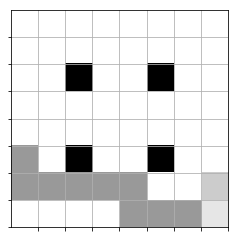

In [33]:
print(play_game(model_v5_3, qmaze, (5,0)))
show(qmaze)

win


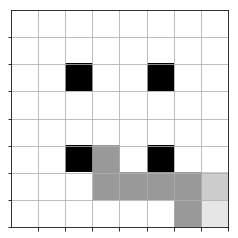

In [34]:
print(play_game(model_v5_3, qmaze, (5,3)))
show(qmaze)

win


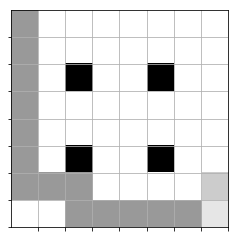

In [35]:
print(play_game(model_v5_3, qmaze, (0,0)))
show(qmaze)

win


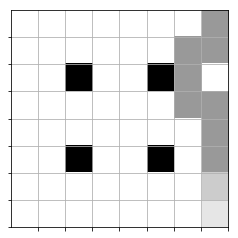

In [36]:
print(play_game(model_v5_3, qmaze, (0,7)))
show(qmaze)

win


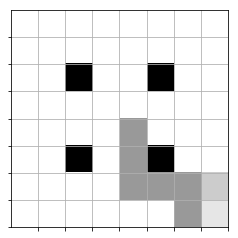

In [37]:
print(play_game(model_v5_3, qmaze, (4,4)))
show(qmaze)

win


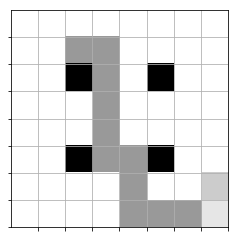

In [38]:
print(play_game(model_v5_3, qmaze, (1,2)))
show(qmaze)

win


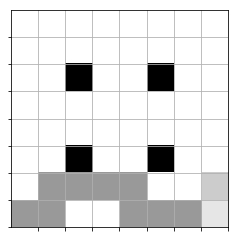

In [39]:
print(play_game(model_v5_3, qmaze, (7,0)))
show(qmaze)

win


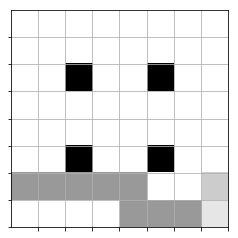

In [40]:
print(play_game(model_v5_3, qmaze, (6,0)))
show(qmaze)

win


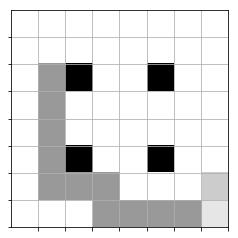

In [41]:
print(play_game(model_v5_3, qmaze, (2,1)))
show(qmaze)

win


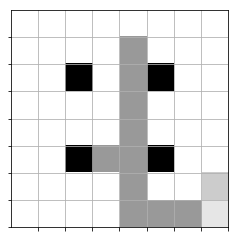

In [42]:
print(play_game(model_v5_3, qmaze, (1,4)))
show(qmaze)

## Agent has mastered the game, wins all 10 games in minimum moves.

In [43]:
print(sum(win_history))

49567


In [93]:
win_rate=np.zeros(len(win_history))
for i in range(len(win_history)):
    win_rate[i]=sum(win_history[:i+1])/len(win_history[:i+1])
print(i)

60000


In [94]:
win_rate

array([0.        , 0.        , 0.        , ..., 0.82611087, 0.82611377,
       0.82611667])

In [95]:
len(win_history)

60000

### Below plot shows the learning progress of the agent (in terms of win rate) as the agent plays more no. of games. Please note the policy is reviewed after exactly 300 moves of the agent which comes out to be an average of about 37 games. Though the agent played lot of games to train, but it took him only 17-18 minutes to play these many games.

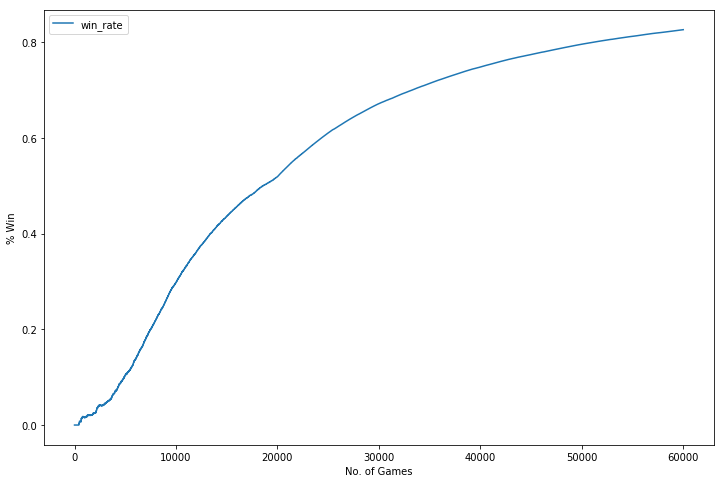

In [103]:
plt.figure(figsize=(12,8))
plt.xlabel("No. of Games")
plt.ylabel("% Win")
plt.plot(win_rate, label="win_rate")
plt.legend()